In [1]:
# !pip install DecisionBoundaryDisplay

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import missingno as msno
import os
from sklearn.ensemble import IsolationForest
import warnings
import module as md

This application is used to convert notebook files (*.ipynb) to various other

[NbConvertApp] WARNING | pattern 'preprocessing_anormaly_detection.py' matched no files



formats.


Options
The options below are convenience aliases to configurable class-options,
as listed in the "Equivalent to" description-line of the aliases.
To see all configurable class-options for some <cmd>, use:
    <cmd> --help-all

--debug
    set log level to logging.DEBUG (maximize logging output)
    Equivalent to: [--Application.log_level=10]
--generate-config
    generate default config file
    Equivalent to: [--JupyterApp.generate_config=True]
-y
    Answer yes to any questions instead of prompting.
    Equivalent to: [--JupyterApp.answer_yes=True]
--execute
    Execute the notebook prior to export.
    Equivalent to: [--ExecutePreprocessor.enabled=True]
--allow-errors
    Continue notebook execution even if one of the cells throws an error and include the error message in the cell output (the default behaviour is to abort conversion). This flag is only relevant if '--execute' was specified, too.
    Equivalent to: [--ExecutePreprocessor.allow_errors=True]
--stdin
    re

In [3]:
warnings.filterwarnings('ignore')

In [4]:
os.getcwd()

'D:\\jupyter\\01_Sangwoo_Project\\03_Project\\03_GyengnamTP\\03_Collecting_data\\06_Anomaly_detection'

In [5]:
file_list = os.listdir('D:/jupyter/01_Sangwoo_Project/03_Project/03_GyengnamTP/03_Collecting_data/06_Anomaly_detection')
file_list

['(2022.10.04)Anomaly_detection_with_IsolationForest_for_valid_shots.ipynb',
 '(2022.10.06) VL04_Tool5_Anomaly_detection.ipynb',
 '.ipynb_checkpoints',
 'Daeshin_parameter_220713_0831_VL04_raw_data.csv',
 'Daeshin_parameter_220901_1013_VL04_raw_data.csv',
 'Daeshin_parameter_221014_1017_VL04_raw_data.csv',
 'Daeshin_parameter_221018_1023_VL04_raw_data.csv',
 'data_extract.ipynb',
 'Feature_selection.ipynb',
 'IF_training_model.pkl',
 'module.ipynb',
 'module.py',
 'VL04_data.parquet',
 'VL04_Tool5_Anomaly_detection.ipynb',
 'VL04_Tool5_Anomaly_detection_data221023.ipynb',
 'VL04_Tool5_Anomaly_detection_version2.ipynb',
 '__pycache__']

In [6]:
[file_csv for file_csv in file_list if file_csv.endswith('.csv')]

['Daeshin_parameter_220713_0831_VL04_raw_data.csv',
 'Daeshin_parameter_220901_1013_VL04_raw_data.csv',
 'Daeshin_parameter_221014_1017_VL04_raw_data.csv',
 'Daeshin_parameter_221018_1023_VL04_raw_data.csv']

In [7]:
df = md.read_data(sensor_data_only = False)

In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40035542 entries, 0 to 40035541
Data columns (total 18 columns):
 #   Column           Dtype  
---  ------           -----  
 0   datetime         object 
 1   shot_no          float64
 2   tool_number      float64
 3   current_spindle  int32  
 4   current_x        float64
 5   current_z        float64
 6   vibration        int32  
 7   rpm              float64
 8   rpm_set          float64
 9   feed             float64
 10  feed_set         float64
 11  load_1           float64
 12  servo_load_x     float64
 13  servo_load_z     float64
 14  servo_current_x  float64
 15  servo_current_z  float64
 16  tool_state       float64
 17  tool             float64
dtypes: float64(15), int32(2), object(1)
memory usage: 5.1+ GB


In [9]:
# tool_number 정보에서 공구 번호 도출
# md.extract_tool_info_from_data(df)

In [10]:
# 유효한 샷만 도출
md.find_and_mark_valid_shot(df, report_result = True)

===== shot5824.0 ============================

(1) dataframe -----------------

                        datetime  shot_no  tool_number  current_spindle  \
0     2022-07-13 00:00:00.032772   5824.0        909.0             2018   
1     2022-07-13 00:00:00.238221   5824.0        909.0             2018   
2     2022-07-13 00:00:00.431812   5824.0        909.0             2018   
3     2022-07-13 00:00:00.632125   5824.0        909.0             2017   
4     2022-07-13 00:00:00.842293   5824.0        909.0             2017   
...                          ...      ...          ...              ...   
5688  2022-07-13 00:18:58.252391   5824.0        707.0             7222   
5689  2022-07-13 00:18:58.458173   5824.0        707.0             7222   
5690  2022-07-13 00:18:58.658090   5824.0        707.0             7222   
5691  2022-07-13 00:18:58.851792   5824.0        707.0             2612   
5692  2022-07-13 00:18:59.058084   5824.0        707.0             2612   

      current_x  cu

===== shot5827.0 ============================

(1) dataframe -----------------

                         datetime  shot_no  tool_number  current_spindle  \
31462  2022-07-13 01:44:57.560691   5827.0        707.0              293   
31463  2022-07-13 01:44:57.760441   5827.0        707.0              293   
31464  2022-07-13 01:44:57.966230   5827.0        707.0               14   
31465  2022-07-13 01:44:58.159212   5827.0        707.0               14   
31466  2022-07-13 01:44:58.361642   5827.0        707.0                0   
...                           ...      ...          ...              ...   
44293  2022-07-13 02:27:46.369118   5827.0        707.0             7127   
44294  2022-07-13 02:27:46.569330   5827.0        707.0             7127   
44295  2022-07-13 02:27:46.780769   5827.0        707.0             2811   
44296  2022-07-13 02:27:46.983935   5827.0        707.0             2811   
44297  2022-07-13 02:27:47.169008   5827.0        707.0             2811   

       

                          datetime  shot_no  tool_number  current_spindle  \
124798  2022-07-13 06:56:22.212332   5830.0        707.0                0   
124799  2022-07-13 06:56:22.406371   5830.0        707.0                0   
124800  2022-07-13 06:56:22.605546   5830.0        707.0                0   
124801  2022-07-13 06:56:22.805345   5830.0        707.0                0   
124802  2022-07-13 06:56:23.006326   5830.0        707.0                0   
...                            ...      ...          ...              ...   
137610  2022-07-13 07:39:07.034966   5830.0        707.0             2492   
137611  2022-07-13 07:39:07.230699   5830.0        707.0             7599   
137612  2022-07-13 07:39:07.428791   5830.0        707.0             7599   
137613  2022-07-13 07:39:07.629865   5830.0        707.0             7599   
137614  2022-07-13 07:39:07.835076   5830.0        707.0             4019   

        current_x  current_z  vibration    rpm  rpm_set  feed  feed_set  \


6
===== shotnan ============================

(1) dataframe -----------------

Empty DataFrame
Columns: [datetime, shot_no, tool_number, current_spindle, current_x, current_z, vibration, rpm, rpm_set, feed, feed_set, load_1, servo_load_x, servo_load_z, servo_current_x, servo_current_z, tool_state, tool, real_shot]
Index: []
(2) used tool -----------------

[]
(3) extract order using tools -----------------

shot_no nan of raw data : invalid_shot
6
===== shot5832.0 ============================

(1) dataframe -----------------

                          datetime  shot_no  tool_number  current_spindle  \
383163  2022-07-13 20:58:37.302497   5832.0        707.0             2131   
383164  2022-07-13 20:58:37.496759   5832.0        707.0             2131   
383165  2022-07-13 20:58:37.695894   5832.0        707.0              130   
383166  2022-07-13 20:58:37.933433   5832.0        707.0              130   
383167  2022-07-13 20:58:38.113978   5832.0        707.0              130   
...   

===== shot5834.0 ============================

(1) dataframe -----------------

                          datetime  shot_no  tool_number  current_spindle  \
408655  2022-07-13 22:23:45.824139   5834.0        707.0             1351   
408656  2022-07-13 22:23:46.024111   5834.0        707.0             1351   
408657  2022-07-13 22:23:46.247006   5834.0        707.0               28   
408658  2022-07-13 22:23:46.406065   5834.0        707.0               28   
408659  2022-07-13 22:23:46.641404   5834.0        707.0               28   
...                            ...      ...          ...              ...   
422469  2022-07-13 23:09:52.704466   5834.0        707.0             7684   
422470  2022-07-13 23:09:52.887554   5834.0        707.0             7684   
422471  2022-07-13 23:09:53.104454   5834.0        707.0             7684   
422472  2022-07-13 23:09:53.287248   5834.0        707.0             4344   
422473  2022-07-13 23:09:53.493490   5834.0        707.0             4344

[954 rows x 19 columns]
sub(438958:450642) - real_shot_no 11
------ valid shot[0]

                          datetime  shot_no  tool_number  current_spindle  \
438958  2022-07-14 00:04:55.064544   5836.0        100.0                0   
438959  2022-07-14 00:04:55.288942   5836.0        100.0                0   
438960  2022-07-14 00:04:55.471831   5836.0        100.0                0   
438961  2022-07-14 00:04:55.664114   5836.0        100.0                0   
438962  2022-07-14 00:04:55.864074   5836.0        100.0                0   
...                            ...      ...          ...              ...   
450638  2022-07-14 00:43:58.508690   5836.0        707.0             5129   
450639  2022-07-14 00:43:58.719399   5836.0        707.0             5129   
450640  2022-07-14 00:43:58.913261   5836.0        707.0             5129   
450641  2022-07-14 00:43:59.112768   5836.0        707.0             5544   
450642  2022-07-14 00:43:59.308994   5836.0        707.0             5


                          datetime  shot_no  tool_number  current_spindle  \
464172  2022-07-14 01:29:09.077119   5838.0        100.0                0   
464173  2022-07-14 01:29:09.277091   5838.0        100.0                0   
464174  2022-07-14 01:29:09.489467   5838.0        100.0                0   
464175  2022-07-14 01:29:09.700849   5838.0        100.0                0   
464176  2022-07-14 01:29:09.883740   5838.0        100.0                0   
...                            ...      ...          ...              ...   
475806  2022-07-14 02:08:11.779141   5838.0        707.0             6529   
475807  2022-07-14 02:08:11.983910   5838.0        707.0             6529   
475808  2022-07-14 02:08:12.196045   5838.0        707.0             6304   
475809  2022-07-14 02:08:12.379450   5838.0        707.0             6304   
475810  2022-07-14 02:08:12.577899   5838.0        707.0             6304   

        current_x  current_z  vibration    rpm  rpm_set  feed  feed_set  \

[54551 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                          datetime  shot_no  tool_number  current_spindle  \
501456  2022-07-14 03:33:58.523331   5841.0        707.0              860   
501457  2022-07-14 03:33:58.717602   5841.0        707.0              860   
501458  2022-07-14 03:33:58.910230   5841.0        707.0              860   
501459  2022-07-14 03:33:59.129058   5841.0        707.0               17   
501460  2022-07-14 03:33:59.308536   5841.0        707.0               17   
...                            ...      ...          ...              ...   
502005  2022-07-14 03:35:48.880560   5841.0        707.0                0   
502006  2022-07-14 03:35:49.080845   5841.0        707.0                0   
502007  2022-07-14 03:35:49.281676   5841.0        707.0                0   
502008  2022-07-14 03:35:49.481884   5841.0        707.0          

[13451 rows x 19 columns]
sub(594914:607640) - real_shot_no 19
------ valid shot[1]

                          datetime  shot_no  tool_number  current_spindle  \
594914  2022-07-14 08:46:19.353927   5843.0        100.0                0   
594915  2022-07-14 08:46:19.549588   5843.0        100.0                0   
594916  2022-07-14 08:46:19.746041   5843.0        100.0                0   
594917  2022-07-14 08:46:19.953778   5843.0        100.0                0   
594918  2022-07-14 08:46:20.147728   5843.0        100.0                0   
...                            ...      ...          ...              ...   
607636  2022-07-14 09:28:53.054887   5843.0        707.0             3946   
607637  2022-07-14 09:28:53.269032   5843.0        707.0             3946   
607638  2022-07-14 09:28:53.455372   5843.0        707.0             7356   
607639  2022-07-14 09:28:53.657649   5843.0        707.0             7356   
607640  2022-07-14 09:28:53.886276   5843.0        707.0            

------ valid shot[0]

                          datetime  shot_no  tool_number  current_spindle  \
621220  2022-07-14 10:14:18.302933   5845.0        100.0                0   
621221  2022-07-14 10:14:18.501811   5845.0        100.0                0   
621222  2022-07-14 10:14:18.708980   5845.0        100.0                0   
621223  2022-07-14 10:14:18.937775   5845.0        100.0                0   
621224  2022-07-14 10:14:19.103380   5845.0        100.0                0   
...                            ...      ...          ...              ...   
633943  2022-07-14 10:56:51.241260   5845.0        707.0             2015   
633944  2022-07-14 10:56:51.452345   5845.0        707.0             7034   
633945  2022-07-14 10:56:51.640902   5845.0        707.0             7034   
633946  2022-07-14 10:56:51.835598   5845.0        707.0             6366   
633947  2022-07-14 10:56:52.033832   5845.0        707.0             6366   

        current_x  current_z  vibration    rpm  rpm_s

                          datetime  shot_no  tool_number  current_spindle  \
660290  2022-07-14 12:24:59.443375   5848.0        707.0             1031   
660291  2022-07-14 12:24:59.649118   5848.0        707.0             1031   
660292  2022-07-14 12:24:59.831927   5848.0        707.0               46   
660293  2022-07-14 12:25:00.033119   5848.0        707.0               46   
660294  2022-07-14 12:25:00.254801   5848.0        707.0               46   
...                            ...      ...          ...              ...   
684588  2022-07-14 13:46:06.563111   5848.0        707.0             2064   
684589  2022-07-14 13:46:06.776942   5848.0        707.0             7310   
684590  2022-07-14 13:46:06.980879   5848.0        707.0             7310   
684591  2022-07-14 13:46:07.186281   5848.0        707.0             7310   
684592  2022-07-14 13:46:07.363284   5848.0        707.0             1645   

        current_x  current_z  vibration    rpm  rpm_set  feed  feed_set  \



                          datetime  shot_no  tool_number  current_spindle  \
698131  2022-07-14 14:31:22.487377   5850.0        100.0                0   
698132  2022-07-14 14:31:22.699022   5850.0        100.0                0   
698133  2022-07-14 14:31:22.899137   5850.0        100.0                0   
698134  2022-07-14 14:31:23.093267   5850.0        100.0                0   
698135  2022-07-14 14:31:23.293293   5850.0        100.0                0   
...                            ...      ...          ...              ...   
710867  2022-07-14 15:13:56.481507   5850.0        707.0             5064   
710868  2022-07-14 15:13:56.670790   5850.0        707.0             5064   
710869  2022-07-14 15:13:56.893525   5850.0        707.0             6880   
710870  2022-07-14 15:13:57.087703   5850.0        707.0             6880   
710871  2022-07-14 15:13:57.271082   5850.0        707.0             6880   

        current_x  current_z  vibration    rpm  rpm_set     feed  feed_set

[13195 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                          datetime  shot_no  tool_number  current_spindle  \
737159  2022-07-14 16:42:00.030333   5853.0        707.0              197   
737160  2022-07-14 16:42:00.242390   5853.0        707.0              197   
737161  2022-07-14 16:42:00.442373   5853.0        707.0              197   
737162  2022-07-14 16:42:00.642307   5853.0        707.0              197   
737163  2022-07-14 16:42:00.859124   5853.0        707.0                5   
...                            ...      ...          ...              ...   
737589  2022-07-14 16:43:26.149788   5853.0        707.0                0   
737590  2022-07-14 16:43:26.352540   5853.0        707.0                0   
737591  2022-07-14 16:43:26.558331   5853.0        707.0                0   
737592  2022-07-14 16:43:26.752801   5853.0        707.0          

[265 rows x 19 columns]
sub(765650:810905) - real_shot_no 31
------ valid shot[0]

                          datetime  shot_no  tool_number  current_spindle  \
765650  2022-07-14 18:17:06.132824   5855.0        100.0                0   
765651  2022-07-14 18:17:06.320597   5855.0        100.0                0   
765652  2022-07-14 18:17:06.520778   5855.0        100.0                0   
765653  2022-07-14 18:17:06.732977   5855.0        100.0                0   
765654  2022-07-14 18:17:06.921159   5855.0        100.0                0   
...                            ...      ...          ...              ...   
810901  2022-07-14 20:48:14.432245   5855.0        707.0             3327   
810902  2022-07-14 20:48:14.635702   5855.0        707.0             3327   
810903  2022-07-14 20:48:14.833279   5855.0        707.0             7369   
810904  2022-07-14 20:48:15.034494   5855.0        707.0             7369   
810905  2022-07-14 20:48:15.265674   5855.0        707.0             1

[11703 rows x 19 columns]
33
===== shot5858.0 ============================

(1) dataframe -----------------

                          datetime  shot_no  tool_number  current_spindle  \
836423  2022-07-14 22:13:35.129986   5858.0        707.0             7032   
836424  2022-07-14 22:13:35.329906   5858.0        707.0              951   
836425  2022-07-14 22:13:35.533181   5858.0        707.0              951   
836426  2022-07-14 22:13:35.731305   5858.0        707.0              951   
836427  2022-07-14 22:13:35.939384   5858.0        707.0               42   
...                            ...      ...          ...              ...   
848780  2022-07-14 22:55:02.845567   5858.0        707.0             7415   
848781  2022-07-14 22:55:02.994564   5858.0        707.0             7415   
848782  2022-07-14 22:55:03.195918   5858.0        707.0             7415   
848783  2022-07-14 22:55:03.411361   5858.0        707.0             7415   
848784  2022-07-14 22:55:03.596717   5858.0 

                          datetime  shot_no  tool_number  current_spindle  \
862386  2022-07-14 23:40:27.843744   5860.0        707.0             5560   
862387  2022-07-14 23:40:28.045919   5860.0        707.0              387   
862388  2022-07-14 23:40:28.245931   5860.0        707.0              387   
862389  2022-07-14 23:40:28.428817   5860.0        707.0              387   
862390  2022-07-14 23:40:28.640201   5860.0        707.0               21   
...                            ...      ...          ...              ...   
875206  2022-07-15 00:23:15.676445   5860.0        707.0             7536   
875207  2022-07-15 00:23:15.875371   5860.0        707.0             7536   
875208  2022-07-15 00:23:16.087418   5860.0        707.0             7536   
875209  2022-07-15 00:23:16.276351   5860.0        707.0             4114   
875210  2022-07-15 00:23:16.484273   5860.0        707.0             4114   

        current_x  current_z  vibration    rpm  rpm_set  feed  feed_set  \


                          datetime  shot_no  tool_number  current_spindle  \
889686  2022-07-15 01:11:43.974936   5862.0        100.0                0   
889687  2022-07-15 01:11:44.186205   5862.0        100.0                0   
889688  2022-07-15 01:11:44.368259   5862.0        100.0                0   
889689  2022-07-15 01:11:44.580199   5862.0        100.0                0   
889690  2022-07-15 01:11:44.768937   5862.0        100.0                0   
...                            ...      ...          ...              ...   
901360  2022-07-15 01:50:47.694760   5862.0        707.0             7216   
901361  2022-07-15 01:50:47.883307   5862.0        707.0             7216   
901362  2022-07-15 01:50:48.068064   5862.0        707.0             7216   
901363  2022-07-15 01:50:48.283322   5862.0        707.0             4263   
901364  2022-07-15 01:50:48.477445   5862.0        707.0             4263   

        current_x  current_z  vibration    rpm  rpm_set  feed  feed_set  \



                           datetime  shot_no  tool_number  current_spindle  \
985955   2022-07-15 06:33:24.910147   5865.0        707.0             1383   
985956   2022-07-15 06:33:25.103978   5865.0        707.0             1383   
985957   2022-07-15 06:33:25.287306   5865.0        707.0               28   
985958   2022-07-15 06:33:25.498836   5865.0        707.0               28   
985959   2022-07-15 06:33:25.687959   5865.0        707.0               28   
...                             ...      ...          ...              ...   
1007897  2022-07-15 07:46:39.352572   5865.0        707.0             2072   
1007898  2022-07-15 07:46:39.587595   5865.0        707.0             7787   
1007899  2022-07-15 07:46:39.771172   5865.0        707.0             7787   
1007900  2022-07-15 07:46:39.953685   5865.0        707.0             7787   
1007901  2022-07-15 07:46:40.160076   5865.0        707.0             2880   

         current_x  current_z  vibration    rpm  rpm_set  feed

[30353 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8), (9, 16)]
------ invalid data

                           datetime  shot_no  tool_number  current_spindle  \
1008084  2022-07-15 07:47:16.806566   5867.0        707.0                0   
1008085  2022-07-15 07:47:17.005269   5867.0        707.0                0   
1008086  2022-07-15 07:47:17.229678   5867.0        707.0                0   
1008087  2022-07-15 07:47:17.424722   5867.0        707.0                0   
1008088  2022-07-15 07:47:17.606563   5867.0        707.0                0   
...                             ...      ...          ...              ...   
1012405  2022-07-15 08:01:42.445049   5867.0        707.0                0   
1012406  2022-07-15 08:01:42.645114   5867.0        707.0                0   
1012407  2022-07-15 08:01:42.839899   5867.0        707.0                0   
1012408  2022-07-15 08:01:43.051357   5867.0   

[13141 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                           datetime  shot_no  tool_number  current_spindle  \
1051584  2022-07-15 10:12:31.707319   5869.0        707.0              764   
1051585  2022-07-15 10:12:31.907638   5869.0        707.0              764   
1051586  2022-07-15 10:12:32.119608   5869.0        707.0              764   
1051587  2022-07-15 10:12:32.309310   5869.0        707.0               38   
1051588  2022-07-15 10:12:32.514477   5869.0        707.0               38   
...                             ...      ...          ...              ...   
1051982  2022-07-15 10:13:52.416020   5869.0        707.0                0   
1051983  2022-07-15 10:13:52.617082   5869.0        707.0                0   
1051984  2022-07-15 10:13:52.816328   5869.0        707.0                0   
1051985  2022-07-15 10:13:53.015399   5869.0        707.


                           datetime  shot_no  tool_number  current_spindle  \
1078337  2022-07-15 11:41:56.808360   5871.0        100.0                0   
1078338  2022-07-15 11:41:57.010233   5871.0        100.0                0   
1078339  2022-07-15 11:41:57.216540   5871.0        100.0                0   
1078340  2022-07-15 11:41:57.422660   5871.0        100.0                0   
1078341  2022-07-15 11:41:57.611780   5871.0        100.0                0   
...                             ...      ...          ...              ...   
1091088  2022-07-15 12:24:31.382886   5871.0        707.0             3585   
1091089  2022-07-15 12:24:31.548655   5871.0        707.0             3585   
1091090  2022-07-15 12:24:31.752720   5871.0        707.0             6492   
1091091  2022-07-15 12:24:31.949073   5871.0        707.0             6492   
1091092  2022-07-15 12:24:32.155600   5871.0        707.0             6492   

         current_x  current_z  vibration    rpm  rpm_set     f

                           datetime  shot_no  tool_number  current_spindle  \
1128166  2022-07-15 14:28:42.251641   5874.0        707.0             1061   
1128167  2022-07-15 14:28:42.451900   5874.0        707.0             1061   
1128168  2022-07-15 14:28:42.659418   5874.0        707.0             1061   
1128169  2022-07-15 14:28:42.880284   5874.0        707.0               19   
1128170  2022-07-15 14:28:43.050931   5874.0        707.0               19   
...                             ...      ...          ...              ...   
1141331  2022-07-15 15:12:40.515822   5874.0        707.0             2927   
1141332  2022-07-15 15:12:40.726164   5874.0        707.0             2927   
1141333  2022-07-15 15:12:40.917888   5874.0        707.0             6785   
1141334  2022-07-15 15:12:41.131770   5874.0        707.0             6785   
1141335  2022-07-15 15:12:41.318485   5874.0        707.0             6785   

         current_x  current_z  vibration    rpm  rpm_set  feed 

[12729 rows x 19 columns]
52
===== shot5877.0 ============================

(1) dataframe -----------------

                           datetime  shot_no  tool_number  current_spindle  \
1167635  2022-07-15 16:40:42.472965   5877.0        707.0             4108   
1167636  2022-07-15 16:40:42.673019   5877.0        707.0             4108   
1167637  2022-07-15 16:40:42.874218   5877.0        707.0              190   
1167638  2022-07-15 16:40:43.083271   5877.0        707.0              190   
1167639  2022-07-15 16:40:43.285927   5877.0        707.0              190   
...                             ...      ...          ...              ...   
1180980  2022-07-15 17:25:36.357560   5877.0        707.0             7422   
1180981  2022-07-15 17:25:36.515874   5877.0        707.0             7422   
1180982  2022-07-15 17:25:36.714982   5877.0        707.0             7422   
1180983  2022-07-15 17:25:36.917850   5877.0        707.0             4162   
1180984  2022-07-15 17:25:37.1312


                           datetime  shot_no  tool_number  current_spindle  \
1196961  2022-07-15 18:19:03.312997   5879.0        707.0             3863   
1196962  2022-07-15 18:19:03.512990   5879.0        707.0              203   
1196963  2022-07-15 18:19:03.695658   5879.0        707.0              203   
1196964  2022-07-15 18:19:03.895677   5879.0        707.0               10   
1196965  2022-07-15 18:19:04.093694   5879.0        707.0               10   
...                             ...      ...          ...              ...   
1241002  2022-07-15 20:46:06.135627   5879.0        707.0             6248   
1241003  2022-07-15 20:46:06.347212   5879.0        707.0             5068   
1241004  2022-07-15 20:46:06.547156   5879.0        707.0             5068   
1241005  2022-07-15 20:46:06.741058   5879.0        707.0             5068   
1241006  2022-07-15 20:46:06.934555   5879.0        707.0              623   

         current_x  current_z  vibration    rpm  rpm_set  feed

[12712 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                           datetime  shot_no  tool_number  current_spindle  \
1254728  2022-07-15 21:32:06.024619   5881.0        707.0             5649   
1254729  2022-07-15 21:32:06.224854   5881.0        707.0              909   
1254730  2022-07-15 21:32:06.419526   5881.0        707.0              909   
1254731  2022-07-15 21:32:06.636105   5881.0        707.0              909   
1254732  2022-07-15 21:32:06.824632   5881.0        707.0               18   
...                             ...      ...          ...              ...   
1255770  2022-07-15 21:35:36.098981   5881.0        707.0                0   
1255771  2022-07-15 21:35:36.304741   5881.0        707.0                0   
1255772  2022-07-15 21:35:36.504836   5881.0        707.0                0   
1255773  2022-07-15 21:35:36.694003   5881.0        707.

                           datetime  shot_no  tool_number  current_spindle  \
1280593  2022-07-15 22:58:45.126394   5883.0        100.0                0   
1280594  2022-07-15 22:58:45.325957   5883.0        100.0                0   
1280595  2022-07-15 22:58:45.522152   5883.0        100.0                0   
1280596  2022-07-15 22:58:45.726032   5883.0        100.0                0   
1280597  2022-07-15 22:58:45.954579   5883.0        100.0                0   
...                             ...      ...          ...              ...   
1292263  2022-07-15 23:37:47.693289   5883.0        707.0             7816   
1292264  2022-07-15 23:37:47.953565   5883.0        707.0             5401   
1292265  2022-07-15 23:37:48.091604   5883.0        707.0             5401   
1292266  2022-07-15 23:37:48.319285   5883.0        707.0             5401   
1292267  2022-07-15 23:37:48.507813   5883.0        707.0              501   

         current_x  current_z  vibration    rpm  rpm_set     fe

                           datetime  shot_no  tool_number  current_spindle  \
1321954  2022-07-16 01:16:58.085113   5886.0        707.0              582   
1321955  2022-07-16 01:16:58.262044   5886.0        707.0              582   
1321956  2022-07-16 01:16:58.474150   5886.0        707.0              582   
1321957  2022-07-16 01:16:58.662301   5886.0        707.0               25   
1321958  2022-07-16 01:16:58.863657   5886.0        707.0               25   
...                             ...      ...          ...              ...   
1334860  2022-07-16 02:00:04.987001   5886.0        707.0             7643   
1334861  2022-07-16 02:00:05.161966   5886.0        707.0             7643   
1334862  2022-07-16 02:00:05.361720   5886.0        707.0             7643   
1334863  2022-07-16 02:00:05.563429   5886.0        707.0             4302   
1334864  2022-07-16 02:00:05.780828   5886.0        707.0             4302   

         current_x  current_z  vibration    rpm  rpm_set  feed 

[11699 rows x 19 columns]
64
===== shot5889.0 ============================

(1) dataframe -----------------

                           datetime  shot_no  tool_number  current_spindle  \
1360764  2022-07-16 03:26:40.182400   5889.0        707.0              920   
1360765  2022-07-16 03:26:40.371036   5889.0        707.0              920   
1360766  2022-07-16 03:26:40.564269   5889.0        707.0              920   
1360767  2022-07-16 03:26:40.763574   5889.0        707.0               50   
1360768  2022-07-16 03:26:40.982416   5889.0        707.0               50   
...                             ...      ...          ...              ...   
1417943  2022-07-16 06:37:50.409619   5889.0        707.0             2710   
1417944  2022-07-16 06:37:50.587739   5889.0        707.0             2710   
1417945  2022-07-16 06:37:50.783852   5889.0        707.0             7527   
1417946  2022-07-16 06:37:50.985451   5889.0        707.0             7527   
1417947  2022-07-16 06:37:51.1842


                           datetime  shot_no  tool_number  current_spindle  \
1439123  2022-07-16 07:48:41.655807   5891.0        707.0             2175   
1439124  2022-07-16 07:48:41.873596   5891.0        707.0             2175   
1439125  2022-07-16 07:48:42.052875   5891.0        707.0               42   
1439126  2022-07-16 07:48:42.251932   5891.0        707.0               42   
1439127  2022-07-16 07:48:42.456400   5891.0        707.0               42   
...                             ...      ...          ...              ...   
1463568  2022-07-16 09:10:30.900452   5891.0        707.0             7284   
1463569  2022-07-16 09:10:31.089285   5891.0        707.0             7284   
1463570  2022-07-16 09:10:31.292006   5891.0        707.0             7284   
1463571  2022-07-16 09:10:31.489810   5891.0        707.0             4139   
1463572  2022-07-16 09:10:31.760907   5891.0        707.0             4139   

         current_x  current_z  vibration    rpm  rpm_set  feed

[5712 rows x 19 columns]
sub(1484333:1497057) - real_shot_no 69
------ valid shot[0]

                           datetime  shot_no  tool_number  current_spindle  \
1484333  2022-07-16 10:19:55.463414   5893.0        100.0                0   
1484334  2022-07-16 10:19:55.662165   5893.0        100.0                0   
1484335  2022-07-16 10:19:55.856839   5893.0        100.0                0   
1484336  2022-07-16 10:19:56.050716   5893.0        100.0                0   
1484337  2022-07-16 10:19:56.251183   5893.0        100.0                0   
...                             ...      ...          ...              ...   
1497053  2022-07-16 11:02:28.751699   5893.0        707.0             4016   
1497054  2022-07-16 11:02:28.944392   5893.0        707.0             4016   
1497055  2022-07-16 11:02:29.167732   5893.0        707.0             6315   
1497056  2022-07-16 11:02:29.348264   5893.0        707.0             6315   
1497057  2022-07-16 11:02:29.579194   5893.0        707.


                           datetime  shot_no  tool_number  current_spindle  \
1512453  2022-07-16 11:53:56.749777   5895.0        100.0                0   
1512454  2022-07-16 11:53:56.963623   5895.0        100.0                0   
1512455  2022-07-16 11:53:57.149537   5895.0        100.0                0   
1512456  2022-07-16 11:53:57.350857   5895.0        100.0                0   
1512457  2022-07-16 11:53:57.552289   5895.0        100.0                0   
...                             ...      ...          ...              ...   
1525173  2022-07-16 12:36:29.881489   5895.0        707.0             4660   
1525174  2022-07-16 12:36:30.116183   5895.0        707.0             4660   
1525175  2022-07-16 12:36:30.287494   5895.0        707.0             5978   
1525176  2022-07-16 12:36:30.482505   5895.0        707.0             5978   
1525177  2022-07-16 12:36:30.699301   5895.0        707.0             5978   

         current_x  current_z  vibration    rpm  rpm_set  feed


                           datetime  shot_no  tool_number  current_spindle  \
1560965  2022-07-16 14:36:08.128115   5898.0        707.0             1208   
1560966  2022-07-16 14:36:08.325730   5898.0        707.0             1208   
1560967  2022-07-16 14:36:08.545813   5898.0        707.0               50   
1560968  2022-07-16 14:36:08.727057   5898.0        707.0               50   
1560969  2022-07-16 14:36:08.945911   5898.0        707.0               50   
...                             ...      ...          ...              ...   
1575400  2022-07-16 15:24:19.315135   5898.0        707.0             2405   
1575401  2022-07-16 15:24:19.516424   5898.0        707.0             7645   
1575402  2022-07-16 15:24:19.717242   5898.0        707.0             7645   
1575403  2022-07-16 15:24:19.934856   5898.0        707.0             7645   
1575404  2022-07-16 15:24:20.123154   5898.0        707.0             3734   

         current_x  current_z  vibration    rpm  rpm_set  feed

[3876 rows x 19 columns]
sub(1597783:1660128) - real_shot_no 76
------ valid shot[0]

                           datetime  shot_no  tool_number  current_spindle  \
1597783  2022-07-16 16:39:24.932105   5900.0        100.0                0   
1597784  2022-07-16 16:39:25.130078   5900.0        100.0                0   
1597785  2022-07-16 16:39:25.323777   5900.0        100.0                0   
1597786  2022-07-16 16:39:25.519281   5900.0        100.0                0   
1597787  2022-07-16 16:39:25.717862   5900.0        100.0                0   
...                             ...      ...          ...              ...   
1660124  2022-07-16 20:07:35.562282   5900.0        707.0             7712   
1660125  2022-07-16 20:07:35.744587   5900.0        707.0             7712   
1660126  2022-07-16 20:07:35.962818   5900.0        707.0             4018   
1660127  2022-07-16 20:07:36.150974   5900.0        707.0             4018   
1660128  2022-07-16 20:07:36.345097   5900.0        707.

                           datetime  shot_no  tool_number  current_spindle  \
1676240  2022-07-16 21:01:23.690333   5902.0        100.0                0   
1676241  2022-07-16 21:01:23.914875   5902.0        100.0                0   
1676242  2022-07-16 21:01:24.092965   5902.0        100.0                0   
1676243  2022-07-16 21:01:24.293982   5902.0        100.0                0   
1676244  2022-07-16 21:01:24.518068   5902.0        100.0                0   
...                             ...      ...          ...              ...   
1687939  2022-07-16 21:40:26.767907   5902.0        707.0             3129   
1687940  2022-07-16 21:40:26.951182   5902.0        707.0             6643   
1687941  2022-07-16 21:40:27.164034   5902.0        707.0             6643   
1687942  2022-07-16 21:40:27.352091   5902.0        707.0             1750   
1687943  2022-07-16 21:40:27.580718   5902.0        707.0             1750   

         current_x  current_z  vibration    rpm  rpm_set  feed 

===== shot5905.0 ============================

(1) dataframe -----------------

                           datetime  shot_no  tool_number  current_spindle  \
1714386  2022-07-16 23:08:44.842672   5905.0        707.0              483   
1714387  2022-07-16 23:08:44.973555   5905.0        707.0              483   
1714388  2022-07-16 23:08:45.171585   5905.0        707.0              483   
1714389  2022-07-16 23:08:45.398337   5905.0        707.0              483   
1714390  2022-07-16 23:08:45.571088   5905.0        707.0              483   
...                             ...      ...          ...              ...   
1727282  2022-07-16 23:51:52.613508   5905.0        707.0             7005   
1727283  2022-07-16 23:51:52.797900   5905.0        707.0             7005   
1727284  2022-07-16 23:51:52.997543   5905.0        707.0             6066   
1727285  2022-07-16 23:51:53.230677   5905.0        707.0             6066   
1727286  2022-07-16 23:51:53.427375   5905.0        707.0     

                           datetime  shot_no  tool_number  current_spindle  \
1741434  2022-07-17 00:39:06.861693   5907.0        100.0                0   
1741435  2022-07-17 00:39:07.051577   5907.0        100.0                0   
1741436  2022-07-17 00:39:07.253281   5907.0        100.0                0   
1741437  2022-07-17 00:39:07.478840   5907.0        100.0                0   
1741438  2022-07-17 00:39:07.652096   5907.0        100.0                0   
...                             ...      ...          ...              ...   
1753082  2022-07-17 01:18:10.332916   5907.0        707.0             2445   
1753083  2022-07-17 01:18:10.551143   5907.0        707.0             7599   
1753084  2022-07-17 01:18:10.739713   5907.0        707.0             7599   
1753085  2022-07-17 01:18:10.939883   5907.0        707.0             3671   
1753086  2022-07-17 01:18:11.151633   5907.0        707.0             3671   

         current_x  current_z  vibration    rpm  rpm_set  feed 

[4156 rows x 19 columns]
(2) used tool -----------------

[7.]
(3) extract order using tools -----------------

shot_no 5910.0 of raw data : invalid_shot
85
===== shot5911.0 ============================

(1) dataframe -----------------

                           datetime  shot_no  tool_number  current_spindle  \
1851665  2022-07-17 06:48:11.120615   5911.0        707.0                0   
1851666  2022-07-17 06:48:11.303425   5911.0        707.0                0   
1851667  2022-07-17 06:48:11.520617   5911.0        707.0                0   
1851668  2022-07-17 06:48:11.695171   5911.0        707.0                0   
1851669  2022-07-17 06:48:11.896173   5911.0        707.0                0   
...                             ...      ...          ...              ...   
1866716  2022-07-17 07:38:34.700594   5911.0        707.0             2656   
1866717  2022-07-17 07:38:34.940553   5911.0        707.0             2656   
1866718  2022-07-17 07:38:35.091625   5911.0        707.0    

===== shot5913.0 ============================

(1) dataframe -----------------

                           datetime  shot_no  tool_number  current_spindle  \
1887415  2022-07-17 08:47:56.477350   5913.0        707.0             2818   
1887416  2022-07-17 08:47:56.677726   5913.0        707.0             2818   
1887417  2022-07-17 08:47:56.871674   5913.0        707.0              177   
1887418  2022-07-17 08:47:57.067010   5913.0        707.0              177   
1887419  2022-07-17 08:47:57.283473   5913.0        707.0              177   
...                             ...      ...          ...              ...   
1898339  2022-07-17 09:24:24.240094   5913.0        707.0             8365   
1898340  2022-07-17 09:24:24.439676   5913.0        707.0             8365   
1898341  2022-07-17 09:24:24.649886   5913.0        707.0             5369   
1898342  2022-07-17 09:24:24.840854   5913.0        707.0             5369   
1898343  2022-07-17 09:24:25.063165   5913.0        707.0     


                           datetime  shot_no  tool_number  current_spindle  \
1912413  2022-07-17 10:11:23.186811   5915.0        100.0                0   
1912414  2022-07-17 10:11:23.387173   5915.0        100.0                0   
1912415  2022-07-17 10:11:23.569717   5915.0        100.0                0   
1912416  2022-07-17 10:11:23.767546   5915.0        100.0                0   
1912417  2022-07-17 10:11:23.975919   5915.0        100.0                0   
...                             ...      ...          ...              ...   
1922740  2022-07-17 10:45:57.066406   5915.0        707.0             8236   
1922741  2022-07-17 10:45:57.276021   5915.0        707.0             8236   
1922742  2022-07-17 10:45:57.466880   5915.0        707.0             8236   
1922743  2022-07-17 10:45:57.658898   5915.0        707.0             2765   
1922744  2022-07-17 10:45:57.860142   5915.0        707.0             2765   

         current_x  current_z  vibration    rpm  rpm_set  feed

[10359 rows x 19 columns]
92
===== shot5918.0 ============================

(1) dataframe -----------------

                           datetime  shot_no  tool_number  current_spindle  \
1945035  2022-07-17 12:00:26.391917   5918.0        707.0             2394   
1945036  2022-07-17 12:00:26.584294   5918.0        707.0             2394   
1945037  2022-07-17 12:00:26.797771   5918.0        707.0              132   
1945038  2022-07-17 12:00:26.991656   5918.0        707.0              132   
1945039  2022-07-17 12:00:27.203084   5918.0        707.0              132   
...                             ...      ...          ...              ...   
1960138  2022-07-17 12:50:52.741857   5918.0        707.0             7316   
1960139  2022-07-17 12:50:52.941480   5918.0        707.0             7316   
1960140  2022-07-17 12:50:53.183625   5918.0        707.0             5771   
1960141  2022-07-17 12:50:53.366135   5918.0        707.0             5771   
1960142  2022-07-17 12:50:53.5604

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                           datetime  shot_no  tool_number  current_spindle  \
1976798  2022-07-17 13:46:31.820209   5920.0        707.0              404   
1976799  2022-07-17 13:46:32.023989   5920.0        707.0              404   
1976800  2022-07-17 13:46:32.214243   5920.0        707.0              404   
1976801  2022-07-17 13:46:32.403458   5920.0        707.0               16   
1976802  2022-07-17 13:46:32.604389   5920.0        707.0               16   
...                             ...      ...          ...              ...   
1978292  2022-07-17 13:51:31.025585   5920.0        707.0                0   
1978293  2022-07-17 13:51:31.227647   5920.0        707.0                0   
1978294  2022-07-17 13:51:31.429452   5920.0        707.0                0   
1978295  2022-07-17 13:51:31.641513   5920.0        707.0                0   
1978296  2022-07-17 13:51:31.838540  

[12736 rows x 19 columns]
97
===== shot5923.0 ============================

(1) dataframe -----------------

                           datetime  shot_no  tool_number  current_spindle  \
2019064  2022-07-17 16:08:03.126230   5923.0        707.0             7150   
2019065  2022-07-17 16:08:03.325965   5923.0        707.0             1190   
2019066  2022-07-17 16:08:03.529956   5923.0        707.0             1190   
2019067  2022-07-17 16:08:03.727021   5923.0        707.0             1190   
2019068  2022-07-17 16:08:03.970500   5923.0        707.0               53   
...                             ...      ...          ...              ...   
2324002  2022-07-18 09:08:13.983996   5923.0        707.0             3403   
2324003  2022-07-18 09:08:14.161004   5923.0        707.0             3403   
2324004  2022-07-18 09:08:14.389239   5923.0        707.0             7525   
2324005  2022-07-18 09:08:14.550623   5923.0        707.0             7525   
2324006  2022-07-18 09:08:14.7580

                           datetime  shot_no  tool_number  current_spindle  \
2324007  2022-07-18 09:08:14.953629   5924.0        707.0             1795   
2324008  2022-07-18 09:08:15.160590   5924.0        707.0             1795   
2324009  2022-07-18 09:08:15.353934   5924.0        707.0             1795   
2324010  2022-07-18 09:08:15.566791   5924.0        707.0             1795   
2324011  2022-07-18 09:08:15.763800   5924.0        707.0               40   
...                             ...      ...          ...              ...   
2336747  2022-07-18 09:51:01.096943   5924.0        707.0             4877   
2336748  2022-07-18 09:51:01.295435   5924.0        707.0             4877   
2336749  2022-07-18 09:51:01.497451   5924.0        707.0             5709   
2336750  2022-07-18 09:51:01.706530   5924.0        707.0             5709   
2336751  2022-07-18 09:51:01.936785   5924.0        707.0             5709   

         current_x  current_z  vibration    rpm  rpm_set  feed 

===== shot5927.0 ============================

(1) dataframe -----------------

                           datetime  shot_no  tool_number  current_spindle  \
2363463  2022-07-18 11:20:15.984258   5927.0        707.0              494   
2363464  2022-07-18 11:20:16.154289   5927.0        707.0              494   
2363465  2022-07-18 11:20:16.361040   5927.0        707.0               11   
2363466  2022-07-18 11:20:16.555210   5927.0        707.0               11   
2363467  2022-07-18 11:20:16.778615   5927.0        707.0               11   
...                             ...      ...          ...              ...   
2395079  2022-07-18 13:05:56.900113   5927.0        707.0             6494   
2395080  2022-07-18 13:05:57.107624   5927.0        707.0             6494   
2395081  2022-07-18 13:05:57.301180   5927.0        707.0             5223   
2395082  2022-07-18 13:05:57.513508   5927.0        707.0             5223   
2395083  2022-07-18 13:05:57.707318   5927.0        707.0     

[922 rows x 19 columns]
sub(2410170:2421857) - real_shot_no 104
------ valid shot[0]

                           datetime  shot_no  tool_number  current_spindle  \
2410170  2022-07-18 13:56:27.501408   5929.0        100.0                0   
2410171  2022-07-18 13:56:27.683675   5929.0        100.0                0   
2410172  2022-07-18 13:56:27.884336   5929.0        100.0                0   
2410173  2022-07-18 13:56:28.082937   5929.0        100.0                0   
2410174  2022-07-18 13:56:28.316520   5929.0        100.0                0   
...                             ...      ...          ...              ...   
2421853  2022-07-18 14:35:31.487976   5929.0        707.0             4857   
2421854  2022-07-18 14:35:31.716349   5929.0        707.0             6176   
2421855  2022-07-18 14:35:31.904907   5929.0        707.0             6176   
2421856  2022-07-18 14:35:32.089111   5929.0        707.0             6176   
2421857  2022-07-18 14:35:32.333416   5929.0        707.

===== shot5932.0 ============================

(1) dataframe -----------------

                           datetime  shot_no  tool_number  current_spindle  \
2447728  2022-07-18 16:02:09.938020   5932.0        707.0             1621   
2447729  2022-07-18 16:02:10.167938   5932.0        707.0             1621   
2447730  2022-07-18 16:02:10.357129   5932.0        707.0             1621   
2447731  2022-07-18 16:02:10.574076   5932.0        707.0               34   
2447732  2022-07-18 16:02:10.738628   5932.0        707.0               34   
...                             ...      ...          ...              ...   
2462452  2022-07-18 16:51:24.627445   5932.0        707.0             4945   
2462453  2022-07-18 16:51:24.813200   5932.0        707.0             4945   
2462454  2022-07-18 16:51:25.014433   5932.0        707.0             4945   
2462455  2022-07-18 16:51:25.256110   5932.0        707.0             5619   
2462456  2022-07-18 16:51:25.413114   5932.0        707.0     

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                           datetime  shot_no  tool_number  current_spindle  \
2490632  2022-07-18 18:25:41.055733   5934.0        707.0             5167   
2490633  2022-07-18 18:25:41.261088   5934.0        707.0             5167   
2490634  2022-07-18 18:25:41.456455   5934.0        707.0              405   
2490635  2022-07-18 18:25:41.674762   5934.0        707.0              405   
2490636  2022-07-18 18:25:41.888518   5934.0        707.0              405   
...                             ...      ...          ...              ...   
2491920  2022-07-18 18:29:59.012897   5934.0        707.0                0   
2491921  2022-07-18 18:29:59.236514   5934.0        707.0                0   
2491922  2022-07-18 18:29:59.436450   5934.0        707.0                0   
2491923  2022-07-18 18:29:59.625563   5934.0        707.0                0   
2491924  2022-07-18 18:29:59.836738  

                           datetime  shot_no  tool_number  current_spindle  \
2520651  2022-07-18 20:06:05.740727   5936.0        100.0                0   
2520652  2022-07-18 20:06:05.986021   5936.0        100.0                0   
2520653  2022-07-18 20:06:06.134348   5936.0        100.0                0   
2520654  2022-07-18 20:06:06.335685   5936.0        100.0                0   
2520655  2022-07-18 20:06:06.536857   5936.0        100.0                0   
...                             ...      ...          ...              ...   
2532988  2022-07-18 20:47:23.535883   5936.0        707.0             5851   
2532989  2022-07-18 20:47:23.750346   5936.0        707.0             6486   
2532990  2022-07-18 20:47:23.936447   5936.0        707.0             6486   
2532991  2022-07-18 20:47:24.167862   5936.0        707.0             6486   
2532992  2022-07-18 20:47:24.367506   5936.0        707.0              797   

         current_x  current_z  vibration    rpm  rpm_set  feed 

[12366 rows x 19 columns]
114
===== shot5939.0 ============================

(1) dataframe -----------------

                           datetime  shot_no  tool_number  current_spindle  \
2559586  2022-07-18 22:16:14.392795   5939.0        707.0             2753   
2559587  2022-07-18 22:16:14.550542   5939.0        707.0              155   
2559588  2022-07-18 22:16:14.749653   5939.0        707.0              155   
2559589  2022-07-18 22:16:14.950864   5939.0        707.0              155   
2559590  2022-07-18 22:16:15.150009   5939.0        707.0              155   
...                             ...      ...          ...              ...   
2572317  2022-07-18 22:58:50.884615   5939.0        707.0             6669   
2572318  2022-07-18 22:58:51.083226   5939.0        707.0             4796   
2572319  2022-07-18 22:58:51.302679   5939.0        707.0             4796   
2572320  2022-07-18 22:58:51.513762   5939.0        707.0             4796   
2572321  2022-07-18 22:58:51.684

                           datetime  shot_no  tool_number  current_spindle  \
2585072  2022-07-18 23:41:28.274553   5941.0        707.0             3361   
2585073  2022-07-18 23:41:28.475766   5941.0        707.0             3361   
2585074  2022-07-18 23:41:28.676466   5941.0        707.0              260   
2585075  2022-07-18 23:41:28.880639   5941.0        707.0              260   
2585076  2022-07-18 23:41:29.077009   5941.0        707.0              260   
...                             ...      ...          ...              ...   
2597925  2022-07-19 00:24:23.808141   5941.0        707.0             6477   
2597926  2022-07-19 00:24:23.981903   5941.0        707.0             6477   
2597927  2022-07-19 00:24:24.170018   5941.0        707.0             4975   
2597928  2022-07-19 00:24:24.375648   5941.0        707.0             4975   
2597929  2022-07-19 00:24:24.567599   5941.0        707.0             4975   

         current_x  current_z  vibration    rpm  rpm_set  feed 

[12352 rows x 19 columns]
119
===== shot5944.0 ============================

(1) dataframe -----------------

                           datetime  shot_no  tool_number  current_spindle  \
2623833  2022-07-19 01:51:08.102577   5944.0        707.0             3860   
2623834  2022-07-19 01:51:08.314065   5944.0        707.0              128   
2623835  2022-07-19 01:51:08.499977   5944.0        707.0              128   
2623836  2022-07-19 01:51:08.714094   5944.0        707.0              128   
2623837  2022-07-19 01:51:08.902967   5944.0        707.0                3   
...                             ...      ...          ...              ...   
2696834  2022-07-19 05:55:02.788271   5944.0        707.0             3712   
2696835  2022-07-19 05:55:02.988541   5944.0        707.0             3712   
2696836  2022-07-19 05:55:03.195145   5944.0        707.0             6421   
2696837  2022-07-19 05:55:03.388721   5944.0        707.0             6421   
2696838  2022-07-19 05:55:03.606

===== shot5947.0 ============================

(1) dataframe -----------------

                           datetime  shot_no  tool_number  current_spindle  \
2710083  2022-07-19 06:39:27.122848   5947.0        707.0                0   
2710084  2022-07-19 06:39:27.315168   5947.0        707.0                0   
2710085  2022-07-19 06:39:27.497079   5947.0        707.0                0   
2710086  2022-07-19 06:39:27.715589   5947.0        707.0                0   
2710087  2022-07-19 06:39:27.967929   5947.0        707.0                0   
...                             ...      ...          ...              ...   
2751062  2022-07-19 08:56:25.128488   5947.0        707.0             7212   
2751063  2022-07-19 08:56:25.343738   5947.0        707.0             7212   
2751064  2022-07-19 08:56:25.545695   5947.0        707.0             7212   
2751065  2022-07-19 08:56:25.704886   5947.0        707.0             4089   
2751066  2022-07-19 08:56:25.906244   5947.0        707.0     

[13259 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                           datetime  shot_no  tool_number  current_spindle  \
2778103  2022-07-19 10:26:50.131982   5949.0        707.0             3992   
2778104  2022-07-19 10:26:50.279383   5949.0        707.0              178   
2778105  2022-07-19 10:26:50.474279   5949.0        707.0              178   
2778106  2022-07-19 10:26:50.667946   5949.0        707.0              178   
2778107  2022-07-19 10:26:50.879470   5949.0        707.0                5   
...                             ...      ...          ...              ...   
2778629  2022-07-19 10:28:35.400368   5949.0        707.0                0   
2778630  2022-07-19 10:28:35.595723   5949.0        707.0                0   
2778631  2022-07-19 10:28:35.834701   5949.0        707.0                0   
2778632  2022-07-19 10:28:36.000424   5949.0        707.


                           datetime  shot_no  tool_number  current_spindle  \
2805352  2022-07-19 11:58:01.237827   5951.0        100.0                0   
2805353  2022-07-19 11:58:01.496067   5951.0        100.0                0   
2805354  2022-07-19 11:58:01.655879   5951.0        100.0                0   
2805355  2022-07-19 11:58:01.850247   5951.0        100.0                0   
2805356  2022-07-19 11:58:02.050712   5951.0        100.0                0   
...                             ...      ...          ...              ...   
2818099  2022-07-19 12:40:35.608105   5951.0        707.0             7440   
2818100  2022-07-19 12:40:35.808698   5951.0        707.0             7440   
2818101  2022-07-19 12:40:35.985620   5951.0        707.0             7440   
2818102  2022-07-19 12:40:36.180580   5951.0        707.0             5984   
2818103  2022-07-19 12:40:36.380852   5951.0        707.0             5984   

         current_x  current_z  vibration    rpm  rpm_set  feed

[13346 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                           datetime  shot_no  tool_number  current_spindle  \
2850993  2022-07-19 14:30:30.178978   5954.0        707.0             1132   
2850994  2022-07-19 14:30:30.379075   5954.0        707.0             1132   
2850995  2022-07-19 14:30:30.568306   5954.0        707.0             1132   
2850996  2022-07-19 14:30:30.777807   5954.0        707.0             1132   
2850997  2022-07-19 14:30:30.967812   5954.0        707.0               19   
...                             ...      ...          ...              ...   
2851603  2022-07-19 14:32:32.365802   5954.0        707.0                0   
2851604  2022-07-19 14:32:32.543325   5954.0        707.0                0   
2851605  2022-07-19 14:32:32.760145   5954.0        707.0                0   
2851606  2022-07-19 14:32:32.976859   5954.0        707.

                           datetime  shot_no  tool_number  current_spindle  \
2879538  2022-07-19 16:05:59.445367   5956.0        100.0                0   
2879539  2022-07-19 16:05:59.685420   5956.0        100.0                0   
2879540  2022-07-19 16:05:59.843036   5956.0        100.0                0   
2879541  2022-07-19 16:06:00.038967   5956.0        100.0                0   
2879542  2022-07-19 16:06:00.267860   5956.0        100.0                0   
...                             ...      ...          ...              ...   
2892830  2022-07-19 16:50:27.193234   5956.0        707.0                0   
2892831  2022-07-19 16:50:27.376056   5956.0        707.0                0   
2892832  2022-07-19 16:50:27.570060   5956.0        707.0                0   
2892833  2022-07-19 16:50:27.797449   5956.0        707.0                0   
2892834  2022-07-19 16:50:27.982253   5956.0        707.0                0   

         current_x  current_z  vibration  rpm  rpm_set  feed  f

[12731 rows x 19 columns]
135
===== shot5959.0 ============================

(1) dataframe -----------------

                           datetime  shot_no  tool_number  current_spindle  \
2932489  2022-07-19 19:03:01.564916   5959.0        707.0              604   
2932490  2022-07-19 19:03:01.759821   5959.0        707.0              604   
2932491  2022-07-19 19:03:01.987869   5959.0        707.0              604   
2932492  2022-07-19 19:03:02.181741   5959.0        707.0               26   
2932493  2022-07-19 19:03:02.381668   5959.0        707.0               26   
...                             ...      ...          ...              ...   
2961085  2022-07-19 20:38:42.115468   5959.0        707.0             2963   
2961086  2022-07-19 20:38:42.301839   5959.0        707.0             2963   
2961087  2022-07-19 20:38:42.507012   5959.0        707.0             2963   
2961088  2022-07-19 20:38:42.696493   5959.0        707.0             7496   
2961089  2022-07-19 20:38:43.107

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                           datetime  shot_no  tool_number  current_spindle  \
2973919  2022-07-19 21:21:37.710815   5961.0        707.0             2324   
2973920  2022-07-19 21:21:37.876498   5961.0        707.0             2324   
2973921  2022-07-19 21:21:38.105054   5961.0        707.0              147   
2973922  2022-07-19 21:21:38.282663   5961.0        707.0              147   
2973923  2022-07-19 21:21:38.467017   5961.0        707.0              147   
...                             ...      ...          ...              ...   
2974458  2022-07-19 21:23:25.642735   5961.0        707.0                0   
2974459  2022-07-19 21:23:25.811697   5961.0        707.0                0   
2974460  2022-07-19 21:23:26.031679   5961.0        707.0                0   
2974461  2022-07-19 21:23:26.227844   5961.0        707.0                0   
2974462  2022-07-19 21:23:26.460466  

                           datetime  shot_no  tool_number  current_spindle  \
3000216  2022-07-19 22:49:28.302122   5963.0        100.0                0   
3000217  2022-07-19 22:49:28.514113   5963.0        100.0                0   
3000218  2022-07-19 22:49:28.719719   5963.0        100.0                0   
3000219  2022-07-19 22:49:28.914227   5963.0        100.0                0   
3000220  2022-07-19 22:49:29.099059   5963.0        100.0                0   
...                             ...      ...          ...              ...   
3012578  2022-07-19 23:30:45.361774   5963.0        707.0             7747   
3012579  2022-07-19 23:30:45.544558   5963.0        707.0             7747   
3012580  2022-07-19 23:30:45.745865   5963.0        707.0             7747   
3012581  2022-07-19 23:30:45.944989   5963.0        707.0             4358   
3012582  2022-07-19 23:30:46.144963   5963.0        707.0             4358   

         current_x  current_z  vibration    rpm  rpm_set  feed 

[20872 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(4, 11)]
------ invalid data

                           datetime  shot_no  tool_number  current_spindle  \
3038173  2022-07-20 00:56:38.994666   5966.0        707.0             1589   
3038174  2022-07-20 00:56:39.196135   5966.0        707.0             1589   
3038175  2022-07-20 00:56:39.407812   5966.0        707.0             1589   
3038176  2022-07-20 00:56:39.624709   5966.0        707.0               30   
3038177  2022-07-20 00:56:39.796722   5966.0        707.0               30   
...                             ...      ...          ...              ...   
3046303  2022-07-20 01:23:48.260722   5966.0        909.0                0   
3046304  2022-07-20 01:23:48.460941   5966.0        909.0                0   
3046305  2022-07-20 01:23:48.658369   5966.0        909.0                0   
3046306  2022-07-20 01:23:48.900560   5966.0        909

                           datetime  shot_no  tool_number  current_spindle  \
3120693  2022-07-20 05:32:19.314583   5968.0        100.0                0   
3120694  2022-07-20 05:32:19.497382   5968.0        100.0                0   
3120695  2022-07-20 05:32:19.692543   5968.0        100.0                0   
3120696  2022-07-20 05:32:19.897445   5968.0        100.0                0   
3120697  2022-07-20 05:32:20.115042   5968.0        100.0                0   
...                             ...      ...          ...              ...   
3133397  2022-07-20 06:14:52.411129   5968.0        707.0             2387   
3133398  2022-07-20 06:14:52.604763   5968.0        707.0             7728   
3133399  2022-07-20 06:14:52.828229   5968.0        707.0             7728   
3133400  2022-07-20 06:14:53.021981   5968.0        707.0             7728   
3133401  2022-07-20 06:14:53.233515   5968.0        707.0             7728   

         current_x  current_z  vibration    rpm  rpm_set  feed 

[13383 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                           datetime  shot_no  tool_number  current_spindle  \
3178437  2022-07-20 08:45:31.359784   5972.0        707.0             1501   
3178438  2022-07-20 08:45:31.561256   5972.0        707.0             1501   
3178439  2022-07-20 08:45:31.773847   5972.0        707.0             1501   
3178440  2022-07-20 08:45:31.998876   5972.0        707.0             1501   
3178441  2022-07-20 08:45:32.167951   5972.0        707.0               28   
...                             ...      ...          ...              ...   
3179081  2022-07-20 08:47:40.328023   5972.0        707.0                0   
3179082  2022-07-20 08:47:40.547254   5972.0        707.0                0   
3179083  2022-07-20 08:47:40.755145   5972.0        707.0                0   
3179084  2022-07-20 08:47:40.928093   5972.0        707.

                           datetime  shot_no  tool_number  current_spindle  \
3206071  2022-07-20 10:17:54.407944   5974.0        100.0                0   
3206072  2022-07-20 10:17:54.606409   5974.0        100.0                0   
3206073  2022-07-20 10:17:54.812470   5974.0        100.0                0   
3206074  2022-07-20 10:17:55.008494   5974.0        100.0                0   
3206075  2022-07-20 10:17:55.269608   5974.0        100.0                0   
...                             ...      ...          ...              ...   
3219403  2022-07-20 11:02:31.384674   5974.0        707.0                0   
3219404  2022-07-20 11:02:31.602406   5974.0        707.0                0   
3219405  2022-07-20 11:02:31.750564   5974.0        707.0                0   
3219406  2022-07-20 11:02:31.984763   5974.0        707.0                0   
3219407  2022-07-20 11:02:32.151401   5974.0        707.0                0   

         current_x  current_z  vibration  rpm  rpm_set  feed  f

                           datetime  shot_no  tool_number  current_spindle  \
3257468  2022-07-20 13:09:49.355307   5976.0        100.0                0   
3257469  2022-07-20 13:09:49.561538   5976.0        100.0                0   
3257470  2022-07-20 13:09:49.746988   5976.0        100.0                0   
3257471  2022-07-20 13:09:49.983988   5976.0        100.0                0   
3257472  2022-07-20 13:09:50.149559   5976.0        100.0                0   
...                             ...      ...          ...              ...   
3270722  2022-07-20 13:54:08.103541   5976.0        707.0                0   
3270723  2022-07-20 13:54:08.302636   5976.0        707.0                0   
3270724  2022-07-20 13:54:08.501667   5976.0        707.0                0   
3270725  2022-07-20 13:54:08.736386   5976.0        707.0                0   
3270726  2022-07-20 13:54:08.909528   5976.0        707.0                0   

         current_x  current_z  vibration  rpm  rpm_set  feed  f

===== shot5979.0 ============================

(1) dataframe -----------------

                           datetime  shot_no  tool_number  current_spindle  \
3310842  2022-07-20 16:08:11.222000   5979.0        707.0             2783   
3310843  2022-07-20 16:08:11.410779   5979.0        707.0             2783   
3310844  2022-07-20 16:08:11.587761   5979.0        707.0              153   
3310845  2022-07-20 16:08:11.789222   5979.0        707.0              153   
3310846  2022-07-20 16:08:11.991017   5979.0        707.0              153   
...                             ...      ...          ...              ...   
3323935  2022-07-20 16:52:01.589946   5979.0        707.0             7099   
3323936  2022-07-20 16:52:01.791413   5979.0        707.0             7099   
3323937  2022-07-20 16:52:01.978019   5979.0        707.0             4445   
3323938  2022-07-20 16:52:02.177657   5979.0        707.0             4445   
3323939  2022-07-20 16:52:02.372193   5979.0        707.0     

                           datetime  shot_no  tool_number  current_spindle  \
3338203  2022-07-20 17:39:41.639906   5981.0        100.0                0   
3338204  2022-07-20 17:39:41.834229   5981.0        100.0                0   
3338205  2022-07-20 17:39:42.002522   5981.0        100.0                0   
3338206  2022-07-20 17:39:42.262833   5981.0        100.0                0   
3338207  2022-07-20 17:39:42.445640   5981.0        100.0                0   
...                             ...      ...          ...              ...   
3350936  2022-07-20 18:22:15.237392   5981.0        707.0             7106   
3350937  2022-07-20 18:22:15.425585   5981.0        707.0             7106   
3350938  2022-07-20 18:22:15.619805   5981.0        707.0             7106   
3350939  2022-07-20 18:22:15.836951   5981.0        707.0             7106   
3350940  2022-07-20 18:22:16.008623   5981.0        707.0              923   

         current_x  current_z  vibration    rpm  rpm_set  feed 

[ 7.  9. 11.  3.]
(3) extract order using tools -----------------

shot_no 5984.0 of raw data : invalid_shot
160
===== shot5985.0 ============================

(1) dataframe -----------------

                           datetime  shot_no  tool_number  current_spindle  \
3399718  2022-07-20 21:05:27.372258   5985.0        707.0             1308   
3399719  2022-07-20 21:05:27.594682   5985.0        707.0             1308   
3399720  2022-07-20 21:05:27.777487   5985.0        707.0             1308   
3399721  2022-07-20 21:05:27.989391   5985.0        707.0             1308   
3399722  2022-07-20 21:05:28.206118   5985.0        707.0               27   
...                             ...      ...          ...              ...   
3412503  2022-07-20 21:48:09.434737   5985.0        707.0             4300   
3412504  2022-07-20 21:48:09.644116   5985.0        707.0             4300   
3412505  2022-07-20 21:48:09.832657   5985.0        707.0             6104   
3412506  2022-07-20 21:48:1

[12879 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                           datetime  shot_no  tool_number  current_spindle  \
3425285  2022-07-20 22:30:56.267006   5987.0        707.0              305   
3425286  2022-07-20 22:30:56.459370   5987.0        707.0              305   
3425287  2022-07-20 22:30:56.678828   5987.0        707.0              305   
3425288  2022-07-20 22:30:56.877397   5987.0        707.0               15   
3425289  2022-07-20 22:30:57.084663   5987.0        707.0               15   
...                             ...      ...          ...              ...   
3425823  2022-07-20 22:32:44.015593   5987.0        707.0                0   
3425824  2022-07-20 22:32:44.286401   5987.0        707.0                0   
3425825  2022-07-20 22:32:44.417064   5987.0        707.0                0   
3425826  2022-07-20 22:32:44.652523   5987.0        707.

                           datetime  shot_no  tool_number  current_spindle  \
3451013  2022-07-20 23:56:58.713298   5989.0        707.0              374   
3451014  2022-07-20 23:56:58.924603   5989.0        707.0              374   
3451015  2022-07-20 23:56:59.103506   5989.0        707.0              374   
3451016  2022-07-20 23:56:59.297940   5989.0        707.0               19   
3451017  2022-07-20 23:56:59.503569   5989.0        707.0               19   
...                             ...      ...          ...              ...   
3451513  2022-07-20 23:58:38.850660   5989.0        707.0                0   
3451514  2022-07-20 23:58:39.081576   5989.0        707.0                0   
3451515  2022-07-20 23:58:39.270160   5989.0        707.0                0   
3451516  2022-07-20 23:58:39.465997   5989.0        707.0                0   
3451517  2022-07-20 23:58:39.660285   5989.0        707.0                0   

         current_x  current_z  vibration  rpm  rpm_set  feed  f

------ valid shot[0]

                           datetime  shot_no  tool_number  current_spindle  \
3477058  2022-07-21 01:24:06.614740   5991.0        100.0                0   
3477059  2022-07-21 01:24:06.809540   5991.0        100.0                0   
3477060  2022-07-21 01:24:06.991963   5991.0        100.0                0   
3477061  2022-07-21 01:24:07.187511   5991.0        100.0                0   
3477062  2022-07-21 01:24:07.403839   5991.0        100.0                0   
...                             ...      ...          ...              ...   
3558833  2022-07-21 05:57:31.704693   5991.0        707.0             2461   
3558834  2022-07-21 05:57:31.893173   5991.0        707.0             7691   
3558835  2022-07-21 05:57:32.115851   5991.0        707.0             7691   
3558836  2022-07-21 05:57:32.323579   5991.0        707.0             7691   
3558837  2022-07-21 05:57:32.534581   5991.0        707.0             7691   

         current_x  current_z  vibration 

===== shot5995.0 ============================

(1) dataframe -----------------

                           datetime  shot_no  tool_number  current_spindle  \
3578617  2022-07-21 07:03:47.525512   5995.0        101.0                0   
3578618  2022-07-21 07:03:47.699687   5995.0        101.0                0   
3578619  2022-07-21 07:03:47.886785   5995.0        101.0                0   
3578620  2022-07-21 07:03:48.087283   5995.0        101.0                0   
3578621  2022-07-21 07:03:48.328079   5995.0        101.0                0   
...                             ...      ...          ...              ...   
3609524  2022-07-21 08:47:08.613811   5995.0        707.0             7768   
3609525  2022-07-21 08:47:08.842419   5995.0        707.0             7768   
3609526  2022-07-21 08:47:09.019388   5995.0        707.0             7768   
3609527  2022-07-21 08:47:09.223062   5995.0        707.0             4009   
3609528  2022-07-21 08:47:09.407682   5995.0        707.0     

[13758 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                           datetime  shot_no  tool_number  current_spindle  \
3636610  2022-07-21 10:17:43.880975   5997.0        707.0             3383   
3636611  2022-07-21 10:17:44.115352   5997.0        707.0              244   
3636612  2022-07-21 10:17:44.280680   5997.0        707.0              244   
3636613  2022-07-21 10:17:44.503940   5997.0        707.0              244   
3636614  2022-07-21 10:17:44.686760   5997.0        707.0               13   
...                             ...      ...          ...              ...   
3637634  2022-07-21 10:21:10.974659   5997.0        707.0                0   
3637635  2022-07-21 10:21:11.174744   5997.0        707.0                0   
3637636  2022-07-21 10:21:11.375976   5997.0        707.0                0   
3637637  2022-07-21 10:21:11.583186   5997.0        707.

[602 rows x 19 columns]
(2) used tool -----------------

[nan]
(3) extract order using tools -----------------

shot_no 0.0 of raw data : invalid_shot
173
===== shot6080.0 ============================

(1) dataframe -----------------

                           datetime  shot_no  tool_number  current_spindle  \
3664691  2022-07-25 15:45:44.775611   6080.0        707.0                0   
3664692  2022-07-25 15:45:44.974645   6080.0        707.0                0   
3664693  2022-07-25 15:45:45.175062   6080.0        707.0             2086   
3664694  2022-07-25 15:45:45.383768   6080.0        707.0             2086   
3664695  2022-07-25 15:45:45.605164   6080.0        707.0             2086   
...                             ...      ...          ...              ...   
3667989  2022-07-25 15:56:46.733888   6080.0        707.0             3085   
3667990  2022-07-25 15:56:46.935269   6080.0        707.0             3085   
3667991  2022-07-25 15:56:47.138480   6080.0        707.0      

[12718 rows x 19 columns]
175
===== shot6083.0 ============================

(1) dataframe -----------------

                           datetime  shot_no  tool_number  current_spindle  \
3694346  2022-07-25 17:25:02.716866   6083.0        707.0             6952   
3694347  2022-07-25 17:25:02.785109   6083.0        707.0             6952   
3694348  2022-07-25 17:25:02.978954   6083.0        707.0             1326   
3694349  2022-07-25 17:25:03.180503   6083.0        707.0             1326   
3694350  2022-07-25 17:25:03.413713   6083.0        707.0               54   
...                             ...      ...          ...              ...   
3709647  2022-07-25 18:16:11.053302   6083.0        707.0             2055   
3709648  2022-07-25 18:16:11.252927   6083.0        707.0             7754   
3709649  2022-07-25 18:16:11.453202   6083.0        707.0             7754   
3709650  2022-07-25 18:16:11.671654   6083.0        707.0             7754   
3709651  2022-07-25 18:16:11.893

[29531 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                           datetime  shot_no  tool_number  current_spindle  \
3724056  2022-07-25 19:04:17.281327   6085.0        707.0             1308   
3724057  2022-07-25 19:04:17.496040   6085.0        707.0             1308   
3724058  2022-07-25 19:04:17.682510   6085.0        707.0             1308   
3724059  2022-07-25 19:04:17.882867   6085.0        707.0               24   
3724060  2022-07-25 19:04:18.107526   6085.0        707.0               24   
...                             ...      ...          ...              ...   
3725568  2022-07-25 19:09:20.315872   6085.0        707.0                0   
3725569  2022-07-25 19:09:20.543378   6085.0        707.0                0   
3725570  2022-07-25 19:09:20.726227   6085.0        707.0                0   
3725571  2022-07-25 19:09:20.938771   6085.0        707.


                           datetime  shot_no  tool_number  current_spindle  \
3766547  2022-07-25 21:26:08.968866   6087.0        100.0                0   
3766548  2022-07-25 21:26:09.203651   6087.0        100.0                0   
3766549  2022-07-25 21:26:09.375052   6087.0        100.0                0   
3766550  2022-07-25 21:26:09.586563   6087.0        100.0                0   
3766551  2022-07-25 21:26:09.797995   6087.0        100.0                0   
...                             ...      ...          ...              ...   
3778172  2022-07-25 22:05:11.148737   6087.0        707.0             6646   
3778173  2022-07-25 22:05:11.330532   6087.0        707.0             6646   
3778174  2022-07-25 22:05:11.546124   6087.0        707.0             6646   
3778175  2022-07-25 22:05:11.760090   6087.0        707.0             6646   
3778176  2022-07-25 22:05:11.954427   6087.0        707.0              701   

         current_x  current_z  vibration    rpm  rpm_set    fe

[12547 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                           datetime  shot_no  tool_number  current_spindle  \
3803334  2022-07-25 23:29:11.369810   6090.0        707.0             3761   
3803335  2022-07-25 23:29:11.556526   6090.0        707.0             3761   
3803336  2022-07-25 23:29:11.780805   6090.0        707.0              172   
3803337  2022-07-25 23:29:11.992240   6090.0        707.0              172   
3803338  2022-07-25 23:29:12.156861   6090.0        707.0               11   
...                             ...      ...          ...              ...   
3804181  2022-07-25 23:32:01.418520   6090.0        707.0                0   
3804182  2022-07-25 23:32:01.634408   6090.0        707.0                0   
3804183  2022-07-25 23:32:01.822487   6090.0        707.0                0   
3804184  2022-07-25 23:32:02.000864   6090.0        707.

                           datetime  shot_no  tool_number  current_spindle  \
3829203  2022-07-26 00:55:43.986437   6092.0        100.0                0   
3829204  2022-07-26 00:55:44.196021   6092.0        100.0                0   
3829205  2022-07-26 00:55:44.387046   6092.0        100.0                0   
3829206  2022-07-26 00:55:44.589459   6092.0        100.0                0   
3829207  2022-07-26 00:55:44.788607   6092.0        100.0                0   
...                             ...      ...          ...              ...   
3840843  2022-07-26 01:34:47.182205   6092.0        707.0             7621   
3840844  2022-07-26 01:34:47.382276   6092.0        707.0             7621   
3840845  2022-07-26 01:34:47.575786   6092.0        707.0             7621   
3840846  2022-07-26 01:34:47.797756   6092.0        707.0             7621   
3840847  2022-07-26 01:34:47.982360   6092.0        707.0             2362   

         current_x  current_z  vibration    rpm  rpm_set  feed 

===== shot6095.0 ============================

(1) dataframe -----------------

                           datetime  shot_no  tool_number  current_spindle  \
3927153  2022-07-26 06:23:43.028502   6095.0        707.0             2531   
3927154  2022-07-26 06:23:43.257142   6095.0        707.0              169   
3927155  2022-07-26 06:23:43.428593   6095.0        707.0              169   
3927156  2022-07-26 06:23:43.622841   6095.0        707.0              169   
3927157  2022-07-26 06:23:43.834887   6095.0        707.0                9   
...                             ...      ...          ...              ...   
3940499  2022-07-26 07:08:22.305433   6095.0        707.0             6142   
3940500  2022-07-26 07:08:22.508098   6095.0        707.0             6142   
3940501  2022-07-26 07:08:22.711579   6095.0        707.0             5641   
3940502  2022-07-26 07:08:22.889336   6095.0        707.0             5641   
3940503  2022-07-26 07:08:23.137030   6095.0        707.0     

===== shot6098.0 ============================

(1) dataframe -----------------

                           datetime  shot_no  tool_number  current_spindle  \
3969040  2022-07-26 08:43:53.159293   6098.0        707.0             1945   
3969041  2022-07-26 08:43:53.368011   6098.0        707.0             1945   
3969042  2022-07-26 08:43:53.562220   6098.0        707.0              134   
3969043  2022-07-26 08:43:53.785588   6098.0        707.0              134   
3969044  2022-07-26 08:43:53.958846   6098.0        707.0              134   
...                             ...      ...          ...              ...   
4008878  2022-07-26 10:56:58.543977   6098.0        707.0             7441   
4008879  2022-07-26 10:56:58.737727   6098.0        707.0             7441   
4008880  2022-07-26 10:56:58.943902   6098.0        707.0             7441   
4008881  2022-07-26 10:56:59.138447   6098.0        707.0             4757   
4008882  2022-07-26 10:56:59.360779   6098.0        707.0     

[12759 rows x 19 columns]
193
===== shot6100.0 ============================

(1) dataframe -----------------

                           datetime  shot_no  tool_number  current_spindle  \
4022103  2022-07-26 11:41:08.539687   6100.0        707.0             1822   
4022104  2022-07-26 11:41:08.782610   6100.0        707.0             1822   
4022105  2022-07-26 11:41:08.938919   6100.0        707.0             1822   
4022106  2022-07-26 11:41:09.140731   6100.0        707.0               38   
4022107  2022-07-26 11:41:09.339534   6100.0        707.0               38   
...                             ...      ...          ...              ...   
4035236  2022-07-26 12:25:05.740361   6100.0        707.0             5068   
4035237  2022-07-26 12:25:05.929197   6100.0        707.0             5068   
4035238  2022-07-26 12:25:06.154527   6100.0        707.0             5068   
4035239  2022-07-26 12:25:06.343036   6100.0        707.0             5697   
4035240  2022-07-26 12:25:06.526

[13328 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                           datetime  shot_no  tool_number  current_spindle  \
4058659  2022-07-26 13:43:25.008006   6102.0        707.0              187   
4058660  2022-07-26 13:43:25.209034   6102.0        707.0              187   
4058661  2022-07-26 13:43:25.410852   6102.0        707.0              187   
4058662  2022-07-26 13:43:25.610547   6102.0        707.0               10   
4058663  2022-07-26 13:43:25.813306   6102.0        707.0               10   
...                             ...      ...          ...              ...   
4059282  2022-07-26 13:45:31.189839   6102.0        707.0                0   
4059283  2022-07-26 13:45:31.389711   6102.0        707.0                0   
4059284  2022-07-26 13:45:31.617137   6102.0        707.0                0   
4059285  2022-07-26 13:45:31.790092   6102.0        707.

[12751 rows x 19 columns]
198
===== shot6105.0 ============================

(1) dataframe -----------------

                           datetime  shot_no  tool_number  current_spindle  \
4098361  2022-07-26 15:56:14.107674   6105.0        707.0              758   
4098362  2022-07-26 15:56:14.308156   6105.0        707.0              758   
4098363  2022-07-26 15:56:14.513752   6105.0        707.0               32   
4098364  2022-07-26 15:56:14.713812   6105.0        707.0               32   
4098365  2022-07-26 15:56:14.896327   6105.0        707.0               32   
...                             ...      ...          ...              ...   
4111738  2022-07-26 16:40:55.695496   6105.0        707.0             7345   
4111739  2022-07-26 16:40:55.895940   6105.0        707.0             7345   
4111740  2022-07-26 16:40:56.087287   6105.0        707.0             7345   
4111741  2022-07-26 16:40:56.289819   6105.0        707.0             4187   
4111742  2022-07-26 16:40:56.547

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                           datetime  shot_no  tool_number  current_spindle  \
4125175  2022-07-26 17:25:47.995320   6107.0        707.0             4006   
4125176  2022-07-26 17:25:48.201322   6107.0        707.0              212   
4125177  2022-07-26 17:25:48.368648   6107.0        707.0              212   
4125178  2022-07-26 17:25:48.584328   6107.0        707.0               12   
4125179  2022-07-26 17:25:48.767808   6107.0        707.0               12   
...                             ...      ...          ...              ...   
4127782  2022-07-26 17:34:36.286863   6107.0        707.0                0   
4127783  2022-07-26 17:34:36.503407   6107.0        707.0                0   
4127784  2022-07-26 17:34:36.691710   6107.0        707.0                0   
4127785  2022-07-26 17:34:36.897812   6107.0        707.0                0   
4127786  2022-07-26 17:34:37.149304  

[29586 rows x 19 columns]
203
===== shot6110.0 ============================

(1) dataframe -----------------

                           datetime  shot_no  tool_number  current_spindle  \
4184554  2022-07-26 20:44:35.586481   6110.0        707.0              767   
4184555  2022-07-26 20:44:35.783346   6110.0        707.0              767   
4184556  2022-07-26 20:44:35.992642   6110.0        707.0              767   
4184557  2022-07-26 20:44:36.180987   6110.0        707.0               33   
4184558  2022-07-26 20:44:36.380714   6110.0        707.0               33   
...                             ...      ...          ...              ...   
4197629  2022-07-26 21:28:28.986238   6110.0        707.0             2256   
4197630  2022-07-26 21:28:29.182222   6110.0        707.0             7704   
4197631  2022-07-26 21:28:29.386464   6110.0        707.0             7704   
4197632  2022-07-26 21:28:29.582229   6110.0        707.0             3942   
4197633  2022-07-26 21:28:29.809

[12561 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                           datetime  shot_no  tool_number  current_spindle  \
4209798  2022-07-26 22:09:10.436118   6112.0        707.0             3944   
4209799  2022-07-26 22:09:10.625082   6112.0        707.0              368   
4209800  2022-07-26 22:09:10.842242   6112.0        707.0              368   
4209801  2022-07-26 22:09:11.011204   6112.0        707.0              368   
4209802  2022-07-26 22:09:11.213653   6112.0        707.0                8   
...                             ...      ...          ...              ...   
4210660  2022-07-26 22:12:03.075596   6112.0        707.0                0   
4210661  2022-07-26 22:12:03.285204   6112.0        707.0                0   
4210662  2022-07-26 22:12:03.476811   6112.0        707.0                0   
4210663  2022-07-26 22:12:03.719985   6112.0        707.


                           datetime  shot_no  tool_number  current_spindle  \
4235122  2022-07-26 23:33:46.526075   6114.0        100.0                0   
4235123  2022-07-26 23:33:46.724721   6114.0        100.0                0   
4235124  2022-07-26 23:33:46.928064   6114.0        100.0                0   
4235125  2022-07-26 23:33:47.157152   6114.0        100.0                0   
4235126  2022-07-26 23:33:47.324017   6114.0        100.0                0   
...                             ...      ...          ...              ...   
4246811  2022-07-27 00:12:48.758425   6114.0        707.0             7019   
4246812  2022-07-27 00:12:48.954829   6114.0        707.0             7019   
4246813  2022-07-27 00:12:49.206417   6114.0        707.0             7019   
4246814  2022-07-27 00:12:49.355979   6114.0        707.0             2013   
4246815  2022-07-27 00:12:49.561065   6114.0        707.0             2013   

         current_x  current_z  vibration    rpm  rpm_set  feed

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                           datetime  shot_no  tool_number  current_spindle  \
4271254  2022-07-27 01:34:47.973202   6117.0        707.0              848   
4271255  2022-07-27 01:34:48.196090   6117.0        707.0              848   
4271256  2022-07-27 01:34:48.396098   6117.0        707.0              848   
4271257  2022-07-27 01:34:48.560218   6117.0        707.0               42   
4271258  2022-07-27 01:34:48.759342   6117.0        707.0               42   
...                             ...      ...          ...              ...   
4273334  2022-07-27 01:41:44.577282   6117.0        707.0                0   
4273335  2022-07-27 01:41:44.754918   6117.0        707.0                0   
4273336  2022-07-27 01:41:44.983434   6117.0        707.0                0   
4273337  2022-07-27 01:41:45.168887   6117.0        707.0                0   
4273338  2022-07-27 01:41:45.357360  

4365957         7.0   7.0         -1  
(2) used tool -----------------

[7.]
(3) extract order using tools -----------------

shot_no 6119.0 of raw data : invalid_shot
212
===== shot6120.0 ============================

(1) dataframe -----------------

                           datetime  shot_no  tool_number  current_spindle  \
4365958  2022-07-27 06:51:07.830740   6120.0        707.0                0   
4365959  2022-07-27 06:51:08.044302   6120.0        707.0                0   
4365960  2022-07-27 06:51:08.201447   6120.0        707.0                0   
4365961  2022-07-27 06:51:08.421469   6120.0        707.0                0   
4365962  2022-07-27 06:51:08.600270   6120.0        707.0                0   
4365963  2022-07-27 06:51:08.813202   6120.0        707.0                0   
4365964  2022-07-27 06:51:09.004350   6120.0        707.0                0   
4365965  2022-07-27 06:51:09.200434   6120.0        707.0                0   
4365966  2022-07-27 06:51:09.425343   6120.0  

[13166 rows x 19 columns]
sub(4413281:4426039) - real_shot_no 215
------ valid shot[2]

                           datetime  shot_no  tool_number  current_spindle  \
4413281  2022-07-27 09:29:31.857789   6121.0        100.0                0   
4413282  2022-07-27 09:29:32.052108   6121.0        100.0                0   
4413283  2022-07-27 09:29:32.257847   6121.0        100.0                0   
4413284  2022-07-27 09:29:32.441631   6121.0        100.0                0   
4413285  2022-07-27 09:29:32.658260   6121.0        100.0                0   
...                             ...      ...          ...              ...   
4426035  2022-07-27 10:12:06.496267   6121.0        707.0             3383   
4426036  2022-07-27 10:12:06.679990   6121.0        707.0             3383   
4426037  2022-07-27 10:12:06.915786   6121.0        707.0             6624   
4426038  2022-07-27 10:12:07.092767   6121.0        707.0             6624   
4426039  2022-07-27 10:12:07.279795   6121.0        70

                           datetime  shot_no  tool_number  current_spindle  \
4439618  2022-07-27 10:57:32.286907   6123.0        100.0                0   
4439619  2022-07-27 10:57:32.498468   6123.0        100.0                0   
4439620  2022-07-27 10:57:32.668719   6123.0        100.0                0   
4439621  2022-07-27 10:57:32.886954   6123.0        100.0                0   
4439622  2022-07-27 10:57:33.087249   6123.0        100.0                0   
...                             ...      ...          ...              ...   
4452350  2022-07-27 11:40:06.378117   6123.0        707.0             2014   
4452351  2022-07-27 11:40:06.977731   6123.0        707.0             6314   
4452352  2022-07-27 11:40:07.402418   6123.0        707.0             5588   
4452353  2022-07-27 11:40:07.619260   6123.0        707.0             5588   
4452354  2022-07-27 11:40:07.784896   6123.0        707.0             5588   

         current_x  current_z  vibration    rpm  rpm_set  feed 

                           datetime  shot_no  tool_number  current_spindle  \
4488954  2022-07-27 13:42:50.895517   6126.0        707.0              668   
4488955  2022-07-27 13:42:51.101163   6126.0        707.0              668   
4488956  2022-07-27 13:42:51.269516   6126.0        707.0              668   
4488957  2022-07-27 13:42:51.468938   6126.0        707.0               14   
4488958  2022-07-27 13:42:51.676181   6126.0        707.0               14   
...                             ...      ...          ...              ...   
4502107  2022-07-27 14:26:47.030707   6126.0        707.0             2905   
4502108  2022-07-27 14:26:47.230671   6126.0        707.0             2905   
4502109  2022-07-27 14:26:47.426938   6126.0        707.0             2905   
4502110  2022-07-27 14:26:47.630793   6126.0        707.0             6692   
4502111  2022-07-27 14:26:47.842220   6126.0        707.0             6692   

         current_x  current_z  vibration    rpm  rpm_set  feed 


                           datetime  shot_no  tool_number  current_spindle  \
4515712  2022-07-27 15:12:23.223855   6128.0        100.0                0   
4515713  2022-07-27 15:12:23.430715   6128.0        100.0                0   
4515714  2022-07-27 15:12:23.642098   6128.0        100.0                0   
4515715  2022-07-27 15:12:23.830714   6128.0        100.0                0   
4515716  2022-07-27 15:12:24.032214   6128.0        100.0                0   
...                             ...      ...          ...              ...   
4528464  2022-07-27 15:54:57.914882   6128.0        707.0             2015   
4528465  2022-07-27 15:54:58.151207   6128.0        707.0             7793   
4528466  2022-07-27 15:54:58.316602   6128.0        707.0             7793   
4528467  2022-07-27 15:54:58.515029   6128.0        707.0             7793   
4528468  2022-07-27 15:54:58.716490   6128.0        707.0             3651   

         current_x  current_z  vibration    rpm  rpm_set  feed

[15252 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                           datetime  shot_no  tool_number  current_spindle  \
4555127  2022-07-27 17:24:22.903427   6131.0        707.0              813   
4555128  2022-07-27 17:24:23.104677   6131.0        707.0              813   
4555129  2022-07-27 17:24:23.311131   6131.0        707.0              813   
4555130  2022-07-27 17:24:23.528564   6131.0        707.0               16   
4555131  2022-07-27 17:24:23.707527   6131.0        707.0               16   
...                             ...      ...          ...              ...   
4557622  2022-07-27 17:32:42.782928   6131.0        707.0                0   
4557623  2022-07-27 17:32:42.994539   6131.0        707.0                0   
4557624  2022-07-27 17:32:43.216973   6131.0        707.0                0   
4557625  2022-07-27 17:32:43.394455   6131.0        707.

[27316 rows x 19 columns]
227
===== shot6134.0 ============================

(1) dataframe -----------------

                           datetime  shot_no  tool_number  current_spindle  \
4613319  2022-07-27 20:38:59.084871   6134.0        707.0             4225   
4613320  2022-07-27 20:38:59.273469   6134.0        707.0              220   
4613321  2022-07-27 20:38:59.469172   6134.0        707.0              220   
4613322  2022-07-27 20:38:59.690834   6134.0        707.0               12   
4613323  2022-07-27 20:38:59.913219   6134.0        707.0               12   
...                             ...      ...          ...              ...   
4625770  2022-07-27 21:20:40.122077   6134.0        707.0             7829   
4625771  2022-07-27 21:20:40.326191   6134.0        707.0             7829   
4625772  2022-07-27 21:20:40.522276   6134.0        707.0             5042   
4625773  2022-07-27 21:20:40.734973   6134.0        707.0             5042   
4625774  2022-07-27 21:20:40.940

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                           datetime  shot_no  tool_number  current_spindle  \
4638131  2022-07-27 22:01:58.988155   6136.0        707.0             4350   
4638132  2022-07-27 22:01:59.211054   6136.0        707.0              164   
4638133  2022-07-27 22:01:59.348480   6136.0        707.0              164   
4638134  2022-07-27 22:01:59.560413   6136.0        707.0                9   
4638135  2022-07-27 22:01:59.764826   6136.0        707.0                9   
...                             ...      ...          ...              ...   
4638924  2022-07-27 22:04:37.798636   6136.0        707.0                0   
4638925  2022-07-27 22:04:37.999893   6136.0        707.0                0   
4638926  2022-07-27 22:04:38.217074   6136.0        707.0                0   
4638927  2022-07-27 22:04:38.400977   6136.0        707.0                0   
4638928  2022-07-27 22:04:38.600312  

[11697 rows x 19 columns]
232
===== shot6139.0 ============================

(1) dataframe -----------------

                           datetime  shot_no  tool_number  current_spindle  \
4675041  2022-07-28 00:05:25.205265   6139.0        707.0              144   
4675042  2022-07-28 00:05:25.379412   6139.0        707.0              144   
4675043  2022-07-28 00:05:25.579000   6139.0        707.0              144   
4675044  2022-07-28 00:05:25.808211   6139.0        707.0                6   
4675045  2022-07-28 00:05:25.980390   6139.0        707.0                6   
...                             ...      ...          ...              ...   
4687321  2022-07-28 00:46:24.969925   6139.0        707.0             7017   
4687322  2022-07-28 00:46:25.160097   6139.0        707.0             7017   
4687323  2022-07-28 00:46:25.353880   6139.0        707.0             6093   
4687324  2022-07-28 00:46:25.575876   6139.0        707.0             6093   
4687325  2022-07-28 00:46:25.788


                           datetime  shot_no  tool_number  current_spindle  \
4699592  2022-07-28 01:27:32.229788   6141.0        707.0             1569   
4699593  2022-07-28 01:27:32.384483   6141.0        707.0             1569   
4699594  2022-07-28 01:27:32.618424   6141.0        707.0             1569   
4699595  2022-07-28 01:27:32.785925   6141.0        707.0               34   
4699596  2022-07-28 01:27:33.014569   6141.0        707.0               34   
...                             ...      ...          ...              ...   
4711795  2022-07-28 02:08:16.123016   6141.0        707.0             7328   
4711796  2022-07-28 02:08:16.354072   6141.0        707.0             5795   
4711797  2022-07-28 02:08:16.551863   6141.0        707.0             5795   
4711798  2022-07-28 02:08:16.728580   6141.0        707.0             5795   
4711799  2022-07-28 02:08:16.946153   6141.0        707.0              500   

         current_x  current_z  vibration    rpm  rpm_set  feed

[14591 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                           datetime  shot_no  tool_number  current_spindle  \
4790026  2022-07-28 06:29:59.950429   6143.0        707.0             1426   
4790027  2022-07-28 06:30:00.206295   6143.0        707.0               64   
4790028  2022-07-28 06:30:00.352083   6143.0        707.0               64   
4790029  2022-07-28 06:30:00.553266   6143.0        707.0               64   
4790030  2022-07-28 06:30:00.752341   6143.0        707.0               64   
...                             ...      ...          ...              ...   
4791893  2022-07-28 06:36:13.885495   6143.0        707.0                0   
4791894  2022-07-28 06:36:14.105641   6143.0        707.0                0   
4791895  2022-07-28 06:36:14.291224   6143.0        707.0                0   
4791896  2022-07-28 06:36:14.474947   6143.0        707.


                           datetime  shot_no  tool_number  current_spindle  \
4830279  2022-07-28 08:44:45.998379   6145.0        100.0                0   
4830280  2022-07-28 08:44:46.164075   6145.0        100.0                0   
4830281  2022-07-28 08:44:46.375899   6145.0        100.0                0   
4830282  2022-07-28 08:44:46.569231   6145.0        100.0                0   
4830283  2022-07-28 08:44:46.769893   6145.0        100.0                0   
...                             ...      ...          ...              ...   
4843763  2022-07-28 09:29:48.744343   6145.0        707.0                0   
4843764  2022-07-28 09:29:48.910063   6145.0        707.0                0   
4843765  2022-07-28 09:29:49.132975   6145.0        707.0                0   
4843766  2022-07-28 09:29:49.307570   6145.0        707.0                0   
4843767  2022-07-28 09:29:49.507494   6145.0        707.0                0   

         current_x  current_z  vibration  rpm  rpm_set  feed  


                           datetime  shot_no  tool_number  current_spindle  \
4869978  2022-07-28 10:57:32.559872   6147.0        100.0                0   
4869979  2022-07-28 10:57:32.748927   6147.0        100.0                0   
4869980  2022-07-28 10:57:32.960385   6147.0        100.0                0   
4869981  2022-07-28 10:57:33.188547   6147.0        100.0                0   
4869982  2022-07-28 10:57:33.340820   6147.0        100.0                0   
...                             ...      ...          ...              ...   
4882703  2022-07-28 11:40:06.169992   6147.0        707.0             7476   
4882704  2022-07-28 11:40:06.345604   6147.0        707.0             7476   
4882705  2022-07-28 11:40:06.539396   6147.0        707.0             7476   
4882706  2022-07-28 11:40:06.752976   6147.0        707.0             7476   
4882707  2022-07-28 11:40:06.962830   6147.0        707.0             1485   

         current_x  current_z  vibration    rpm  rpm_set  feed


                           datetime  shot_no  tool_number  current_spindle  \
4919731  2022-07-28 13:43:55.626659   6150.0        707.0             1399   
4919732  2022-07-28 13:43:55.809884   6150.0        707.0             1399   
4919733  2022-07-28 13:43:56.021417   6150.0        707.0               64   
4919734  2022-07-28 13:43:56.215263   6150.0        707.0               64   
4919735  2022-07-28 13:43:56.426642   6150.0        707.0               64   
...                             ...      ...          ...              ...   
4932823  2022-07-28 14:27:43.749447   6150.0        707.0             5794   
4932824  2022-07-28 14:27:43.971212   6150.0        707.0             5794   
4932825  2022-07-28 14:27:44.149653   6150.0        707.0             5794   
4932826  2022-07-28 14:27:44.386405   6150.0        707.0             6611   
4932827  2022-07-28 14:27:44.596658   6150.0        707.0             6611   

         current_x  current_z  vibration    rpm  rpm_set  feed

                           datetime  shot_no  tool_number  current_spindle  \
4946363  2022-07-28 15:13:01.712477   6152.0        100.0                0   
4946364  2022-07-28 15:13:01.941351   6152.0        100.0                0   
4946365  2022-07-28 15:13:02.141384   6152.0        100.0                0   
4946366  2022-07-28 15:13:02.329997   6152.0        100.0                0   
4946367  2022-07-28 15:13:02.512646   6152.0        100.0                0   
...                             ...      ...          ...              ...   
4959098  2022-07-28 15:55:34.905728   6152.0        707.0             5944   
4959099  2022-07-28 15:55:35.114136   6152.0        707.0             6490   
4959100  2022-07-28 15:55:35.305102   6152.0        707.0             6490   
4959101  2022-07-28 15:55:35.530921   6152.0        707.0             6490   
4959102  2022-07-28 15:55:35.711939   6152.0        707.0             6490   

         current_x  current_z  vibration    rpm  rpm_set  feed 

[16128 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                           datetime  shot_no  tool_number  current_spindle  \
4985685  2022-07-28 17:24:37.973420   6155.0        707.0              516   
4985686  2022-07-28 17:24:38.174116   6155.0        707.0              516   
4985687  2022-07-28 17:24:38.421557   6155.0        707.0              516   
4985688  2022-07-28 17:24:38.599105   6155.0        707.0              516   
4985689  2022-07-28 17:24:38.849734   6155.0        707.0               10   
...                             ...      ...          ...              ...   
4989083  2022-07-28 17:35:58.712668   6155.0        707.0                0   
4989084  2022-07-28 17:35:58.953904   6155.0        707.0                0   
4989085  2022-07-28 17:35:59.131092   6155.0        707.0                0   
4989086  2022-07-28 17:35:59.331143   6155.0        707.

===== shot6158.0 ============================

(1) dataframe -----------------

                           datetime  shot_no  tool_number  current_spindle  \
5045604  2022-07-28 20:45:01.255339   6158.0        707.0             1191   
5045605  2022-07-28 20:45:01.480516   6158.0        707.0             1191   
5045606  2022-07-28 20:45:01.656242   6158.0        707.0               55   
5045607  2022-07-28 20:45:01.902959   6158.0        707.0               55   
5045608  2022-07-28 20:45:02.080093   6158.0        707.0               55   
...                             ...      ...          ...              ...   
5059267  2022-07-28 21:30:39.823911   6158.0        707.0             2411   
5059268  2022-07-28 21:30:40.034809   6158.0        707.0             7771   
5059269  2022-07-28 21:30:40.216568   6158.0        707.0             7771   
5059270  2022-07-28 21:30:40.418047   6158.0        707.0             7771   
5059271  2022-07-28 21:30:40.619757   6158.0        707.0     

                           datetime  shot_no  tool_number  current_spindle  \
5073272  2022-07-28 22:17:26.677282   6160.0        100.0                0   
5073273  2022-07-28 22:17:26.883202   6160.0        100.0                0   
5073274  2022-07-28 22:17:27.082845   6160.0        100.0                0   
5073275  2022-07-28 22:17:27.265670   6160.0        100.0                0   
5073276  2022-07-28 22:17:27.477115   6160.0        100.0                0   
...                             ...      ...          ...              ...   
5086024  2022-07-28 23:00:01.439950   6160.0        707.0             4246   
5086025  2022-07-28 23:00:01.628573   6160.0        707.0             7312   
5086026  2022-07-28 23:00:01.839670   6160.0        707.0             7312   
5086027  2022-07-28 23:00:02.034475   6160.0        707.0             7312   
5086028  2022-07-28 23:00:02.224808   6160.0        707.0             7312   

         current_x  current_z  vibration    rpm  rpm_set     fe

[13159 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                           datetime  shot_no  tool_number  current_spindle  \
5112748  2022-07-29 00:29:19.862952   6163.0        707.0             3897   
5112749  2022-07-29 00:29:20.040132   6163.0        707.0             3897   
5112750  2022-07-29 00:29:20.268731   6163.0        707.0              180   
5112751  2022-07-29 00:29:20.445886   6163.0        707.0              180   
5112752  2022-07-29 00:29:20.626743   6163.0        707.0              180   
...                             ...      ...          ...              ...   
5113225  2022-07-29 00:30:55.362270   6163.0        707.0                0   
5113226  2022-07-29 00:30:55.556570   6163.0        707.0                0   
5113227  2022-07-29 00:30:55.764459   6163.0        707.0                0   
5113228  2022-07-29 00:30:55.947045   6163.0        707.

------ valid shot[0]

                           datetime  shot_no  tool_number  current_spindle  \
5138519  2022-07-29 01:55:37.882449   6165.0        100.0                0   
5138520  2022-07-29 01:55:38.111094   6165.0        100.0                0   
5138521  2022-07-29 01:55:38.305444   6165.0        100.0                0   
5138522  2022-07-29 01:55:38.482350   6165.0        100.0                0   
5138523  2022-07-29 01:55:38.728265   6165.0        100.0                0   
...                             ...      ...          ...              ...   
5220665  2022-07-29 06:30:20.533367   6165.0        707.0             2018   
5220666  2022-07-29 06:30:20.744752   6165.0        707.0             6791   
5220667  2022-07-29 06:30:20.922056   6165.0        707.0             6791   
5220668  2022-07-29 06:30:21.155939   6165.0        707.0             6791   
5220669  2022-07-29 06:30:21.350211   6165.0        707.0             4640   

         current_x  current_z  vibration 

[52565 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8), (9, 16), (17, 24)]
------ invalid data

                           datetime  shot_no  tool_number  current_spindle  \
5234681  2022-07-29 07:17:15.044443   6168.0        707.0                0   
5234682  2022-07-29 07:17:15.216000   6168.0        707.0                0   
5234683  2022-07-29 07:17:15.438179   6168.0        707.0                0   
5234684  2022-07-29 07:17:15.617972   6168.0        707.0                0   
5234685  2022-07-29 07:17:15.816973   6168.0        707.0                0   
5234686  2022-07-29 07:17:16.061559   6168.0        707.0                0   
5234687  2022-07-29 07:17:16.217725   6168.0        707.0                0   
5234688  2022-07-29 07:17:16.417271   6168.0        707.0                0   
5234689  2022-07-29 07:17:16.656815   6168.0        707.0                0   
5234690  2022-07-29 07:17:16.855840  

[12662 rows x 19 columns]
265
===== shot6170.0 ============================

(1) dataframe -----------------

                           datetime  shot_no  tool_number  current_spindle  \
5300495  2022-07-29 10:57:38.149718   6170.0        707.0             3518   
5300496  2022-07-29 10:57:38.358327   6170.0        707.0              316   
5300497  2022-07-29 10:57:38.621649   6170.0        707.0              316   
5300498  2022-07-29 10:57:38.780008   6170.0        707.0              316   
5300499  2022-07-29 10:57:38.953213   6170.0        707.0                8   
...                             ...      ...          ...              ...   
5313957  2022-07-29 11:42:36.098882   6170.0        707.0             7826   
5313958  2022-07-29 11:42:36.317537   6170.0        707.0             7826   
5313959  2022-07-29 11:42:36.518183   6170.0        707.0             7826   
5313960  2022-07-29 11:42:36.729563   6170.0        707.0             7826   
5313961  2022-07-29 11:42:36.929

[22992 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                           datetime  shot_no  tool_number  current_spindle  \
5327145  2022-07-29 12:26:43.070902   6172.0        707.0              104   
5327146  2022-07-29 12:26:43.097527   6172.0        707.0              104   
5327147  2022-07-29 12:26:43.162787   6172.0        707.0              104   
5327148  2022-07-29 12:26:43.179922   6172.0        707.0                7   
5327149  2022-07-29 12:26:43.278375   6172.0        707.0                7   
...                             ...      ...          ...              ...   
5337387  2022-07-29 13:00:56.312666   6172.0        707.0                0   
5337388  2022-07-29 13:00:56.489747   6172.0        707.0                0   
5337389  2022-07-29 13:00:56.683996   6172.0        707.0                0   
5337390  2022-07-29 13:00:56.883283   6172.0        707.

[12705 rows x 19 columns]
270
===== shot6175.0 ============================

(1) dataframe -----------------

                           datetime  shot_no  tool_number  current_spindle  \
5376485  2022-07-29 15:11:42.945982   6175.0        707.0             2639   
5376486  2022-07-29 15:11:43.215218   6175.0        707.0              214   
5376487  2022-07-29 15:11:43.345895   6175.0        707.0              214   
5376488  2022-07-29 15:11:43.548441   6175.0        707.0              214   
5376489  2022-07-29 15:11:43.780930   6175.0        707.0              214   
...                             ...      ...          ...              ...   
5389901  2022-07-29 15:56:34.604238   6175.0        707.0             2020   
5389902  2022-07-29 15:56:34.836979   6175.0        707.0             7672   
5389903  2022-07-29 15:56:35.014152   6175.0        707.0             7672   
5389904  2022-07-29 15:56:35.219975   6175.0        707.0             7672   
5389905  2022-07-29 15:56:35.406

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                           datetime  shot_no  tool_number  current_spindle  \
5403084  2022-07-29 16:40:43.678774   6177.0        707.0              474   
5403085  2022-07-29 16:40:43.901747   6177.0        707.0              474   
5403086  2022-07-29 16:40:44.101776   6177.0        707.0               25   
5403087  2022-07-29 16:40:44.285062   6177.0        707.0               25   
5403088  2022-07-29 16:40:44.507871   6177.0        707.0               25   
...                             ...      ...          ...              ...   
5460762  2022-07-29 19:53:29.915421   6177.0        707.0                0   
5460763  2022-07-29 19:53:30.115688   6177.0        707.0                0   
5460764  2022-07-29 19:53:30.329363   6177.0        707.0                0   
5460765  2022-07-29 19:53:30.507189   6177.0        707.0                0   
5460766  2022-07-29 19:53:30.746150  

[11698 rows x 19 columns]
275
===== shot6180.0 ============================

(1) dataframe -----------------

                           datetime  shot_no  tool_number  current_spindle  \
5498746  2022-07-29 22:00:28.454484   6180.0        707.0              641   
5498747  2022-07-29 22:00:28.625691   6180.0        707.0              641   
5498748  2022-07-29 22:00:28.848764   6180.0        707.0              641   
5498749  2022-07-29 22:00:29.026155   6180.0        707.0               26   
5498750  2022-07-29 22:00:29.225408   6180.0        707.0               26   
...                             ...      ...          ...              ...   
5511332  2022-07-29 22:42:30.104011   6180.0        707.0             6235   
5511333  2022-07-29 22:42:30.284749   6180.0        707.0             6235   
5511334  2022-07-29 22:42:30.463201   6180.0        707.0             6235   
5511335  2022-07-29 22:42:30.664317   6180.0        707.0             5603   
5511336  2022-07-29 22:42:30.863

                           datetime  shot_no  tool_number  current_spindle  \
5523821  2022-07-29 23:24:18.779190   6182.0        707.0             3103   
5523822  2022-07-29 23:24:19.001563   6182.0        707.0              196   
5523823  2022-07-29 23:24:19.168550   6182.0        707.0              196   
5523824  2022-07-29 23:24:19.401901   6182.0        707.0              196   
5523825  2022-07-29 23:24:19.590139   6182.0        707.0              196   
...                             ...      ...          ...              ...   
5536271  2022-07-30 00:05:53.765733   6182.0        707.0             3904   
5536272  2022-07-30 00:05:53.938741   6182.0        707.0             7236   
5536273  2022-07-30 00:05:54.148638   6182.0        707.0             7236   
5536274  2022-07-30 00:05:54.397775   6182.0        707.0             7236   
5536275  2022-07-30 00:05:54.539843   6182.0        707.0             1697   

         current_x  current_z  vibration    rpm  rpm_set  feed 

===== shot6185.0 ============================

(1) dataframe -----------------

                           datetime  shot_no  tool_number  current_spindle  \
5560759  2022-07-30 01:27:55.073980   6185.0        707.0             3593   
5560760  2022-07-30 01:27:55.222753   6185.0        707.0             3593   
5560761  2022-07-30 01:27:55.445881   6185.0        707.0             3593   
5560762  2022-07-30 01:27:55.663042   6185.0        707.0               83   
5560763  2022-07-30 01:27:55.840195   6185.0        707.0               83   
...                             ...      ...          ...              ...   
5573035  2022-07-30 02:08:54.380270   6185.0        707.0             4306   
5573036  2022-07-30 02:08:54.592996   6185.0        707.0             7129   
5573037  2022-07-30 02:08:54.780638   6185.0        707.0             7129   
5573038  2022-07-30 02:08:54.980594   6185.0        707.0             7129   
5573039  2022-07-30 02:08:55.179726   6185.0        707.0     

[14736 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                           datetime  shot_no  tool_number  current_spindle  \
5650767  2022-07-30 06:28:53.780388   6187.0        707.0             1127   
5650768  2022-07-30 06:28:54.014994   6187.0        707.0             1127   
5650769  2022-07-30 06:28:54.185881   6187.0        707.0             1127   
5650770  2022-07-30 06:28:54.385851   6187.0        707.0               26   
5650771  2022-07-30 06:28:54.585874   6187.0        707.0               26   
...                             ...      ...          ...              ...   
5653841  2022-07-30 06:39:09.837182   6187.0        707.0                0   
5653842  2022-07-30 06:39:10.041645   6187.0        707.0                0   
5653843  2022-07-30 06:39:10.239277   6187.0        707.0                0   
5653844  2022-07-30 06:39:10.438196   6187.0        707.

[128040 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                           datetime  shot_no  tool_number  current_spindle  \
5684247  2022-07-30 08:20:58.035803   6190.0        707.0             1582   
5684248  2022-07-30 08:20:58.236090   6190.0        707.0             1582   
5684249  2022-07-30 08:20:58.453295   6190.0        707.0             1582   
5684250  2022-07-30 08:20:58.629037   6190.0        707.0               72   
5684251  2022-07-30 08:20:58.836162   6190.0        707.0               72   
...                             ...      ...          ...              ...   
5799569  2022-07-30 14:46:51.958365   6190.0        707.0                0   
5799570  2022-07-30 14:46:52.157899   6190.0        707.0                0   
5799571  2022-07-30 14:46:52.340281   6190.0        707.0                0   
5799572  2022-07-30 14:46:52.552598   6190.0        707

[60794 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                           datetime  shot_no  tool_number  current_spindle  \
5844331  2022-07-30 17:16:33.902132   6192.0        707.0             1998   
5844332  2022-07-30 17:16:34.095973   6192.0        707.0             1998   
5844333  2022-07-30 17:16:34.296072   6192.0        707.0              104   
5844334  2022-07-30 17:16:34.470449   6192.0        707.0              104   
5844335  2022-07-30 17:16:34.701571   6192.0        707.0              104   
...                             ...      ...          ...              ...   
5893464  2022-07-30 20:00:50.580256   6192.0        707.0                0   
5893465  2022-07-30 20:00:50.782033   6192.0        707.0                0   
5893466  2022-07-30 20:00:50.981763   6192.0        707.0                0   
5893467  2022-07-30 20:00:51.183194   6192.0        707.

[11680 rows x 19 columns]
289
===== shot6195.0 ============================

(1) dataframe -----------------

                           datetime  shot_no  tool_number  current_spindle  \
5930306  2022-07-30 22:04:07.179621   6195.0        707.0              637   
5930307  2022-07-30 22:04:07.370697   6195.0        707.0              637   
5930308  2022-07-30 22:04:07.580080   6195.0        707.0              637   
5930309  2022-07-30 22:04:07.772066   6195.0        707.0               14   
5930310  2022-07-30 22:04:07.985870   6195.0        707.0               14   
...                             ...      ...          ...              ...   
5942537  2022-07-30 22:44:59.158454   6195.0        707.0             7722   
5942538  2022-07-30 22:44:59.387929   6195.0        707.0             7722   
5942539  2022-07-30 22:44:59.560361   6195.0        707.0             7722   
5942540  2022-07-30 22:44:59.764686   6195.0        707.0             7722   
5942541  2022-07-30 22:44:59.988

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                           datetime  shot_no  tool_number  current_spindle  \
5954661  2022-07-30 23:25:27.884536   6197.0        707.0             3508   
5954662  2022-07-30 23:25:28.055501   6197.0        707.0             3508   
5954663  2022-07-30 23:25:28.255292   6197.0        707.0             3508   
5954664  2022-07-30 23:25:28.456767   6197.0        707.0              303   
5954665  2022-07-30 23:25:28.678957   6197.0        707.0              303   
...                             ...      ...          ...              ...   
5955271  2022-07-30 23:27:30.040604   6197.0        707.0                0   
5955272  2022-07-30 23:27:30.240590   6197.0        707.0                0   
5955273  2022-07-30 23:27:30.451968   6197.0        707.0                0   
5955274  2022-07-30 23:27:30.669588   6197.0        707.0                0   
5955275  2022-07-30 23:27:30.834942  

[11685 rows x 19 columns]
294
===== shot6200.0 ============================

(1) dataframe -----------------

                           datetime  shot_no  tool_number  current_spindle  \
5995349  2022-07-31 01:41:46.416661   6200.0        707.0             2607   
5995350  2022-07-31 01:41:46.618672   6200.0        707.0             2607   
5995351  2022-07-31 01:41:46.847988   6200.0        707.0               72   
5995352  2022-07-31 01:41:47.018294   6200.0        707.0               72   
5995353  2022-07-31 01:41:47.246597   6200.0        707.0                5   
...                             ...      ...          ...              ...   
6007640  2022-07-31 02:22:54.628992   6200.0        707.0             7826   
6007641  2022-07-31 02:22:54.823247   6200.0        707.0             7826   
6007642  2022-07-31 02:22:55.023911   6200.0        707.0             7826   
6007643  2022-07-31 02:22:55.245159   6200.0        707.0             4528   
6007644  2022-07-31 02:22:55.434


                           datetime  shot_no  tool_number  current_spindle  \
6082697  2022-07-31 06:33:56.867304   6202.0        707.0              615   
6082698  2022-07-31 06:33:57.078074   6202.0        707.0              615   
6082699  2022-07-31 06:33:57.283895   6202.0        707.0              615   
6082700  2022-07-31 06:33:57.478249   6202.0        707.0              615   
6082701  2022-07-31 06:33:57.689757   6202.0        707.0               10   
...                             ...      ...          ...              ...   
6097701  2022-07-31 07:24:15.888555   6202.0        707.0             5721   
6097702  2022-07-31 07:24:16.084648   6202.0        707.0             5721   
6097703  2022-07-31 07:24:16.277380   6202.0        707.0             5721   
6097704  2022-07-31 07:24:16.477353   6202.0        707.0             5271   
6097705  2022-07-31 07:24:16.665941   6202.0        707.0             5271   

         current_x  current_z  vibration    rpm  rpm_set  feed

===== shot6205.0 ============================

(1) dataframe -----------------

                           datetime  shot_no  tool_number  current_spindle  \
6111507  2022-07-31 08:10:28.355705   6205.0        707.0             4992   
6111508  2022-07-31 08:10:28.549364   6205.0        707.0             4992   
6111509  2022-07-31 08:10:28.748784   6205.0        707.0              276   
6111510  2022-07-31 08:10:28.950012   6205.0        707.0              276   
6111511  2022-07-31 08:10:29.156624   6205.0        707.0              276   
...                             ...      ...          ...              ...   
6341326  2022-07-31 20:59:00.262250   6205.0        707.0             7835   
6341327  2022-07-31 20:59:00.439535   6205.0        707.0             7835   
6341328  2022-07-31 20:59:00.633442   6205.0        707.0             4937   
6341329  2022-07-31 20:59:00.820831   6205.0        707.0             4937   
6341330  2022-07-31 20:59:01.039227   6205.0        707.0     

[395 rows x 19 columns]
sub(6355588:6367253) - real_shot_no 301
------ valid shot[0]

                           datetime  shot_no  tool_number  current_spindle  \
6355588  2022-07-31 21:46:37.189248   6207.0        100.0                0   
6355589  2022-07-31 21:46:37.378520   6207.0        100.0                0   
6355590  2022-07-31 21:46:37.590391   6207.0        100.0                0   
6355591  2022-07-31 21:46:37.772105   6207.0        100.0                0   
6355592  2022-07-31 21:46:37.990331   6207.0        100.0                0   
...                             ...      ...          ...              ...   
6367249  2022-07-31 22:25:40.340778   6207.0        707.0             5777   
6367250  2022-07-31 22:25:40.533768   6207.0        707.0             5777   
6367251  2022-07-31 22:25:40.786149   6207.0        707.0             5777   
6367252  2022-07-31 22:25:40.959847   6207.0        707.0              482   
6367253  2022-07-31 22:25:41.146276   6207.0        707.

[12734 rows x 19 columns]
303
===== shot6210.0 ============================

(1) dataframe -----------------

                           datetime  shot_no  tool_number  current_spindle  \
6395152  2022-07-31 23:58:55.649676   6210.0        707.0             5711   
6395153  2022-07-31 23:58:55.867220   6210.0        707.0             1149   
6395154  2022-07-31 23:58:56.041616   6210.0        707.0             1149   
6395155  2022-07-31 23:58:56.261515   6210.0        707.0             1149   
6395156  2022-07-31 23:58:56.440838   6210.0        707.0               52   
...                             ...      ...          ...              ...   
6408826  2022-08-01 00:44:42.705768   6210.0        707.0             3660   
6408827  2022-08-01 00:44:42.917168   6210.0        707.0             3660   
6408828  2022-08-01 00:44:43.100070   6210.0        707.0             6295   
6408829  2022-08-01 00:44:43.293087   6210.0        707.0             6295   
6408830  2022-08-01 00:44:43.497

===== shot6213.0 ============================

(1) dataframe -----------------

                           datetime  shot_no  tool_number  current_spindle  \
6409008  2022-08-01 00:45:19.550430   6213.0        707.0                0   
6409009  2022-08-01 00:45:19.738015   6213.0        707.0                0   
6409010  2022-08-01 00:45:19.955808   6213.0        707.0                0   
6409011  2022-08-01 00:45:20.140114   6213.0        707.0                0   
6409012  2022-08-01 00:45:20.378675   6213.0        707.0                0   
6409013  2022-08-01 00:45:20.571171   6213.0        707.0                0   
6409014  2022-08-01 00:45:20.741944   6213.0        707.0                0   
6409015  2022-08-01 00:45:20.950182   6213.0        707.0                0   
6409016  2022-08-01 00:45:21.173034   6213.0        707.0                0   
6409017  2022-08-01 00:45:21.348272   6213.0        707.0                0   
6409018  2022-08-01 00:45:21.553968   6213.0        707.0     

===== shot6217.0 ============================

(1) dataframe -----------------

                           datetime  shot_no  tool_number  current_spindle  \
6517848  2022-08-01 06:49:04.294764   6217.0        101.0                0   
6517849  2022-08-01 06:49:04.495090   6217.0        101.0                0   
6517850  2022-08-01 06:49:04.720321   6217.0        101.0                0   
6517851  2022-08-01 06:49:04.892796   6217.0        101.0                0   
6517852  2022-08-01 06:49:05.094532   6217.0        101.0                0   
...                             ...      ...          ...              ...   
7415828  2022-08-03 08:53:37.119829   6217.0        707.0             2178   
7415829  2022-08-03 08:53:37.291830   6217.0        707.0             2178   
7415830  2022-08-03 08:53:37.502889   6217.0        707.0             6973   
7415831  2022-08-03 08:53:37.696617   6217.0        707.0             6973   
7415832  2022-08-03 08:53:37.892743   6217.0        707.0     

[11684 rows x 19 columns]
306
===== shot6219.0 ============================

(1) dataframe -----------------

                           datetime  shot_no  tool_number  current_spindle  \
7428620  2022-08-03 09:36:23.245646   6219.0        707.0             5042   
7428621  2022-08-03 09:36:23.457188   6219.0        707.0              355   
7428622  2022-08-03 09:36:23.646664   6219.0        707.0              355   
7428623  2022-08-03 09:36:23.851139   6219.0        707.0              355   
7428624  2022-08-03 09:36:24.051186   6219.0        707.0                9   
...                             ...      ...          ...              ...   
7442554  2022-08-03 10:23:00.156199   6219.0        707.0             5294   
7442555  2022-08-03 10:23:00.350068   6219.0        707.0             5294   
7442556  2022-08-03 10:23:00.527579   6219.0        707.0             5547   
7442557  2022-08-03 10:23:00.727964   6219.0        707.0             5547   
7442558  2022-08-03 10:23:00.967

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                           datetime  shot_no  tool_number  current_spindle  \
7455155  2022-08-03 11:05:04.786388   6221.0        707.0             1213   
7455156  2022-08-03 11:05:04.971018   6221.0        707.0             1213   
7455157  2022-08-03 11:05:05.175430   6221.0        707.0             1213   
7455158  2022-08-03 11:05:05.409555   6221.0        707.0               53   
7455159  2022-08-03 11:05:05.571614   6221.0        707.0               53   
...                             ...      ...          ...              ...   
7456248  2022-08-03 11:08:43.931515   6221.0        707.0                0   
7456249  2022-08-03 11:08:44.098722   6221.0        707.0                0   
7456250  2022-08-03 11:08:44.316495   6221.0        707.0                0   
7456251  2022-08-03 11:08:44.498814   6221.0        707.0                0   
7456252  2022-08-03 11:08:44.733508  

===== shot6224.0 ============================

(1) dataframe -----------------

                           datetime  shot_no  tool_number  current_spindle  \
7502863  2022-08-03 13:44:33.732362   6224.0        707.0              633   
7502864  2022-08-03 13:44:33.920441   6224.0        707.0              633   
7502865  2022-08-03 13:44:34.119711   6224.0        707.0              633   
7502866  2022-08-03 13:44:34.349513   6224.0        707.0              633   
7502867  2022-08-03 13:44:34.549598   6224.0        707.0               14   
...                             ...      ...          ...              ...   
7515602  2022-08-03 14:27:06.915881   6224.0        707.0             6312   
7515603  2022-08-03 14:27:07.121797   6224.0        707.0             6312   
7515604  2022-08-03 14:27:07.317078   6224.0        707.0             5430   
7515605  2022-08-03 14:27:07.555765   6224.0        707.0             5430   
7515606  2022-08-03 14:27:07.716267   6224.0        707.0     

------ valid shot[0]

                           datetime  shot_no  tool_number  current_spindle  \
7684544  2022-08-03 23:51:32.346354   6226.0        100.0                0   
7684545  2022-08-03 23:51:32.522623   6226.0        100.0                0   
7684546  2022-08-03 23:51:32.740315   6226.0        100.0                0   
7684547  2022-08-03 23:51:32.928871   6226.0        100.0                0   
7684548  2022-08-03 23:51:33.140341   6226.0        100.0                0   
...                             ...      ...          ...              ...   
7697262  2022-08-04 00:34:06.496970   6226.0        707.0             2065   
7697263  2022-08-04 00:34:06.715711   6226.0        707.0             7846   
7697264  2022-08-04 00:34:06.910304   6226.0        707.0             7846   
7697265  2022-08-04 00:34:07.143432   6226.0        707.0             4669   
7697266  2022-08-04 00:34:07.327167   6226.0        707.0             4669   

         current_x  current_z  vibration 

[12720 rows x 19 columns]
316
===== shot6229.0 ============================

(1) dataframe -----------------

                           datetime  shot_no  tool_number  current_spindle  \
7860165  2022-08-04 09:39:05.694789   6229.0        707.0             2197   
7860166  2022-08-04 09:39:05.894401   6229.0        707.0               98   
7860167  2022-08-04 09:39:06.083387   6229.0        707.0               98   
7860168  2022-08-04 09:39:06.289022   6229.0        707.0               98   
7860169  2022-08-04 09:39:06.494880   6229.0        707.0               98   
...                             ...      ...          ...              ...   
7886578  2022-08-04 11:07:46.301086   6229.0        707.0             7624   
7886579  2022-08-04 11:07:46.530872   6229.0        707.0             7624   
7886580  2022-08-04 11:07:46.702787   6229.0        707.0             6727   
7886581  2022-08-04 11:07:46.903297   6229.0        707.0             6727   
7886582  2022-08-04 11:07:47.103


                           datetime  shot_no  tool_number  current_spindle  \
7887068  2022-08-04 11:09:24.450288   6230.0        100.0                0   
7887069  2022-08-04 11:09:24.661839   6230.0        100.0                0   
7887070  2022-08-04 11:09:24.839597   6230.0        100.0                0   
7887071  2022-08-04 11:09:25.067536   6230.0        100.0                0   
7887072  2022-08-04 11:09:25.237519   6230.0        100.0                0   
...                             ...      ...          ...              ...   
7897826  2022-08-04 11:45:19.060961   6230.0        707.0             4199   
7897827  2022-08-04 11:45:19.266862   6230.0        707.0             4199   
7897828  2022-08-04 11:45:19.478222   6230.0        707.0             6545   
7897829  2022-08-04 11:45:19.689236   6230.0        707.0             6545   
7897830  2022-08-04 11:45:19.883881   6230.0        707.0             1734   

         current_x  current_z  vibration    rpm  rpm_set  feed


                           datetime  shot_no  tool_number  current_spindle  \
7939099  2022-08-04 14:03:05.071029   6233.0        707.0             1476   
7939100  2022-08-04 14:03:05.271696   6233.0        707.0             1476   
7939101  2022-08-04 14:03:05.505598   6233.0        707.0               31   
7939102  2022-08-04 14:03:05.671176   6233.0        707.0               31   
7939103  2022-08-04 14:03:05.871440   6233.0        707.0               31   
...                             ...      ...          ...              ...   
8038312  2022-08-04 19:34:16.123288   6233.0        101.0                0   
8038313  2022-08-04 19:34:16.292950   6233.0        101.0                0   
8038314  2022-08-04 19:34:16.500460   6233.0        101.0                0   
8038315  2022-08-04 19:34:16.700471   6233.0        101.0                0   
8038316  2022-08-04 19:34:16.929533   6233.0        101.0                0   

         current_x  current_z  vibration  rpm  rpm_set  feed  

===== shot6237.0 ============================

(1) dataframe -----------------

                           datetime  shot_no  tool_number  current_spindle  \
8051187  2022-08-04 20:17:14.677192   6237.0        707.0              929   
8051188  2022-08-04 20:17:14.865720   6237.0        707.0              929   
8051189  2022-08-04 20:17:15.043252   6237.0        707.0              929   
8051190  2022-08-04 20:17:15.265796   6237.0        707.0               16   
8051191  2022-08-04 20:17:15.488685   6237.0        707.0               16   
...                             ...      ...          ...              ...   
8197726  2022-08-05 04:26:23.004452   6237.0        707.0             2055   
8197727  2022-08-05 04:26:23.192058   6237.0        707.0             7816   
8197728  2022-08-05 04:26:23.392990   6237.0        707.0             7816   
8197729  2022-08-05 04:26:23.589715   6237.0        707.0             7816   
8197730  2022-08-05 04:26:23.810268   6237.0        707.0     

                           datetime  shot_no  tool_number  current_spindle  \
8383644  2022-08-05 14:47:00.683236   6239.0        707.0             4413   
8383645  2022-08-05 14:47:00.899146   6239.0        707.0              178   
8383646  2022-08-05 14:47:01.087956   6239.0        707.0              178   
8383647  2022-08-05 14:47:01.293905   6239.0        707.0              178   
8383648  2022-08-05 14:47:01.498273   6239.0        707.0                5   
...                             ...      ...          ...              ...   
8588739  2022-08-06 02:11:36.611253   6239.0        707.0             2978   
8588740  2022-08-06 02:11:36.834548   6239.0        707.0             2978   
8588741  2022-08-06 02:11:37.009761   6239.0        707.0             6816   
8588742  2022-08-06 02:11:37.211009   6239.0        707.0             6816   
8588743  2022-08-06 02:11:37.429861   6239.0        707.0             6816   

         current_x  current_z  vibration    rpm  rpm_set  feed 

===== shot6241.0 ============================

(1) dataframe -----------------

                           datetime  shot_no  tool_number  current_spindle  \
8766431  2022-08-06 12:04:44.362307   6241.0        707.0             4860   
8766432  2022-08-06 12:04:44.589136   6241.0        707.0              624   
8766433  2022-08-06 12:04:44.761938   6241.0        707.0              624   
8766434  2022-08-06 12:04:44.962435   6241.0        707.0              624   
8766435  2022-08-06 12:04:45.162609   6241.0        707.0               26   
...                             ...      ...          ...              ...   
9573566  2022-08-08 08:59:00.077065   6241.0        707.0             3654   
9573567  2022-08-08 08:59:00.276922   6241.0        707.0             3654   
9573568  2022-08-08 08:59:00.512038   6241.0        707.0             6678   
9573569  2022-08-08 08:59:00.678967   6241.0        707.0             6678   
9573570  2022-08-08 08:59:00.879407   6241.0        707.0     

                           datetime  shot_no  tool_number  current_spindle  \
9573571  2022-08-08 08:59:01.095482   6242.0        707.0             1765   
9573572  2022-08-08 08:59:01.279631   6242.0        707.0             1765   
9573573  2022-08-08 08:59:01.480805   6242.0        707.0             1765   
9573574  2022-08-08 08:59:01.684366   6242.0        707.0             1765   
9573575  2022-08-08 08:59:01.881116   6242.0        707.0               29   
...                             ...      ...          ...              ...   
9653742  2022-08-08 13:26:37.726649   6242.0        707.0                0   
9653743  2022-08-08 13:26:37.892374   6242.0        707.0                0   
9653744  2022-08-08 13:26:38.098410   6242.0        707.0                0   
9653745  2022-08-08 13:26:38.304234   6242.0        707.0                0   
9653746  2022-08-08 13:26:38.513239   6242.0        707.0                0   

         current_x  current_z  vibration  rpm  rpm_set  feed  f

[12763 rows x 19 columns]
330
===== shot6245.0 ============================

(1) dataframe -----------------

                           datetime  shot_no  tool_number  current_spindle  \
9747672  2022-08-08 18:40:09.765616   6245.0        707.0             2007   
9747673  2022-08-08 18:40:09.960218   6245.0        707.0             2007   
9747674  2022-08-08 18:40:10.157885   6245.0        707.0               40   
9747675  2022-08-08 18:40:10.381250   6245.0        707.0               40   
9747676  2022-08-08 18:40:10.583261   6245.0        707.0               40   
...                             ...      ...          ...              ...   
9823193  2022-08-08 22:52:14.838366   6245.0        707.0             4310   
9823194  2022-08-08 22:52:15.019282   6245.0        707.0             4310   
9823195  2022-08-08 22:52:15.232626   6245.0        707.0             5697   
9823196  2022-08-08 22:52:15.426521   6245.0        707.0             5697   
9823197  2022-08-08 22:52:15.626

[81862 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
10008632  2022-08-09 09:11:15.313442   6247.0        707.0             4290   
10008633  2022-08-09 09:11:15.507715   6247.0        707.0              469   
10008634  2022-08-09 09:11:15.696669   6247.0        707.0              469   
10008635  2022-08-09 09:11:15.908177   6247.0        707.0               20   
10008636  2022-08-09 09:11:16.113962   6247.0        707.0               20   
...                              ...      ...          ...              ...   
10077735  2022-08-09 13:01:55.044546   6247.0        707.0                0   
10077736  2022-08-09 13:01:55.238793   6247.0        707.0                0   
10077737  2022-08-09 13:01:55.428758   6247.0        707.0                0   
10077738  2022-08-09 13:01:55.649256   6247.0 

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8), (9, 16), (17, 24), (25, 32)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
10147582  2022-08-09 16:55:03.937165   6249.0        707.0             5841   
10147583  2022-08-09 16:55:04.134509   6249.0        707.0             1039   
10147584  2022-08-09 16:55:04.337870   6249.0        707.0             1039   
10147585  2022-08-09 16:55:04.540412   6249.0        707.0             1039   
10147586  2022-08-09 16:55:04.766237   6249.0        707.0                8   
...                              ...      ...          ...              ...   
10158744  2022-08-09 17:32:19.391306   6249.0        707.0                0   
10158745  2022-08-09 17:32:19.608506   6249.0        707.0                0   
10158746  2022-08-09 17:32:19.777978   6249.0        707.0                0   
10158747  2022-08-09 17:32:19.977758   6249.0        707.0                0 

------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
10219048  2022-08-09 20:53:36.985173   6250.0        100.0                0   
10219049  2022-08-09 20:53:37.177921   6250.0        100.0                0   
10219050  2022-08-09 20:53:37.355497   6250.0        100.0                0   
10219051  2022-08-09 20:53:37.556653   6250.0        100.0                0   
10219052  2022-08-09 20:53:37.754027   6250.0        100.0                0   
...                              ...      ...          ...              ...   
10231796  2022-08-09 21:36:10.086168   6250.0        707.0             3148   
10231797  2022-08-09 21:36:10.291401   6250.0        707.0             3148   
10231798  2022-08-09 21:36:10.525717   6250.0        707.0             6482   
10231799  2022-08-09 21:36:10.686288   6250.0        707.0             6482   
10231800  2022-08-09 21:36:10.884015   6250.0        707.0             1844   

          current_x  current_

===== shot6253.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
10258601  2022-08-09 23:05:38.529258   6253.0        707.0             2591   
10258602  2022-08-09 23:05:38.734952   6253.0        707.0              174   
10258603  2022-08-09 23:05:38.923174   6253.0        707.0              174   
10258604  2022-08-09 23:05:39.128877   6253.0        707.0              174   
10258605  2022-08-09 23:05:39.346372   6253.0        707.0              174   
...                              ...      ...          ...              ...   
10271867  2022-08-09 23:49:55.509137   6253.0        707.0             6676   
10271868  2022-08-09 23:49:55.673659   6253.0        707.0             6676   
10271869  2022-08-09 23:49:55.874437   6253.0        707.0             6676   
10271870  2022-08-09 23:49:56.091884   6253.0        707.0             6676   
10271871  2022-08-09 23:49:56.281088   6253.0      

===== shot6256.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
10298583  2022-08-10 01:19:05.969845   6256.0        707.0             5007   
10298584  2022-08-10 01:19:06.170039   6256.0        707.0             5007   
10298585  2022-08-10 01:19:06.372629   6256.0        707.0              294   
10298586  2022-08-10 01:19:06.584501   6256.0        707.0              294   
10298587  2022-08-10 01:19:06.783995   6256.0        707.0              294   
...                              ...      ...          ...              ...   
10311977  2022-08-10 02:03:48.516893   6256.0        707.0             2748   
10311978  2022-08-10 02:03:48.717210   6256.0        707.0             7581   
10311979  2022-08-10 02:03:48.916930   6256.0        707.0             7581   
10311980  2022-08-10 02:03:49.116954   6256.0        707.0             7581   
10311981  2022-08-10 02:03:49.294572   6256.0      

[64175 rows x 19 columns]
347
===== shot6259.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
10392257  2022-08-10 06:31:46.864098   6259.0        707.0             5141   
10392258  2022-08-10 06:31:47.044994   6259.0        707.0              397   
10392259  2022-08-10 06:31:47.242013   6259.0        707.0              397   
10392260  2022-08-10 06:31:47.452982   6259.0        707.0              397   
10392261  2022-08-10 06:31:47.646957   6259.0        707.0               17   
...                              ...      ...          ...              ...   
10409597  2022-08-10 07:29:39.608133   6259.0        707.0             2019   
10409598  2022-08-10 07:29:39.799714   6259.0        707.0             7724   
10409599  2022-08-10 07:29:40.001900   6259.0        707.0             7724   
10409600  2022-08-10 07:29:40.200014   6259.0        707.0             5298   
10409601  2022-08-10 

------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
10410507  2022-08-10 07:32:41.866613   6261.0        100.0                0   
10410508  2022-08-10 07:32:42.072393   6261.0        100.0                0   
10410509  2022-08-10 07:32:42.262584   6261.0        100.0                0   
10410510  2022-08-10 07:32:42.464186   6261.0        100.0                0   
10410511  2022-08-10 07:32:42.684061   6261.0        100.0                0   
...                              ...      ...          ...              ...   
10433043  2022-08-10 08:47:55.225089   6261.0        707.0                0   
10433044  2022-08-10 08:47:55.443829   6261.0        707.0                0   
10433045  2022-08-10 08:47:55.607848   6261.0        707.0                0   
10433046  2022-08-10 08:47:55.807618   6261.0        707.0                0   
10433047  2022-08-10 08:47:56.013817   6261.0        707.0                0   

          current_x  current_

[12755 rows x 19 columns]
352
===== shot6264.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
10472186  2022-08-10 10:58:34.638355   6264.0        707.0             3988   
10472187  2022-08-10 10:58:34.805121   6264.0        707.0              164   
10472188  2022-08-10 10:58:35.005582   6264.0        707.0              164   
10472189  2022-08-10 10:58:35.266896   6264.0        707.0              164   
10472190  2022-08-10 10:58:35.407042   6264.0        707.0                9   
...                              ...      ...          ...              ...   
10485401  2022-08-10 11:42:41.287736   6264.0        707.0             7799   
10485402  2022-08-10 11:42:41.463568   6264.0        707.0             7799   
10485403  2022-08-10 11:42:41.693394   6264.0        707.0             7799   
10485404  2022-08-10 11:42:41.893336   6264.0        707.0             7799   
10485405  2022-08-10 

[36231 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8), (9, 16)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
10498580  2022-08-10 12:26:40.752749   6266.0        707.0              205   
10498581  2022-08-10 12:26:40.930480   6266.0        707.0              205   
10498582  2022-08-10 12:26:41.130025   6266.0        707.0              205   
10498583  2022-08-10 12:26:41.330913   6266.0        707.0               10   
10498584  2022-08-10 12:26:41.546847   6266.0        707.0               10   
...                              ...      ...          ...              ...   
10508793  2022-08-10 13:00:46.164414   6266.0        707.0                0   
10508794  2022-08-10 13:00:46.370127   6266.0        707.0                0   
10508795  2022-08-10 13:00:46.544270   6266.0        707.0                0   
10508796  2022-08-10 13:00:46.776091 

[13261 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
10548454  2022-08-10 15:13:09.394591   6268.0        707.0             4785   
10548455  2022-08-10 15:13:09.588897   6268.0        707.0             4785   
10548456  2022-08-10 15:13:09.777836   6268.0        707.0             4785   
10548457  2022-08-10 15:13:09.964981   6268.0        707.0              197   
10548458  2022-08-10 15:13:10.171848   6268.0        707.0              197   
...                              ...      ...          ...              ...   
10548956  2022-08-10 15:14:49.886558   6268.0        707.0                0   
10548957  2022-08-10 15:14:50.110351   6268.0        707.0                0   
10548958  2022-08-10 15:14:50.287399   6268.0        707.0                0   
10548959  2022-08-10 15:14:50.487429   6268.0 

===== shot6271.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
10588440  2022-08-10 17:26:37.612933   6271.0        707.0              931   
10588441  2022-08-10 17:26:37.807210   6271.0        707.0              931   
10588442  2022-08-10 17:26:37.991924   6271.0        707.0               39   
10588443  2022-08-10 17:26:38.192453   6271.0        707.0               39   
10588444  2022-08-10 17:26:38.407204   6271.0        707.0               39   
...                              ...      ...          ...              ...   
10605320  2022-08-10 18:22:58.206828   6271.0        707.0             7666   
10605321  2022-08-10 18:22:58.418951   6271.0        707.0             7666   
10605322  2022-08-10 18:22:58.594711   6271.0        707.0             7666   
10605323  2022-08-10 18:22:58.807640   6271.0        707.0             4183   
10605324  2022-08-10 18:22:59.001461   6271.0      

------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
10618903  2022-08-10 19:08:18.490050   6273.0        100.0                0   
10618904  2022-08-10 19:08:18.677077   6273.0        100.0                0   
10618905  2022-08-10 19:08:18.882848   6273.0        100.0                0   
10618906  2022-08-10 19:08:19.084050   6273.0        100.0                0   
10618907  2022-08-10 19:08:19.266883   6273.0        100.0                0   
...                              ...      ...          ...              ...   
10648636  2022-08-10 20:47:33.370694   6273.0        707.0             2059   
10648637  2022-08-10 20:47:33.571389   6273.0        707.0             7756   
10648638  2022-08-10 20:47:33.773801   6273.0        707.0             7756   
10648639  2022-08-10 20:47:33.959300   6273.0        707.0             4614   
10648640  2022-08-10 20:47:34.173053   6273.0        707.0             4614   

          current_x  current_

[13271 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
10675639  2022-08-10 22:17:41.387400   6276.0        707.0             1351   
10675640  2022-08-10 22:17:41.598924   6276.0        707.0             1351   
10675641  2022-08-10 22:17:41.809908   6276.0        707.0               59   
10675642  2022-08-10 22:17:41.998864   6276.0        707.0               59   
10675643  2022-08-10 22:17:42.169228   6276.0        707.0               59   
...                              ...      ...          ...              ...   
10676155  2022-08-10 22:19:24.708678   6276.0        707.0                0   
10676156  2022-08-10 22:19:24.908401   6276.0        707.0                0   
10676157  2022-08-10 22:19:25.144930   6276.0        707.0                0   
10676158  2022-08-10 22:19:25.338059   6276.0 

===== shot6279.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
10716593  2022-08-11 00:34:23.916449   6279.0        707.0             6271   
10716594  2022-08-11 00:34:24.105417   6279.0        707.0             1380   
10716595  2022-08-11 00:34:24.281703   6279.0        707.0             1380   
10716596  2022-08-11 00:34:24.505503   6279.0        707.0             1380   
10716597  2022-08-11 00:34:24.705519   6279.0        707.0               30   
...                              ...      ...          ...              ...   
10729993  2022-08-11 01:19:07.907710   6279.0        707.0             4904   
10729994  2022-08-11 01:19:08.113196   6279.0        707.0             4904   
10729995  2022-08-11 01:19:08.302006   6279.0        707.0             4904   
10729996  2022-08-11 01:19:08.530092   6279.0        707.0             5453   
10729997  2022-08-11 01:19:08.701619   6279.0      

[78444 rows x 19 columns]
371
===== shot6282.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
10824774  2022-08-11 06:35:33.161906   6282.0        707.0             3902   
10824775  2022-08-11 06:35:33.362057   6282.0        707.0              175   
10824776  2022-08-11 06:35:33.574210   6282.0        707.0              175   
10824777  2022-08-11 06:35:33.773864   6282.0        707.0              175   
10824778  2022-08-11 06:35:33.976612   6282.0        707.0              175   
10824779  2022-08-11 06:35:34.162679   6282.0        707.0                5   
10824780  2022-08-11 06:35:34.368621   6282.0        707.0                5   
10824781  2022-08-11 06:35:34.602486   6282.0        707.0                0   
10824782  2022-08-11 06:35:34.762904   6282.0        707.0                0   
10824783  2022-08-11 06:35:34.979683   6282.0        707.0                0   
10824784  2022-08-11 

[39823 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8), (9, 16)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
10838241  2022-08-11 07:20:30.260850   6285.0        707.0              967   
10838242  2022-08-11 07:20:30.471596   6285.0        707.0              967   
10838243  2022-08-11 07:20:30.672075   6285.0        707.0               42   
10838244  2022-08-11 07:20:30.877619   6285.0        707.0               42   
10838245  2022-08-11 07:20:31.100072   6285.0        707.0               42   
10838246  2022-08-11 07:20:31.260988   6285.0        707.0               42   
10838247  2022-08-11 07:20:31.465802   6285.0        707.0                0   
10838248  2022-08-11 07:20:31.683488   6285.0        707.0                0   
10838249  2022-08-11 07:20:31.862567   6285.0        707.0                0   
10838250  2022-08-11 07:20:32.062919 

===== shot6287.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
10891233  2022-08-11 10:17:23.481403   6287.0        707.0             3527   
10891234  2022-08-11 10:17:23.678712   6287.0        707.0             3527   
10891235  2022-08-11 10:17:23.908049   6287.0        707.0              263   
10891236  2022-08-11 10:17:24.085170   6287.0        707.0              263   
10891237  2022-08-11 10:17:24.281078   6287.0        707.0              263   
...                              ...      ...          ...              ...   
10904353  2022-08-11 11:01:11.133965   6287.0        707.0             7828   
10904354  2022-08-11 11:01:11.334288   6287.0        707.0             7828   
10904355  2022-08-11 11:01:11.539769   6287.0        707.0             7828   
10904356  2022-08-11 11:01:11.739717   6287.0        707.0             4523   
10904357  2022-08-11 11:01:11.951246   6287.0      

===== shot6290.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
10930324  2022-08-11 12:27:52.560732   6290.0        707.0             2974   
10930325  2022-08-11 12:27:52.784057   6290.0        707.0             2974   
10930326  2022-08-11 12:27:52.984034   6290.0        707.0               96   
10930327  2022-08-11 12:27:53.177438   6290.0        707.0               96   
10930328  2022-08-11 12:27:53.388872   6290.0        707.0               96   
...                              ...      ...          ...              ...   
10953090  2022-08-11 13:43:52.009156   6290.0        707.0             6653   
10953091  2022-08-11 13:43:52.192133   6290.0        707.0             6653   
10953092  2022-08-11 13:43:52.385493   6290.0        707.0             6267   
10953093  2022-08-11 13:43:52.608865   6290.0        707.0             6267   
10953094  2022-08-11 13:43:52.806733   6290.0      

===== shot6293.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
10979443  2022-08-11 15:11:49.879930   6293.0        707.0             4893   
10979444  2022-08-11 15:11:50.044902   6293.0        707.0             4893   
10979445  2022-08-11 15:11:50.251373   6293.0        707.0              301   
10979446  2022-08-11 15:11:50.445671   6293.0        707.0              301   
10979447  2022-08-11 15:11:50.646522   6293.0        707.0              301   
...                              ...      ...          ...              ...   
10992865  2022-08-11 15:56:37.920444   6293.0        707.0             4036   
10992866  2022-08-11 15:56:38.122721   6293.0        707.0             7350   
10992867  2022-08-11 15:56:38.346453   6293.0        707.0             7350   
10992868  2022-08-11 15:56:38.521935   6293.0        707.0             7350   
10992869  2022-08-11 15:56:38.739724   6293.0      

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
11019301  2022-08-11 17:24:52.515331   6295.0        707.0              923   
11019302  2022-08-11 17:24:52.703387   6295.0        707.0              923   
11019303  2022-08-11 17:24:52.903701   6295.0        707.0              923   
11019304  2022-08-11 17:24:53.099570   6295.0        707.0               48   
11019305  2022-08-11 17:24:53.297914   6295.0        707.0               48   
...                              ...      ...          ...              ...   
11021612  2022-08-11 17:32:35.342070   6295.0        707.0                0   
11021613  2022-08-11 17:32:35.544567   6295.0        707.0                0   
11021614  2022-08-11 17:32:35.750347   6295.0        707.0                0   
11021615  2022-08-11 17:32:35.961385   6295.0        707.0                0   
11021616  2022-08-11 17:32

[27398 rows x 19 columns]
387
===== shot6298.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
11076856  2022-08-11 20:36:59.502400   6298.0        707.0             1444   
11076857  2022-08-11 20:36:59.708574   6298.0        707.0             1444   
11076858  2022-08-11 20:36:59.897965   6298.0        707.0             1444   
11076859  2022-08-11 20:37:00.125329   6298.0        707.0               87   
11076860  2022-08-11 20:37:00.319706   6298.0        707.0               87   
...                              ...      ...          ...              ...   
11088348  2022-08-11 21:15:21.171652   6298.0        707.0             7716   
11088349  2022-08-11 21:15:21.383224   6298.0        707.0             7716   
11088350  2022-08-11 21:15:21.547300   6298.0        707.0             7716   
11088351  2022-08-11 21:15:21.760388   6298.0        707.0             5444   
11088352  2022-08-11 

[11996 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
11101017  2022-08-11 21:57:38.449517   6300.0        707.0              870   
11101018  2022-08-11 21:57:38.669259   6300.0        707.0              870   
11101019  2022-08-11 21:57:38.880377   6300.0        707.0              870   
11101020  2022-08-11 21:57:39.086018   6300.0        707.0               37   
11101021  2022-08-11 21:57:39.251374   6300.0        707.0               37   
...                              ...      ...          ...              ...   
11102243  2022-08-11 22:01:44.067941   6300.0        707.0                0   
11102244  2022-08-11 22:01:44.234036   6300.0        707.0                0   
11102245  2022-08-11 22:01:44.441044   6300.0        707.0                0   
11102246  2022-08-11 22:01:44.640701   6300.0 

[10767 rows x 19 columns]
392
===== shot6303.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
11137263  2022-08-11 23:58:37.578876   6303.0        707.0             2571   
11137264  2022-08-11 23:58:37.778742   6303.0        707.0             2571   
11137265  2022-08-11 23:58:37.989654   6303.0        707.0              194   
11137266  2022-08-11 23:58:38.224488   6303.0        707.0              194   
11137267  2022-08-11 23:58:38.401740   6303.0        707.0                4   
...                              ...      ...          ...              ...   
11148961  2022-08-12 00:37:40.423786   6303.0        707.0             2678   
11148962  2022-08-12 00:37:40.657586   6303.0        707.0             7375   
11148963  2022-08-12 00:37:40.840023   6303.0        707.0             7375   
11148964  2022-08-12 00:37:41.045803   6303.0        707.0             7375   
11148965  2022-08-12 

[13444 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
11160308  2022-08-12 01:15:32.977840   6305.0        707.0             1828   
11160309  2022-08-12 01:15:33.192842   6305.0        707.0             1828   
11160310  2022-08-12 01:15:33.376249   6305.0        707.0             1828   
11160311  2022-08-12 01:15:33.552352   6305.0        707.0             1828   
11160312  2022-08-12 01:15:33.758964   6305.0        707.0               36   
...                              ...      ...          ...              ...   
11160990  2022-08-12 01:17:49.547811   6305.0        707.0                0   
11160991  2022-08-12 01:17:49.741246   6305.0        707.0                0   
11160992  2022-08-12 01:17:49.962351   6305.0        707.0                0   
11160993  2022-08-12 01:17:50.144854   6305.0 

===== shot6308.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
11267382  2022-08-12 07:12:57.370462   6308.0        707.0             6967   
11267383  2022-08-12 07:12:57.570771   6308.0        707.0              998   
11267384  2022-08-12 07:12:57.807155   6308.0        707.0               54   
11267385  2022-08-12 07:12:57.989894   6308.0        707.0               54   
11267386  2022-08-12 07:12:58.178955   6308.0        707.0               54   
11267387  2022-08-12 07:12:58.373068   6308.0        707.0               54   
11267388  2022-08-12 07:12:58.612876   6308.0        707.0                0   
11267389  2022-08-12 07:12:58.784642   6308.0        707.0                0   
11267390  2022-08-12 07:12:58.989978   6308.0        707.0                0   
11267391  2022-08-12 07:12:59.173442   6308.0        707.0                0   
11267392  2022-08-12 07:12:59.378967   6308.0      

                            datetime  shot_no  tool_number  current_spindle  \
11309268  2022-08-12 09:32:46.251712   6310.0        100.0                0   
11309269  2022-08-12 09:32:46.441076   6310.0        100.0                0   
11309270  2022-08-12 09:32:46.627531   6310.0        100.0                0   
11309271  2022-08-12 09:32:46.828497   6310.0        100.0                0   
11309272  2022-08-12 09:32:47.031799   6310.0        100.0                0   
...                              ...      ...          ...              ...   
11322017  2022-08-12 10:15:19.555993   6310.0        707.0             6676   
11322018  2022-08-12 10:15:19.747486   6310.0        707.0             6676   
11322019  2022-08-12 10:15:19.948359   6310.0        707.0             6676   
11322020  2022-08-12 10:15:20.148092   6310.0        707.0             6676   
11322021  2022-08-12 10:15:20.367824   6310.0        707.0             4340   

          current_x  current_z  vibration    rpm  r

                            datetime  shot_no  tool_number  current_spindle  \
11348398  2022-08-12 11:43:23.093641   6313.0        707.0             5342   
11348399  2022-08-12 11:43:23.459829   6313.0        707.0              331   
11348400  2022-08-12 11:43:23.522647   6313.0        707.0              331   
11348401  2022-08-12 11:43:23.691376   6313.0        707.0              331   
11348402  2022-08-12 11:43:23.889923   6313.0        707.0                7   
...                              ...      ...          ...              ...   
11361506  2022-08-12 12:27:08.304903   6313.0        707.0             2016   
11361507  2022-08-12 12:27:08.505499   6313.0        707.0             2016   
11361508  2022-08-12 12:27:08.705512   6313.0        707.0             7783   
11361509  2022-08-12 12:27:08.933495   6313.0        707.0             7783   
11361510  2022-08-12 12:27:09.139187   6313.0        707.0             3224   

          current_x  current_z  vibration    rpm  r

[12755 rows x 19 columns]
405
===== shot6316.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
11398089  2022-08-12 14:29:14.978858   6316.0        707.0             6524   
11398090  2022-08-12 14:29:15.201791   6316.0        707.0              768   
11398091  2022-08-12 14:29:15.375264   6316.0        707.0              768   
11398092  2022-08-12 14:29:15.585107   6316.0        707.0               32   
11398093  2022-08-12 14:29:15.790409   6316.0        707.0               32   
...                              ...      ...          ...              ...   
11411324  2022-08-12 15:13:25.729311   6316.0        707.0             7371   
11411325  2022-08-12 15:13:25.945397   6316.0        707.0             7371   
11411326  2022-08-12 15:13:26.145463   6316.0        707.0             7371   
11411327  2022-08-12 15:13:26.362189   6316.0        707.0             4525   
11411328  2022-08-12 

                            datetime  shot_no  tool_number  current_spindle  \
11424480  2022-08-12 15:57:20.578339   6318.0        707.0             5604   
11424481  2022-08-12 15:57:20.746334   6318.0        707.0              929   
11424482  2022-08-12 15:57:20.946617   6318.0        707.0              929   
11424483  2022-08-12 15:57:21.147459   6318.0        707.0              929   
11424484  2022-08-12 15:57:21.384642   6318.0        707.0               16   
...                              ...      ...          ...              ...   
11450929  2022-08-12 17:25:37.695181   6318.0        707.0             7595   
11450930  2022-08-12 17:25:37.901371   6318.0        707.0             7595   
11450931  2022-08-12 17:25:38.095626   6318.0        707.0             7595   
11450932  2022-08-12 17:25:38.280800   6318.0        707.0             3723   
11450933  2022-08-12 17:25:38.480959   6318.0        707.0             3723   

          current_x  current_z  vibration    rpm  r

[13837 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
11465926  2022-08-12 18:15:41.232784   6320.0        707.0             5866   
11465927  2022-08-12 18:15:41.432811   6320.0        707.0              465   
11465928  2022-08-12 18:15:41.642090   6320.0        707.0              465   
11465929  2022-08-12 18:15:41.864971   6320.0        707.0                9   
11465930  2022-08-12 18:15:42.033321   6320.0        707.0                9   
...                              ...      ...          ...              ...   
11467004  2022-08-12 18:19:17.169523   6320.0        707.0                0   
11467005  2022-08-12 18:19:17.369140   6320.0        707.0                0   
11467006  2022-08-12 18:19:17.596964   6320.0        707.0                0   
11467007  2022-08-12 18:19:17.770030   6320.0 


                            datetime  shot_no  tool_number  current_spindle  \
11508629  2022-08-12 20:38:13.828172   6322.0        100.0                0   
11508630  2022-08-12 20:38:14.028755   6322.0        100.0                0   
11508631  2022-08-12 20:38:14.234471   6322.0        100.0                0   
11508632  2022-08-12 20:38:14.434464   6322.0        100.0                0   
11508633  2022-08-12 20:38:14.696348   6322.0        100.0                0   
...                              ...      ...          ...              ...   
11521381  2022-08-12 21:20:47.742407   6322.0        707.0             3413   
11521382  2022-08-12 21:20:47.971426   6322.0        707.0             6526   
11521383  2022-08-12 21:20:48.148485   6322.0        707.0             6526   
11521384  2022-08-12 21:20:48.325727   6322.0        707.0             6526   
11521385  2022-08-12 21:20:48.526089   6322.0        707.0             1645   

          current_x  current_z  vibration    rpm  

[12483 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
11548127  2022-08-12 22:50:04.406632   6325.0        707.0             1622   
11548128  2022-08-12 22:50:04.617774   6325.0        707.0             1622   
11548129  2022-08-12 22:50:04.790915   6325.0        707.0             1622   
11548130  2022-08-12 22:50:04.991528   6325.0        707.0               34   
11548131  2022-08-12 22:50:05.191727   6325.0        707.0               34   
...                              ...      ...          ...              ...   
11548912  2022-08-12 22:52:41.614549   6325.0        707.0                0   
11548913  2022-08-12 22:52:41.813716   6325.0        707.0                0   
11548914  2022-08-12 22:52:42.042614   6325.0        707.0                0   
11548915  2022-08-12 22:52:42.236895   6325.0 

                            datetime  shot_no  tool_number  current_spindle  \
11574198  2022-08-13 00:17:05.894994   6327.0        100.0                0   
11574199  2022-08-13 00:17:06.100120   6327.0        100.0                0   
11574200  2022-08-13 00:17:06.311270   6327.0        100.0                0   
11574201  2022-08-13 00:17:06.500070   6327.0        100.0                0   
11574202  2022-08-13 00:17:06.711283   6327.0        100.0                0   
...                              ...      ...          ...              ...   
11585890  2022-08-13 00:56:07.728901   6327.0        707.0             3516   
11585891  2022-08-13 00:56:07.928968   6327.0        707.0             3516   
11585892  2022-08-13 00:56:08.136862   6327.0        707.0             7317   
11585893  2022-08-13 00:56:08.322213   6327.0        707.0             7317   
11585894  2022-08-13 00:56:08.522603   6327.0        707.0             7317   

          current_x  current_z  vibration    rpm  r

                            datetime  shot_no  tool_number  current_spindle  \
11610737  2022-08-13 02:19:04.649449   6330.0        707.0             5302   
11610738  2022-08-13 02:19:04.838066   6330.0        707.0              355   
11610739  2022-08-13 02:19:05.027241   6330.0        707.0              355   
11610740  2022-08-13 02:19:05.278287   6330.0        707.0              355   
11610741  2022-08-13 02:19:05.427658   6330.0        707.0               15   
...                              ...      ...          ...              ...   
11672884  2022-08-13 05:46:31.506657   6330.0        707.0             7732   
11672885  2022-08-13 05:46:31.701934   6330.0        707.0             7732   
11672886  2022-08-13 05:46:31.935272   6330.0        707.0             5514   
11672887  2022-08-13 05:46:32.116161   6330.0        707.0             5514   
11672888  2022-08-13 05:46:32.323888   6330.0        707.0             5514   

          current_x  current_z  vibration    rpm  r

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
11707022  2022-08-13 07:40:28.686763   6333.0        707.0              551   
11707023  2022-08-13 07:40:28.862019   6333.0        707.0              551   
11707024  2022-08-13 07:40:29.062364   6333.0        707.0              551   
11707025  2022-08-13 07:40:29.275345   6333.0        707.0               11   
11707026  2022-08-13 07:40:29.481263   6333.0        707.0               11   
...                              ...      ...          ...              ...   
11710215  2022-08-13 07:51:08.208311   6333.0        707.0                0   
11710216  2022-08-13 07:51:08.401332   6333.0        707.0                0   
11710217  2022-08-13 07:51:08.572330   6333.0        707.0                0   
11710218  2022-08-13 07:51:08.791561   6333.0        707.0                0   
11710219  2022-08-13 07:51

===== shot6336.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
11758269  2022-08-13 10:31:32.270184   6336.0        707.0              533   
11758270  2022-08-13 10:31:32.475491   6336.0        707.0              533   
11758271  2022-08-13 10:31:32.691100   6336.0        707.0               26   
11758272  2022-08-13 10:31:32.881702   6336.0        707.0               26   
11758273  2022-08-13 10:31:33.064423   6336.0        707.0               26   
...                              ...      ...          ...              ...   
11773651  2022-08-13 11:22:52.996134   6336.0        707.0             2460   
11773652  2022-08-13 11:22:53.190584   6336.0        707.0             2460   
11773653  2022-08-13 11:22:53.378692   6336.0        707.0             7644   
11773654  2022-08-13 11:22:53.584388   6336.0        707.0             7644   
11773655  2022-08-13 11:22:53.773034   6336.0      

                            datetime  shot_no  tool_number  current_spindle  \
11804994  2022-08-13 13:07:30.327905   6338.0        100.0                0   
11804995  2022-08-13 13:07:30.533665   6338.0        100.0                0   
11804996  2022-08-13 13:07:30.712937   6338.0        100.0                0   
11804997  2022-08-13 13:07:30.927988   6338.0        100.0                0   
11804998  2022-08-13 13:07:31.117013   6338.0        100.0                0   
...                              ...      ...          ...              ...   
11817745  2022-08-13 13:50:04.161842   6338.0        707.0             7608   
11817746  2022-08-13 13:50:04.335882   6338.0        707.0             7608   
11817747  2022-08-13 13:50:04.536293   6338.0        707.0             7608   
11817748  2022-08-13 13:50:04.765189   6338.0        707.0             5584   
11817749  2022-08-13 13:50:04.955766   6338.0        707.0             5584   

          current_x  current_z  vibration    rpm  r

===== shot6341.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
11873481  2022-08-13 16:56:06.787743   6341.0        707.0              979   
11873482  2022-08-13 16:56:06.969281   6341.0        707.0              979   
11873483  2022-08-13 16:56:07.204849   6341.0        707.0              979   
11873484  2022-08-13 16:56:07.387780   6341.0        707.0              979   
11873485  2022-08-13 16:56:07.569058   6341.0        707.0               22   
...                              ...      ...          ...              ...   
11897218  2022-08-13 18:15:20.840459   6341.0        707.0             7482   
11897219  2022-08-13 18:15:21.040431   6341.0        707.0             7482   
11897220  2022-08-13 18:15:21.257571   6341.0        707.0             7482   
11897221  2022-08-13 18:15:21.451840   6341.0        707.0             1884   
11897222  2022-08-13 18:15:21.624351   6341.0      

                            datetime  shot_no  tool_number  current_spindle  \
11912129  2022-08-13 19:05:07.135292   6343.0        100.0                0   
11912130  2022-08-13 19:05:07.370401   6343.0        100.0                0   
11912131  2022-08-13 19:05:07.574003   6343.0        100.0                0   
11912132  2022-08-13 19:05:07.738958   6343.0        100.0                0   
11912133  2022-08-13 19:05:07.945309   6343.0        100.0                0   
...                              ...      ...          ...              ...   
11924878  2022-08-13 19:47:40.503271   6343.0        707.0             4532   
11924879  2022-08-13 19:47:40.703284   6343.0        707.0             4532   
11924880  2022-08-13 19:47:40.890970   6343.0        707.0             4532   
11924881  2022-08-13 19:47:41.091814   6343.0        707.0             6336   
11924882  2022-08-13 19:47:41.314747   6343.0        707.0             6336   

          current_x  current_z  vibration    rpm  r

                            datetime  shot_no  tool_number  current_spindle  \
11943352  2022-08-13 20:49:20.478641   6346.0        100.0                0   
11943353  2022-08-13 20:49:20.666326   6346.0        100.0                0   
11943354  2022-08-13 20:49:20.901148   6346.0        100.0                0   
11943355  2022-08-13 20:49:21.101114   6346.0        100.0                0   
11943356  2022-08-13 20:49:21.286221   6346.0        100.0                0   
...                              ...      ...          ...              ...   
11956099  2022-08-13 21:31:53.343849   6346.0        707.0             7502   
11956100  2022-08-13 21:31:53.538105   6346.0        707.0             7502   
11956101  2022-08-13 21:31:53.766677   6346.0        707.0             7502   
11956102  2022-08-13 21:31:53.933722   6346.0        707.0             7502   
11956103  2022-08-13 21:31:54.138100   6346.0        707.0             1914   

          current_x  current_z  vibration    rpm  r

[14250 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
11983685  2022-08-13 23:03:58.111750   6349.0        707.0             6623   
11983686  2022-08-13 23:03:58.290982   6349.0        707.0              759   
11983687  2022-08-13 23:03:58.491617   6349.0        707.0              759   
11983688  2022-08-13 23:03:58.694498   6349.0        707.0              759   
11983689  2022-08-13 23:03:58.899966   6349.0        707.0              759   
...                              ...      ...          ...              ...   
11985171  2022-08-13 23:08:55.694608   6349.0        707.0                0   
11985172  2022-08-13 23:08:55.895376   6349.0        707.0                0   
11985173  2022-08-13 23:08:56.096688   6349.0        707.0                0   
11985174  2022-08-13 23:08:56.319984   6349.0 

[1788 rows x 19 columns]
sub(12016482:12029236) - real_shot_no 441
------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
12016482  2022-08-14 00:53:26.684616   6351.0        100.0                0   
12016483  2022-08-14 00:53:26.884589   6351.0        100.0                0   
12016484  2022-08-14 00:53:27.073328   6351.0        100.0                0   
12016485  2022-08-14 00:53:27.273735   6351.0        100.0                0   
12016486  2022-08-14 00:53:27.512800   6351.0        100.0                0   
...                              ...      ...          ...              ...   
12029232  2022-08-14 01:36:00.222553   6351.0        707.0             7852   
12029233  2022-08-14 01:36:00.422585   6351.0        707.0             7852   
12029234  2022-08-14 01:36:00.598972   6351.0        707.0             7852   
12029235  2022-08-14 01:36:00.805873   6351.0        707.0             7852   
12029236  2022-08-14 01:36:00.999537   635

                            datetime  shot_no  tool_number  current_spindle  \
12047283  2022-08-14 02:36:15.356713   6353.0        100.0                0   
12047284  2022-08-14 02:36:15.556411   6353.0        100.0                0   
12047285  2022-08-14 02:36:15.747572   6353.0        100.0                0   
12047286  2022-08-14 02:36:15.954839   6353.0        100.0                0   
12047287  2022-08-14 02:36:16.172000   6353.0        100.0                0   
...                              ...      ...          ...              ...   
12118848  2022-08-14 06:35:08.740307   6353.0        707.0             7732   
12118849  2022-08-14 06:35:08.958065   6353.0        707.0             7732   
12118850  2022-08-14 06:35:09.202729   6353.0        707.0             5635   
12118851  2022-08-14 06:35:09.364279   6353.0        707.0             5635   
12118852  2022-08-14 06:35:09.558063   6353.0        707.0             5635   

          current_x  current_z  vibration    rpm  r


                            datetime  shot_no  tool_number  current_spindle  \
12132246  2022-08-14 07:19:52.149976   6357.0        101.0                0   
12132247  2022-08-14 07:19:52.332893   6357.0        101.0                0   
12132248  2022-08-14 07:19:52.518596   6357.0        101.0                0   
12132249  2022-08-14 07:19:52.705609   6357.0        101.0                0   
12132250  2022-08-14 07:19:52.905714   6357.0        101.0                0   
...                              ...      ...          ...              ...   
12155956  2022-08-14 08:39:00.616394   6357.0        707.0             2015   
12155957  2022-08-14 08:39:00.816658   6357.0        707.0             7783   
12155958  2022-08-14 08:39:01.025208   6357.0        707.0             7783   
12155959  2022-08-14 08:39:01.236763   6357.0        707.0             6586   
12155960  2022-08-14 08:39:01.448200   6357.0        707.0             6586   

          current_x  current_z  vibration    rpm  

[10367 rows x 19 columns]
446
===== shot6360.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
12178506  2022-08-14 09:54:16.800738   6360.0        707.0             4433   
12178507  2022-08-14 09:54:17.006508   6360.0        707.0              370   
12178508  2022-08-14 09:54:17.212628   6360.0        707.0              370   
12178509  2022-08-14 09:54:17.389615   6360.0        707.0              370   
12178510  2022-08-14 09:54:17.590280   6360.0        707.0                8   
...                              ...      ...          ...              ...   
12194499  2022-08-14 10:47:39.829449   6360.0        707.0             3102   
12194500  2022-08-14 10:47:40.030812   6360.0        707.0             8063   
12194501  2022-08-14 10:47:40.248371   6360.0        707.0             8063   
12194502  2022-08-14 10:47:40.447973   6360.0        707.0             8063   
12194503  2022-08-14 

                            datetime  shot_no  tool_number  current_spindle  \
12207592  2022-08-14 11:31:22.173542   6362.0        707.0              313   
12207593  2022-08-14 11:31:22.380070   6362.0        707.0              313   
12207594  2022-08-14 11:31:22.585327   6362.0        707.0              313   
12207595  2022-08-14 11:31:22.785332   6362.0        707.0              313   
12207596  2022-08-14 11:31:22.976062   6362.0        707.0                7   
...                              ...      ...          ...              ...   
12230835  2022-08-14 12:48:57.333195   6362.0        707.0             7333   
12230836  2022-08-14 12:48:57.532558   6362.0        707.0             7333   
12230837  2022-08-14 12:48:57.767984   6362.0        707.0             7333   
12230838  2022-08-14 12:48:57.967529   6362.0        707.0             2455   
12230839  2022-08-14 12:48:58.167645   6362.0        707.0             2455   

          current_x  current_z  vibration    rpm  r

[1169 rows x 19 columns]
sub(12249373:12259733) - real_shot_no 451
------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
12249373  2022-08-14 13:50:50.070996   6364.0        100.0                0   
12249374  2022-08-14 13:50:50.218658   6364.0        100.0                0   
12249375  2022-08-14 13:50:50.490945   6364.0        100.0                0   
12249376  2022-08-14 13:50:50.619588   6364.0        100.0                0   
12249377  2022-08-14 13:50:50.844517   6364.0        100.0                0   
...                              ...      ...          ...              ...   
12259729  2022-08-14 14:25:24.050653   6364.0        707.0             6966   
12259730  2022-08-14 14:25:24.248311   6364.0        707.0             6966   
12259731  2022-08-14 14:25:24.447178   6364.0        707.0             5575   
12259732  2022-08-14 14:25:24.648064   6364.0        707.0             5575   
12259733  2022-08-14 14:25:24.867907   636

------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
12597119  2022-08-15 09:11:35.889627   6366.0        100.0                0   
12597120  2022-08-15 09:11:36.071552   6366.0        100.0                0   
12597121  2022-08-15 09:11:36.286051   6366.0        100.0                0   
12597122  2022-08-15 09:11:36.474422   6366.0        100.0                0   
12597123  2022-08-15 09:11:36.674752   6366.0        100.0                0   
...                              ...      ...          ...              ...   
12609864  2022-08-15 09:54:08.453720   6366.0        707.0             2961   
12609865  2022-08-15 09:54:08.648867   6366.0        707.0             2961   
12609866  2022-08-15 09:54:08.844606   6366.0        707.0             6982   
12609867  2022-08-15 09:54:09.043630   6366.0        707.0             6982   
12609868  2022-08-15 09:54:09.272198   6366.0        707.0             2170   

          current_x  current_

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
12636472  2022-08-15 11:22:57.499739   6369.0        707.0             4823   
12636473  2022-08-15 11:22:57.699478   6369.0        707.0             4823   
12636474  2022-08-15 11:22:57.883630   6369.0        707.0              242   
12636475  2022-08-15 11:22:58.083706   6369.0        707.0              242   
12636476  2022-08-15 11:22:58.285509   6369.0        707.0              242   
...                              ...      ...          ...              ...   
12638085  2022-08-15 11:28:20.538533   6369.0        707.0                0   
12638086  2022-08-15 11:28:20.755012   6369.0        707.0                0   
12638087  2022-08-15 11:28:20.938636   6369.0        707.0                0   
12638088  2022-08-15 11:28:21.143129   6369.0        707.0                0   
12638089  2022-08-15 11:28

[12762 rows x 19 columns]
458
===== shot6372.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
12693689  2022-08-15 14:33:57.260814   6372.0        707.0             4686   
12693690  2022-08-15 14:33:57.435975   6372.0        707.0              557   
12693691  2022-08-15 14:33:57.644414   6372.0        707.0              557   
12693692  2022-08-15 14:33:57.849827   6372.0        707.0               24   
12693693  2022-08-15 14:33:58.055149   6372.0        707.0               24   
...                              ...      ...          ...              ...   
12707213  2022-08-15 15:19:05.808378   6372.0        707.0             5704   
12707214  2022-08-15 15:19:06.010504   6372.0        707.0             5704   
12707215  2022-08-15 15:19:06.224890   6372.0        707.0             5704   
12707216  2022-08-15 15:19:06.410319   6372.0        707.0             6642   
12707217  2022-08-15 

[12754 rows x 19 columns]
461
===== shot6374.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
12734003  2022-08-15 16:48:31.198532   6374.0        707.0              462   
12734004  2022-08-15 16:48:31.388839   6374.0        707.0              462   
12734005  2022-08-15 16:48:31.617129   6374.0        707.0              462   
12734006  2022-08-15 16:48:31.806249   6374.0        707.0              462   
12734007  2022-08-15 16:48:32.022844   6374.0        707.0              462   
...                              ...      ...          ...              ...   
12747974  2022-08-15 17:35:09.240706   6374.0        707.0             6933   
12747975  2022-08-15 17:35:09.428457   6374.0        707.0             6933   
12747976  2022-08-15 17:35:09.614444   6374.0        707.0             5294   
12747977  2022-08-15 17:35:09.840609   6374.0        707.0             5294   
12747978  2022-08-15 

[43239 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
12762332  2022-08-15 18:23:04.886041   6376.0        707.0              430   
12762333  2022-08-15 18:23:05.092128   6376.0        707.0              430   
12762334  2022-08-15 18:23:05.271226   6376.0        707.0              430   
12762335  2022-08-15 18:23:05.483048   6376.0        707.0                8   
12762336  2022-08-15 18:23:05.680295   6376.0        707.0                8   
...                              ...      ...          ...              ...   
12764326  2022-08-15 18:29:44.237095   6376.0        707.0                0   
12764327  2022-08-15 18:29:44.440108   6376.0        707.0                0   
12764328  2022-08-15 18:29:44.637715   6376.0        707.0                0   
12764329  2022-08-15 18:29:44.853844   6376.0 

[12755 rows x 19 columns]
466
===== shot6379.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
12833269  2022-08-15 22:19:51.858168   6379.0        707.0             4822   
12833270  2022-08-15 22:19:52.114967   6379.0        707.0              539   
12833271  2022-08-15 22:19:52.238246   6379.0        707.0              539   
12833272  2022-08-15 22:19:52.450924   6379.0        707.0              539   
12833273  2022-08-15 22:19:52.638962   6379.0        707.0              539   
...                              ...      ...          ...              ...   
12847191  2022-08-15 23:06:20.088388   6379.0        707.0             2013   
12847192  2022-08-15 23:06:20.330972   6379.0        707.0             7847   
12847193  2022-08-15 23:06:20.514612   6379.0        707.0             4917   
12847194  2022-08-15 23:06:20.717569   6379.0        707.0             4917   
12847195  2022-08-15 


                            datetime  shot_no  tool_number  current_spindle  \
12860986  2022-08-15 23:52:22.912488   6381.0        707.0             1101   
12860987  2022-08-15 23:52:23.121452   6381.0        707.0             1101   
12860988  2022-08-15 23:52:23.305183   6381.0        707.0               23   
12860989  2022-08-15 23:52:23.506514   6381.0        707.0               23   
12860990  2022-08-15 23:52:23.718625   6381.0        707.0               23   
...                              ...      ...          ...              ...   
12874768  2022-08-16 00:38:23.163018   6381.0        707.0             6153   
12874769  2022-08-16 00:38:23.333654   6381.0        707.0             6153   
12874770  2022-08-16 00:38:23.556886   6381.0        707.0             6153   
12874771  2022-08-16 00:38:23.774472   6381.0        707.0             5332   
12874772  2022-08-16 00:38:23.957325   6381.0        707.0             5332   

          current_x  current_z  vibration    rpm  

[1227 rows x 19 columns]
sub(12890840:12903596) - real_shot_no 471
------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
12890840  2022-08-16 01:32:01.921236   6383.0        100.0                0   
12890841  2022-08-16 01:32:02.132936   6383.0        100.0                0   
12890842  2022-08-16 01:32:02.344473   6383.0        100.0                0   
12890843  2022-08-16 01:32:02.550237   6383.0        100.0                0   
12890844  2022-08-16 01:32:02.721814   6383.0        100.0                0   
...                              ...      ...          ...              ...   
12903592  2022-08-16 02:14:35.884745   6383.0        707.0             2123   
12903593  2022-08-16 02:14:36.104761   6383.0        707.0             7797   
12903594  2022-08-16 02:14:36.316201   6383.0        707.0             7797   
12903595  2022-08-16 02:14:36.528087   6383.0        707.0             4449   
12903596  2022-08-16 02:14:36.710895   638

===== shot6386.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
12931816  2022-08-16 03:48:48.484502   6386.0        707.0             4967   
12931817  2022-08-16 03:48:48.707608   6386.0        707.0              231   
12931818  2022-08-16 03:48:48.879280   6386.0        707.0              231   
12931819  2022-08-16 03:48:49.079394   6386.0        707.0              231   
12931820  2022-08-16 03:48:49.284562   6386.0        707.0                6   
...                              ...      ...          ...              ...   
12978654  2022-08-16 06:25:09.197825   6386.0        707.0             4624   
12978655  2022-08-16 06:25:09.405807   6386.0        707.0             5825   
12978656  2022-08-16 06:25:09.599892   6386.0        707.0             5825   
12978657  2022-08-16 06:25:09.811300   6386.0        707.0             5825   
12978658  2022-08-16 06:25:10.016686   6386.0      


                            datetime  shot_no  tool_number  current_spindle  \
13022564  2022-08-16 08:51:43.312245   6389.0        707.0             1895   
13022565  2022-08-16 08:51:43.517472   6389.0        707.0             1895   
13022566  2022-08-16 08:51:43.872953   6389.0        707.0               92   
13022567  2022-08-16 08:51:43.965022   6389.0        707.0               92   
13022568  2022-08-16 08:51:44.137287   6389.0        707.0               92   
...                              ...      ...          ...              ...   
13035794  2022-08-16 09:35:53.055533   6389.0        707.0             3592   
13035795  2022-08-16 09:35:53.256160   6389.0        707.0             7345   
13035796  2022-08-16 09:35:53.457282   6389.0        707.0             7345   
13035797  2022-08-16 09:35:53.656708   6389.0        707.0             7345   
13035798  2022-08-16 09:35:53.869916   6389.0        707.0             7345   

          current_x  current_z  vibration    rpm  

[13210 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
13062802  2022-08-16 11:06:02.013207   6391.0        707.0             1701   
13062803  2022-08-16 11:06:02.219236   6391.0        707.0             1701   
13062804  2022-08-16 11:06:02.436406   6391.0        707.0               79   
13062805  2022-08-16 11:06:02.597144   6391.0        707.0               79   
13062806  2022-08-16 11:06:02.797325   6391.0        707.0               79   
...                              ...      ...          ...              ...   
13063479  2022-08-16 11:08:17.594798   6391.0        707.0                0   
13063480  2022-08-16 11:08:17.805276   6391.0        707.0                0   
13063481  2022-08-16 11:08:17.974923   6391.0        707.0                0   
13063482  2022-08-16 11:08:18.175618   6391.0 

[12753 rows x 19 columns]
481
===== shot6394.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
13110232  2022-08-16 13:44:21.291399   6394.0        707.0             5705   
13110233  2022-08-16 13:44:21.511542   6394.0        707.0              906   
13110234  2022-08-16 13:44:21.700626   6394.0        707.0              906   
13110235  2022-08-16 13:44:21.895188   6394.0        707.0              906   
13110236  2022-08-16 13:44:22.128758   6394.0        707.0               18   
...                              ...      ...          ...              ...   
13123532  2022-08-16 14:28:45.013266   6394.0        707.0             7694   
13123533  2022-08-16 14:28:45.258681   6394.0        707.0             7694   
13123534  2022-08-16 14:28:45.447160   6394.0        707.0             7694   
13123535  2022-08-16 14:28:45.658581   6394.0        707.0             3849   
13123536  2022-08-16 

                            datetime  shot_no  tool_number  current_spindle  \
13138129  2022-08-16 15:17:28.467733   6396.0        707.0             1618   
13138130  2022-08-16 15:17:28.659733   6396.0        707.0             1618   
13138131  2022-08-16 15:17:28.837815   6396.0        707.0             1618   
13138132  2022-08-16 15:17:29.037215   6396.0        707.0             1618   
13138133  2022-08-16 15:17:29.248644   6396.0        707.0               30   
...                              ...      ...          ...              ...   
13151698  2022-08-16 16:02:46.082722   6396.0        707.0             7128   
13151699  2022-08-16 16:02:46.271330   6396.0        707.0             6051   
13151700  2022-08-16 16:02:46.482715   6396.0        707.0             6051   
13151701  2022-08-16 16:02:46.682354   6396.0        707.0             6051   
13151702  2022-08-16 16:02:46.876619   6396.0        707.0             6051   

          current_x  current_z  vibration    rpm  r

------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
13166081  2022-08-16 16:50:46.660930   6398.0        100.0                0   
13166082  2022-08-16 16:50:46.861765   6398.0        100.0                0   
13166083  2022-08-16 16:50:47.073535   6398.0        100.0                0   
13166084  2022-08-16 16:50:47.273929   6398.0        100.0                0   
13166085  2022-08-16 16:50:47.465967   6398.0        100.0                0   
...                              ...      ...          ...              ...   
13178828  2022-08-16 17:33:19.654617   6398.0        707.0             7546   
13178829  2022-08-16 17:33:19.826616   6398.0        707.0             7546   
13178830  2022-08-16 17:33:20.021238   6398.0        707.0             7546   
13178831  2022-08-16 17:33:20.221285   6398.0        707.0             4088   
13178832  2022-08-16 17:33:20.429198   6398.0        707.0             4088   

          current_x  current_

------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
13205846  2022-08-16 19:03:30.691988   6400.0        100.0                0   
13205847  2022-08-16 19:03:30.887940   6400.0        100.0                0   
13205848  2022-08-16 19:03:31.092270   6400.0        100.0                0   
13205849  2022-08-16 19:03:31.288863   6400.0        100.0                0   
13205850  2022-08-16 19:03:31.526402   6400.0        100.0                0   
...                              ...      ...          ...              ...   
13234988  2022-08-16 20:40:47.142228   6400.0        707.0             7796   
13234989  2022-08-16 20:40:47.326176   6400.0        707.0             7796   
13234990  2022-08-16 20:40:47.530502   6400.0        707.0             7796   
13234991  2022-08-16 20:40:47.792532   6400.0        707.0             2855   
13234992  2022-08-16 20:40:47.928281   6400.0        707.0             2855   

          current_x  current_

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
13261234  2022-08-16 22:08:23.647807   6403.0        707.0             1006   
13261235  2022-08-16 22:08:23.833513   6403.0        707.0             1006   
13261236  2022-08-16 22:08:24.032450   6403.0        707.0               43   
13261237  2022-08-16 22:08:24.259212   6403.0        707.0               43   
13261238  2022-08-16 22:08:24.453526   6403.0        707.0               43   
...                              ...      ...          ...              ...   
13261750  2022-08-16 22:10:06.997591   6403.0        707.0                0   
13261751  2022-08-16 22:10:07.208569   6403.0        707.0                0   
13261752  2022-08-16 22:10:07.380313   6403.0        707.0                0   
13261753  2022-08-16 22:10:07.620420   6403.0        707.0                0   
13261754  2022-08-16 22:10

===== shot6406.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
13301061  2022-08-17 00:21:20.708566   6406.0        707.0             1083   
13301062  2022-08-17 00:21:20.896741   6406.0        707.0             1083   
13301063  2022-08-17 00:21:21.074751   6406.0        707.0             1083   
13301064  2022-08-17 00:21:21.275435   6406.0        707.0               59   
13301065  2022-08-17 00:21:21.510291   6406.0        707.0               59   
...                              ...      ...          ...              ...   
13313865  2022-08-17 01:04:04.959428   6406.0        707.0             2015   
13313866  2022-08-17 01:04:05.193689   6406.0        707.0             7782   
13313867  2022-08-17 01:04:05.393272   6406.0        707.0             7782   
13313868  2022-08-17 01:04:05.581903   6406.0        707.0             7782   
13313869  2022-08-17 01:04:05.810509   6406.0      

------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
13328717  2022-08-17 01:53:39.475922   6408.0        100.0                0   
13328718  2022-08-17 01:53:39.665334   6408.0        100.0                0   
13328719  2022-08-17 01:53:39.866119   6408.0        100.0                0   
13328720  2022-08-17 01:53:40.079545   6408.0        100.0                0   
13328721  2022-08-17 01:53:40.290601   6408.0        100.0                0   
...                              ...      ...          ...              ...   
13384444  2022-08-17 04:59:40.256599   6408.0        707.0             6602   
13384445  2022-08-17 04:59:40.448483   6408.0        707.0             6602   
13384446  2022-08-17 04:59:40.678645   6408.0        707.0             6602   
13384447  2022-08-17 04:59:40.873032   6408.0        707.0             4746   
13384448  2022-08-17 04:59:41.072561   6408.0        707.0             4746   

          current_x  current_

===== shot6412.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
13411493  2022-08-17 06:29:57.472130   6412.0        707.0                0   
13411494  2022-08-17 06:29:57.672958   6412.0        707.0                0   
13411495  2022-08-17 06:29:57.902223   6412.0        707.0                0   
13411496  2022-08-17 06:29:58.094032   6412.0        707.0                0   
13411497  2022-08-17 06:29:58.296463   6412.0        707.0                0   
...                              ...      ...          ...              ...   
13453473  2022-08-17 08:50:05.100813   6412.0        707.0             2135   
13453474  2022-08-17 08:50:05.284161   6412.0        707.0             7740   
13453475  2022-08-17 08:50:05.482003   6412.0        707.0             7740   
13453476  2022-08-17 08:50:05.675117   6412.0        707.0             7740   
13453477  2022-08-17 08:50:05.889574   6412.0      

===== shot6414.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
13480307  2022-08-17 10:19:39.325158   6414.0        707.0             6313   
13480308  2022-08-17 10:19:39.567342   6414.0        707.0              530   
13480309  2022-08-17 10:19:39.726079   6414.0        707.0              530   
13480310  2022-08-17 10:19:39.924854   6414.0        707.0              530   
13480311  2022-08-17 10:19:40.129264   6414.0        707.0              530   
...                              ...      ...          ...              ...   
13493674  2022-08-17 11:04:16.386848   6414.0        707.0             7825   
13493675  2022-08-17 11:04:16.609550   6414.0        707.0             7825   
13493676  2022-08-17 11:04:16.798624   6414.0        707.0             7825   
13493677  2022-08-17 11:04:17.032201   6414.0        707.0             4552   
13493678  2022-08-17 11:04:17.192853   6414.0      

[12758 rows x 19 columns]
504
===== shot6417.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
13520023  2022-08-17 12:32:13.493142   6417.0        707.0             4029   
13520024  2022-08-17 12:32:13.669856   6417.0        707.0              342   
13520025  2022-08-17 12:32:13.870130   6417.0        707.0              342   
13520026  2022-08-17 12:32:14.075555   6417.0        707.0              342   
13520027  2022-08-17 12:32:14.304396   6417.0        707.0                8   
...                              ...      ...          ...              ...   
13555850  2022-08-17 14:31:48.855538   6417.0        707.0             7603   
13555851  2022-08-17 14:31:49.088233   6417.0        707.0             7603   
13555852  2022-08-17 14:31:49.254473   6417.0        707.0             7603   
13555853  2022-08-17 14:31:49.433907   6417.0        707.0             2226   
13555854  2022-08-17 

[14759 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
13568186  2022-08-17 15:12:59.371216   6419.0        707.0              836   
13568187  2022-08-17 15:12:59.571605   6419.0        707.0              836   
13568188  2022-08-17 15:12:59.772197   6419.0        707.0               36   
13568189  2022-08-17 15:12:59.971958   6419.0        707.0               36   
13568190  2022-08-17 15:13:00.180783   6419.0        707.0               36   
...                              ...      ...          ...              ...   
13570186  2022-08-17 15:19:39.950611   6419.0        707.0                0   
13570187  2022-08-17 15:19:40.145185   6419.0        707.0                0   
13570188  2022-08-17 15:19:40.356753   6419.0        707.0                0   
13570189  2022-08-17 15:19:40.546966   6419.0 

[12762 rows x 19 columns]
509
===== shot6422.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
13610079  2022-08-17 17:32:49.648343   6422.0        707.0             2412   
13610080  2022-08-17 17:32:49.854676   6422.0        707.0              173   
13610081  2022-08-17 17:32:50.066018   6422.0        707.0              173   
13610082  2022-08-17 17:32:50.248108   6422.0        707.0              173   
13610083  2022-08-17 17:32:50.454297   6422.0        707.0               10   
...                              ...      ...          ...              ...   
13624153  2022-08-17 18:19:48.333889   6422.0        707.0             7664   
13624154  2022-08-17 18:19:48.505254   6422.0        707.0             7664   
13624155  2022-08-17 18:19:48.672248   6422.0        707.0             4247   
13624156  2022-08-17 18:19:48.888265   6422.0        707.0             4247   
13624157  2022-08-17 

===== shot6424.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
13638466  2022-08-17 19:07:34.764879   6424.0        707.0             3947   
13638467  2022-08-17 19:07:34.982534   6424.0        707.0              169   
13638468  2022-08-17 19:07:35.160455   6424.0        707.0              169   
13638469  2022-08-17 19:07:35.393471   6424.0        707.0              169   
13638470  2022-08-17 19:07:35.569837   6424.0        707.0               10   
...                              ...      ...          ...              ...   
13665988  2022-08-17 20:39:26.762248   6424.0        707.0             6990   
13665989  2022-08-17 20:39:26.940029   6424.0        707.0             6990   
13665990  2022-08-17 20:39:27.156599   6424.0        707.0             6990   
13665991  2022-08-17 20:39:27.350998   6424.0        707.0             6295   
13665992  2022-08-17 20:39:27.528066   6424.0      

                            datetime  shot_no  tool_number  current_spindle  \
13679287  2022-08-17 21:23:50.303287   6426.0        100.0                0   
13679288  2022-08-17 21:23:50.514632   6426.0        100.0                0   
13679289  2022-08-17 21:23:50.682689   6426.0        100.0                0   
13679290  2022-08-17 21:23:50.877035   6426.0        100.0                0   
13679291  2022-08-17 21:23:51.088867   6426.0        100.0                0   
...                              ...      ...          ...              ...   
13691652  2022-08-17 22:05:06.661801   6426.0        707.0             2015   
13691653  2022-08-17 22:05:06.827169   6426.0        707.0             7148   
13691654  2022-08-17 22:05:07.044610   6426.0        707.0             7148   
13691655  2022-08-17 22:05:07.227664   6426.0        707.0             7148   
13691656  2022-08-17 22:05:07.462073   6426.0        707.0             5972   

          current_x  current_z  vibration    rpm  r

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
13717317  2022-08-17 23:30:47.002676   6429.0        707.0             1655   
13717318  2022-08-17 23:30:47.221800   6429.0        707.0             1655   
13717319  2022-08-17 23:30:47.386596   6429.0        707.0               75   
13717320  2022-08-17 23:30:47.587610   6429.0        707.0               75   
13717321  2022-08-17 23:30:47.821311   6429.0        707.0               75   
...                              ...      ...          ...              ...   
13717764  2022-08-17 23:32:16.497450   6429.0        707.0                0   
13717765  2022-08-17 23:32:16.718451   6429.0        707.0                0   
13717766  2022-08-17 23:32:16.912832   6429.0        707.0                0   
13717767  2022-08-17 23:32:17.101042   6429.0        707.0                0   
13717768  2022-08-17 23:32


                            datetime  shot_no  tool_number  current_spindle  \
13743429  2022-08-18 00:57:56.532098   6431.0        100.0                0   
13743430  2022-08-18 00:57:56.725307   6431.0        100.0                0   
13743431  2022-08-18 00:57:56.925874   6431.0        100.0                0   
13743432  2022-08-18 00:57:57.126269   6431.0        100.0                0   
13743433  2022-08-18 00:57:57.326516   6431.0        100.0                0   
...                              ...      ...          ...              ...   
13755798  2022-08-18 01:39:13.698269   6431.0        707.0             2014   
13755799  2022-08-18 01:39:13.877655   6431.0        707.0             7778   
13755800  2022-08-18 01:39:14.103991   6431.0        707.0             7778   
13755801  2022-08-18 01:39:14.281379   6431.0        707.0             4616   
13755802  2022-08-18 01:39:14.508686   6431.0        707.0             4616   

          current_x  current_z  vibration    rpm  


                            datetime  shot_no  tool_number  current_spindle  \
13851845  2022-08-18 06:59:49.616195   6434.0        707.0             1352   
13851846  2022-08-18 06:59:49.793751   6434.0        707.0             1352   
13851847  2022-08-18 06:59:49.981714   6434.0        707.0               81   
13851848  2022-08-18 06:59:50.193352   6434.0        707.0               81   
13851849  2022-08-18 06:59:50.410988   6434.0        707.0               81   
...                              ...      ...          ...              ...   
13858235  2022-08-18 07:21:09.373912   6434.0        101.0                0   
13858236  2022-08-18 07:21:09.575829   6434.0        101.0                0   
13858237  2022-08-18 07:21:09.775143   6434.0        101.0                0   
13858238  2022-08-18 07:21:10.009993   6434.0        101.0                0   
13858239  2022-08-18 07:21:10.174131   6434.0        101.0                0   

          current_x  current_z  vibration  rpm  rp

                            datetime  shot_no  tool_number  current_spindle  \
13885077  2022-08-18 08:50:45.156730   6437.0        707.0             1072   
13885078  2022-08-18 08:50:45.353835   6437.0        707.0             1072   
13885079  2022-08-18 08:50:45.565238   6437.0        707.0             1072   
13885080  2022-08-18 08:50:45.776241   6437.0        707.0               19   
13885081  2022-08-18 08:50:45.976698   6437.0        707.0               19   
...                              ...      ...          ...              ...   
13898678  2022-08-18 09:36:09.218461   6437.0        707.0             6983   
13898679  2022-08-18 09:36:09.403340   6437.0        707.0             6983   
13898680  2022-08-18 09:36:09.572227   6437.0        707.0             6983   
13898681  2022-08-18 09:36:09.776094   6437.0        707.0             5106   
13898682  2022-08-18 09:36:09.980364   6437.0        707.0             5106   

          current_x  current_z  vibration    rpm  r

[13337 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
13925358  2022-08-18 11:05:12.602376   6439.0        707.0             5955   
13925359  2022-08-18 11:05:12.803966   6439.0        707.0              625   
13925360  2022-08-18 11:05:13.038670   6439.0        707.0              625   
13925361  2022-08-18 11:05:13.202881   6439.0        707.0              625   
13925362  2022-08-18 11:05:13.413570   6439.0        707.0               13   
...                              ...      ...          ...              ...   
13925936  2022-08-18 11:07:08.347093   6439.0        707.0                0   
13925937  2022-08-18 11:07:08.548108   6439.0        707.0                0   
13925938  2022-08-18 11:07:08.752228   6439.0        707.0                0   
13925939  2022-08-18 11:07:08.947519   6439.0 

[12755 rows x 19 columns]
528
===== shot6442.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
13973752  2022-08-18 13:46:44.738991   6442.0        707.0             5009   
13973753  2022-08-18 13:46:44.894244   6442.0        707.0              604   
13973754  2022-08-18 13:46:45.144739   6442.0        707.0              604   
13973755  2022-08-18 13:46:45.310469   6442.0        707.0              604   
13973756  2022-08-18 13:46:45.533341   6442.0        707.0               15   
...                              ...      ...          ...              ...   
13986971  2022-08-18 14:30:52.148695   6442.0        707.0             3454   
13986972  2022-08-18 14:30:52.331543   6442.0        707.0             3454   
13986973  2022-08-18 14:30:52.523496   6442.0        707.0             6552   
13986974  2022-08-18 14:30:52.722192   6442.0        707.0             6552   
13986975  2022-08-18 


                            datetime  shot_no  tool_number  current_spindle  \
14000897  2022-08-18 15:17:21.204288   6444.0        707.0              816   
14000898  2022-08-18 15:17:21.410001   6444.0        707.0              816   
14000899  2022-08-18 15:17:21.581702   6444.0        707.0               40   
14000900  2022-08-18 15:17:21.809964   6444.0        707.0               40   
14000901  2022-08-18 15:17:22.018942   6444.0        707.0               40   
...                              ...      ...          ...              ...   
14014395  2022-08-18 16:02:24.600976   6444.0        707.0             7232   
14014396  2022-08-18 16:02:24.783690   6444.0        707.0             7232   
14014397  2022-08-18 16:02:25.006995   6444.0        707.0             5895   
14014398  2022-08-18 16:02:25.200901   6444.0        707.0             5895   
14014399  2022-08-18 16:02:25.381285   6444.0        707.0             5895   

          current_x  current_z  vibration    rpm  

[14796 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
14039960  2022-08-18 17:27:44.658039   6446.0        707.0             1584   
14039961  2022-08-18 17:27:44.846629   6446.0        707.0               76   
14039962  2022-08-18 17:27:45.096656   6446.0        707.0               76   
14039963  2022-08-18 17:27:45.241724   6446.0        707.0               76   
14039964  2022-08-18 17:27:45.452937   6446.0        707.0               76   
...                              ...      ...          ...              ...   
14041997  2022-08-18 17:34:32.604646   6446.0        707.0                0   
14041998  2022-08-18 17:34:32.803346   6446.0        707.0                0   
14041999  2022-08-18 17:34:33.004084   6446.0        707.0                0   
14042000  2022-08-18 17:34:33.209887   6446.0 

                            datetime  shot_no  tool_number  current_spindle  \
14068502  2022-08-18 19:03:00.993744   6448.0        100.0                0   
14068503  2022-08-18 19:03:01.199444   6448.0        100.0                0   
14068504  2022-08-18 19:03:01.416691   6448.0        100.0                0   
14068505  2022-08-18 19:03:01.596461   6448.0        100.0                0   
14068506  2022-08-18 19:03:01.818932   6448.0        100.0                0   
...                              ...      ...          ...              ...   
14096939  2022-08-18 20:37:56.103800   6448.0        707.0             4310   
14096940  2022-08-18 20:37:56.309790   6448.0        707.0             6175   
14096941  2022-08-18 20:37:56.484326   6448.0        707.0             6175   
14096942  2022-08-18 20:37:56.708806   6448.0        707.0             6175   
14096943  2022-08-18 20:37:56.885757   6448.0        707.0             1322   

          current_x  current_z  vibration    rpm  r

[12829 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
14122553  2022-08-18 22:03:25.992670   6451.0        707.0             4233   
14122554  2022-08-18 22:03:26.158724   6451.0        707.0             4233   
14122555  2022-08-18 22:03:26.370158   6451.0        707.0              213   
14122556  2022-08-18 22:03:26.569846   6451.0        707.0              213   
14122557  2022-08-18 22:03:26.749318   6451.0        707.0              213   
...                              ...      ...          ...              ...   
14123008  2022-08-18 22:04:57.087968   6451.0        707.0                0   
14123009  2022-08-18 22:04:57.306975   6451.0        707.0                0   
14123010  2022-08-18 22:04:57.489877   6451.0        707.0                0   
14123011  2022-08-18 22:04:57.685164   6451.0 

[12369 rows x 19 columns]
541
===== shot6454.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
14161189  2022-08-19 00:12:23.668878   6454.0        707.0              558   
14161190  2022-08-19 00:12:23.859429   6454.0        707.0              558   
14161191  2022-08-19 00:12:24.062763   6454.0        707.0              558   
14161192  2022-08-19 00:12:24.280754   6454.0        707.0               13   
14161193  2022-08-19 00:12:24.461350   6454.0        707.0               13   
...                              ...      ...          ...              ...   
14174088  2022-08-19 00:55:26.987383   6454.0        707.0             6853   
14174089  2022-08-19 00:55:27.193625   6454.0        707.0             6853   
14174090  2022-08-19 00:55:27.416316   6454.0        707.0             6355   
14174091  2022-08-19 00:55:27.587671   6454.0        707.0             6355   
14174092  2022-08-19 

[954 rows x 19 columns]
(2) used tool -----------------

[7. 1.]
(3) extract order using tools -----------------

shot_no 6456.0 of raw data : invalid_shot
543
===== shot6457.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
14187929  2022-08-19 01:41:39.026086   6457.0        101.0                0   
14187930  2022-08-19 01:41:39.226319   6457.0        101.0                0   
14187931  2022-08-19 01:41:39.430852   6457.0        101.0                0   
14187932  2022-08-19 01:41:39.627714   6457.0        101.0                0   
14187933  2022-08-19 01:41:39.830816   6457.0        101.0                0   
...                              ...      ...          ...              ...   
14257431  2022-08-19 05:33:38.523306   6457.0        707.0             3720   
14257432  2022-08-19 05:33:38.755169   6457.0        707.0             6216   
14257433  2022-08-19 05:33:38.972353   6457.0    

                            datetime  shot_no  tool_number  current_spindle  \
14259164  2022-08-19 05:39:25.587760   6459.0        100.0                0   
14259165  2022-08-19 05:39:25.799215   6459.0        100.0                0   
14259166  2022-08-19 05:39:26.005095   6459.0        100.0                0   
14259167  2022-08-19 05:39:26.211002   6459.0        100.0                0   
14259168  2022-08-19 05:39:26.393983   6459.0        100.0                0   
...                              ...      ...          ...              ...   
14271915  2022-08-19 06:21:59.254257   6459.0        707.0             3144   
14271916  2022-08-19 06:21:59.452514   6459.0        707.0             3144   
14271917  2022-08-19 06:21:59.697588   6459.0        707.0             6499   
14271918  2022-08-19 06:21:59.853308   6459.0        707.0             6499   
14271919  2022-08-19 06:22:00.057637   6459.0        707.0             6499   

          current_x  current_z  vibration    rpm  r

[13363 rows x 19 columns]
sub(14330825:14343580) - real_shot_no 548
------ valid shot[1]

                            datetime  shot_no  tool_number  current_spindle  \
14330825  2022-08-19 09:38:37.442756   6461.0        100.0                0   
14330826  2022-08-19 09:38:37.619946   6461.0        100.0                0   
14330827  2022-08-19 09:38:37.797295   6461.0        100.0                0   
14330828  2022-08-19 09:38:38.008923   6461.0        100.0                0   
14330829  2022-08-19 09:38:38.225715   6461.0        100.0                0   
...                              ...      ...          ...              ...   
14343576  2022-08-19 10:21:11.170152   6461.0        707.0             3806   
14343577  2022-08-19 10:21:11.345860   6461.0        707.0             3806   
14343578  2022-08-19 10:21:11.593042   6461.0        707.0             5922   
14343579  2022-08-19 10:21:11.770188   6461.0        707.0             5922   
14343580  2022-08-19 10:21:11.958293   64

[12426 rows x 19 columns]
sub(14371728:14384481) - real_shot_no 551
------ valid shot[1]

                            datetime  shot_no  tool_number  current_spindle  \
14371728  2022-08-19 11:55:09.399671   6463.0        100.0                0   
14371729  2022-08-19 11:55:09.616866   6463.0        100.0                0   
14371730  2022-08-19 11:55:09.816779   6463.0        100.0                0   
14371731  2022-08-19 11:55:10.016469   6463.0        100.0                0   
14371732  2022-08-19 11:55:10.222648   6463.0        100.0                0   
...                              ...      ...          ...              ...   
14384477  2022-08-19 12:37:42.720996   6463.0        707.0             4211   
14384478  2022-08-19 12:37:42.920717   6463.0        707.0             7319   
14384479  2022-08-19 12:37:43.120970   6463.0        707.0             7319   
14384480  2022-08-19 12:37:43.373903   6463.0        707.0             7319   
14384481  2022-08-19 12:37:43.555032   64

[12752 rows x 19 columns]
553
===== shot6466.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
14430945  2022-08-19 15:12:49.479563   6466.0        707.0             1378   
14430946  2022-08-19 15:12:49.679279   6466.0        707.0             1378   
14430947  2022-08-19 15:12:49.918501   6466.0        707.0               68   
14430948  2022-08-19 15:12:50.102731   6466.0        707.0               68   
14430949  2022-08-19 15:12:50.296691   6466.0        707.0               68   
...                              ...      ...          ...              ...   
14445319  2022-08-19 16:00:48.355768   6466.0        707.0             6013   
14445320  2022-08-19 16:00:48.515560   6466.0        707.0             6013   
14445321  2022-08-19 16:00:48.721958   6466.0        707.0             6013   
14445322  2022-08-19 16:00:48.917208   6466.0        707.0             5522   
14445323  2022-08-19 

[13577 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
14459273  2022-08-19 16:47:22.997132   6468.0        707.0              952   
14459274  2022-08-19 16:47:23.197575   6468.0        707.0              952   
14459275  2022-08-19 16:47:23.416309   6468.0        707.0               17   
14459276  2022-08-19 16:47:23.633043   6468.0        707.0               17   
14459277  2022-08-19 16:47:23.800405   6468.0        707.0               17   
...                              ...      ...          ...              ...   
14460088  2022-08-19 16:50:06.268190   6468.0        707.0                0   
14460089  2022-08-19 16:50:06.468075   6468.0        707.0                0   
14460090  2022-08-19 16:50:06.648758   6468.0        707.0                0   
14460091  2022-08-19 16:50:06.879024   6468.0 

===== shot6471.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
14538021  2022-08-19 21:10:16.506300   6471.0        707.0             4807   
14538022  2022-08-19 21:10:16.735020   6471.0        707.0              287   
14538023  2022-08-19 21:10:16.897456   6471.0        707.0              287   
14538024  2022-08-19 21:10:17.097513   6471.0        707.0              287   
14538025  2022-08-19 21:10:17.312505   6471.0        707.0                7   
...                              ...      ...          ...              ...   
14550808  2022-08-19 21:52:58.048462   6471.0        707.0             2620   
14550809  2022-08-19 21:52:58.236922   6471.0        707.0             7632   
14550810  2022-08-19 21:52:58.448385   6471.0        707.0             7632   
14550811  2022-08-19 21:52:58.620013   6471.0        707.0             3589   
14550812  2022-08-19 21:52:58.813405   6471.0      

[13103 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
14563996  2022-08-19 22:36:59.260447   6473.0        707.0             6151   
14563997  2022-08-19 22:36:59.505775   6473.0        707.0              586   
14563998  2022-08-19 22:36:59.671858   6473.0        707.0              586   
14563999  2022-08-19 22:36:59.866193   6473.0        707.0              586   
14564000  2022-08-19 22:37:00.071662   6473.0        707.0               25   
...                              ...      ...          ...              ...   
14564722  2022-08-19 22:39:24.692899   6473.0        707.0                0   
14564723  2022-08-19 22:39:24.874336   6473.0        707.0                0   
14564724  2022-08-19 22:39:25.075098   6473.0        707.0                0   
14564725  2022-08-19 22:39:25.298888   6473.0 

[12376 rows x 19 columns]
563
===== shot6476.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
14602749  2022-08-20 00:46:20.490907   6476.0        707.0             2981   
14602750  2022-08-20 00:46:20.717519   6476.0        707.0              194   
14602751  2022-08-20 00:46:20.890172   6476.0        707.0              194   
14602752  2022-08-20 00:46:21.102912   6476.0        707.0              194   
14602753  2022-08-20 00:46:21.292386   6476.0        707.0              194   
...                              ...      ...          ...              ...   
14615593  2022-08-20 01:29:12.855744   6476.0        707.0             7406   
14615594  2022-08-20 01:29:13.096057   6476.0        707.0             7406   
14615595  2022-08-20 01:29:13.280491   6476.0        707.0             7406   
14615596  2022-08-20 01:29:13.468928   6476.0        707.0             7406   
14615597  2022-08-20 

[13416 rows x 19 columns]
565
===== shot6479.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
14688548  2022-08-20 05:32:44.112120   6479.0        707.0             1319   
14688549  2022-08-20 05:32:44.288839   6479.0        707.0               32   
14688550  2022-08-20 05:32:44.486643   6479.0        707.0               32   
14688551  2022-08-20 05:32:44.682977   6479.0        707.0               32   
14688552  2022-08-20 05:32:44.888589   6479.0        707.0                0   
...                              ...      ...          ...              ...   
14688964  2022-08-20 05:34:07.383246   6479.0        707.0                0   
14688965  2022-08-20 05:34:07.581733   6479.0        707.0                0   
14688966  2022-08-20 05:34:07.780690   6479.0        707.0                0   
14688967  2022-08-20 05:34:08.010053   6479.0        707.0                0   
14688968  2022-08-20 

14689264            -71.0         7.0   7.0         -1  
sub(14689265:14747843) - real_shot_no 566
------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
14689265  2022-08-20 05:35:07.686412   6481.0        100.0                0   
14689266  2022-08-20 05:35:07.886396   6481.0        100.0                0   
14689267  2022-08-20 05:35:08.097833   6481.0        100.0                0   
14689268  2022-08-20 05:35:08.286512   6481.0        100.0                0   
14689269  2022-08-20 05:35:08.469105   6481.0        100.0                0   
...                              ...      ...          ...              ...   
14747839  2022-08-20 08:50:38.838781   6481.0        707.0             6625   
14747840  2022-08-20 08:50:39.055889   6481.0        707.0             6625   
14747841  2022-08-20 08:50:39.216641   6481.0        707.0             6625   
14747842  2022-08-20 08:50:39.421163   6481.0        707.0             6557   
14747843  

[26671 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8), (9, 16)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
14774636  2022-08-20 10:20:06.108652   6483.0        707.0             6885   
14774637  2022-08-20 10:20:06.264778   6483.0        707.0             1038   
14774638  2022-08-20 10:20:06.468633   6483.0        707.0             1038   
14774639  2022-08-20 10:20:06.665122   6483.0        707.0             1038   
14774640  2022-08-20 10:20:06.880111   6483.0        707.0               20   
...                              ...      ...          ...              ...   
14775193  2022-08-20 10:21:57.642605   6483.0        707.0                0   
14775194  2022-08-20 10:21:57.816311   6483.0        707.0                0   
14775195  2022-08-20 10:21:58.025500   6483.0        707.0                0   
14775196  2022-08-20 10:21:58.231153 

                            datetime  shot_no  tool_number  current_spindle  \
14814754  2022-08-20 12:34:03.193610   6485.0        707.0             4856   
14814755  2022-08-20 12:34:03.399698   6485.0        707.0              595   
14814756  2022-08-20 12:34:03.575808   6485.0        707.0              595   
14814757  2022-08-20 12:34:03.782252   6485.0        707.0              595   
14814758  2022-08-20 12:34:03.997120   6485.0        707.0              595   
...                              ...      ...          ...              ...   
14836573  2022-08-20 13:46:53.054450   6485.0        707.0             5971   
14836574  2022-08-20 13:46:53.234367   6485.0        707.0             5971   
14836575  2022-08-20 13:46:53.443491   6485.0        707.0             6528   
14836576  2022-08-20 13:46:53.643385   6485.0        707.0             6528   
14836577  2022-08-20 13:46:53.848793   6485.0        707.0             6528   

          current_x  current_z  vibration    rpm  r

------ valid shot[1]

                            datetime  shot_no  tool_number  current_spindle  \
14866571  2022-08-20 15:27:00.971810   6487.0        100.0                0   
14866572  2022-08-20 15:27:01.212326   6487.0        100.0                0   
14866573  2022-08-20 15:27:01.371322   6487.0        100.0                0   
14866574  2022-08-20 15:27:01.589490   6487.0        100.0                0   
14866575  2022-08-20 15:27:01.771744   6487.0        100.0                0   
...                              ...      ...          ...              ...   
14878264  2022-08-20 16:06:02.788712   6487.0        707.0             3225   
14878265  2022-08-20 16:06:02.950861   6487.0        707.0             3225   
14878266  2022-08-20 16:06:03.171599   6487.0        707.0             7418   
14878267  2022-08-20 16:06:03.365867   6487.0        707.0             7418   
14878268  2022-08-20 16:06:03.566197   6487.0        707.0             7418   

          current_x  current_

                            datetime  shot_no  tool_number  current_spindle  \
14904123  2022-08-20 17:32:21.723943   6490.0        707.0             3132   
14904124  2022-08-20 17:32:21.926242   6490.0        707.0             3132   
14904125  2022-08-20 17:32:22.132348   6490.0        707.0              193   
14904126  2022-08-20 17:32:22.324246   6490.0        707.0              193   
14904127  2022-08-20 17:32:22.542668   6490.0        707.0              193   
...                              ...      ...          ...              ...   
14918110  2022-08-20 18:19:02.992911   6490.0        707.0             3544   
14918111  2022-08-20 18:19:03.216619   6490.0        707.0             7361   
14918112  2022-08-20 18:19:03.395120   6490.0        707.0             7361   
14918113  2022-08-20 18:19:03.633790   6490.0        707.0             7361   
14918114  2022-08-20 18:19:03.793805   6490.0        707.0             7361   

          current_x  current_z  vibration    rpm  r

                            datetime  shot_no  tool_number  current_spindle  \
14932332  2022-08-20 19:06:31.266610   6492.0        100.0                0   
14932333  2022-08-20 19:06:31.475525   6492.0        100.0                0   
14932334  2022-08-20 19:06:31.675955   6492.0        100.0                0   
14932335  2022-08-20 19:06:31.904314   6492.0        100.0                0   
14932336  2022-08-20 19:06:32.092678   6492.0        100.0                0   
...                              ...      ...          ...              ...   
14945082  2022-08-20 19:49:05.244734   6492.0        707.0             3620   
14945083  2022-08-20 19:49:05.444930   6492.0        707.0             3620   
14945084  2022-08-20 19:49:05.679529   6492.0        707.0             6513   
14945085  2022-08-20 19:49:05.842866   6492.0        707.0             6513   
14945086  2022-08-20 19:49:06.078993   6492.0        707.0             6513   

          current_x  current_z  vibration    rpm  r

                            datetime  shot_no  tool_number  current_spindle  \
14968650  2022-08-20 21:07:45.358013   6495.0        707.0              263   
14968651  2022-08-20 21:07:45.593195   6495.0        707.0              263   
14968652  2022-08-20 21:07:45.781934   6495.0        707.0              263   
14968653  2022-08-20 21:07:45.987192   6495.0        707.0               13   
14968654  2022-08-20 21:07:46.187207   6495.0        707.0               13   
...                              ...      ...          ...              ...   
14979743  2022-08-20 21:44:47.001731   6495.0        707.0             2017   
14979744  2022-08-20 21:44:47.198260   6495.0        707.0             8381   
14979745  2022-08-20 21:44:47.398907   6495.0        707.0             8381   
14979746  2022-08-20 21:44:47.644229   6495.0        707.0             4126   
14979747  2022-08-20 21:44:47.843850   6495.0        707.0             4126   

          current_x  current_z  vibration    rpm  r

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
14990539  2022-08-20 22:20:49.233785   6497.0        707.0             3111   
14990540  2022-08-20 22:20:49.432646   6497.0        707.0              211   
14990541  2022-08-20 22:20:49.602180   6497.0        707.0              211   
14990542  2022-08-20 22:20:49.802207   6497.0        707.0               13   
14990543  2022-08-20 22:20:50.022379   6497.0        707.0               13   
...                              ...      ...          ...              ...   
14991497  2022-08-20 22:24:01.056536   6497.0        707.0                0   
14991498  2022-08-20 22:24:01.287618   6497.0        707.0                0   
14991499  2022-08-20 22:24:01.470076   6497.0        707.0                0   
14991500  2022-08-20 22:24:01.659409   6497.0        707.0                0   
14991501  2022-08-20 22:24

[10358 rows x 19 columns]
587
===== shot6500.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
15023521  2022-08-21 00:10:54.871842   6500.0        707.0             1136   
15023522  2022-08-21 00:10:55.003664   6500.0        707.0             1136   
15023523  2022-08-21 00:10:55.187879   6500.0        707.0             1136   
15023524  2022-08-21 00:10:55.388082   6500.0        707.0               24   
15023525  2022-08-21 00:10:55.589962   6500.0        707.0               24   
...                              ...      ...          ...              ...   
15034236  2022-08-21 00:46:40.797947   6500.0        707.0             6366   
15034237  2022-08-21 00:46:41.022866   6500.0        707.0             6366   
15034238  2022-08-21 00:46:41.195807   6500.0        707.0             5914   
15034239  2022-08-21 00:46:41.399945   6500.0        707.0             5914   
15034240  2022-08-21 

                            datetime  shot_no  tool_number  current_spindle  \
15045097  2022-08-21 01:22:55.995203   6502.0        707.0             1664   
15045098  2022-08-21 01:22:56.194517   6502.0        707.0             1664   
15045099  2022-08-21 01:22:56.394691   6502.0        707.0             1664   
15045100  2022-08-21 01:22:56.601598   6502.0        707.0               34   
15045101  2022-08-21 01:22:56.809306   6502.0        707.0               34   
...                              ...      ...          ...              ...   
15150788  2022-08-21 07:15:43.471720   6502.0        101.0                0   
15150789  2022-08-21 07:15:43.660314   6502.0        101.0                0   
15150790  2022-08-21 07:15:43.877867   6502.0        101.0                0   
15150791  2022-08-21 07:15:44.077984   6502.0        101.0                0   
15150792  2022-08-21 07:15:44.264407   6502.0        101.0                0   

          current_x  current_z  vibration  rpm  rpm

------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
15166177  2022-08-21 08:07:05.492725   6505.0        100.0                0   
15166178  2022-08-21 08:07:05.687445   6505.0        100.0                0   
15166179  2022-08-21 08:07:05.893127   6505.0        100.0                0   
15166180  2022-08-21 08:07:06.110324   6505.0        100.0                0   
15166181  2022-08-21 08:07:06.310356   6505.0        100.0                0   
...                              ...      ...          ...              ...   
15177878  2022-08-21 08:46:08.901092   6505.0        707.0             5338   
15177879  2022-08-21 08:46:09.130433   6505.0        707.0             5338   
15177880  2022-08-21 08:46:09.307626   6505.0        707.0             5577   
15177881  2022-08-21 08:46:09.525182   6505.0        707.0             5577   
15177882  2022-08-21 08:46:09.725223   6505.0        707.0             5577   

          current_x  current_

[13410 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
15203405  2022-08-21 10:11:21.474021   6508.0        707.0             1519   
15203406  2022-08-21 10:11:21.651756   6508.0        707.0             1519   
15203407  2022-08-21 10:11:21.877744   6508.0        707.0               76   
15203408  2022-08-21 10:11:22.080227   6508.0        707.0               76   
15203409  2022-08-21 10:11:22.265822   6508.0        707.0               76   
...                              ...      ...          ...              ...   
15205111  2022-08-21 10:17:03.111556   6508.0        707.0                0   
15205112  2022-08-21 10:17:03.310000   6508.0        707.0                0   
15205113  2022-08-21 10:17:03.540593   6508.0        707.0                0   
15205114  2022-08-21 10:17:03.734520   6508.0 

                            datetime  shot_no  tool_number  current_spindle  \
15229953  2022-08-21 11:39:58.507779   6510.0        100.0                0   
15229954  2022-08-21 11:39:58.707876   6510.0        100.0                0   
15229955  2022-08-21 11:39:58.890965   6510.0        100.0                0   
15229956  2022-08-21 11:39:59.073991   6510.0        100.0                0   
15229957  2022-08-21 11:39:59.285424   6510.0        100.0                0   
...                              ...      ...          ...              ...   
15241647  2022-08-21 12:19:00.441386   6510.0        707.0             4307   
15241648  2022-08-21 12:19:00.662513   6510.0        707.0             4307   
15241649  2022-08-21 12:19:00.840018   6510.0        707.0             7282   
15241650  2022-08-21 12:19:01.040595   6510.0        707.0             7282   
15241651  2022-08-21 12:19:01.240840   6510.0        707.0             7282   

          current_x  current_z  vibration    rpm  r

[13566 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
15270214  2022-08-21 13:54:21.916005   6513.0        707.0             4021   
15270215  2022-08-21 13:54:22.155709   6513.0        707.0             4021   
15270216  2022-08-21 13:54:22.338524   6513.0        707.0             4021   
15270217  2022-08-21 13:54:22.555274   6513.0        707.0              127   
15270218  2022-08-21 13:54:22.732528   6513.0        707.0              127   
...                              ...      ...          ...              ...   
15271018  2022-08-21 13:57:02.962199   6513.0        707.0                0   
15271019  2022-08-21 13:57:03.164189   6513.0        707.0                0   
15271020  2022-08-21 13:57:03.368136   6513.0        707.0                0   
15271021  2022-08-21 13:57:03.584495   6513.0 

shot_no 6515.0 of raw data : invalid_shot
600
===== shot6516.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
15375674  2022-08-21 19:46:25.120288   6516.0        101.0                0   
15375675  2022-08-21 19:46:25.291503   6516.0        101.0                0   
15375676  2022-08-21 19:46:25.525620   6516.0        101.0                0   
15375677  2022-08-21 19:46:25.696912   6516.0        101.0                0   
15375678  2022-08-21 19:46:25.908782   6516.0        101.0                0   
15375679  2022-08-21 19:46:26.082332   6516.0        101.0                0   
15375680  2022-08-21 19:46:26.285809   6516.0        101.0                0   
15375681  2022-08-21 19:46:26.482138   6516.0        101.0                0   
15375682  2022-08-21 19:46:26.714632   6516.0        101.0                0   
15375683  2022-08-21 19:46:26.920300   6516.0        101.0                0   
15375

[13268 rows x 19 columns]
sub(15623079:15635785) - real_shot_no 603
------ valid shot[2]

                            datetime  shot_no  tool_number  current_spindle  \
15623079  2022-08-22 09:32:14.246712   6517.0        100.0                0   
15623080  2022-08-22 09:32:14.428886   6517.0        100.0                0   
15623081  2022-08-22 09:32:14.598823   6517.0        100.0                0   
15623082  2022-08-22 09:32:14.799197   6517.0        100.0                0   
15623083  2022-08-22 09:32:14.999382   6517.0        100.0                0   
...                              ...      ...          ...              ...   
15635781  2022-08-22 10:14:38.103321   6517.0        707.0             3659   
15635782  2022-08-22 10:14:38.305305   6517.0        707.0             3659   
15635783  2022-08-22 10:14:38.533936   6517.0        707.0             3659   
15635784  2022-08-22 10:14:38.700931   6517.0        707.0             6324   
15635785  2022-08-22 10:14:38.909544   65

===== shot6520.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
15661404  2022-08-22 11:40:09.901605   6520.0        707.0             1081   
15661405  2022-08-22 11:40:10.091649   6520.0        707.0             1081   
15661406  2022-08-22 11:40:10.326909   6520.0        707.0             1081   
15661407  2022-08-22 11:40:10.492545   6520.0        707.0               23   
15661408  2022-08-22 11:40:10.693853   6520.0        707.0               23   
...                              ...      ...          ...              ...   
15674595  2022-08-22 12:24:11.777256   6520.0        707.0             5830   
15674596  2022-08-22 12:24:11.939825   6520.0        707.0             6543   
15674597  2022-08-22 12:24:12.148405   6520.0        707.0             6543   
15674598  2022-08-22 12:24:12.343209   6520.0        707.0             6543   
15674599  2022-08-22 12:24:12.565616   6520.0      

                            datetime  shot_no  tool_number  current_spindle  \
15698291  2022-08-22 13:43:17.586822   6522.0        707.0             1272   
15698292  2022-08-22 13:43:17.760078   6522.0        707.0             1272   
15698293  2022-08-22 13:43:17.986774   6522.0        707.0             1272   
15698294  2022-08-22 13:43:18.175928   6522.0        707.0             1272   
15698295  2022-08-22 13:43:18.360224   6522.0        707.0               25   
...                              ...      ...          ...              ...   
15711525  2022-08-22 14:27:27.912788   6522.0        707.0             7842   
15711526  2022-08-22 14:27:28.095612   6522.0        707.0             7842   
15711527  2022-08-22 14:27:28.293265   6522.0        707.0             3022   
15711528  2022-08-22 14:27:28.491686   6522.0        707.0             3022   
15711529  2022-08-22 14:27:28.692046   6522.0        707.0             3022   

          current_x  current_z  vibration    rpm  r

===== shot6525.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
15737997  2022-08-22 15:55:49.489683   6525.0        707.0             1146   
15737998  2022-08-22 15:55:49.690944   6525.0        707.0             1146   
15737999  2022-08-22 15:55:49.913081   6525.0        707.0             1146   
15738000  2022-08-22 15:55:50.120585   6525.0        707.0             1146   
15738001  2022-08-22 15:55:50.307061   6525.0        707.0               20   
...                              ...      ...          ...              ...   
15750979  2022-08-22 16:39:09.628627   6525.0        707.0             7324   
15750980  2022-08-22 16:39:09.829428   6525.0        707.0             7324   
15750981  2022-08-22 16:39:10.028591   6525.0        707.0             7324   
15750982  2022-08-22 16:39:10.228170   6525.0        707.0             1593   
15750983  2022-08-22 16:39:10.434777   6525.0      

[12368 rows x 19 columns]
613
===== shot6528.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
15779477  2022-08-22 18:14:17.272902   6528.0        707.0              327   
15779478  2022-08-22 18:14:17.465031   6528.0        707.0              327   
15779479  2022-08-22 18:14:17.664832   6528.0        707.0              327   
15779480  2022-08-22 18:14:17.865297   6528.0        707.0              327   
15779481  2022-08-22 18:14:18.066302   6528.0        707.0              327   
...                              ...      ...          ...              ...   
15792851  2022-08-22 18:58:55.757822   6528.0        707.0             6777   
15792852  2022-08-22 18:58:55.940926   6528.0        707.0             6777   
15792853  2022-08-22 18:58:56.152126   6528.0        707.0             6777   
15792854  2022-08-22 18:58:56.343046   6528.0        707.0             4943   
15792855  2022-08-22 

                            datetime  shot_no  tool_number  current_spindle  \
15821090  2022-08-22 20:33:11.438975   6530.0        707.0             2651   
15821091  2022-08-22 20:33:11.639379   6530.0        707.0             2651   
15821092  2022-08-22 20:33:11.852579   6530.0        707.0              154   
15821093  2022-08-22 20:33:12.094054   6530.0        707.0              154   
15821094  2022-08-22 20:33:12.269393   6530.0        707.0              154   
...                              ...      ...          ...              ...   
15833308  2022-08-22 21:13:58.397613   6530.0        707.0             2224   
15833309  2022-08-22 21:13:58.609007   6530.0        707.0             2224   
15833310  2022-08-22 21:13:58.801904   6530.0        707.0             7765   
15833311  2022-08-22 21:13:59.003321   6530.0        707.0             7765   
15833312  2022-08-22 21:13:59.203417   6530.0        707.0             7765   

          current_x  current_z  vibration    rpm  r

[11709 rows x 19 columns]
618
===== shot6533.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
15857852  2022-08-22 22:35:54.073809   6533.0        707.0              251   
15857853  2022-08-22 22:35:54.270605   6533.0        707.0              251   
15857854  2022-08-22 22:35:54.470924   6533.0        707.0              251   
15857855  2022-08-22 22:35:54.671927   6533.0        707.0               12   
15857856  2022-08-22 22:35:54.873169   6533.0        707.0               12   
...                              ...      ...          ...              ...   
15870086  2022-08-22 23:16:44.250266   6533.0        707.0             2754   
15870087  2022-08-22 23:16:44.463122   6533.0        707.0             7582   
15870088  2022-08-22 23:16:44.645580   6533.0        707.0             7582   
15870089  2022-08-22 23:16:44.857015   6533.0        707.0             7582   
15870090  2022-08-22 

[12430 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
15882346  2022-08-22 23:57:41.630047   6535.0        707.0             2048   
15882347  2022-08-22 23:57:41.847715   6535.0        707.0             2048   
15882348  2022-08-22 23:57:42.041988   6535.0        707.0               49   
15882349  2022-08-22 23:57:42.226733   6535.0        707.0               49   
15882350  2022-08-22 23:57:42.426606   6535.0        707.0               49   
...                              ...      ...          ...              ...   
15883074  2022-08-23 00:00:07.446991   6535.0        707.0                0   
15883075  2022-08-23 00:00:07.617954   6535.0        707.0                0   
15883076  2022-08-23 00:00:07.835131   6535.0        707.0                0   
15883077  2022-08-23 00:00:08.017959   6535.0 

                            datetime  shot_no  tool_number  current_spindle  \
15908210  2022-08-23 01:24:02.551130   6537.0        100.0                0   
15908211  2022-08-23 01:24:02.716535   6537.0        100.0                0   
15908212  2022-08-23 01:24:02.945029   6537.0        100.0                0   
15908213  2022-08-23 01:24:03.120506   6537.0        100.0                0   
15908214  2022-08-23 01:24:03.343058   6537.0        100.0                0   
...                              ...      ...          ...              ...   
15919891  2022-08-23 02:03:05.442316   6537.0        707.0             7659   
15919892  2022-08-23 02:03:05.619833   6537.0        707.0             7659   
15919893  2022-08-23 02:03:05.811884   6537.0        707.0             7659   
15919894  2022-08-23 02:03:06.005779   6537.0        707.0             7659   
15919895  2022-08-23 02:03:06.206447   6537.0        707.0             2258   

          current_x  current_z  vibration    rpm  r

[76201 rows x 19 columns]
625
===== shot6540.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
16008359  2022-08-23 06:58:23.638689   6540.0        707.0             3988   
16008360  2022-08-23 06:58:23.867717   6540.0        707.0               97   
16008361  2022-08-23 06:58:24.021919   6540.0        707.0               97   
16008362  2022-08-23 06:58:24.214361   6540.0        707.0               97   
16008363  2022-08-23 06:58:24.439083   6540.0        707.0               97   
...                              ...      ...          ...              ...   
16023379  2022-08-23 07:48:32.048894   6540.0        707.0             6924   
16023380  2022-08-23 07:48:32.229174   6540.0        707.0             6924   
16023381  2022-08-23 07:48:32.439077   6540.0        707.0             6924   
16023382  2022-08-23 07:48:32.654209   6540.0        707.0             6924   
16023383  2022-08-23 

[13463 rows x 19 columns]
sub(16053797:16066534) - real_shot_no 629
------ valid shot[2]

                            datetime  shot_no  tool_number  current_spindle  \
16053797  2022-08-23 09:30:04.138684   6541.0        100.0                0   
16053798  2022-08-23 09:30:04.321554   6541.0        100.0                0   
16053799  2022-08-23 09:30:04.515965   6541.0        100.0                0   
16053800  2022-08-23 09:30:04.709746   6541.0        100.0                0   
16053801  2022-08-23 09:30:04.905622   6541.0        100.0                0   
...                              ...      ...          ...              ...   
16066530  2022-08-23 10:12:34.236244   6541.0        707.0             6445   
16066531  2022-08-23 10:12:34.428573   6541.0        707.0             6445   
16066532  2022-08-23 10:12:34.657337   6541.0        707.0             5304   
16066533  2022-08-23 10:12:34.842447   6541.0        707.0             5304   
16066534  2022-08-23 10:12:35.059608   65

[12386 rows x 19 columns]
631
===== shot6544.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
16092252  2022-08-23 11:38:25.794044   6544.0        707.0             1027   
16092253  2022-08-23 11:38:25.999227   6544.0        707.0             1027   
16092254  2022-08-23 11:38:26.193931   6544.0        707.0             1027   
16092255  2022-08-23 11:38:26.405449   6544.0        707.0               44   
16092256  2022-08-23 11:38:26.616817   6544.0        707.0               44   
...                              ...      ...          ...              ...   
16105526  2022-08-23 12:22:44.244168   6544.0        707.0             7701   
16105527  2022-08-23 12:22:44.414938   6544.0        707.0             7701   
16105528  2022-08-23 12:22:44.621063   6544.0        707.0             7701   
16105529  2022-08-23 12:22:44.838372   6544.0        707.0             2211   
16105530  2022-08-23 


                            datetime  shot_no  tool_number  current_spindle  \
16129709  2022-08-23 13:43:27.621491   6546.0        707.0             5122   
16129710  2022-08-23 13:43:27.850981   6546.0        707.0              314   
16129711  2022-08-23 13:43:28.023988   6546.0        707.0              314   
16129712  2022-08-23 13:43:28.239212   6546.0        707.0              314   
16129713  2022-08-23 13:43:28.439216   6546.0        707.0                8   
...                              ...      ...          ...              ...   
16142922  2022-08-23 14:27:33.870044   6546.0        707.0             7748   
16142923  2022-08-23 14:27:34.064141   6546.0        707.0             7748   
16142924  2022-08-23 14:27:34.264283   6546.0        707.0             7748   
16142925  2022-08-23 14:27:34.465710   6546.0        707.0             3610   
16142926  2022-08-23 14:27:34.675426   6546.0        707.0             3610   

          current_x  current_z  vibration    rpm  

[12760 rows x 19 columns]
636
===== shot6549.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
16177832  2022-08-23 16:24:05.777665   6549.0        707.0             2756   
16177833  2022-08-23 16:24:05.952809   6549.0        707.0             2756   
16177834  2022-08-23 16:24:06.023019   6549.0        707.0              188   
16177835  2022-08-23 16:24:06.060820   6549.0        707.0              188   
16177836  2022-08-23 16:24:06.302739   6549.0        707.0              188   
...                              ...      ...          ...              ...   
16192437  2022-08-23 17:12:50.256244   6549.0        707.0             2900   
16192438  2022-08-23 17:12:50.457434   6549.0        707.0             2900   
16192439  2022-08-23 17:12:50.656632   6549.0        707.0             7658   
16192440  2022-08-23 17:12:50.849012   6549.0        707.0             7658   
16192441  2022-08-23 

[13351 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
16211470  2022-08-23 18:16:22.232150   6551.0        707.0             1416   
16211471  2022-08-23 18:16:22.402669   6551.0        707.0             1416   
16211472  2022-08-23 18:16:22.567489   6551.0        707.0             1416   
16211473  2022-08-23 18:16:22.804770   6551.0        707.0               33   
16211474  2022-08-23 18:16:22.998779   6551.0        707.0               33   
...                              ...      ...          ...              ...   
16212064  2022-08-23 18:18:21.149334   6551.0        707.0                0   
16212065  2022-08-23 18:18:21.348897   6551.0        707.0                0   
16212066  2022-08-23 18:18:21.571059   6551.0        707.0                0   
16212067  2022-08-23 18:18:21.765668   6551.0 

===== shot6554.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
16268425  2022-08-23 21:26:29.167651   6554.0        707.0              699   
16268426  2022-08-23 21:26:29.372905   6554.0        707.0              699   
16268427  2022-08-23 21:26:29.561093   6554.0        707.0               30   
16268428  2022-08-23 21:26:29.773194   6554.0        707.0               30   
16268429  2022-08-23 21:26:29.955084   6554.0        707.0               30   
...                              ...      ...          ...              ...   
16281672  2022-08-23 22:10:42.291241   6554.0        707.0             7852   
16281673  2022-08-23 22:10:42.516768   6554.0        707.0             7852   
16281674  2022-08-23 22:10:42.710706   6554.0        707.0             7852   
16281675  2022-08-23 22:10:42.893925   6554.0        707.0             5025   
16281676  2022-08-23 22:10:43.091926   6554.0      

[12759 rows x 19 columns]
644
===== shot6557.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
16308625  2022-08-23 23:40:41.044075   6557.0        707.0             3885   
16308626  2022-08-23 23:40:41.243972   6557.0        707.0              370   
16308627  2022-08-23 23:40:41.435248   6557.0        707.0              370   
16308628  2022-08-23 23:40:41.636207   6557.0        707.0               19   
16308629  2022-08-23 23:40:41.839634   6557.0        707.0               19   
...                              ...      ...          ...              ...   
16322823  2022-08-24 00:28:04.613016   6557.0        707.0             2014   
16322824  2022-08-24 00:28:04.819144   6557.0        707.0             7845   
16322825  2022-08-24 00:28:04.989775   6557.0        707.0             7845   
16322826  2022-08-24 00:28:05.193933   6557.0        707.0             7845   
16322827  2022-08-24 

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
16337194  2022-08-24 01:16:03.087738   6559.0        707.0             4575   
16337195  2022-08-24 01:16:03.121534   6559.0        707.0             4575   
16337196  2022-08-24 01:16:03.286934   6559.0        707.0             4575   
16337197  2022-08-24 01:16:03.482857   6559.0        707.0              134   
16337198  2022-08-24 01:16:03.707930   6559.0        707.0              134   
...                              ...      ...          ...              ...   
16337840  2022-08-24 01:18:12.291842   6559.0        707.0                0   
16337841  2022-08-24 01:18:12.496459   6559.0        707.0                0   
16337842  2022-08-24 01:18:12.683172   6559.0        707.0                0   
16337843  2022-08-24 01:18:12.889993   6559.0        707.0                0   
16337844  2022-08-24 01:18

16364496            -72.0         7.0   7.0         -1  
sub(16364497:16440029) - real_shot_no 649
------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
16364497  2022-08-24 02:47:12.077759   6561.0        100.0                0   
16364498  2022-08-24 02:47:12.275228   6561.0        100.0                0   
16364499  2022-08-24 02:47:12.510911   6561.0        100.0                0   
16364500  2022-08-24 02:47:12.681934   6561.0        100.0                0   
16364501  2022-08-24 02:47:12.882127   6561.0        100.0                0   
...                              ...      ...          ...              ...   
16440025  2022-08-24 06:59:29.046939   6561.0        707.0             3037   
16440026  2022-08-24 06:59:29.258941   6561.0        707.0             3037   
16440027  2022-08-24 06:59:29.495153   6561.0        707.0             3287   
16440028  2022-08-24 06:59:29.681581   6561.0        707.0             3287   
16440029  

                            datetime  shot_no  tool_number  current_spindle  \
16453672  2022-08-24 07:45:02.394520   6564.0        707.0                0   
16453673  2022-08-24 07:45:02.611722   6564.0        707.0                0   
16453674  2022-08-24 07:45:02.798149   6564.0        707.0                0   
16453675  2022-08-24 07:45:03.000212   6564.0        707.0                0   
16453676  2022-08-24 07:45:03.194439   6564.0        707.0                0   
...                              ...      ...          ...              ...   
16484398  2022-08-24 09:27:36.095533   6564.0        707.0             7805   
16484399  2022-08-24 09:27:36.269029   6564.0        707.0             7805   
16484400  2022-08-24 09:27:36.472480   6564.0        707.0             4986   
16484401  2022-08-24 09:27:36.695153   6564.0        707.0             4986   
16484402  2022-08-24 09:27:36.895440   6564.0        707.0             4986   

          current_x  current_z  vibration    rpm  r

[12375 rows x 19 columns]
654
===== shot6566.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
16512213  2022-08-24 11:00:26.860217   6566.0        707.0             3764   
16512214  2022-08-24 11:00:27.077473   6566.0        707.0             3764   
16512215  2022-08-24 11:00:27.246062   6566.0        707.0              120   
16512216  2022-08-24 11:00:27.463253   6566.0        707.0              120   
16512217  2022-08-24 11:00:27.643876   6566.0        707.0              120   
...                              ...      ...          ...              ...   
16524955  2022-08-24 11:42:59.220640   6566.0        707.0             3223   
16524956  2022-08-24 11:42:59.412337   6566.0        707.0             7371   
16524957  2022-08-24 11:42:59.617684   6566.0        707.0             7371   
16524958  2022-08-24 11:42:59.818062   6566.0        707.0             7371   
16524959  2022-08-24 


                            datetime  shot_no  tool_number  current_spindle  \
16538135  2022-08-24 12:26:58.845980   6568.0        707.0             5698   
16538136  2022-08-24 12:26:59.039967   6568.0        707.0              346   
16538137  2022-08-24 12:26:59.237983   6568.0        707.0              346   
16538138  2022-08-24 12:26:59.459689   6568.0        707.0              346   
16538139  2022-08-24 12:26:59.637990   6568.0        707.0              346   
...                              ...      ...          ...              ...   
16561231  2022-08-24 13:44:04.444806   6568.0        707.0             2920   
16561232  2022-08-24 13:44:04.606195   6568.0        707.0             2920   
16561233  2022-08-24 13:44:04.808634   6568.0        707.0             2920   
16561234  2022-08-24 13:44:05.008413   6568.0        707.0             6767   
16561235  2022-08-24 13:44:05.210440   6568.0        707.0             6767   

          current_x  current_z  vibration    rpm  

[12754 rows x 19 columns]
659
===== shot6571.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
16587756  2022-08-24 15:12:36.982343   6571.0        707.0             7442   
16587757  2022-08-24 15:12:37.189700   6571.0        707.0             1413   
16587758  2022-08-24 15:12:37.383698   6571.0        707.0             1413   
16587759  2022-08-24 15:12:37.584052   6571.0        707.0             1413   
16587760  2022-08-24 15:12:37.831079   6571.0        707.0               31   
...                              ...      ...          ...              ...   
16600982  2022-08-24 15:56:45.833963   6571.0        707.0             4060   
16600983  2022-08-24 15:56:46.007022   6571.0        707.0             7293   
16600984  2022-08-24 15:56:46.214539   6571.0        707.0             7293   
16600985  2022-08-24 15:56:46.420479   6571.0        707.0             7293   
16600986  2022-08-24 

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
16614291  2022-08-24 16:41:11.390568   6573.0        707.0              722   
16614292  2022-08-24 16:41:11.625141   6573.0        707.0              722   
16614293  2022-08-24 16:41:11.813740   6573.0        707.0              722   
16614294  2022-08-24 16:41:12.007933   6573.0        707.0               13   
16614295  2022-08-24 16:41:12.176238   6573.0        707.0               13   
...                              ...      ...          ...              ...   
16615196  2022-08-24 16:44:12.650547   6573.0        707.0                0   
16615197  2022-08-24 16:44:12.861920   6573.0        707.0                0   
16615198  2022-08-24 16:44:13.031793   6573.0        707.0                0   
16615199  2022-08-24 16:44:13.232477   6573.0        707.0                0   
16615200  2022-08-24 16:44

[39693 rows x 19 columns]
664
===== shot6576.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
16683164  2022-08-24 20:31:05.281711   6576.0        707.0              592   
16683165  2022-08-24 20:31:05.431645   6576.0        707.0              592   
16683166  2022-08-24 20:31:05.634512   6576.0        707.0               10   
16683167  2022-08-24 20:31:05.833134   6576.0        707.0               10   
16683168  2022-08-24 20:31:06.028350   6576.0        707.0               10   
...                              ...      ...          ...              ...   
16695349  2022-08-24 21:11:45.629490   6576.0        707.0             4971   
16695350  2022-08-24 21:11:45.859223   6576.0        707.0             4971   
16695351  2022-08-24 21:11:46.066731   6576.0        707.0             7055   
16695352  2022-08-24 21:11:46.236353   6576.0        707.0             7055   
16695353  2022-08-24 

[12404 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
16709112  2022-08-24 21:57:42.066384   6578.0        707.0             4667   
16709113  2022-08-24 21:57:42.289685   6578.0        707.0              532   
16709114  2022-08-24 21:57:42.440631   6578.0        707.0              532   
16709115  2022-08-24 21:57:42.670200   6578.0        707.0              532   
16709116  2022-08-24 21:57:42.880111   6578.0        707.0               27   
...                              ...      ...          ...              ...   
16709804  2022-08-24 22:00:00.624788   6578.0        707.0                0   
16709805  2022-08-24 22:00:00.826867   6578.0        707.0                0   
16709806  2022-08-24 22:00:01.025074   6578.0        707.0                0   
16709807  2022-08-24 22:00:01.273494   6578.0 


                            datetime  shot_no  tool_number  current_spindle  \
16734769  2022-08-24 23:23:20.727950   6580.0        100.0                0   
16734770  2022-08-24 23:23:20.933647   6580.0        100.0                0   
16734771  2022-08-24 23:23:21.139693   6580.0        100.0                0   
16734772  2022-08-24 23:23:21.328176   6580.0        100.0                0   
16734773  2022-08-24 23:23:21.514588   6580.0        100.0                0   
...                              ...      ...          ...              ...   
16746467  2022-08-25 00:02:23.634461   6580.0        707.0             5820   
16746468  2022-08-25 00:02:23.828310   6580.0        707.0             5820   
16746469  2022-08-25 00:02:24.011362   6580.0        707.0             6576   
16746470  2022-08-25 00:02:24.222800   6580.0        707.0             6576   
16746471  2022-08-25 00:02:24.414502   6580.0        707.0             6576   

          current_x  current_z  vibration    rpm  

[11699 rows x 19 columns]
671
===== shot6583.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
16772080  2022-08-25 01:27:53.529674   6583.0        707.0             1024   
16772081  2022-08-25 01:27:53.706852   6583.0        707.0             1024   
16772082  2022-08-25 01:27:53.912282   6583.0        707.0               55   
16772083  2022-08-25 01:27:54.101194   6583.0        707.0               55   
16772084  2022-08-25 01:27:54.301723   6583.0        707.0               55   
...                              ...      ...          ...              ...   
16784346  2022-08-25 02:08:50.328777   6583.0        707.0             2016   
16784347  2022-08-25 02:08:50.476884   6583.0        707.0             7764   
16784348  2022-08-25 02:08:50.694714   6583.0        707.0             7764   
16784349  2022-08-25 02:08:50.881153   6583.0        707.0             5379   
16784350  2022-08-25 

===== shot6586.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
16872282  2022-08-25 07:02:23.194717   6586.0        707.0                0   
16872283  2022-08-25 07:02:23.400258   6586.0        707.0                0   
16872284  2022-08-25 07:02:23.588401   6586.0        707.0                0   
16872285  2022-08-25 07:02:23.772196   6586.0        707.0                0   
16872286  2022-08-25 07:02:24.004379   6586.0        707.0                0   
...                              ...      ...          ...              ...   
16884840  2022-08-25 07:44:18.578070   6586.0        707.0             2014   
16884841  2022-08-25 07:44:18.780654   6586.0        707.0             7789   
16884842  2022-08-25 07:44:18.963688   6586.0        707.0             7789   
16884843  2022-08-25 07:44:19.164262   6586.0        707.0             7789   
16884844  2022-08-25 07:44:19.364934   6586.0      

                            datetime  shot_no  tool_number  current_spindle  \
16901836  2022-08-25 08:41:02.887757   6588.0        100.0                0   
16901837  2022-08-25 08:41:03.114505   6588.0        100.0                0   
16901838  2022-08-25 08:41:03.309082   6588.0        100.0                0   
16901839  2022-08-25 08:41:03.491640   6588.0        100.0                0   
16901840  2022-08-25 08:41:03.692814   6588.0        100.0                0   
...                              ...      ...          ...              ...   
16914586  2022-08-25 09:23:36.691398   6588.0        707.0             4838   
16914587  2022-08-25 09:23:36.933652   6588.0        707.0             4838   
16914588  2022-08-25 09:23:37.099718   6588.0        707.0             6194   
16914589  2022-08-25 09:23:37.316622   6588.0        707.0             6194   
16914590  2022-08-25 09:23:37.490787   6588.0        707.0             6194   

          current_x  current_z  vibration    rpm  r


                            datetime  shot_no  tool_number  current_spindle  \
16943231  2022-08-25 10:59:14.452129   6590.0        100.0                0   
16943232  2022-08-25 10:59:14.655119   6590.0        100.0                0   
16943233  2022-08-25 10:59:14.954112   6590.0        100.0                0   
16943234  2022-08-25 10:59:15.050518   6590.0        100.0                0   
16943235  2022-08-25 10:59:15.274774   6590.0        100.0                0   
...                              ...      ...          ...              ...   
16955978  2022-08-25 11:41:47.805763   6590.0        707.0             7249   
16955979  2022-08-25 11:41:48.043971   6590.0        707.0             7249   
16955980  2022-08-25 11:41:48.232938   6590.0        707.0             7249   
16955981  2022-08-25 11:41:48.472554   6590.0        707.0             4473   
16955982  2022-08-25 11:41:48.689340   6590.0        707.0             4473   

          current_x  current_z  vibration    rpm  

[12753 rows x 19 columns]
681
===== shot6593.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
16991832  2022-08-25 13:41:29.905729   6593.0        707.0             1778   
16991833  2022-08-25 13:41:30.130208   6593.0        707.0             1778   
16991834  2022-08-25 13:41:30.306611   6593.0        707.0               40   
16991835  2022-08-25 13:41:30.509436   6593.0        707.0               40   
16991836  2022-08-25 13:41:30.741187   6593.0        707.0               40   
...                              ...      ...          ...              ...   
17005682  2022-08-25 14:27:44.060404   6593.0        707.0             6417   
17005683  2022-08-25 14:27:44.271655   6593.0        707.0             6417   
17005684  2022-08-25 14:27:44.448766   6593.0        707.0             6372   
17005685  2022-08-25 14:27:44.648564   6593.0        707.0             6372   
17005686  2022-08-25 

------ valid shot[1]

                            datetime  shot_no  tool_number  current_spindle  \
17020685  2022-08-25 15:17:49.231371   6594.0        100.0                0   
17020686  2022-08-25 15:17:49.430789   6594.0        100.0                0   
17020687  2022-08-25 15:17:49.636847   6594.0        100.0                0   
17020688  2022-08-25 15:17:49.824553   6594.0        100.0                0   
17020689  2022-08-25 15:17:50.024120   6594.0        100.0                0   
...                              ...      ...          ...              ...   
17033432  2022-08-25 16:00:22.545896   6594.0        707.0             4790   
17033433  2022-08-25 16:00:22.779694   6594.0        707.0             4790   
17033434  2022-08-25 16:00:22.952292   6594.0        707.0             5984   
17033435  2022-08-25 16:00:23.159796   6594.0        707.0             5984   
17033436  2022-08-25 16:00:23.357707   6594.0        707.0             5984   

          current_x  current_

[12752 rows x 19 columns]
687
===== shot6597.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
17076064  2022-08-25 18:22:41.737486   6597.0        707.0             1017   
17076065  2022-08-25 18:22:41.907684   6597.0        707.0             1017   
17076066  2022-08-25 18:22:42.135224   6597.0        707.0             1017   
17076067  2022-08-25 18:22:42.311944   6597.0        707.0               44   
17076068  2022-08-25 18:22:42.523641   6597.0        707.0               44   
...                              ...      ...          ...              ...   
17090211  2022-08-25 19:09:55.353837   6597.0        707.0             4282   
17090212  2022-08-25 19:09:55.534318   6597.0        707.0             4282   
17090213  2022-08-25 19:09:55.756921   6597.0        707.0             7105   
17090214  2022-08-25 19:09:55.935441   6597.0        707.0             7105   
17090215  2022-08-25 

                            datetime  shot_no  tool_number  current_spindle  \
17105236  2022-08-25 20:00:04.775427   6599.0        707.0             6298   
17105237  2022-08-25 20:00:04.986471   6599.0        707.0              793   
17105238  2022-08-25 20:00:05.209240   6599.0        707.0              793   
17105239  2022-08-25 20:00:05.408291   6599.0        707.0              793   
17105240  2022-08-25 20:00:05.579789   6599.0        707.0               33   
...                              ...      ...          ...              ...   
17118759  2022-08-25 20:45:13.362857   6599.0        707.0             6238   
17118760  2022-08-25 20:45:13.534217   6599.0        707.0             6238   
17118761  2022-08-25 20:45:13.734130   6599.0        707.0             6238   
17118762  2022-08-25 20:45:13.938676   6599.0        707.0             5362   
17118763  2022-08-25 20:45:14.134144   6599.0        707.0             5362   

          current_x  current_z  vibration    rpm  r

===== shot6602.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
17146336  2022-08-25 22:17:16.881404   6602.0        707.0             2812   
17146337  2022-08-25 22:17:17.108318   6602.0        707.0             2812   
17146338  2022-08-25 22:17:17.325340   6602.0        707.0              153   
17146339  2022-08-25 22:17:17.514355   6602.0        707.0              153   
17146340  2022-08-25 22:17:17.683377   6602.0        707.0              153   
...                              ...      ...          ...              ...   
17159548  2022-08-25 23:01:23.275025   6602.0        707.0             5498   
17159549  2022-08-25 23:01:23.446757   6602.0        707.0             5498   
17159550  2022-08-25 23:01:23.610094   6602.0        707.0             5498   
17159551  2022-08-25 23:01:23.810308   6602.0        707.0             5338   
17159552  2022-08-25 23:01:24.024176   6602.0      

[12758 rows x 19 columns]
695
===== shot6605.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
17187288  2022-08-26 00:33:59.466049   6605.0        707.0             1220   
17187289  2022-08-26 00:33:59.656901   6605.0        707.0             1220   
17187290  2022-08-26 00:33:59.888184   6605.0        707.0             1220   
17187291  2022-08-26 00:34:00.057179   6605.0        707.0               25   
17187292  2022-08-26 00:34:00.251483   6605.0        707.0               25   
...                              ...      ...          ...              ...   
17201212  2022-08-26 01:20:28.403308   6605.0        707.0             7751   
17201213  2022-08-26 01:20:28.600327   6605.0        707.0             7751   
17201214  2022-08-26 01:20:28.800081   6605.0        707.0             7751   
17201215  2022-08-26 01:20:29.000832   6605.0        707.0             7751   
17201216  2022-08-26 

[84889 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
17214632  2022-08-26 02:05:16.404896   6607.0        707.0             1828   
17214633  2022-08-26 02:05:16.609079   6607.0        707.0             1828   
17214634  2022-08-26 02:05:16.833968   6607.0        707.0             1828   
17214635  2022-08-26 02:05:17.034613   6607.0        707.0               33   
17214636  2022-08-26 02:05:17.232672   6607.0        707.0               33   
...                              ...      ...          ...              ...   
17215146  2022-08-26 02:06:59.357248   6607.0        707.0                0   
17215147  2022-08-26 02:06:59.598264   6607.0        707.0                0   
17215148  2022-08-26 02:06:59.783795   6607.0        707.0                0   
17215149  2022-08-26 02:07:00.038952   6607.0 

                            datetime  shot_no  tool_number  current_spindle  \
17318585  2022-08-26 07:52:20.200242   6610.0        101.0                0   
17318586  2022-08-26 07:52:20.388633   6610.0        101.0                0   
17318587  2022-08-26 07:52:20.588063   6610.0        101.0                0   
17318588  2022-08-26 07:52:20.788812   6610.0        101.0                0   
17318589  2022-08-26 07:52:20.980872   6610.0        101.0                0   
...                              ...      ...          ...              ...   
17334623  2022-08-26 08:45:52.592376   6610.0        707.0                0   
17334624  2022-08-26 08:45:52.792677   6610.0        707.0                0   
17334625  2022-08-26 08:45:52.986628   6610.0        707.0                0   
17334626  2022-08-26 08:45:53.180660   6610.0        707.0                0   
17334627  2022-08-26 08:45:53.362497   6610.0        707.0                0   

          current_x  current_z  vibration  rpm  rpm

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
17373462  2022-08-26 10:55:32.038871   6612.0        707.0             6125   
17373463  2022-08-26 10:55:32.239413   6612.0        707.0             1288   
17373464  2022-08-26 10:55:32.450735   6612.0        707.0             1288   
17373465  2022-08-26 10:55:32.630381   6612.0        707.0               24   
17373466  2022-08-26 10:55:32.839426   6612.0        707.0               24   
...                              ...      ...          ...              ...   
17373903  2022-08-26 10:57:00.351232   6612.0        707.0                0   
17373904  2022-08-26 10:57:00.549454   6612.0        707.0                0   
17373905  2022-08-26 10:57:00.748946   6612.0        707.0                0   
17373906  2022-08-26 10:57:00.952050   6612.0        707.0                0   
17373907  2022-08-26 10:57

===== shot6615.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
17423541  2022-08-26 13:42:42.742959   6615.0        707.0             6350   
17423542  2022-08-26 13:42:42.950657   6615.0        707.0             1410   
17423543  2022-08-26 13:42:43.126261   6615.0        707.0             1410   
17423544  2022-08-26 13:42:43.316851   6615.0        707.0             1410   
17423545  2022-08-26 13:42:43.556717   6615.0        707.0               23   
...                              ...      ...          ...              ...   
17436778  2022-08-26 14:26:54.160619   6615.0        707.0             6641   
17436779  2022-08-26 14:26:54.370673   6615.0        707.0             6641   
17436780  2022-08-26 14:26:54.535520   6615.0        707.0             6641   
17436781  2022-08-26 14:26:54.728792   6615.0        707.0             5104   
17436782  2022-08-26 14:26:54.953163   6615.0      

                            datetime  shot_no  tool_number  current_spindle  \
17451863  2022-08-26 15:17:15.704262   6617.0        100.0                0   
17451864  2022-08-26 15:17:15.903653   6617.0        100.0                0   
17451865  2022-08-26 15:17:16.084321   6617.0        100.0                0   
17451866  2022-08-26 15:17:16.287481   6617.0        100.0                0   
17451867  2022-08-26 15:17:16.497652   6617.0        100.0                0   
...                              ...      ...          ...              ...   
17464612  2022-08-26 15:59:49.334024   6617.0        707.0             2016   
17464613  2022-08-26 15:59:49.551997   6617.0        707.0             7232   
17464614  2022-08-26 15:59:49.740769   6617.0        707.0             7232   
17464615  2022-08-26 15:59:49.950456   6617.0        707.0             5959   
17464616  2022-08-26 15:59:50.109682   6617.0        707.0             5959   

          current_x  current_z  vibration    rpm  r

17478455            -71.0         7.0   7.0         -1  
sub(17478456:17548357) - real_shot_no 710
------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
17478456  2022-08-26 16:46:02.254718   6619.0        100.0                0   
17478457  2022-08-26 16:46:02.508406   6619.0        100.0                0   
17478458  2022-08-26 16:46:02.668520   6619.0        100.0                0   
17478459  2022-08-26 16:46:02.873982   6619.0        100.0                0   
17478460  2022-08-26 16:46:03.085868   6619.0        100.0                0   
...                              ...      ...          ...              ...   
17548353  2022-08-26 20:39:22.264087   6619.0        707.0             7694   
17548354  2022-08-26 20:39:22.453478   6619.0        707.0             7694   
17548355  2022-08-26 20:39:22.632562   6619.0        707.0             5406   
17548356  2022-08-26 20:39:22.835501   6619.0        707.0             5406   
17548357  

[12760 rows x 19 columns]
712
===== shot6622.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
17575245  2022-08-26 22:09:08.611787   6622.0        707.0             4115   
17575246  2022-08-26 22:09:08.813909   6622.0        707.0              385   
17575247  2022-08-26 22:09:09.034747   6622.0        707.0              385   
17575248  2022-08-26 22:09:09.228970   6622.0        707.0              385   
17575249  2022-08-26 22:09:09.412109   6622.0        707.0                9   
...                              ...      ...          ...              ...   
17589272  2022-08-26 22:55:58.189106   6622.0        707.0             6095   
17589273  2022-08-26 22:55:58.364340   6622.0        707.0             6095   
17589274  2022-08-26 22:55:58.583660   6622.0        707.0             6492   
17589275  2022-08-26 22:55:58.782743   6622.0        707.0             6492   
17589276  2022-08-26 


                            datetime  shot_no  tool_number  current_spindle  \
17602578  2022-08-26 23:40:23.364964   6624.0        707.0             3349   
17602579  2022-08-26 23:40:23.564853   6624.0        707.0              263   
17602580  2022-08-26 23:40:23.753845   6624.0        707.0              263   
17602581  2022-08-26 23:40:23.936192   6624.0        707.0              263   
17602582  2022-08-26 23:40:24.170562   6624.0        707.0                6   
...                              ...      ...          ...              ...   
17616161  2022-08-27 00:25:43.916227   6624.0        707.0             2017   
17616162  2022-08-27 00:25:44.116273   6624.0        707.0             7832   
17616163  2022-08-27 00:25:44.361096   6624.0        707.0             4890   
17616164  2022-08-27 00:25:44.523667   6624.0        707.0             4890   
17616165  2022-08-27 00:25:44.744058   6624.0        707.0             4890   

          current_x  current_z  vibration    rpm  

[12758 rows x 19 columns]
717
===== shot6627.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
17643732  2022-08-27 01:57:46.338324   6627.0        707.0              799   
17643733  2022-08-27 01:57:46.537489   6627.0        707.0              799   
17643734  2022-08-27 01:57:46.756125   6627.0        707.0              799   
17643735  2022-08-27 01:57:46.944123   6627.0        707.0               14   
17643736  2022-08-27 01:57:47.136944   6627.0        707.0               14   
...                              ...      ...          ...              ...   
17725442  2022-08-27 06:30:33.092969   6627.0        707.0             2712   
17725443  2022-08-27 06:30:33.312299   6627.0        707.0             7535   
17725444  2022-08-27 06:30:33.523398   6627.0        707.0             7535   
17725445  2022-08-27 06:30:33.712621   6627.0        707.0             7535   
17725446  2022-08-27 

[3642 rows x 19 columns]
(2) used tool -----------------

[7. 1.]
(3) extract order using tools -----------------

shot_no 6629.0 of raw data : invalid_shot
719
===== shot6630.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
17746381  2022-08-27 07:40:27.129470   6630.0        101.0                0   
17746382  2022-08-27 07:40:27.317368   6630.0        101.0                0   
17746383  2022-08-27 07:40:27.544341   6630.0        101.0                0   
17746384  2022-08-27 07:40:27.739824   6630.0        101.0                0   
17746385  2022-08-27 07:40:27.951885   6630.0        101.0                0   
17746386  2022-08-27 07:40:28.105068   6630.0        101.0                0   
17746387  2022-08-27 07:40:28.309348   6630.0        101.0                0   
17746388  2022-08-27 07:40:28.509848   6630.0        101.0                0   
17746389  2022-08-27 07:40:28.712345   6630.0   


                            datetime  shot_no  tool_number  current_spindle  \
17760738  2022-08-27 08:28:22.731012   6632.0        100.0                0   
17760739  2022-08-27 08:28:22.913893   6632.0        100.0                0   
17760740  2022-08-27 08:28:23.110736   6632.0        100.0                0   
17760741  2022-08-27 08:28:23.325947   6632.0        100.0                0   
17760742  2022-08-27 08:28:23.539163   6632.0        100.0                0   
...                              ...      ...          ...              ...   
17773488  2022-08-27 09:10:56.476278   6632.0        707.0             6257   
17773489  2022-08-27 09:10:56.706588   6632.0        707.0             6257   
17773490  2022-08-27 09:10:56.896243   6632.0        707.0             5539   
17773491  2022-08-27 09:10:57.100729   6632.0        707.0             5539   
17773492  2022-08-27 09:10:57.278180   6632.0        707.0             5539   

          current_x  current_z  vibration    rpm  

[12759 rows x 19 columns]
724
===== shot6635.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
17815691  2022-08-27 11:31:49.655350   6635.0        707.0              899   
17815692  2022-08-27 11:31:49.852198   6635.0        707.0              899   
17815693  2022-08-27 11:31:50.077391   6635.0        707.0               36   
17815694  2022-08-27 11:31:50.261796   6635.0        707.0               36   
17815695  2022-08-27 11:31:50.451007   6635.0        707.0               36   
...                              ...      ...          ...              ...   
17829409  2022-08-27 12:17:37.321305   6635.0        707.0             2015   
17829410  2022-08-27 12:17:37.526146   6635.0        707.0             7759   
17829411  2022-08-27 12:17:37.723986   6635.0        707.0             7759   
17829412  2022-08-27 12:17:37.898422   6635.0        707.0             5080   
17829413  2022-08-27 

===== shot6637.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
17869043  2022-08-27 14:29:55.737726   6637.0        707.0              566   
17869044  2022-08-27 14:29:55.962070   6637.0        707.0              566   
17869045  2022-08-27 14:29:56.161607   6637.0        707.0              566   
17869046  2022-08-27 14:29:56.334429   6637.0        707.0               12   
17869047  2022-08-27 14:29:56.562159   6637.0        707.0               12   
...                              ...      ...          ...              ...   
17883126  2022-08-27 15:16:56.469172   6637.0        707.0             7842   
17883127  2022-08-27 15:16:56.665359   6637.0        707.0             7842   
17883128  2022-08-27 15:16:56.868594   6637.0        707.0             7842   
17883129  2022-08-27 15:16:57.091840   6637.0        707.0             4769   
17883130  2022-08-27 15:16:57.264593   6637.0      

===== shot6640.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
17910671  2022-08-27 16:48:53.589466   6640.0        707.0             5524   
17910672  2022-08-27 16:48:53.798485   6640.0        707.0              315   
17910673  2022-08-27 16:48:54.001524   6640.0        707.0              315   
17910674  2022-08-27 16:48:54.196285   6640.0        707.0              315   
17910675  2022-08-27 16:48:54.383178   6640.0        707.0                9   
...                              ...      ...          ...              ...   
17924314  2022-08-27 17:34:26.221454   6640.0        707.0             5212   
17924315  2022-08-27 17:34:26.416946   6640.0        707.0             5212   
17924316  2022-08-27 17:34:26.635197   6640.0        707.0             5397   
17924317  2022-08-27 17:34:26.841649   6640.0        707.0             5397   
17924318  2022-08-27 17:34:27.041972   6640.0      

[12755 rows x 19 columns]
733
===== shot6643.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
17952551  2022-08-27 19:08:41.973880   6643.0        707.0             2251   
17952552  2022-08-27 19:08:42.196578   6643.0        707.0              119   
17952553  2022-08-27 19:08:42.343503   6643.0        707.0              119   
17952554  2022-08-27 19:08:42.550744   6643.0        707.0              119   
17952555  2022-08-27 19:08:42.745116   6643.0        707.0                0   
...                              ...      ...          ...              ...   
17966943  2022-08-27 19:56:44.646885   6643.0        707.0             5916   
17966944  2022-08-27 19:56:44.858692   6643.0        707.0             6355   
17966945  2022-08-27 19:56:45.023328   6643.0        707.0             6355   
17966946  2022-08-27 19:56:45.249868   6643.0        707.0             6355   
17966947  2022-08-27 

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
17982479  2022-08-27 20:48:36.453926   6645.0        707.0             3980   
17982480  2022-08-27 20:48:36.628103   6645.0        707.0             3980   
17982481  2022-08-27 20:48:36.846684   6645.0        707.0              188   
17982482  2022-08-27 20:48:37.042331   6645.0        707.0              188   
17982483  2022-08-27 20:48:37.258500   6645.0        707.0              188   
...                              ...      ...          ...              ...   
17983650  2022-08-27 20:52:31.013979   6645.0        707.0                0   
17983651  2022-08-27 20:52:31.202325   6645.0        707.0                0   
17983652  2022-08-27 20:52:31.425071   6645.0        707.0                0   
17983653  2022-08-27 20:52:31.620011   6645.0        707.0                0   
17983654  2022-08-27 20:52

[12755 rows x 19 columns]
738
===== shot6648.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
18026873  2022-08-27 23:16:50.630606   6648.0        707.0             4343   
18026874  2022-08-27 23:16:50.843974   6648.0        707.0              573   
18026875  2022-08-27 23:16:51.037471   6648.0        707.0              573   
18026876  2022-08-27 23:16:51.229878   6648.0        707.0              573   
18026877  2022-08-27 23:16:51.436013   6648.0        707.0               12   
...                              ...      ...          ...              ...   
18041290  2022-08-28 00:04:58.407505   6648.0        707.0             2380   
18041291  2022-08-28 00:04:58.619654   6648.0        707.0             7715   
18041292  2022-08-28 00:04:58.782476   6648.0        707.0             7715   
18041293  2022-08-28 00:04:58.982640   6648.0        707.0             7715   
18041294  2022-08-28 

===== shot6650.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
18054217  2022-08-28 00:48:07.713049   6650.0        707.0              292   
18054218  2022-08-28 00:48:07.910812   6650.0        707.0              292   
18054219  2022-08-28 00:48:08.109851   6650.0        707.0              292   
18054220  2022-08-28 00:48:08.310554   6650.0        707.0              292   
18054221  2022-08-28 00:48:08.508274   6650.0        707.0                7   
...                              ...      ...          ...              ...   
18180785  2022-08-28 07:50:41.135206   6650.0        505.0                0   
18180786  2022-08-28 07:50:41.345445   6650.0        505.0                0   
18180787  2022-08-28 07:50:41.537474   6650.0        505.0                0   
18180788  2022-08-28 07:50:41.751197   6650.0        505.0                0   
18180789  2022-08-28 07:50:41.934732   6650.0      

18181048            -69.0         5.0   5.0         -1  
(2) used tool -----------------

[5.]
(3) extract order using tools -----------------

shot_no 6654.0 of raw data : invalid_shot
740
===== shot6655.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
18181049  2022-08-28 07:51:34.026390   6655.0        505.0                0   
18181050  2022-08-28 07:51:34.228369   6655.0        505.0                0   
18181051  2022-08-28 07:51:34.429280   6655.0        505.0                0   
18181052  2022-08-28 07:51:34.633454   6655.0        505.0                0   
18181053  2022-08-28 07:51:34.834293   6655.0        505.0                0   
18181054  2022-08-28 07:51:35.025785   6655.0        505.0                0   
18181055  2022-08-28 07:51:35.245298   6655.0        505.0                0   
18181056  2022-08-28 07:51:35.451206   6655.0        505.0                0   
18181057  2022-08-2

------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
18196130  2022-08-28 08:41:54.665007   6657.0        100.0                0   
18196131  2022-08-28 08:41:54.863258   6657.0        100.0                0   
18196132  2022-08-28 08:41:55.078280   6657.0        100.0                0   
18196133  2022-08-28 08:41:55.301505   6657.0        100.0                0   
18196134  2022-08-28 08:41:55.479054   6657.0        100.0                0   
...                              ...      ...          ...              ...   
18206487  2022-08-28 09:16:29.088255   6657.0        707.0             2460   
18206488  2022-08-28 09:16:29.289268   6657.0        707.0             2460   
18206489  2022-08-28 09:16:29.511751   6657.0        707.0             8202   
18206490  2022-08-28 09:16:29.685189   6657.0        707.0             8202   
18206491  2022-08-28 09:16:29.903096   6657.0        707.0             8202   

          current_x  current_

                            datetime  shot_no  tool_number  current_spindle  \
18228061  2022-08-28 10:28:30.303358   6660.0        707.0             3282   
18228062  2022-08-28 10:28:30.521041   6660.0        707.0              291   
18228063  2022-08-28 10:28:30.721086   6660.0        707.0              291   
18228064  2022-08-28 10:28:30.915430   6660.0        707.0              291   
18228065  2022-08-28 10:28:31.109228   6660.0        707.0                6   
...                              ...      ...          ...              ...   
18238812  2022-08-28 11:04:23.646089   6660.0        707.0             4759   
18238813  2022-08-28 11:04:23.848306   6660.0        707.0             7032   
18238814  2022-08-28 11:04:24.042717   6660.0        707.0             7032   
18238815  2022-08-28 11:04:24.270611   6660.0        707.0             7032   
18238816  2022-08-28 11:04:24.476111   6660.0        707.0             1947   

          current_x  current_z  vibration    rpm  r

                            datetime  shot_no  tool_number  current_spindle  \
18251514  2022-08-28 11:46:47.822281   6662.0        100.0                0   
18251515  2022-08-28 11:46:48.021800   6662.0        100.0                0   
18251516  2022-08-28 11:46:48.211226   6662.0        100.0                0   
18251517  2022-08-28 11:46:48.404589   6662.0        100.0                0   
18251518  2022-08-28 11:46:48.611321   6662.0        100.0                0   
...                              ...      ...          ...              ...   
18261874  2022-08-28 12:21:22.959349   6662.0        707.0             4814   
18261875  2022-08-28 12:21:23.188591   6662.0        707.0             6455   
18261876  2022-08-28 12:21:23.392404   6662.0        707.0             6455   
18261877  2022-08-28 12:21:23.599910   6662.0        707.0             1403   
18261878  2022-08-28 12:21:23.771080   6662.0        707.0             1403   

          current_x  current_z  vibration    rpm  r

[10725 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
18285093  2022-08-28 13:38:53.488869   6665.0        707.0             2319   
18285094  2022-08-28 13:38:53.689292   6665.0        707.0               51   
18285095  2022-08-28 13:38:53.897542   6665.0        707.0               51   
18285096  2022-08-28 13:38:54.131604   6665.0        707.0               51   
18285097  2022-08-28 13:38:54.325945   6665.0        707.0                0   
...                              ...      ...          ...              ...   
18285455  2022-08-28 13:40:06.003091   6665.0        707.0                0   
18285456  2022-08-28 13:40:06.225539   6665.0        707.0                0   
18285457  2022-08-28 13:40:06.409907   6665.0        707.0                0   
18285458  2022-08-28 13:40:06.616512   6665.0 

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
18306549  2022-08-28 14:50:31.149571   6667.0        707.0             1216   
18306550  2022-08-28 14:50:31.336017   6667.0        707.0             1216   
18306551  2022-08-28 14:50:31.545824   6667.0        707.0             1216   
18306552  2022-08-28 14:50:31.736531   6667.0        707.0             1216   
18306553  2022-08-28 14:50:31.943716   6667.0        707.0               25   
18306554  2022-08-28 14:50:32.136097   6667.0        707.0               25   
18306555  2022-08-28 14:50:32.353985   6667.0        707.0                0   
18306556  2022-08-28 14:50:32.561680   6667.0        707.0                0   
18306557  2022-08-28 14:50:32.737569   6667.0        707.0                0   
18306558  2022-08-28 14:50:32.944288   6667.0        707.0                0   
18306559  2022-08-28 14:50:33.160025   6667.0        707.0                0   
18306560  2022-08-28 1

===== shot6670.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
18659178  2022-08-29 10:27:39.840926   6670.0        707.0             4868   
18659179  2022-08-29 10:27:40.041483   6670.0        707.0             4868   
18659180  2022-08-29 10:27:40.244804   6670.0        707.0              430   
18659181  2022-08-29 10:27:40.440652   6670.0        707.0              430   
18659182  2022-08-29 10:27:40.642670   6670.0        707.0              430   
...                              ...      ...          ...              ...   
18672927  2022-08-29 11:13:33.784325   6670.0        707.0             7772   
18672928  2022-08-29 11:13:34.006090   6670.0        707.0             7772   
18672929  2022-08-29 11:13:34.190543   6670.0        707.0             7772   
18672930  2022-08-29 11:13:34.400296   6670.0        707.0             2650   
18672931  2022-08-29 11:13:34.580979   6670.0      

[12754 rows x 19 columns]
757
===== shot6673.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
18699173  2022-08-29 12:41:10.862907   6673.0        707.0             4532   
18699174  2022-08-29 12:41:11.069312   6673.0        707.0              548   
18699175  2022-08-29 12:41:11.263123   6673.0        707.0              548   
18699176  2022-08-29 12:41:11.455943   6673.0        707.0              548   
18699177  2022-08-29 12:41:11.669047   6673.0        707.0               24   
...                              ...      ...          ...              ...   
18731695  2022-08-29 14:29:45.650824   6673.0        707.0             7814   
18731696  2022-08-29 14:29:45.860626   6673.0        707.0             7814   
18731697  2022-08-29 14:29:46.038125   6673.0        707.0             7814   
18731698  2022-08-29 14:29:46.266689   6673.0        707.0             3175   
18731699  2022-08-29 


                            datetime  shot_no  tool_number  current_spindle  \
18732292  2022-08-29 14:31:45.229804   6674.0        100.0                0   
18732293  2022-08-29 14:31:45.458812   6674.0        100.0                0   
18732294  2022-08-29 14:31:45.624478   6674.0        100.0                0   
18732295  2022-08-29 14:31:45.847176   6674.0        100.0                0   
18732296  2022-08-29 14:31:46.063545   6674.0        100.0                0   
...                              ...      ...          ...              ...   
18745043  2022-08-29 15:14:19.970387   6674.0        707.0             2117   
18745044  2022-08-29 15:14:20.144868   6674.0        707.0             7706   
18745045  2022-08-29 15:14:20.349077   6674.0        707.0             7706   
18745046  2022-08-29 15:14:20.551067   6674.0        707.0             7706   
18745047  2022-08-29 15:14:20.764490   6674.0        707.0             4466   

          current_x  current_z  vibration    rpm  


                            datetime  shot_no  tool_number  current_spindle  \
18789274  2022-08-29 17:42:09.208052   6676.0        100.0                0   
18789275  2022-08-29 17:42:09.385877   6676.0        100.0                0   
18789276  2022-08-29 17:42:09.579990   6676.0        100.0                0   
18789277  2022-08-29 17:42:09.791686   6676.0        100.0                0   
18789278  2022-08-29 17:42:09.977554   6676.0        100.0                0   
...                              ...      ...          ...              ...   
18802026  2022-08-29 18:24:43.338950   6676.0        707.0             7493   
18802027  2022-08-29 18:24:43.556043   6676.0        707.0             7493   
18802028  2022-08-29 18:24:43.750657   6676.0        707.0             5640   
18802029  2022-08-29 18:24:43.941031   6676.0        707.0             5640   
18802030  2022-08-29 18:24:44.152375   6676.0        707.0             5640   

          current_x  current_z  vibration    rpm  

===== shot6679.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
18831435  2022-08-29 20:02:53.749156   6679.0        707.0              388   
18831436  2022-08-29 20:02:53.939535   6679.0        707.0              388   
18831437  2022-08-29 20:02:54.139653   6679.0        707.0               17   
18831438  2022-08-29 20:02:54.368992   6679.0        707.0               17   
18831439  2022-08-29 20:02:54.554682   6679.0        707.0               17   
...                              ...      ...          ...              ...   
18844345  2022-08-29 20:45:59.589626   6679.0        707.0             6785   
18844346  2022-08-29 20:45:59.767589   6679.0        707.0             6785   
18844347  2022-08-29 20:45:59.971479   6679.0        707.0             6785   
18844348  2022-08-29 20:46:00.212354   6679.0        707.0             4406   
18844349  2022-08-29 20:46:00.378019   6679.0      

[12376 rows x 19 columns]
768
===== shot6682.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
18869907  2022-08-29 22:11:19.548237   6682.0        707.0             3768   
18869908  2022-08-29 22:11:19.730026   6682.0        707.0              172   
18869909  2022-08-29 22:11:19.930568   6682.0        707.0              172   
18869910  2022-08-29 22:11:20.143501   6682.0        707.0              172   
18869911  2022-08-29 22:11:20.334431   6682.0        707.0                9   
...                              ...      ...          ...              ...   
18882667  2022-08-29 22:53:55.325839   6682.0        707.0             6826   
18882668  2022-08-29 22:53:55.514119   6682.0        707.0             6826   
18882669  2022-08-29 22:53:55.725755   6682.0        707.0             6826   
18882670  2022-08-29 22:53:55.939269   6682.0        707.0             6826   
18882671  2022-08-29 

[12784 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
18895493  2022-08-29 23:36:44.294887   6684.0        707.0              566   
18895494  2022-08-29 23:36:44.489613   6684.0        707.0              566   
18895495  2022-08-29 23:36:44.694943   6684.0        707.0               13   
18895496  2022-08-29 23:36:44.901203   6684.0        707.0               13   
18895497  2022-08-29 23:36:45.094364   6684.0        707.0               13   
...                              ...      ...          ...              ...   
18895902  2022-08-29 23:38:06.243705   6684.0        707.0                0   
18895903  2022-08-29 23:38:06.438268   6684.0        707.0                0   
18895904  2022-08-29 23:38:06.613422   6684.0        707.0                0   
18895905  2022-08-29 23:38:06.813116   6684.0 

                            datetime  shot_no  tool_number  current_spindle  \
18921463  2022-08-30 01:03:26.033999   6686.0        100.0                0   
18921464  2022-08-30 01:03:26.190883   6686.0        100.0                0   
18921465  2022-08-30 01:03:26.439928   6686.0        100.0                0   
18921466  2022-08-30 01:03:26.593823   6686.0        100.0                0   
18921467  2022-08-30 01:03:26.800391   6686.0        100.0                0   
...                              ...      ...          ...              ...   
18933829  2022-08-30 01:44:42.759952   6686.0        707.0             5765   
18933830  2022-08-30 01:44:42.965688   6686.0        707.0             5765   
18933831  2022-08-30 01:44:43.171421   6686.0        707.0             6596   
18933832  2022-08-30 01:44:43.347623   6686.0        707.0             6596   
18933833  2022-08-30 01:44:43.599875   6686.0        707.0             6596   

          current_x  current_z  vibration    rpm  r

===== shot6690.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
19023366  2022-08-30 06:43:37.343923   6690.0        707.0                0   
19023367  2022-08-30 06:43:37.568059   6690.0        707.0                0   
19023368  2022-08-30 06:43:37.746387   6690.0        707.0                0   
19023369  2022-08-30 06:43:37.949423   6690.0        707.0                0   
19023370  2022-08-30 06:43:38.150220   6690.0        707.0                0   
...                              ...      ...          ...              ...   
19061001  2022-08-30 08:49:16.272926   6690.0        707.0             7175   
19061002  2022-08-30 08:49:16.469597   6690.0        707.0             7175   
19061003  2022-08-30 08:49:16.697717   6690.0        707.0             7175   
19061004  2022-08-30 08:49:16.886320   6690.0        707.0             5300   
19061005  2022-08-30 08:49:17.079680   6690.0      

[12738 rows x 19 columns]
778
===== shot6692.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
19088972  2022-08-30 10:22:38.822391   6692.0        707.0              870   
19088973  2022-08-30 10:22:38.988101   6692.0        707.0              870   
19088974  2022-08-30 10:22:39.188916   6692.0        707.0              870   
19088975  2022-08-30 10:22:39.416804   6692.0        707.0               37   
19088976  2022-08-30 10:22:39.589193   6692.0        707.0               37   
...                              ...      ...          ...              ...   
19101144  2022-08-30 11:03:16.730666   6692.0        707.0             7752   
19101145  2022-08-30 11:03:16.956078   6692.0        707.0             7752   
19101146  2022-08-30 11:03:17.155930   6692.0        707.0             7752   
19101147  2022-08-30 11:03:17.370503   6692.0        707.0             5628   
19101148  2022-08-30 

===== shot6694.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
19113621  2022-08-30 11:44:55.895733   6694.0        707.0             4014   
19113622  2022-08-30 11:44:56.089820   6694.0        707.0             4014   
19113623  2022-08-30 11:44:56.284579   6694.0        707.0              402   
19113624  2022-08-30 11:44:56.479219   6694.0        707.0              402   
19113625  2022-08-30 11:44:56.666422   6694.0        707.0              402   
...                              ...      ...          ...              ...   
19126993  2022-08-30 12:29:34.346797   6694.0        707.0             4874   
19126994  2022-08-30 12:29:34.549949   6694.0        707.0             4874   
19126995  2022-08-30 12:29:34.762684   6694.0        707.0             5870   
19126996  2022-08-30 12:29:34.972229   6694.0        707.0             5870   
19126997  2022-08-30 12:29:35.165527   6694.0      

[18017 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
19163243  2022-08-30 14:30:35.425707   6696.0        707.0             5083   
19163244  2022-08-30 14:30:35.607906   6696.0        707.0              318   
19163245  2022-08-30 14:30:35.860763   6696.0        707.0              318   
19163246  2022-08-30 14:30:36.009897   6696.0        707.0              318   
19163247  2022-08-30 14:30:36.228030   6696.0        707.0               14   
...                              ...      ...          ...              ...   
19168502  2022-08-30 14:48:08.755770   6696.0        707.0                0   
19168503  2022-08-30 14:48:08.968169   6696.0        707.0                0   
19168504  2022-08-30 14:48:09.185577   6696.0        707.0                0   
19168505  2022-08-30 14:48:09.397507   6696.0 


                            datetime  shot_no  tool_number  current_spindle  \
19195240  2022-08-30 16:17:24.374785   6698.0        100.0                0   
19195241  2022-08-30 16:17:24.562729   6698.0        100.0                0   
19195242  2022-08-30 16:17:24.774374   6698.0        100.0                0   
19195243  2022-08-30 16:17:24.948344   6698.0        100.0                0   
19195244  2022-08-30 16:17:25.189591   6698.0        100.0                0   
...                              ...      ...          ...              ...   
19207993  2022-08-30 16:59:58.832536   6698.0        707.0             5133   
19207994  2022-08-30 16:59:59.017576   6698.0        707.0             6806   
19207995  2022-08-30 16:59:59.236091   6698.0        707.0             6806   
19207996  2022-08-30 16:59:59.415928   6698.0        707.0             6806   
19207997  2022-08-30 16:59:59.612948   6698.0        707.0             1239   

          current_x  current_z  vibration    rpm  

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
19245151  2022-08-30 19:04:04.313400   6701.0        707.0              811   
19245152  2022-08-30 19:04:04.502073   6701.0        707.0               35   
19245153  2022-08-30 19:04:04.682180   6701.0        707.0               35   
19245154  2022-08-30 19:04:04.890793   6701.0        707.0               35   
19245155  2022-08-30 19:04:05.097955   6701.0        707.0               35   
...                              ...      ...          ...              ...   
19250249  2022-08-30 19:21:05.379693   6701.0        707.0                0   
19250250  2022-08-30 19:21:05.597190   6701.0        707.0                0   
19250251  2022-08-30 19:21:05.808398   6701.0        707.0                0   
19250252  2022-08-30 19:21:05.979974   6701.0        707.0                0   
19250253  2022-08-30 19:21

[12374 rows x 19 columns]
791
===== shot6704.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
19288587  2022-08-30 21:29:04.344329   6704.0        707.0              311   
19288588  2022-08-30 21:29:04.550217   6704.0        707.0              311   
19288589  2022-08-30 21:29:04.744999   6704.0        707.0              311   
19288590  2022-08-30 21:29:04.939119   6704.0        707.0              311   
19288591  2022-08-30 21:29:05.130861   6704.0        707.0              311   
...                              ...      ...          ...              ...   
19301405  2022-08-30 22:11:51.579671   6704.0        707.0             2870   
19301406  2022-08-30 22:11:51.768491   6704.0        707.0             7502   
19301407  2022-08-30 22:11:51.956704   6704.0        707.0             7502   
19301408  2022-08-30 22:11:52.150811   6704.0        707.0             7502   
19301409  2022-08-30 

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
19314196  2022-08-30 22:54:33.511210   6706.0        707.0             4510   
19314197  2022-08-30 22:54:33.721368   6706.0        707.0              358   
19314198  2022-08-30 22:54:33.906221   6706.0        707.0              358   
19314199  2022-08-30 22:54:34.102467   6706.0        707.0              358   
19314200  2022-08-30 22:54:34.308380   6706.0        707.0               10   
...                              ...      ...          ...              ...   
19314639  2022-08-30 22:56:02.241662   6706.0        707.0                0   
19314640  2022-08-30 22:56:02.441333   6706.0        707.0                0   
19314641  2022-08-30 22:56:02.618316   6706.0        707.0                0   
19314642  2022-08-30 22:56:02.820259   6706.0        707.0                0   
19314643  2022-08-30 22:56

[12370 rows x 19 columns]
796
===== shot6709.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
19353331  2022-08-31 01:05:12.039855   6709.0        707.0             1233   
19353332  2022-08-31 01:05:12.238536   6709.0        707.0             1233   
19353333  2022-08-31 01:05:12.432645   6709.0        707.0               24   
19353334  2022-08-31 01:05:12.632999   6709.0        707.0               24   
19353335  2022-08-31 01:05:12.874336   6709.0        707.0               24   
...                              ...      ...          ...              ...   
19430545  2022-08-31 05:22:57.837328   6709.0        707.0             5913   
19430546  2022-08-31 05:22:58.039980   6709.0        707.0             5913   
19430547  2022-08-31 05:22:58.257218   6709.0        707.0             5913   
19430548  2022-08-31 05:22:58.438084   6709.0        707.0             5549   
19430549  2022-08-31 

===== shot6711.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
19431355  2022-08-31 05:25:40.092041   6711.0        707.0                0   
19431356  2022-08-31 05:25:40.288305   6711.0        707.0                0   
19431357  2022-08-31 05:25:40.496385   6711.0        707.0                0   
19431358  2022-08-31 05:25:40.698331   6711.0        707.0                0   
19431359  2022-08-31 05:25:40.883706   6711.0        707.0                0   
19431360  2022-08-31 05:25:41.102509   6711.0        707.0                0   
19431361  2022-08-31 05:25:41.286485   6711.0        707.0                0   
19431362  2022-08-31 05:25:41.486842   6711.0        707.0                0   
19431363  2022-08-31 05:25:41.696648   6711.0        707.0                0   
19431364  2022-08-31 05:25:41.919315   6711.0        707.0                0   
19431365  2022-08-31 05:25:42.102296   6711.0      

[46723 rows x 19 columns]
799
===== shot6714.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
19491863  2022-08-31 08:47:39.518542   6714.0        707.0              613   
19491864  2022-08-31 08:47:39.712968   6714.0        707.0              613   
19491865  2022-08-31 08:47:39.923951   6714.0        707.0              613   
19491866  2022-08-31 08:47:40.078347   6714.0        707.0              613   
19491867  2022-08-31 08:47:40.279002   6714.0        707.0               11   
...                              ...      ...          ...              ...   
19519046  2022-08-31 10:18:24.153821   6714.0        707.0             2623   
19519047  2022-08-31 10:18:24.351255   6714.0        707.0             7564   
19519048  2022-08-31 10:18:24.595846   6714.0        707.0             7564   
19519049  2022-08-31 10:18:24.789963   6714.0        707.0             7564   
19519050  2022-08-31 

[890 rows x 19 columns]
sub(19519941:19532694) - real_shot_no 802
------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
19519941  2022-08-31 10:21:23.428297   6715.0        100.0                0   
19519942  2022-08-31 10:21:23.622002   6715.0        100.0                0   
19519943  2022-08-31 10:21:23.822468   6715.0        100.0                0   
19519944  2022-08-31 10:21:24.019669   6715.0        100.0                0   
19519945  2022-08-31 10:21:24.222476   6715.0        100.0                0   
...                              ...      ...          ...              ...   
19532690  2022-08-31 11:03:57.039823   6715.0        707.0             5905   
19532691  2022-08-31 11:03:57.245476   6715.0        707.0             6552   
19532692  2022-08-31 11:03:57.426431   6715.0        707.0             6552   
19532693  2022-08-31 11:03:57.665936   6715.0        707.0             6552   
19532694  2022-08-31 11:03:57.825025   6715

                            datetime  shot_no  tool_number  current_spindle  \
19546794  2022-08-31 11:51:02.065201   6717.0        100.0                0   
19546795  2022-08-31 11:51:02.264655   6717.0        100.0                0   
19546796  2022-08-31 11:51:02.474615   6717.0        100.0                0   
19546797  2022-08-31 11:51:02.665094   6717.0        100.0                0   
19546798  2022-08-31 11:51:02.887240   6717.0        100.0                0   
...                              ...      ...          ...              ...   
19559542  2022-08-31 12:33:35.536866   6717.0        707.0             7218   
19559543  2022-08-31 12:33:35.754875   6717.0        707.0             7218   
19559544  2022-08-31 12:33:35.965898   6717.0        707.0             7218   
19559545  2022-08-31 12:33:36.136325   6717.0        707.0             5918   
19559546  2022-08-31 12:33:36.343190   6717.0        707.0             5918   

          current_x  current_z  vibration    rpm  r


                            datetime  shot_no  tool_number  current_spindle  \
19595947  2022-08-31 14:35:07.289140   6719.0        100.0                0   
19595948  2022-08-31 14:35:07.506327   6719.0        100.0                0   
19595949  2022-08-31 14:35:07.706237   6719.0        100.0                0   
19595950  2022-08-31 14:35:07.904464   6719.0        100.0                0   
19595951  2022-08-31 14:35:08.106079   6719.0        100.0                0   
...                              ...      ...          ...              ...   
19608696  2022-08-31 15:17:41.300811   6719.0        707.0             2257   
19608697  2022-08-31 15:17:41.465227   6719.0        707.0             7697   
19608698  2022-08-31 15:17:41.685400   6719.0        707.0             7697   
19608699  2022-08-31 15:17:41.868985   6719.0        707.0             7697   
19608700  2022-08-31 15:17:42.084265   6719.0        707.0             4306   

          current_x  current_z  vibration    rpm  


                            datetime  shot_no  tool_number  current_spindle  \
19639131  2022-08-31 16:59:18.955418   6722.0        707.0              289   
19639132  2022-08-31 16:59:18.992572   6722.0        707.0              289   
19639133  2022-08-31 16:59:19.041499   6722.0        707.0              289   
19639134  2022-08-31 16:59:19.235937   6722.0        707.0              289   
19639135  2022-08-31 16:59:19.260875   6722.0        707.0              289   
...                              ...      ...          ...              ...   
19671374  2022-08-31 18:46:56.601849   6722.0        707.0             7381   
19671375  2022-08-31 18:46:56.772844   6722.0        707.0             7381   
19671376  2022-08-31 18:46:56.976494   6722.0        707.0             6037   
19671377  2022-08-31 18:46:57.207434   6722.0        707.0             6037   
19671378  2022-08-31 18:46:57.400954   6722.0        707.0             6037   

          current_x  current_z  vibration    rpm  

===== shot6725.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
19687935  2022-08-31 19:42:13.653430   6725.0        707.0                0   
19687936  2022-08-31 19:42:13.850575   6725.0        707.0                0   
19687937  2022-08-31 19:42:14.055425   6725.0        707.0                0   
19687938  2022-08-31 19:42:14.248727   6725.0        707.0                0   
19687939  2022-08-31 19:42:14.449048   6725.0        707.0                0   
...                              ...      ...          ...              ...   
19700423  2022-08-31 20:23:54.957946   6725.0        707.0             6163   
19700424  2022-08-31 20:23:55.183064   6725.0        707.0             6163   
19700425  2022-08-31 20:23:55.356703   6725.0        707.0             6163   
19700426  2022-08-31 20:23:55.558437   6725.0        707.0             5625   
19700427  2022-08-31 20:23:55.755360   6725.0      

[13006 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
19713171  2022-08-31 21:06:28.342271   6727.0        707.0             4281   
19713172  2022-08-31 21:06:28.517554   6727.0        707.0              200   
19713173  2022-08-31 21:06:28.741817   6727.0        707.0              200   
19713174  2022-08-31 21:06:28.946907   6727.0        707.0              200   
19713175  2022-08-31 21:06:29.136248   6727.0        707.0                9   
...                              ...      ...          ...              ...   
19713801  2022-08-31 21:08:34.523844   6727.0        707.0                0   
19713802  2022-08-31 21:08:34.743725   6727.0        707.0                0   
19713803  2022-08-31 21:08:34.955093   6727.0        707.0                0   
19713804  2022-08-31 21:08:35.149962   6727.0 

===== shot6730.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
19751709  2022-08-31 23:15:07.312897   6730.0        707.0             4620   
19751710  2022-08-31 23:15:07.519297   6730.0        707.0             4620   
19751711  2022-08-31 23:15:07.694405   6730.0        707.0              171   
19751712  2022-08-31 23:15:07.924376   6730.0        707.0              171   
19751713  2022-08-31 23:15:08.122124   6730.0        707.0              171   
...                              ...      ...          ...              ...   
19764505  2022-08-31 23:57:50.275996   6730.0        707.0             7724   
19764506  2022-08-31 23:57:50.447527   6730.0        707.0             7724   
19764507  2022-08-31 23:57:50.675958   6730.0        707.0             4421   
19764508  2022-08-31 23:57:50.863461   6730.0        707.0             4421   
19764509  2022-08-31 23:57:51.068797   6730.0      

[12370 rows x 19 columns]
819
===== shot6733.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
19790064  2022-09-01 01:23:09.602114   6733.0        707.0              499   
19790065  2022-09-01 01:23:09.825733   6733.0        707.0              499   
19790066  2022-09-01 01:23:10.023694   6733.0        707.0              499   
19790067  2022-09-01 01:23:10.214319   6733.0        707.0               26   
19790068  2022-09-01 01:23:10.414270   6733.0        707.0               26   
...                              ...      ...          ...              ...   
19802842  2022-09-01 02:05:49.065512   6733.0        707.0             3212   
19802843  2022-09-01 02:05:49.237063   6733.0        707.0             3212   
19802844  2022-09-01 02:05:49.437608   6733.0        707.0             6637   
19802845  2022-09-01 02:05:49.638697   6733.0        707.0             6637   
19802846  2022-09-01 


                            datetime  shot_no  tool_number  current_spindle  \
19803438  2022-09-01 02:07:48.434302   6734.0        100.0                0   
19803439  2022-09-01 02:07:48.618999   6734.0        100.0                0   
19803440  2022-09-01 02:07:48.840087   6734.0        100.0                0   
19803441  2022-09-01 02:07:49.057185   6734.0        100.0                0   
19803442  2022-09-01 02:07:49.222681   6734.0        100.0                0   
...                              ...      ...          ...              ...   
19860423  2022-09-01 05:18:02.234143   6734.0        707.0             5840   
19860424  2022-09-01 05:18:02.458470   6734.0        707.0             5840   
19860425  2022-09-01 05:18:02.635106   6734.0        707.0             5840   
19860426  2022-09-01 05:18:02.835227   6734.0        707.0             5590   
19860427  2022-09-01 05:18:03.038917   6734.0        707.0             5590   

          current_x  current_z  vibration    rpm  


                            datetime  shot_no  tool_number  current_spindle  \
19873711  2022-09-01 06:02:23.882595   6737.0        707.0             5373   
19873712  2022-09-01 06:02:24.017694   6737.0        707.0              793   
19873713  2022-09-01 06:02:24.231386   6737.0        707.0              793   
19873714  2022-09-01 06:02:24.417431   6737.0        707.0               33   
19873715  2022-09-01 06:02:24.619821   6737.0        707.0               33   
...                              ...      ...          ...              ...   
19923086  2022-09-01 08:47:15.692456   6737.0        707.0             5928   
19923087  2022-09-01 08:47:15.872297   6737.0        707.0             5928   
19923088  2022-09-01 08:47:16.100984   6737.0        707.0             5197   
19923089  2022-09-01 08:47:16.312225   6737.0        707.0             5197   
19923090  2022-09-01 08:47:16.495166   6737.0        707.0             5197   

          current_x  current_z  vibration    rpm  

[12759 rows x 19 columns]
825
===== shot6739.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
19950514  2022-09-01 10:18:49.357566   6739.0        707.0             6061   
19950515  2022-09-01 10:18:49.558128   6739.0        707.0              749   
19950516  2022-09-01 10:18:49.782810   6739.0        707.0              749   
19950517  2022-09-01 10:18:49.984339   6739.0        707.0              749   
19950518  2022-09-01 10:18:50.199358   6739.0        707.0               14   
...                              ...      ...          ...              ...   
19965436  2022-09-01 11:08:38.169408   6739.0        707.0             3825   
19965437  2022-09-01 11:08:38.376099   6739.0        707.0             6325   
19965438  2022-09-01 11:08:38.621644   6739.0        707.0             6325   
19965439  2022-09-01 11:08:38.770776   6739.0        707.0             6325   
19965440  2022-09-01 

===== shot6741.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
19979365  2022-09-01 11:55:08.167741   6741.0        707.0             2256   
19979366  2022-09-01 11:55:08.376379   6741.0        707.0             2256   
19979367  2022-09-01 11:55:08.596272   6741.0        707.0              146   
19979368  2022-09-01 11:55:08.789985   6741.0        707.0              146   
19979369  2022-09-01 11:55:08.981335   6741.0        707.0              146   
...                              ...      ...          ...              ...   
19991829  2022-09-01 12:36:44.667011   6741.0        707.0             7121   
19991830  2022-09-01 12:36:44.886590   6741.0        707.0             7121   
19991831  2022-09-01 12:36:45.063280   6741.0        707.0             7121   
19991832  2022-09-01 12:36:45.264043   6741.0        707.0             7121   
19991833  2022-09-01 12:36:45.476010   6741.0      

[(1, 8), (9, 16)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
20012797  2022-09-01 13:46:44.382426   6743.0        707.0              565   
20012798  2022-09-01 13:46:44.564642   6743.0        707.0              565   
20012799  2022-09-01 13:46:44.764864   6743.0        707.0              565   
20012800  2022-09-01 13:46:44.964573   6743.0        707.0               11   
20012801  2022-09-01 13:46:45.160255   6743.0        707.0               11   
...                              ...      ...          ...              ...   
20013767  2022-09-01 13:49:58.670534   6743.0        707.0                0   
20013768  2022-09-01 13:49:58.869558   6743.0        707.0                0   
20013769  2022-09-01 13:49:59.053707   6743.0        707.0                0   
20013770  2022-09-01 13:49:59.259181   6743.0        707.0                0   
20013771  2022-09-01 13:49:59.459386   6743.0        707.0                0   

          cu

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
20053285  2022-09-01 16:01:53.981975   6745.0        707.0             5125   
20053286  2022-09-01 16:01:54.199593   6745.0        707.0              244   
20053287  2022-09-01 16:01:54.378961   6745.0        707.0              244   
20053288  2022-09-01 16:01:54.584485   6745.0        707.0              244   
20053289  2022-09-01 16:01:54.791467   6745.0        707.0               12   
...                              ...      ...          ...              ...   
20054003  2022-09-01 16:04:17.790786   6745.0        707.0                0   
20054004  2022-09-01 16:04:18.012376   6745.0        707.0                0   
20054005  2022-09-01 16:04:18.189335   6745.0        707.0                0   
20054006  2022-09-01 16:04:18.389337   6745.0        707.0                0   
20054007  2022-09-01 16:04


                            datetime  shot_no  tool_number  current_spindle  \
20080958  2022-09-01 17:34:16.782612   6747.0        100.0                0   
20080959  2022-09-01 17:34:16.966022   6747.0        100.0                0   
20080960  2022-09-01 17:34:17.157365   6747.0        100.0                0   
20080961  2022-09-01 17:34:17.404258   6747.0        100.0                0   
20080962  2022-09-01 17:34:17.588706   6747.0        100.0                0   
...                              ...      ...          ...              ...   
20093710  2022-09-01 18:16:50.923661   6747.0        707.0             7805   
20093711  2022-09-01 18:16:51.111726   6747.0        707.0             7805   
20093712  2022-09-01 18:16:51.311920   6747.0        707.0             7805   
20093713  2022-09-01 18:16:51.512519   6747.0        707.0             4512   
20093714  2022-09-01 18:16:51.763067   6747.0        707.0             4512   

          current_x  current_z  vibration    rpm  

===== shot6750.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
20137118  2022-09-01 20:41:45.486767   6750.0        707.0             2312   
20137119  2022-09-01 20:41:45.689799   6750.0        707.0             2312   
20137120  2022-09-01 20:41:45.918079   6750.0        707.0               53   
20137121  2022-09-01 20:41:46.101507   6750.0        707.0               53   
20137122  2022-09-01 20:41:46.318863   6750.0        707.0                3   
...                              ...      ...          ...              ...   
20149884  2022-09-01 21:24:22.440381   6750.0        707.0             6187   
20149885  2022-09-01 21:24:22.630440   6750.0        707.0             6187   
20149886  2022-09-01 21:24:22.839922   6750.0        707.0             6187   
20149887  2022-09-01 21:24:23.051398   6750.0        707.0             5006   
20149888  2022-09-01 21:24:23.230794   6750.0      


                            datetime  shot_no  tool_number  current_spindle  \
20163079  2022-09-01 22:08:25.507023   6752.0        100.0                0   
20163080  2022-09-01 22:08:25.698189   6752.0        100.0                0   
20163081  2022-09-01 22:08:25.888706   6752.0        100.0                0   
20163082  2022-09-01 22:08:26.121222   6752.0        100.0                0   
20163083  2022-09-01 22:08:26.298756   6752.0        100.0                0   
...                              ...      ...          ...              ...   
20175446  2022-09-01 22:49:42.574576   6752.0        707.0             7804   
20175447  2022-09-01 22:49:42.758910   6752.0        707.0             7804   
20175448  2022-09-01 22:49:42.990176   6752.0        707.0             7804   
20175449  2022-09-01 22:49:43.165220   6752.0        707.0             4986   
20175450  2022-09-01 22:49:43.358698   6752.0        707.0             4986   

          current_x  current_z  vibration    rpm  


                            datetime  shot_no  tool_number  current_spindle  \
20201078  2022-09-02 00:15:16.531773   6755.0        707.0             1535   
20201079  2022-09-02 00:15:16.754097   6755.0        707.0             1535   
20201080  2022-09-02 00:15:16.907266   6755.0        707.0             1535   
20201081  2022-09-02 00:15:17.110465   6755.0        707.0               28   
20201082  2022-09-02 00:15:17.337303   6755.0        707.0               28   
...                              ...      ...          ...              ...   
20213845  2022-09-02 00:57:53.792929   6755.0        707.0             2015   
20213846  2022-09-02 00:57:54.028812   6755.0        707.0             7798   
20213847  2022-09-02 00:57:54.205493   6755.0        707.0             7798   
20213848  2022-09-02 00:57:54.397396   6755.0        707.0             7798   
20213849  2022-09-02 00:57:54.626239   6755.0        707.0             3037   

          current_x  current_z  vibration    rpm  


                            datetime  shot_no  tool_number  current_spindle  \
20226624  2022-09-02 01:40:33.322597   6757.0        707.0              368   
20226625  2022-09-02 01:40:33.538995   6757.0        707.0              368   
20226626  2022-09-02 01:40:33.714357   6757.0        707.0              368   
20226627  2022-09-02 01:40:33.922437   6757.0        707.0              368   
20226628  2022-09-02 01:40:34.110184   6757.0        707.0                8   
...                              ...      ...          ...              ...   
20283785  2022-09-02 04:51:22.417325   6757.0        707.0             3687   
20283786  2022-09-02 04:51:22.614698   6757.0        707.0             3687   
20283787  2022-09-02 04:51:22.815122   6757.0        707.0             6214   
20283788  2022-09-02 04:51:23.017785   6757.0        707.0             6214   
20283789  2022-09-02 04:51:23.216184   6757.0        707.0             6214   

          current_x  current_z  vibration    rpm  

===== shot6760.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
20303834  2022-09-02 05:58:18.108082   6760.0        707.0                0   
20303835  2022-09-02 05:58:18.296477   6760.0        707.0                0   
20303836  2022-09-02 05:58:18.502181   6760.0        707.0                0   
20303837  2022-09-02 05:58:18.730522   6760.0        707.0                0   
20303838  2022-09-02 05:58:18.941889   6760.0        707.0                0   
...                              ...      ...          ...              ...   
20316677  2022-09-02 06:41:10.491033   6760.0        707.0             4711   
20316678  2022-09-02 06:41:10.691170   6760.0        707.0             4711   
20316679  2022-09-02 06:41:10.911427   6760.0        707.0             6045   
20316680  2022-09-02 06:41:11.112125   6760.0        707.0             6045   
20316681  2022-09-02 06:41:11.296289   6760.0      

[36761 rows x 19 columns]
848
===== shot6762.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
20353721  2022-09-02 08:44:50.194576   6762.0        707.0             3825   
20353722  2022-09-02 08:44:50.354050   6762.0        707.0              310   
20353723  2022-09-02 08:44:50.577762   6762.0        707.0              310   
20353724  2022-09-02 08:44:50.800303   6762.0        707.0              310   
20353725  2022-09-02 08:44:50.983553   6762.0        707.0               15   
...                              ...      ...          ...              ...   
20367126  2022-09-02 09:29:35.018312   6762.0        707.0             7167   
20367127  2022-09-02 09:29:35.235878   6762.0        707.0             7167   
20367128  2022-09-02 09:29:35.424555   6762.0        707.0             7167   
20367129  2022-09-02 09:29:35.630785   6762.0        707.0             7167   
20367130  2022-09-02 

===== shot6764.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
20380741  2022-09-02 10:15:02.059571   6764.0        707.0             6064   
20380742  2022-09-02 10:15:02.266478   6764.0        707.0             1175   
20380743  2022-09-02 10:15:02.471812   6764.0        707.0             1175   
20380744  2022-09-02 10:15:02.678519   6764.0        707.0               23   
20380745  2022-09-02 10:15:02.836359   6764.0        707.0               23   
...                              ...      ...          ...              ...   
20406652  2022-09-02 11:41:31.780543   6764.0        707.0             7821   
20406653  2022-09-02 11:41:32.177151   6764.0        707.0             7821   
20406654  2022-09-02 11:41:32.323602   6764.0        707.0             7821   
20406655  2022-09-02 11:41:32.406858   6764.0        707.0             3134   
20406656  2022-09-02 11:41:32.657674   6764.0      

[23056 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
20420400  2022-09-02 12:27:25.372919   6766.0        707.0             3979   
20420401  2022-09-02 12:27:25.573564   6766.0        707.0              199   
20420402  2022-09-02 12:27:25.774082   6766.0        707.0              199   
20420403  2022-09-02 12:27:25.981292   6766.0        707.0              199   
20420404  2022-09-02 12:27:26.180936   6766.0        707.0               10   
...                              ...      ...          ...              ...   
20430696  2022-09-02 13:01:47.610186   6766.0        707.0                0   
20430697  2022-09-02 13:01:47.810403   6766.0        707.0                0   
20430698  2022-09-02 13:01:47.987293   6766.0        707.0                0   
20430699  2022-09-02 13:01:48.199114   6766.0 

[13976 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
20470502  2022-09-02 15:14:40.574596   6768.0        707.0             5556   
20470503  2022-09-02 15:14:40.759794   6768.0        707.0              325   
20470504  2022-09-02 15:14:40.953459   6768.0        707.0              325   
20470505  2022-09-02 15:14:41.177188   6768.0        707.0              325   
20470506  2022-09-02 15:14:41.347129   6768.0        707.0              325   
...                              ...      ...          ...              ...   
20471723  2022-09-02 15:18:45.126560   6768.0        707.0                0   
20471724  2022-09-02 15:18:45.347618   6768.0        707.0                0   
20471725  2022-09-02 15:18:45.553529   6768.0        707.0                0   
20471726  2022-09-02 15:18:45.730111   6768.0 

[12752 rows x 19 columns]
858
===== shot6771.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
20511291  2022-09-02 17:30:53.987192   6771.0        707.0             6118   
20511292  2022-09-02 17:30:54.182719   6771.0        707.0             1227   
20511293  2022-09-02 17:30:54.383079   6771.0        707.0             1227   
20511294  2022-09-02 17:30:54.583911   6771.0        707.0               63   
20511295  2022-09-02 17:30:54.818658   6771.0        707.0               63   
...                              ...      ...          ...              ...   
20524652  2022-09-02 18:15:30.165686   6771.0        707.0             7614   
20524653  2022-09-02 18:15:30.333312   6771.0        707.0             7614   
20524654  2022-09-02 18:15:30.560057   6771.0        707.0             5740   
20524655  2022-09-02 18:15:30.747566   6771.0        707.0             5740   
20524656  2022-09-02 

[12371 rows x 19 columns]
861
===== shot6773.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
20567159  2022-09-02 20:37:24.084666   6773.0        707.0             5751   
20567160  2022-09-02 20:37:24.277384   6773.0        707.0              496   
20567161  2022-09-02 20:37:24.477996   6773.0        707.0              496   
20567162  2022-09-02 20:37:24.678337   6773.0        707.0              496   
20567163  2022-09-02 20:37:24.936599   6773.0        707.0               21   
...                              ...      ...          ...              ...   
20580133  2022-09-02 21:20:42.710420   6773.0        707.0             4027   
20580134  2022-09-02 21:20:42.910792   6773.0        707.0             7329   
20580135  2022-09-02 21:20:43.110922   6773.0        707.0             7329   
20580136  2022-09-02 21:20:43.322254   6773.0        707.0             7329   
20580137  2022-09-02 

[12841 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
20593017  2022-09-02 22:03:43.440414   6775.0        707.0              279   
20593018  2022-09-02 22:03:43.646098   6775.0        707.0              279   
20593019  2022-09-02 22:03:43.828918   6775.0        707.0              279   
20593020  2022-09-02 22:03:44.051847   6775.0        707.0                9   
20593021  2022-09-02 22:03:44.252790   6775.0        707.0                9   
...                              ...      ...          ...              ...   
20593483  2022-09-02 22:05:16.788865   6775.0        707.0                0   
20593484  2022-09-02 22:05:16.953583   6775.0        707.0                0   
20593485  2022-09-02 22:05:17.160946   6775.0        707.0                0   
20593486  2022-09-02 22:05:17.424647   6775.0 

[1292 rows x 19 columns]
sub(20619980:20632350) - real_shot_no 866
------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
20619980  2022-09-02 23:33:43.825265   6777.0        100.0                0   
20619981  2022-09-02 23:33:44.021243   6777.0        100.0                0   
20619982  2022-09-02 23:33:44.244276   6777.0        100.0                0   
20619983  2022-09-02 23:33:44.437902   6777.0        100.0                0   
20619984  2022-09-02 23:33:44.621659   6777.0        100.0                0   
...                              ...      ...          ...              ...   
20632346  2022-09-03 00:15:00.647928   6777.0        707.0             7516   
20632347  2022-09-03 00:15:00.823055   6777.0        707.0             7516   
20632348  2022-09-03 00:15:01.042148   6777.0        707.0             7516   
20632349  2022-09-03 00:15:01.247232   6777.0        707.0             2183   
20632350  2022-09-03 00:15:01.466807   677

[60776 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
20658041  2022-09-03 01:40:47.963946   6780.0        707.0             5085   
20658042  2022-09-03 01:40:48.137401   6780.0        707.0              253   
20658043  2022-09-03 01:40:48.339812   6780.0        707.0              253   
20658044  2022-09-03 01:40:48.552271   6780.0        707.0              253   
20658045  2022-09-03 01:40:48.733215   6780.0        707.0              253   
...                              ...      ...          ...              ...   
20658777  2022-09-03 01:43:15.367380   6780.0        707.0                0   
20658778  2022-09-03 01:43:15.590585   6780.0        707.0                0   
20658779  2022-09-03 01:43:15.766271   6780.0        707.0                0   
20658780  2022-09-03 01:43:15.967279   6780.0 

[19079 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
20721752  2022-09-03 05:13:29.187104   6783.0        707.0                0   
20721753  2022-09-03 05:13:29.363898   6783.0        707.0                0   
20721754  2022-09-03 05:13:29.581222   6783.0        707.0                0   
20721755  2022-09-03 05:13:29.756214   6783.0        707.0                0   
20721756  2022-09-03 05:13:29.985251   6783.0        707.0                0   
...                              ...      ...          ...              ...   
20728065  2022-09-03 05:34:33.675313   6783.0        707.0                0   
20728066  2022-09-03 05:34:33.880298   6783.0        707.0                0   
20728067  2022-09-03 05:34:34.046439   6783.0        707.0                0   
20728068  2022-09-03 05:34:34.252212   6783.0 

------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
20785417  2022-09-03 08:46:00.970676   6785.0        100.0                0   
20785418  2022-09-03 08:46:01.153790   6785.0        100.0                0   
20785419  2022-09-03 08:46:01.359191   6785.0        100.0                0   
20785420  2022-09-03 08:46:01.561666   6785.0        100.0                0   
20785421  2022-09-03 08:46:01.799083   6785.0        100.0                0   
...                              ...      ...          ...              ...   
20798171  2022-09-03 09:28:35.510788   6785.0        707.0             7634   
20798172  2022-09-03 09:28:35.721873   6785.0        707.0             7634   
20798173  2022-09-03 09:28:35.907290   6785.0        707.0             7634   
20798174  2022-09-03 09:28:36.122155   6785.0        707.0             7634   
20798175  2022-09-03 09:28:36.322695   6785.0        707.0             3884   

          current_x  current_

===== shot6787.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
20838157  2022-09-03 11:42:05.238991   6787.0        707.0             4061   
20838158  2022-09-03 11:42:05.441861   6787.0        707.0              403   
20838159  2022-09-03 11:42:05.652492   6787.0        707.0              403   
20838160  2022-09-03 11:42:05.840721   6787.0        707.0                7   
20838161  2022-09-03 11:42:06.070447   6787.0        707.0                7   
...                              ...      ...          ...              ...   
20851674  2022-09-03 12:27:12.667949   6787.0        707.0             6025   
20851675  2022-09-03 12:27:12.878184   6787.0        707.0             6025   
20851676  2022-09-03 12:27:13.067242   6787.0        707.0             6025   
20851677  2022-09-03 12:27:13.267737   6787.0        707.0             6506   
20851678  2022-09-03 12:27:13.487233   6787.0      

------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
20876232  2022-09-03 13:49:11.546974   6789.0        100.0                0   
20876233  2022-09-03 13:49:11.744133   6789.0        100.0                0   
20876234  2022-09-03 13:49:11.952852   6789.0        100.0                0   
20876235  2022-09-03 13:49:12.138193   6789.0        100.0                0   
20876236  2022-09-03 13:49:12.350253   6789.0        100.0                0   
...                              ...      ...          ...              ...   
20888982  2022-09-03 14:31:45.354987   6789.0        707.0             7322   
20888983  2022-09-03 14:31:45.560597   6789.0        707.0             7322   
20888984  2022-09-03 14:31:45.753103   6789.0        707.0             7322   
20888985  2022-09-03 14:31:45.920424   6789.0        707.0             5899   
20888986  2022-09-03 14:31:46.120651   6789.0        707.0             5899   

          current_x  current_

===== shot6792.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
20915702  2022-09-03 16:00:57.962298   6792.0        707.0              330   
20915703  2022-09-03 16:00:58.156888   6792.0        707.0              330   
20915704  2022-09-03 16:00:58.360015   6792.0        707.0              330   
20915705  2022-09-03 16:00:58.574455   6792.0        707.0              330   
20915706  2022-09-03 16:00:58.802253   6792.0        707.0                9   
...                              ...      ...          ...              ...   
20929826  2022-09-03 16:48:09.201910   6792.0        707.0             6253   
20929827  2022-09-03 16:48:09.425447   6792.0        707.0             6253   
20929828  2022-09-03 16:48:09.596866   6792.0        707.0             6253   
20929829  2022-09-03 16:48:09.803031   6792.0        707.0             6253   
20929830  2022-09-03 16:48:09.998651   6792.0      

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
20943080  2022-09-03 17:32:37.501860   6794.0        707.0             7473   
20943081  2022-09-03 17:32:37.545112   6794.0        707.0             7473   
20943082  2022-09-03 17:32:37.601814   6794.0        707.0             2174   
20943083  2022-09-03 17:32:37.650225   6794.0        707.0             2174   
20943084  2022-09-03 17:32:37.675642   6794.0        707.0             2174   
...                              ...      ...          ...              ...   
20944112  2022-09-03 17:35:50.614591   6794.0        707.0                0   
20944113  2022-09-03 17:35:50.815152   6794.0        707.0                0   
20944114  2022-09-03 17:35:51.059121   6794.0        707.0                0   
20944115  2022-09-03 17:35:51.220831   6794.0        707.0                0   
20944116  2022-09-03 17:35

[26256 rows x 19 columns]
884
===== shot6797.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
20997411  2022-09-03 20:33:46.957885   6797.0        707.0             5619   
20997412  2022-09-03 20:33:47.176517   6797.0        707.0              937   
20997413  2022-09-03 20:33:47.390711   6797.0        707.0              937   
20997414  2022-09-03 20:33:47.567406   6797.0        707.0              937   
20997415  2022-09-03 20:33:47.767372   6797.0        707.0               20   
...                              ...      ...          ...              ...   
21010203  2022-09-03 21:16:29.236601   6797.0        707.0             7699   
21010204  2022-09-03 21:16:29.417826   6797.0        707.0             7699   
21010205  2022-09-03 21:16:29.606638   6797.0        707.0             7699   
21010206  2022-09-03 21:16:29.851960   6797.0        707.0             5400   
21010207  2022-09-03 

[12766 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
21023003  2022-09-03 21:59:13.050507   6799.0        707.0             2184   
21023004  2022-09-03 21:59:13.284217   6799.0        707.0             2184   
21023005  2022-09-03 21:59:13.444268   6799.0        707.0               51   
21023006  2022-09-03 21:59:13.640711   6799.0        707.0               51   
21023007  2022-09-03 21:59:13.850467   6799.0        707.0               51   
...                              ...      ...          ...              ...   
21023387  2022-09-03 22:00:29.956964   6799.0        707.0                0   
21023388  2022-09-03 22:00:30.198069   6799.0        707.0                0   
21023389  2022-09-03 22:00:30.341061   6799.0        707.0                0   
21023390  2022-09-03 22:00:30.550692   6799.0 


                            datetime  shot_no  tool_number  current_spindle  \
21049303  2022-09-03 23:27:00.851952   6801.0        100.0                0   
21049304  2022-09-03 23:27:01.071315   6801.0        100.0                0   
21049305  2022-09-03 23:27:01.291751   6801.0        100.0                0   
21049306  2022-09-03 23:27:01.488462   6801.0        100.0                0   
21049307  2022-09-03 23:27:01.668490   6801.0        100.0                0   
...                              ...      ...          ...              ...   
21061667  2022-09-04 00:08:17.404452   6801.0        707.0             2606   
21061668  2022-09-04 00:08:17.602561   6801.0        707.0             6805   
21061669  2022-09-04 00:08:17.838848   6801.0        707.0             6805   
21061670  2022-09-04 00:08:18.012051   6801.0        707.0             1989   
21061671  2022-09-04 00:08:18.215320   6801.0        707.0             1989   

          current_x  current_z  vibration    rpm  

[92974 rows x 19 columns]
(2) used tool -----------------

[7. 1.]
(3) extract order using tools -----------------

shot_no 6805.0 of raw data : invalid_shot
889
===== shot6806.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
21155646  2022-09-04 05:22:01.035924   6806.0        101.0                0   
21155647  2022-09-04 05:22:01.221872   6806.0        101.0                0   
21155648  2022-09-04 05:22:01.404897   6806.0        101.0                0   
21155649  2022-09-04 05:22:01.603754   6806.0        101.0                0   
21155650  2022-09-04 05:22:01.805004   6806.0        101.0                0   
21155651  2022-09-04 05:22:02.003259   6806.0        101.0                0   
21155652  2022-09-04 05:22:02.215898   6806.0        101.0                0   
21155653  2022-09-04 05:22:02.412985   6806.0        101.0                0   
21155654  2022-09-04 05:22:02.616370   6806.0  

[13401 rows x 19 columns]
890
===== shot6808.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
21169224  2022-09-04 06:07:20.675769   6808.0        707.0             4138   
21169225  2022-09-04 06:07:20.876075   6808.0        707.0             4138   
21169226  2022-09-04 06:07:21.030225   6808.0        707.0              194   
21169227  2022-09-04 06:07:21.235785   6808.0        707.0              194   
21169228  2022-09-04 06:07:21.447849   6808.0        707.0              194   
...                              ...      ...          ...              ...   
21660619  2022-09-05 09:27:49.125165   6808.0        707.0             7786   
21660620  2022-09-05 09:27:49.331697   6808.0        707.0             7786   
21660621  2022-09-05 09:27:49.522771   6808.0        707.0             7786   
21660622  2022-09-05 09:27:49.761524   6808.0        707.0             4269   
21660623  2022-09-05 

===== shot6809.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
21660624  2022-09-05 09:27:50.123414   6809.0        707.0             4269   
21660625  2022-09-05 09:27:50.323969   6809.0        707.0              189   
21660626  2022-09-05 09:27:50.525269   6809.0        707.0              189   
21660627  2022-09-05 09:27:50.761698   6809.0        707.0              189   
21660628  2022-09-05 09:27:50.928642   6809.0        707.0               11   
...                              ...      ...          ...              ...   
21687296  2022-09-05 10:56:52.339791   6809.0        707.0             2741   
21687297  2022-09-05 10:56:52.535247   6809.0        707.0             7642   
21687298  2022-09-05 10:56:52.722891   6809.0        707.0             7642   
21687299  2022-09-05 10:56:52.928455   6809.0        707.0             3783   
21687300  2022-09-05 10:56:53.139926   6809.0      

[27811 rows x 19 columns]
(2) used tool -----------------

[7.]
(3) extract order using tools -----------------

shot_no 6811.0 of raw data : invalid_shot
895
===== shot6812.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
21781799  2022-09-05 16:12:20.428220   6812.0        707.0                0   
21781800  2022-09-05 16:12:20.644243   6812.0        707.0                0   
21781801  2022-09-05 16:12:20.839008   6812.0        707.0                0   
21781802  2022-09-05 16:12:21.027261   6812.0        707.0                0   
21781803  2022-09-05 16:12:21.230341   6812.0        707.0                0   
21781804  2022-09-05 16:12:21.444369   6812.0        707.0                0   
21781805  2022-09-05 16:12:21.634459   6812.0        707.0                0   
21781806  2022-09-05 16:12:21.827117   6812.0        707.0                0   
21781807  2022-09-05 16:12:22.028649   6812.0     

[389597 rows x 19 columns]
sub(22171503:22184716) - real_shot_no 896
------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
22171503  2022-09-06 13:53:12.193749   6813.0        100.0                0   
22171504  2022-09-06 13:53:12.387423   6813.0        100.0                0   
22171505  2022-09-06 13:53:12.598870   6813.0        100.0                0   
22171506  2022-09-06 13:53:12.782272   6813.0        100.0                0   
22171507  2022-09-06 13:53:12.987935   6813.0        100.0                0   
...                              ...      ...          ...              ...   
22184712  2022-09-06 14:37:17.968411   6813.0        707.0                0   
22184713  2022-09-06 14:37:18.191689   6813.0        707.0                0   
22184714  2022-09-06 14:37:18.385976   6813.0        707.0                0   
22184715  2022-09-06 14:37:18.555706   6813.0        707.0                0   
22184716  2022-09-06 14:37:18.756441   6


                            datetime  shot_no  tool_number  current_spindle  \
22211172  2022-09-06 16:05:37.965696   6814.0        100.0                0   
22211173  2022-09-06 16:05:38.160657   6814.0        100.0                0   
22211174  2022-09-06 16:05:38.354202   6814.0        100.0                0   
22211175  2022-09-06 16:05:38.543754   6814.0        100.0                0   
22211176  2022-09-06 16:05:38.748797   6814.0        100.0                0   
...                              ...      ...          ...              ...   
22223558  2022-09-06 16:46:58.912042   6814.0        707.0             3008   
22223559  2022-09-06 16:46:59.082260   6814.0        707.0             7455   
22223560  2022-09-06 16:46:59.275383   6814.0        707.0             7455   
22223561  2022-09-06 16:46:59.489153   6814.0        707.0             7455   
22223562  2022-09-06 16:46:59.676699   6814.0        707.0             7455   

          current_x  current_z  vibration    rpm  

                            datetime  shot_no  tool_number  current_spindle  \
22249967  2022-09-06 18:15:08.777125   6817.0        707.0             2018   
22249968  2022-09-06 18:15:08.941454   6817.0        707.0             2018   
22249969  2022-09-06 18:15:09.171648   6817.0        707.0               95   
22249970  2022-09-06 18:15:09.377893   6817.0        707.0               95   
22249971  2022-09-06 18:15:09.544149   6817.0        707.0               95   
...                              ...      ...          ...              ...   
22263343  2022-09-06 18:59:48.064139   6817.0        707.0             2209   
22263344  2022-09-06 18:59:48.271653   6817.0        707.0             2209   
22263345  2022-09-06 18:59:48.468066   6817.0        707.0             7727   
22263346  2022-09-06 18:59:48.663779   6817.0        707.0             7727   
22263347  2022-09-06 18:59:48.869386   6817.0        707.0             4364   

          current_x  current_z  vibration    rpm  r

                            datetime  shot_no  tool_number  current_spindle  \
22293140  2022-09-06 20:39:16.625467   6819.0        707.0             2284   
22293141  2022-09-06 20:39:16.848354   6819.0        707.0             2284   
22293142  2022-09-06 20:39:17.025240   6819.0        707.0              157   
22293143  2022-09-06 20:39:17.215712   6819.0        707.0              157   
22293144  2022-09-06 20:39:17.419295   6819.0        707.0              157   
...                              ...      ...          ...              ...   
22307921  2022-09-06 21:28:37.235419   6819.0        707.0             7512   
22307922  2022-09-06 21:28:37.488933   6819.0        707.0             7512   
22307923  2022-09-06 21:28:37.668862   6819.0        707.0             4948   
22307924  2022-09-06 21:28:37.857763   6819.0        707.0             4948   
22307925  2022-09-06 21:28:38.028607   6819.0        707.0             4948   

          current_x  current_z  vibration    rpm  r

===== shot6822.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
22333382  2022-09-06 22:53:37.145769   6822.0        707.0             4212   
22333383  2022-09-06 22:53:37.366937   6822.0        707.0             4212   
22333384  2022-09-06 22:53:37.530500   6822.0        707.0              101   
22333385  2022-09-06 22:53:37.772536   6822.0        707.0              101   
22333386  2022-09-06 22:53:37.949518   6822.0        707.0              101   
...                              ...      ...          ...              ...   
22345734  2022-09-06 23:34:51.278626   6822.0        707.0             6549   
22345735  2022-09-06 23:34:51.438744   6822.0        707.0             6549   
22345736  2022-09-06 23:34:51.736620   6822.0        707.0             5367   
22345737  2022-09-06 23:34:51.868969   6822.0        707.0             5367   
22345738  2022-09-06 23:34:52.075165   6822.0      

[12343 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
22357968  2022-09-07 00:15:41.759371   6824.0        707.0             2654   
22357969  2022-09-07 00:15:41.967246   6824.0        707.0              157   
22357970  2022-09-07 00:15:42.173130   6824.0        707.0              157   
22357971  2022-09-07 00:15:42.389909   6824.0        707.0              157   
22357972  2022-09-07 00:15:42.585932   6824.0        707.0              157   
...                              ...      ...          ...              ...   
22358600  2022-09-07 00:17:48.345277   6824.0        707.0                0   
22358601  2022-09-07 00:17:48.548262   6824.0        707.0                0   
22358602  2022-09-07 00:17:48.756050   6824.0        707.0                0   
22358603  2022-09-07 00:17:48.949217   6824.0 

[12754 rows x 19 columns]
911
===== shot6827.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
22398505  2022-09-07 02:31:01.387039   6827.0        707.0             2465   
22398506  2022-09-07 02:31:01.606722   6827.0        707.0             2465   
22398507  2022-09-07 02:31:01.811385   6827.0        707.0              155   
22398508  2022-09-07 02:31:02.017242   6827.0        707.0              155   
22398509  2022-09-07 02:31:02.189424   6827.0        707.0              155   
...                              ...      ...          ...              ...   
22473497  2022-09-07 06:41:22.735943   6827.0        707.0             4733   
22473498  2022-09-07 06:41:22.925500   6827.0        707.0             4733   
22473499  2022-09-07 06:41:23.128269   6827.0        707.0             4733   
22473500  2022-09-07 06:41:23.326327   6827.0        707.0             5644   
22473501  2022-09-07 


                            datetime  shot_no  tool_number  current_spindle  \
22477869  2022-09-07 06:55:58.447309   6828.0        100.0                0   
22477870  2022-09-07 06:55:58.676308   6828.0        100.0                0   
22477871  2022-09-07 06:55:58.887088   6828.0        100.0                0   
22477872  2022-09-07 06:55:59.058432   6828.0        100.0                0   
22477873  2022-09-07 06:55:59.264509   6828.0        100.0                0   
...                              ...      ...          ...              ...   
22490616  2022-09-07 07:38:31.672213   6828.0        707.0             7798   
22490617  2022-09-07 07:38:31.860761   6828.0        707.0             7798   
22490618  2022-09-07 07:38:32.099655   6828.0        707.0             7798   
22490619  2022-09-07 07:38:32.271871   6828.0        707.0             7798   
22490620  2022-09-07 07:38:32.449071   6828.0        707.0             2799   

          current_x  current_z  vibration    rpm  

===== shot6831.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
22522886  2022-09-07 09:26:16.601146   6831.0        707.0             2057   
22522887  2022-09-07 09:26:16.801217   6831.0        707.0             2057   
22522888  2022-09-07 09:26:17.002135   6831.0        707.0               48   
22522889  2022-09-07 09:26:17.201878   6831.0        707.0               48   
22522890  2022-09-07 09:26:17.418448   6831.0        707.0               48   
...                              ...      ...          ...              ...   
22536038  2022-09-07 10:10:11.051953   6831.0        707.0             3070   
22536039  2022-09-07 10:10:11.266054   6831.0        707.0             3070   
22536040  2022-09-07 10:10:11.458006   6831.0        707.0             7411   
22536041  2022-09-07 10:10:11.658309   6831.0        707.0             7411   
22536042  2022-09-07 10:10:11.884355   6831.0      

[12914 rows x 19 columns]
918
===== shot6834.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
22562209  2022-09-07 11:37:33.336581   6834.0        707.0                0   
22562210  2022-09-07 11:37:33.529842   6834.0        707.0                0   
22562211  2022-09-07 11:37:33.749261   6834.0        707.0                0   
22562212  2022-09-07 11:37:33.937950   6834.0        707.0                0   
22562213  2022-09-07 11:37:34.153673   6834.0        707.0                0   
...                              ...      ...          ...              ...   
22575019  2022-09-07 12:20:19.217381   6834.0        707.0             7729   
22575020  2022-09-07 12:20:19.370284   6834.0        707.0             7729   
22575021  2022-09-07 12:20:19.582846   6834.0        707.0             5165   
22575022  2022-09-07 12:20:19.800250   6834.0        707.0             5165   
22575023  2022-09-07 

[13207 rows x 19 columns]
sub(22600373:22613126) - real_shot_no 921
------ valid shot[1]

                            datetime  shot_no  tool_number  current_spindle  \
22600373  2022-09-07 13:44:57.563431   6835.0        100.0                0   
22600374  2022-09-07 13:44:57.731044   6835.0        100.0                0   
22600375  2022-09-07 13:44:57.931871   6835.0        100.0                0   
22600376  2022-09-07 13:44:58.132325   6835.0        100.0                0   
22600377  2022-09-07 13:44:58.337789   6835.0        100.0                0   
...                              ...      ...          ...              ...   
22613122  2022-09-07 14:27:31.224976   6835.0        707.0             4151   
22613123  2022-09-07 14:27:31.457493   6835.0        707.0             4151   
22613124  2022-09-07 14:27:31.641699   6835.0        707.0             6513   
22613125  2022-09-07 14:27:31.807305   6835.0        707.0             6513   
22613126  2022-09-07 14:27:32.110440   68

                            datetime  shot_no  tool_number  current_spindle  \
22626805  2022-09-07 15:13:11.973473   6837.0        100.0                0   
22626806  2022-09-07 15:13:12.173494   6837.0        100.0                0   
22626807  2022-09-07 15:13:12.386854   6837.0        100.0                0   
22626808  2022-09-07 15:13:12.576123   6837.0        100.0                0   
22626809  2022-09-07 15:13:12.774800   6837.0        100.0                0   
...                              ...      ...          ...              ...   
22639554  2022-09-07 15:55:45.639010   6837.0        707.0             7772   
22639555  2022-09-07 15:55:45.837786   6837.0        707.0             7772   
22639556  2022-09-07 15:55:46.076014   6837.0        707.0             4802   
22639557  2022-09-07 15:55:46.235496   6837.0        707.0             4802   
22639558  2022-09-07 15:55:46.436291   6837.0        707.0             4802   

          current_x  current_z  vibration    rpm  r

[15574 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
22666100  2022-09-07 17:24:22.975210   6840.0        707.0             1538   
22666101  2022-09-07 17:24:23.144949   6840.0        707.0             1538   
22666102  2022-09-07 17:24:23.327381   6840.0        707.0               82   
22666103  2022-09-07 17:24:23.550458   6840.0        707.0               82   
22666104  2022-09-07 17:24:23.750217   6840.0        707.0               82   
...                              ...      ...          ...              ...   
22668910  2022-09-07 17:33:45.769688   6840.0        707.0                0   
22668911  2022-09-07 17:33:45.988542   6840.0        707.0                0   
22668912  2022-09-07 17:33:46.188610   6840.0        707.0                0   
22668913  2022-09-07 17:33:46.403380   6840.0 

                            datetime  shot_no  tool_number  current_spindle  \
22696918  2022-09-07 19:07:16.500816   6842.0        100.0                0   
22696919  2022-09-07 19:07:16.705174   6842.0        100.0                0   
22696920  2022-09-07 19:07:16.907156   6842.0        100.0                0   
22696921  2022-09-07 19:07:17.138294   6842.0        100.0                0   
22696922  2022-09-07 19:07:17.326739   6842.0        100.0                0   
...                              ...      ...          ...              ...   
22721985  2022-09-07 20:30:57.515672   6842.0        707.0             7241   
22721986  2022-09-07 20:30:57.721299   6842.0        707.0             7241   
22721987  2022-09-07 20:30:57.952483   6842.0        707.0             5950   
22721988  2022-09-07 20:30:58.127402   6842.0        707.0             5950   
22721989  2022-09-07 20:30:58.315575   6842.0        707.0             5950   

          current_x  current_z  vibration    rpm  r

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
22747898  2022-09-07 21:57:28.059354   6845.0        707.0             5999   
22747899  2022-09-07 21:57:28.256672   6845.0        707.0             1103   
22747900  2022-09-07 21:57:28.494044   6845.0        707.0             1103   
22747901  2022-09-07 21:57:28.658524   6845.0        707.0             1103   
22747902  2022-09-07 21:57:28.883194   6845.0        707.0               20   
...                              ...      ...          ...              ...   
22748475  2022-09-07 21:59:23.668128   6845.0        707.0                0   
22748476  2022-09-07 21:59:23.878465   6845.0        707.0                0   
22748477  2022-09-07 21:59:24.055678   6845.0        707.0                0   
22748478  2022-09-07 21:59:24.274231   6845.0        707.0                0   
22748479  2022-09-07 21:59

[11702 rows x 19 columns]
933
===== shot6848.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
22785228  2022-09-08 00:02:05.988131   6848.0        707.0              972   
22785229  2022-09-08 00:02:06.164090   6848.0        707.0              972   
22785230  2022-09-08 00:02:06.408535   6848.0        707.0              972   
22785231  2022-09-08 00:02:06.564245   6848.0        707.0               19   
22785232  2022-09-08 00:02:06.773382   6848.0        707.0               19   
...                              ...      ...          ...              ...   
22797659  2022-09-08 00:43:35.988523   6848.0        707.0             7777   
22797660  2022-09-08 00:43:36.194027   6848.0        707.0             7777   
22797661  2022-09-08 00:43:36.354471   6848.0        707.0             7777   
22797662  2022-09-08 00:43:36.599868   6848.0        707.0             7777   
22797663  2022-09-08 

                            datetime  shot_no  tool_number  current_spindle  \
22810336  2022-09-08 01:25:55.352252   6850.0        707.0             4950   
22810337  2022-09-08 01:25:55.541833   6850.0        707.0              164   
22810338  2022-09-08 01:25:55.705317   6850.0        707.0              164   
22810339  2022-09-08 01:25:55.923398   6850.0        707.0              164   
22810340  2022-09-08 01:25:56.130493   6850.0        707.0               10   
...                              ...      ...          ...              ...   
22822974  2022-09-08 02:08:06.781270   6850.0        707.0             7013   
22822975  2022-09-08 02:08:06.963844   6850.0        707.0             7013   
22822976  2022-09-08 02:08:07.168549   6850.0        707.0             6042   
22822977  2022-09-08 02:08:07.398113   6850.0        707.0             6042   
22822978  2022-09-08 02:08:07.574997   6850.0        707.0             6042   

          current_x  current_z  vibration    rpm  r

[77930 rows x 19 columns]
937
===== shot6852.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
22901063  2022-09-08 06:28:49.064004   6852.0        707.0              621   
22901064  2022-09-08 06:28:49.264255   6852.0        707.0              621   
22901065  2022-09-08 06:28:49.470006   6852.0        707.0              621   
22901066  2022-09-08 06:28:49.679953   6852.0        707.0               32   
22901067  2022-09-08 06:28:49.864202   6852.0        707.0               32   
...                              ...      ...          ...              ...   
22914468  2022-09-08 07:13:34.207154   6852.0        707.0             7605   
22914469  2022-09-08 07:13:34.404871   6852.0        707.0             7605   
22914470  2022-09-08 07:13:34.629946   6852.0        707.0             7605   
22914471  2022-09-08 07:13:34.800559   6852.0        707.0             3751   
22914472  2022-09-08 

                            datetime  shot_no  tool_number  current_spindle  \
22915220  2022-09-08 07:16:04.873748   6855.0        707.0                0   
22915221  2022-09-08 07:16:05.051688   6855.0        707.0                0   
22915222  2022-09-08 07:16:05.234387   6855.0        707.0                0   
22915223  2022-09-08 07:16:05.457031   6855.0        707.0                0   
22915224  2022-09-08 07:16:05.639854   6855.0        707.0                0   
...                              ...      ...          ...              ...   
22954388  2022-09-08 09:26:51.318910   6855.0        707.0             7757   
22954389  2022-09-08 09:26:51.530030   6855.0        707.0             7757   
22954390  2022-09-08 09:26:51.710784   6855.0        707.0             7757   
22954391  2022-09-08 09:26:51.911324   6855.0        707.0             5060   
22954392  2022-09-08 09:26:52.094615   6855.0        707.0             5060   

          current_x  current_z  vibration    rpm  r

[12819 rows x 19 columns]
941
===== shot6857.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
22968324  2022-09-08 10:13:22.697712   6857.0        707.0             1416   
22968325  2022-09-08 10:13:22.897446   6857.0        707.0             1416   
22968326  2022-09-08 10:13:23.077695   6857.0        707.0             1416   
22968327  2022-09-08 10:13:23.293677   6857.0        707.0             1416   
22968328  2022-09-08 10:13:23.480830   6857.0        707.0               30   
...                              ...      ...          ...              ...   
22982165  2022-09-08 10:59:35.135364   6857.0        707.0             6863   
22982166  2022-09-08 10:59:35.363642   6857.0        707.0             6863   
22982167  2022-09-08 10:59:35.526534   6857.0        707.0             6114   
22982168  2022-09-08 10:59:35.734707   6857.0        707.0             6114   
22982169  2022-09-08 

[13157 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
22995328  2022-09-08 11:43:31.900328   6859.0        707.0             3727   
22995329  2022-09-08 11:43:32.100592   6859.0        707.0              174   
22995330  2022-09-08 11:43:32.295092   6859.0        707.0              174   
22995331  2022-09-08 11:43:32.495040   6859.0        707.0              174   
22995332  2022-09-08 11:43:32.719285   6859.0        707.0               11   
...                              ...      ...          ...              ...   
22995725  2022-09-08 11:44:51.426131   6859.0        707.0                0   
22995726  2022-09-08 11:44:51.632450   6859.0        707.0                0   
22995727  2022-09-08 11:44:51.818086   6859.0        707.0                0   
22995728  2022-09-08 11:44:52.049497   6859.0 

[12756 rows x 19 columns]
946
===== shot6862.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
23044309  2022-09-08 14:27:03.176308   6862.0        707.0             2116   
23044310  2022-09-08 14:27:03.382853   6862.0        707.0             2116   
23044311  2022-09-08 14:27:03.572678   6862.0        707.0             2116   
23044312  2022-09-08 14:27:03.769220   6862.0        707.0              106   
23044313  2022-09-08 14:27:03.972777   6862.0        707.0              106   
...                              ...      ...          ...              ...   
23057610  2022-09-08 15:11:27.426520   6862.0        707.0             6297   
23057611  2022-09-08 15:11:27.633942   6862.0        707.0             6638   
23057612  2022-09-08 15:11:27.840843   6862.0        707.0             6638   
23057613  2022-09-08 15:11:28.014447   6862.0        707.0             6638   
23057614  2022-09-08 

sub(23073650:23086408) - real_shot_no 949
------ valid shot[1]

                            datetime  shot_no  tool_number  current_spindle  \
23073650  2022-09-08 16:05:00.242391   6863.0        100.0                0   
23073651  2022-09-08 16:05:00.439190   6863.0        100.0                0   
23073652  2022-09-08 16:05:00.658270   6863.0        100.0                0   
23073653  2022-09-08 16:05:00.840458   6863.0        100.0                0   
23073654  2022-09-08 16:05:01.061941   6863.0        100.0                0   
...                              ...      ...          ...              ...   
23086404  2022-09-08 16:47:34.914601   6863.0        707.0             5227   
23086405  2022-09-08 16:47:35.144927   6863.0        707.0             5227   
23086406  2022-09-08 16:47:35.324349   6863.0        707.0             5680   
23086407  2022-09-08 16:47:35.513913   6863.0        707.0             5680   
23086408  2022-09-08 16:47:35.735598   6863.0        707.0         

                            datetime  shot_no  tool_number  current_spindle  \
23156894  2022-09-08 20:42:54.708288   6865.0        100.0                0   
23156895  2022-09-08 20:42:54.873395   6865.0        100.0                0   
23156896  2022-09-08 20:42:55.084416   6865.0        100.0                0   
23156897  2022-09-08 20:42:55.262531   6865.0        100.0                0   
23156898  2022-09-08 20:42:55.490491   6865.0        100.0                0   
...                              ...      ...          ...              ...   
23168592  2022-09-08 21:21:57.818901   6865.0        707.0             2014   
23168593  2022-09-08 21:21:57.998763   6865.0        707.0             7638   
23168594  2022-09-08 21:21:58.199299   6865.0        707.0             7638   
23168595  2022-09-08 21:21:58.413008   6865.0        707.0             7638   
23168596  2022-09-08 21:21:58.633800   6865.0        707.0             5514   

          current_x  current_z  vibration    rpm  r

                            datetime  shot_no  tool_number  current_spindle  \
23193629  2022-09-08 22:45:32.948799   6868.0        707.0              773   
23193630  2022-09-08 22:45:33.144200   6868.0        707.0              773   
23193631  2022-09-08 22:45:33.379330   6868.0        707.0               41   
23193632  2022-09-08 22:45:33.545670   6868.0        707.0               41   
23193633  2022-09-08 22:45:33.753940   6868.0        707.0               41   
...                              ...      ...          ...              ...   
23206065  2022-09-08 23:27:03.953248   6868.0        707.0             6872   
23206066  2022-09-08 23:27:04.151439   6868.0        707.0             6872   
23206067  2022-09-08 23:27:04.363770   6868.0        707.0             6392   
23206068  2022-09-08 23:27:04.552414   6868.0        707.0             6392   
23206069  2022-09-08 23:27:04.786655   6868.0        707.0             6392   

          current_x  current_z  vibration    rpm  r

                            datetime  shot_no  tool_number  current_spindle  \
23219572  2022-09-09 00:12:09.628809   6870.0        100.0                0   
23219573  2022-09-09 00:12:09.817809   6870.0        100.0                0   
23219574  2022-09-09 00:12:10.032459   6870.0        100.0                0   
23219575  2022-09-09 00:12:10.199985   6870.0        100.0                0   
23219576  2022-09-09 00:12:10.395001   6870.0        100.0                0   
...                              ...      ...          ...              ...   
23231268  2022-09-09 00:51:12.398556   6870.0        707.0             7429   
23231269  2022-09-09 00:51:12.616879   6870.0        707.0             7429   
23231270  2022-09-09 00:51:12.792756   6870.0        707.0             4421   
23231271  2022-09-09 00:51:12.993417   6870.0        707.0             4421   
23231272  2022-09-09 00:51:13.193793   6870.0        707.0              452   

          current_x  current_z  vibration    rpm  r

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
23256018  2022-09-09 02:13:49.957750   6873.0        707.0             6572   
23256019  2022-09-09 02:13:50.175134   6873.0        707.0              812   
23256020  2022-09-09 02:13:50.323662   6873.0        707.0              812   
23256021  2022-09-09 02:13:50.563636   6873.0        707.0              812   
23256022  2022-09-09 02:13:50.735602   6873.0        707.0               14   
23256023  2022-09-09 02:13:50.925080   6873.0        707.0               14   
23256024  2022-09-09 02:13:51.169204   6873.0        707.0               14   
23256025  2022-09-09 02:13:51.324496   6873.0        707.0                0   
23256026  2022-09-09 02:13:51.529233   6873.0        707.0                0   
23256027  2022-09-09 02:13:51.731664   6873.0        707.0                0   
23256028  2022-09-09 02:13

[13558 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
23355628  2022-09-09 07:46:22.747929   6876.0        707.0                0   
23355629  2022-09-09 07:46:22.928234   6876.0        707.0                0   
23355630  2022-09-09 07:46:23.136638   6876.0        707.0                0   
23355631  2022-09-09 07:46:23.334051   6876.0        707.0                0   
23355632  2022-09-09 07:46:23.559382   6876.0        707.0                0   
...                              ...      ...          ...              ...   
23356425  2022-09-09 07:49:02.401112   6876.0        707.0                0   
23356426  2022-09-09 07:49:02.602389   6876.0        707.0                0   
23356427  2022-09-09 07:49:02.828977   6876.0        707.0                0   
23356428  2022-09-09 07:49:03.005782   6876.0 

------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
23417660  2022-09-09 11:13:30.998159   6878.0        100.0                0   
23417661  2022-09-09 11:13:31.219375   6878.0        100.0                0   
23417662  2022-09-09 11:13:31.419204   6878.0        100.0                0   
23417663  2022-09-09 11:13:31.596269   6878.0        100.0                0   
23417664  2022-09-09 11:13:31.801604   6878.0        100.0                0   
...                              ...      ...          ...              ...   
23430409  2022-09-09 11:56:04.944745   6878.0        707.0             2496   
23430410  2022-09-09 11:56:05.167459   6878.0        707.0             7593   
23430411  2022-09-09 11:56:05.342441   6878.0        707.0             7593   
23430412  2022-09-09 11:56:05.549521   6878.0        707.0             7593   
23430413  2022-09-09 11:56:05.749516   6878.0        707.0             7593   

          current_x  current_

[12755 rows x 19 columns]
965
===== shot6881.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
23601809  2022-09-09 21:28:19.954304   6881.0        707.0             4844   
23601810  2022-09-09 21:28:20.177818   6881.0        707.0              578   
23601811  2022-09-09 21:28:20.353873   6881.0        707.0              578   
23601812  2022-09-09 21:28:20.566408   6881.0        707.0               26   
23601813  2022-09-09 21:28:20.752282   6881.0        707.0               26   
...                              ...      ...          ...              ...   
23615245  2022-09-09 22:13:11.501969   6881.0        707.0             6549   
23615246  2022-09-09 22:13:11.682408   6881.0        707.0             6549   
23615247  2022-09-09 22:13:11.925317   6881.0        707.0             6505   
23615248  2022-09-09 22:13:12.114994   6881.0        707.0             6505   
23615249  2022-09-09 

[14947 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
23629305  2022-09-09 23:00:07.887923   6883.0        707.0              587   
23629306  2022-09-09 23:00:08.088652   6883.0        707.0              587   
23629307  2022-09-09 23:00:08.298541   6883.0        707.0              587   
23629308  2022-09-09 23:00:08.496991   6883.0        707.0               26   
23629309  2022-09-09 23:00:08.709197   6883.0        707.0               26   
...                              ...      ...          ...              ...   
23631491  2022-09-09 23:07:25.804101   6883.0        707.0                0   
23631492  2022-09-09 23:07:26.007519   6883.0        707.0                0   
23631493  2022-09-09 23:07:26.239925   6883.0        707.0                0   
23631494  2022-09-09 23:07:26.411339   6883.0 

===== shot6887.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
23645741  2022-09-09 23:55:00.357028   6887.0        707.0                0   
23645742  2022-09-09 23:55:00.552360   6887.0        707.0                0   
23645743  2022-09-09 23:55:00.751613   6887.0        707.0                0   
23645744  2022-09-09 23:55:00.952328   6887.0        707.0                0   
23645745  2022-09-09 23:55:01.155323   6887.0        707.0                0   
...                              ...      ...          ...              ...   
23768059  2022-09-10 06:43:23.199432   6887.0        707.0             7618   
23768060  2022-09-10 06:43:23.387573   6887.0        707.0             7618   
23768061  2022-09-10 06:43:23.622518   6887.0        707.0             7618   
23768062  2022-09-10 06:43:23.793476   6887.0        707.0             4256   
23768063  2022-09-10 06:43:23.990455   6887.0      

===== shot6890.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
23768269  2022-09-10 06:44:05.263748   6890.0        707.0                0   
23768270  2022-09-10 06:44:05.476117   6890.0        707.0                0   
23768271  2022-09-10 06:44:05.693195   6890.0        707.0                0   
23768272  2022-09-10 06:44:05.863848   6890.0        707.0                0   
23768273  2022-09-10 06:44:06.064073   6890.0        707.0                0   
...                              ...      ...          ...              ...   
23781579  2022-09-10 07:28:31.526035   6890.0        707.0             7688   
23781580  2022-09-10 07:28:31.765003   6890.0        707.0             7688   
23781581  2022-09-10 07:28:31.927695   6890.0        707.0             7688   
23781582  2022-09-10 07:28:32.127619   6890.0        707.0             7688   
23781583  2022-09-10 07:28:32.334269   6890.0      

[20795 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
23795339  2022-09-10 08:14:27.819984   6893.0        707.0             2471   
23795340  2022-09-10 08:14:28.036964   6893.0        707.0             2471   
23795341  2022-09-10 08:14:28.231306   6893.0        707.0               51   
23795342  2022-09-10 08:14:28.436924   6893.0        707.0               51   
23795343  2022-09-10 08:14:28.601278   6893.0        707.0                1   
...                              ...      ...          ...              ...   
23803377  2022-09-10 08:41:17.913846   6893.0        707.0                0   
23803378  2022-09-10 08:41:18.130662   6893.0        707.0                0   
23803379  2022-09-10 08:41:18.325446   6893.0        707.0                0   
23803380  2022-09-10 08:41:18.525100   6893.0 

                            datetime  shot_no  tool_number  current_spindle  \
23833140  2022-09-10 10:20:40.131899   6895.0        707.0             2276   
23833141  2022-09-10 10:20:40.300628   6895.0        707.0              123   
23833142  2022-09-10 10:20:40.501346   6895.0        707.0              123   
23833143  2022-09-10 10:20:40.704439   6895.0        707.0              123   
23833144  2022-09-10 10:20:40.903430   6895.0        707.0                0   
...                              ...      ...          ...              ...   
24669257  2022-09-12 08:52:57.024867   6895.0        707.0             6771   
24669258  2022-09-12 08:52:57.198634   6895.0        707.0             6771   
24669259  2022-09-12 08:52:57.422008   6895.0        707.0             6213   
24669260  2022-09-12 08:52:57.622074   6895.0        707.0             6213   
24669261  2022-09-12 08:52:57.832952   6895.0        707.0              847   

          current_x  current_z  vibration    rpm  r

[866 rows x 19 columns]
sub(24670128:24682884) - real_shot_no 975
------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
24670128  2022-09-12 08:55:51.524466   6896.0        100.0                0   
24670129  2022-09-12 08:55:51.708624   6896.0        100.0                0   
24670130  2022-09-12 08:55:51.908454   6896.0        100.0                0   
24670131  2022-09-12 08:55:52.119284   6896.0        100.0                0   
24670132  2022-09-12 08:55:52.302476   6896.0        100.0                0   
...                              ...      ...          ...              ...   
24682880  2022-09-12 09:38:25.938251   6896.0        707.0             7703   
24682881  2022-09-12 09:38:26.141563   6896.0        707.0             7703   
24682882  2022-09-12 09:38:26.349617   6896.0        707.0             7703   
24682883  2022-09-12 09:38:26.575238   6896.0        707.0             2391   
24682884  2022-09-12 09:38:26.771991   6896

                            datetime  shot_no  tool_number  current_spindle  \
24696201  2022-09-12 10:22:54.456095   6898.0        707.0              814   
24696202  2022-09-12 10:22:54.639747   6898.0        707.0              814   
24696203  2022-09-12 10:22:54.840875   6898.0        707.0              814   
24696204  2022-09-12 10:22:55.040472   6898.0        707.0               40   
24696205  2022-09-12 10:22:55.240432   6898.0        707.0               40   
...                              ...      ...          ...              ...   
24697925  2022-09-12 10:28:39.759955   6898.0        707.0                0   
24697926  2022-09-12 10:28:39.981782   6898.0        707.0                0   
24697927  2022-09-12 10:28:40.164342   6898.0        707.0                0   
24697928  2022-09-12 10:28:40.381524   6898.0        707.0                0   
24697929  2022-09-12 10:28:40.587955   6898.0        707.0                0   

          current_x  current_z  vibration  rpm  rpm


                            datetime  shot_no  tool_number  current_spindle  \
24724866  2022-09-12 11:58:36.549078   6900.0        100.0                0   
24724867  2022-09-12 11:58:36.726760   6900.0        100.0                0   
24724868  2022-09-12 11:58:36.929862   6900.0        100.0                0   
24724869  2022-09-12 11:58:37.149440   6900.0        100.0                0   
24724870  2022-09-12 11:58:37.337507   6900.0        100.0                0   
...                              ...      ...          ...              ...   
24737617  2022-09-12 12:41:10.940202   6900.0        707.0             6514   
24737618  2022-09-12 12:41:11.078925   6900.0        707.0             6514   
24737619  2022-09-12 12:41:11.295171   6900.0        707.0             6514   
24737620  2022-09-12 12:41:11.507305   6900.0        707.0             6514   
24737621  2022-09-12 12:41:11.670351   6900.0        707.0              960   

          current_x  current_z  vibration    rpm  

===== shot6903.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
24771175  2022-09-12 14:33:13.284883   6903.0        707.0             1125   
24771176  2022-09-12 14:33:13.478643   6903.0        707.0             1125   
24771177  2022-09-12 14:33:13.717574   6903.0        707.0               52   
24771178  2022-09-12 14:33:13.902338   6903.0        707.0               52   
24771179  2022-09-12 14:33:14.086500   6903.0        707.0               52   
...                              ...      ...          ...              ...   
24785120  2022-09-12 15:19:46.880253   6903.0        707.0             3001   
24785121  2022-09-12 15:19:47.072995   6903.0        707.0             3001   
24785122  2022-09-12 15:19:47.274719   6903.0        707.0             6922   
24785123  2022-09-12 15:19:47.469888   6903.0        707.0             6922   
24785124  2022-09-12 15:19:47.706014   6903.0      

[1392 rows x 19 columns]
sub(24800645:24838553) - real_shot_no 984
------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
24800645  2022-09-12 16:11:36.916065   6905.0        100.0                0   
24800646  2022-09-12 16:11:37.133107   6905.0        100.0                0   
24800647  2022-09-12 16:11:37.309201   6905.0        100.0                0   
24800648  2022-09-12 16:11:37.538578   6905.0        100.0                0   
24800649  2022-09-12 16:11:37.733223   6905.0        100.0                0   
...                              ...      ...          ...              ...   
24838549  2022-09-12 18:18:09.992377   6905.0        707.0             2014   
24838550  2022-09-12 18:18:10.225886   6905.0        707.0             6349   
24838551  2022-09-12 18:18:10.397792   6905.0        707.0             6349   
24838552  2022-09-12 18:18:10.599578   6905.0        707.0             6349   
24838553  2022-09-12 18:18:10.802980   690

[230202 rows x 19 columns]
985
===== shot6908.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
25097521  2022-09-13 08:42:47.266900   6908.0        707.0              719   
25097522  2022-09-13 08:42:47.496117   6908.0        707.0              719   
25097523  2022-09-13 08:42:47.672889   6908.0        707.0              719   
25097524  2022-09-13 08:42:47.868323   6908.0        707.0              719   
25097525  2022-09-13 08:42:48.065755   6908.0        707.0               14   
...                              ...      ...          ...              ...   
25111334  2022-09-13 09:28:54.284158   6908.0        707.0             7166   
25111335  2022-09-13 09:28:54.490091   6908.0        707.0             7166   
25111336  2022-09-13 09:28:54.659244   6908.0        707.0             7166   
25111337  2022-09-13 09:28:54.887708   6908.0        707.0             4400   
25111338  2022-09-13

[13336 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
25126174  2022-09-13 10:18:27.019296   6910.0        707.0             3868   
25126175  2022-09-13 10:18:27.191109   6910.0        707.0             3868   
25126176  2022-09-13 10:18:27.389628   6910.0        707.0              318   
25126177  2022-09-13 10:18:27.586929   6910.0        707.0              318   
25126178  2022-09-13 10:18:27.786458   6910.0        707.0              318   
...                              ...      ...          ...              ...   
25126754  2022-09-13 10:20:23.162213   6910.0        707.0                0   
25126755  2022-09-13 10:20:23.379696   6910.0        707.0                0   
25126756  2022-09-13 10:20:23.574515   6910.0        707.0                0   
25126757  2022-09-13 10:20:23.807024   6910.0 

                            datetime  shot_no  tool_number  current_spindle  \
25156133  2022-09-13 11:58:28.496028   6912.0        100.0                0   
25156134  2022-09-13 11:58:28.670749   6912.0        100.0                0   
25156135  2022-09-13 11:58:28.853119   6912.0        100.0                0   
25156136  2022-09-13 11:58:29.070429   6912.0        100.0                0   
25156137  2022-09-13 11:58:29.295582   6912.0        100.0                0   
...                              ...      ...          ...              ...   
25168880  2022-09-13 12:41:01.977153   6912.0        707.0             7785   
25168881  2022-09-13 12:41:02.151257   6912.0        707.0             7785   
25168882  2022-09-13 12:41:02.377220   6912.0        707.0             7785   
25168883  2022-09-13 12:41:02.571901   6912.0        707.0             4960   
25168884  2022-09-13 12:41:02.777206   6912.0        707.0             4960   

          current_x  current_z  vibration    rpm  r

[13471 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
25201500  2022-09-13 14:29:56.409052   6915.0        707.0              636   
25201501  2022-09-13 14:29:56.607726   6915.0        707.0              636   
25201502  2022-09-13 14:29:56.806682   6915.0        707.0              636   
25201503  2022-09-13 14:29:57.043372   6915.0        707.0              636   
25201504  2022-09-13 14:29:57.208654   6915.0        707.0               11   
...                              ...      ...          ...              ...   
25202211  2022-09-13 14:32:18.834431   6915.0        707.0                0   
25202212  2022-09-13 14:32:19.037372   6915.0        707.0                0   
25202213  2022-09-13 14:32:19.238401   6915.0        707.0                0   
25202214  2022-09-13 14:32:19.452474   6915.0 


                            datetime  shot_no  tool_number  current_spindle  \
25242964  2022-09-13 16:48:22.627242   6917.0        707.0              985   
25242965  2022-09-13 16:48:22.813574   6917.0        707.0              985   
25242966  2022-09-13 16:48:23.038938   6917.0        707.0               51   
25242967  2022-09-13 16:48:23.211397   6917.0        707.0               51   
25242968  2022-09-13 16:48:23.422150   6917.0        707.0               51   
...                              ...      ...          ...              ...   
25256233  2022-09-13 17:32:41.074494   6917.0        707.0             7280   
25256234  2022-09-13 17:32:41.260258   6917.0        707.0             7280   
25256235  2022-09-13 17:32:41.466520   6917.0        707.0             7280   
25256236  2022-09-13 17:32:41.662250   6917.0        707.0             7280   
25256237  2022-09-13 17:32:41.855216   6917.0        707.0             4474   

          current_x  current_z  vibration    rpm  

                            datetime  shot_no  tool_number  current_spindle  \
25277408  2022-09-13 18:43:22.994775   6919.0        100.0                0   
25277409  2022-09-13 18:43:23.192409   6919.0        100.0                0   
25277410  2022-09-13 18:43:23.398191   6919.0        100.0                0   
25277411  2022-09-13 18:43:23.593750   6919.0        100.0                0   
25277412  2022-09-13 18:43:23.794116   6919.0        100.0                0   
...                              ...      ...          ...              ...   
25312608  2022-09-13 20:40:54.193492   6919.0        707.0             7782   
25312609  2022-09-13 20:40:54.422168   6919.0        707.0             7782   
25312610  2022-09-13 20:40:54.596656   6919.0        707.0             7782   
25312611  2022-09-13 20:40:54.799190   6919.0        707.0             7782   
25312612  2022-09-13 20:40:55.027746   6919.0        707.0             2613   

          current_x  current_z  vibration    rpm  r

[12367 rows x 19 columns]
1000
===== shot6922.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
25338338  2022-09-13 22:06:48.366951   6922.0        707.0             1171   
25338339  2022-09-13 22:06:48.612396   6922.0        707.0             1171   
25338340  2022-09-13 22:06:48.750426   6922.0        707.0               24   
25338341  2022-09-13 22:06:48.951363   6922.0        707.0               24   
25338342  2022-09-13 22:06:49.157953   6922.0        707.0               24   
...                              ...      ...          ...              ...   
25351116  2022-09-13 22:49:28.063293   6922.0        707.0             5682   
25351117  2022-09-13 22:49:28.280451   6922.0        707.0             5682   
25351118  2022-09-13 22:49:28.481584   6922.0        707.0             5682   
25351119  2022-09-13 22:49:28.661762   6922.0        707.0             5534   
25351120  2022-09-13

[12814 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
25363913  2022-09-13 23:32:11.560587   6924.0        707.0             5479   
25363914  2022-09-13 23:32:11.763085   6924.0        707.0              425   
25363915  2022-09-13 23:32:11.993280   6924.0        707.0              425   
25363916  2022-09-13 23:32:12.200444   6924.0        707.0              425   
25363917  2022-09-13 23:32:12.364806   6924.0        707.0                9   
...                              ...      ...          ...              ...   
25364353  2022-09-13 23:33:39.725160   6924.0        707.0                0   
25364354  2022-09-13 23:33:39.906978   6924.0        707.0                0   
25364355  2022-09-13 23:33:40.107426   6924.0        707.0                0   
25364356  2022-09-13 23:33:40.312619   6924.0 

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
25389547  2022-09-14 00:57:46.614570   6926.0        707.0             1275   
25389548  2022-09-14 00:57:46.836762   6926.0        707.0             1275   
25389549  2022-09-14 00:57:47.036947   6926.0        707.0             1275   
25389550  2022-09-14 00:57:47.242753   6926.0        707.0               75   
25389551  2022-09-14 00:57:47.416483   6926.0        707.0               75   
...                              ...      ...          ...              ...   
25389818  2022-09-14 00:58:40.903398   6926.0        707.0                0   
25389819  2022-09-14 00:58:41.132385   6926.0        707.0                0   
25389820  2022-09-14 00:58:41.303928   6926.0        707.0                0   
25389821  2022-09-14 00:58:41.499412   6926.0        707.0                0   
25389822  2022-09-14 00:58:41.702105   6926.0        707.0                0   

          current_x  

===== shot6930.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
25485683  2022-09-14 06:18:44.691135   6930.0        707.0                0   
25485684  2022-09-14 06:18:44.943032   6930.0        707.0                0   
25485685  2022-09-14 06:18:45.091888   6930.0        707.0                0   
25485686  2022-09-14 06:18:45.323998   6930.0        707.0                0   
25485687  2022-09-14 06:18:45.494027   6930.0        707.0                0   
25485688  2022-09-14 06:18:45.700609   6930.0        707.0                0   
25485689  2022-09-14 06:18:45.897487   6930.0        707.0                0   
25485690  2022-09-14 06:18:46.112536   6930.0        707.0                0   
25485691  2022-09-14 06:18:46.293534   6930.0        707.0                0   
25485692  2022-09-14 06:18:46.497498   6930.0        707.0                0   
25485693  2022-09-14 06:18:46.697645   6930.0      

[12758 rows x 19 columns]
1008
===== shot6934.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
25539346  2022-09-14 09:17:54.471870   6934.0        707.0             2703   
25539347  2022-09-14 09:17:54.625028   6934.0        707.0             2703   
25539348  2022-09-14 09:17:54.837699   6934.0        707.0             2703   
25539349  2022-09-14 09:17:55.025126   6934.0        707.0              154   
25539350  2022-09-14 09:17:55.226543   6934.0        707.0              154   
...                              ...      ...          ...              ...   
25553023  2022-09-14 10:03:34.179706   6934.0        707.0             5165   
25553024  2022-09-14 10:03:34.373746   6934.0        707.0             7007   
25553025  2022-09-14 10:03:34.583736   6934.0        707.0             7007   
25553026  2022-09-14 10:03:34.801084   6934.0        707.0             7007   
25553027  2022-09-14

[12755 rows x 19 columns]
1011
===== shot6936.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
25582685  2022-09-14 11:42:36.223986   6936.0        707.0             5956   
25582686  2022-09-14 11:42:36.430275   6936.0        707.0              515   
25582687  2022-09-14 11:42:36.598463   6936.0        707.0              515   
25582688  2022-09-14 11:42:36.841439   6936.0        707.0              515   
25582689  2022-09-14 11:42:36.998951   6936.0        707.0               12   
...                              ...      ...          ...              ...   
25596270  2022-09-14 12:27:57.482853   6936.0        707.0             7637   
25596271  2022-09-14 12:27:57.682939   6936.0        707.0             7637   
25596272  2022-09-14 12:27:57.888728   6936.0        707.0             7637   
25596273  2022-09-14 12:27:58.054557   6936.0        707.0             4174   
25596274  2022-09-14

[12749 rows x 19 columns]
1014
===== shot6938.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
25633224  2022-09-14 14:31:20.860521   6938.0        707.0             6049   
25633225  2022-09-14 14:31:21.034993   6938.0        707.0             6049   
25633226  2022-09-14 14:31:21.232385   6938.0        707.0              402   
25633227  2022-09-14 14:31:21.449048   6938.0        707.0              402   
25633228  2022-09-14 14:31:21.663677   6938.0        707.0               19   
...                              ...      ...          ...              ...   
25648234  2022-09-14 15:21:27.785709   6938.0        707.0             7751   
25648235  2022-09-14 15:21:27.986532   6938.0        707.0             7751   
25648236  2022-09-14 15:21:28.199734   6938.0        707.0             5453   
25648237  2022-09-14 15:21:28.411089   6938.0        707.0             5453   
25648238  2022-09-14


                            datetime  shot_no  tool_number  current_spindle  \
25661543  2022-09-14 16:05:53.767697   6940.0        707.0             2168   
25661544  2022-09-14 16:05:53.948537   6940.0        707.0             2168   
25661545  2022-09-14 16:05:54.157158   6940.0        707.0              112   
25661546  2022-09-14 16:05:54.356666   6940.0        707.0              112   
25661547  2022-09-14 16:05:54.557091   6940.0        707.0              112   
...                              ...      ...          ...              ...   
25674836  2022-09-14 16:50:16.616565   6940.0        707.0             2016   
25674837  2022-09-14 16:50:16.822845   6940.0        707.0             7799   
25674838  2022-09-14 16:50:17.015286   6940.0        707.0             7799   
25674839  2022-09-14 16:50:17.251117   6940.0        707.0             7799   
25674840  2022-09-14 16:50:17.451074   6940.0        707.0             4798   

          current_x  current_z  vibration    rpm  

===== shot6943.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
25701788  2022-09-14 18:20:15.709768   6943.0        707.0             6167   
25701789  2022-09-14 18:20:15.912194   6943.0        707.0              528   
25701790  2022-09-14 18:20:16.113658   6943.0        707.0              528   
25701791  2022-09-14 18:20:16.352809   6943.0        707.0               22   
25701792  2022-09-14 18:20:16.518996   6943.0        707.0               22   
...                              ...      ...          ...              ...   
25715585  2022-09-14 19:06:19.576552   6943.0        707.0             7342   
25715586  2022-09-14 19:06:19.758854   6943.0        707.0             7342   
25715587  2022-09-14 19:06:19.981841   6943.0        707.0             4225   
25715588  2022-09-14 19:06:20.181905   6943.0        707.0             4225   
25715589  2022-09-14 19:06:20.360651   6943.0      

[437 rows x 19 columns]
sub(25743701:25756069) - real_shot_no 1022
------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
25743701  2022-09-14 20:40:11.901086   6945.0        100.0                0   
25743702  2022-09-14 20:40:12.078093   6945.0        100.0                0   
25743703  2022-09-14 20:40:12.306295   6945.0        100.0                0   
25743704  2022-09-14 20:40:12.506680   6945.0        100.0                0   
25743705  2022-09-14 20:40:12.678461   6945.0        100.0                0   
...                              ...      ...          ...              ...   
25756065  2022-09-14 21:21:28.767314   6945.0        707.0             7763   
25756066  2022-09-14 21:21:28.971763   6945.0        707.0             7763   
25756067  2022-09-14 21:21:29.159983   6945.0        707.0             5034   
25756068  2022-09-14 21:21:29.348299   6945.0        707.0             5034   
25756069  2022-09-14 21:21:29.549076   694

------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
25769417  2022-09-14 22:06:03.423665   6947.0        100.0                0   
25769418  2022-09-14 22:06:03.600718   6947.0        100.0                0   
25769419  2022-09-14 22:06:03.812176   6947.0        100.0                0   
25769420  2022-09-14 22:06:04.023339   6947.0        100.0                0   
25769421  2022-09-14 22:06:04.200409   6947.0        100.0                0   
...                              ...      ...          ...              ...   
25781784  2022-09-14 22:47:20.769284   6947.0        707.0             6978   
25781785  2022-09-14 22:47:20.978755   6947.0        707.0             6978   
25781786  2022-09-14 22:47:21.189282   6947.0        707.0             6050   
25781787  2022-09-14 22:47:21.369526   6947.0        707.0             6050   
25781788  2022-09-14 22:47:21.569783   6947.0        707.0             6050   

          current_x  current_

                            datetime  shot_no  tool_number  current_spindle  \
25807397  2022-09-15 00:12:51.887506   6950.0        707.0             1539   
25807398  2022-09-15 00:12:52.108930   6950.0        707.0               74   
25807399  2022-09-15 00:12:52.276665   6950.0        707.0               74   
25807400  2022-09-15 00:12:52.478870   6950.0        707.0               74   
25807401  2022-09-15 00:12:52.704363   6950.0        707.0               74   
...                              ...      ...          ...              ...   
25820247  2022-09-15 00:55:46.060695   6950.0        707.0             7483   
25820248  2022-09-15 00:55:46.285582   6950.0        707.0             7483   
25820249  2022-09-15 00:55:46.496953   6950.0        707.0             7483   
25820250  2022-09-15 00:55:46.661297   6950.0        707.0             4063   
25820251  2022-09-15 00:55:46.861644   6950.0        707.0             4063   

          current_x  current_z  vibration    rpm  r

[74770 rows x 19 columns]
(2) used tool -----------------

[ 1.  5.  9. 11.  7.  3.]
(3) extract order using tools -----------------

[(0, 7)]
sub(25835034:25909803) - real_shot_no 1029
------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
25835034  2022-09-15 01:45:08.241790   6953.0        101.0                0   
25835035  2022-09-15 01:45:08.469812   6953.0        101.0                0   
25835036  2022-09-15 01:45:08.653498   6953.0        101.0                0   
25835037  2022-09-15 01:45:08.847643   6953.0        101.0                0   
25835038  2022-09-15 01:45:09.038789   6953.0        101.0                0   
...                              ...      ...          ...              ...   
25909799  2022-09-15 05:54:45.334890   6953.0        707.0             2015   
25909800  2022-09-15 05:54:45.535293   6953.0        707.0             7779   
25909801  2022-09-15 05:54:45.735437   6953.0        707.0             7779   
25


                            datetime  shot_no  tool_number  current_spindle  \
25910804  2022-09-15 05:58:06.683909   6955.0        100.0                0   
25910805  2022-09-15 05:58:06.889040   6955.0        100.0                0   
25910806  2022-09-15 05:58:07.083213   6955.0        100.0                0   
25910807  2022-09-15 05:58:07.289182   6955.0        100.0                0   
25910808  2022-09-15 05:58:07.523695   6955.0        100.0                0   
...                              ...      ...          ...              ...   
25923554  2022-09-15 06:40:40.798978   6955.0        707.0             7770   
25923555  2022-09-15 06:40:41.010693   6955.0        707.0             7770   
25923556  2022-09-15 06:40:41.187825   6955.0        707.0             7770   
25923557  2022-09-15 06:40:41.387409   6955.0        707.0             7770   
25923558  2022-09-15 06:40:41.604694   6955.0        707.0             4289   

          current_x  current_z  vibration    rpm  

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8), (9, 16)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
25973308  2022-09-15 09:26:47.778791   6958.0        707.0             3458   
25973309  2022-09-15 09:26:47.948851   6958.0        707.0              320   
25973310  2022-09-15 09:26:48.148877   6958.0        707.0              320   
25973311  2022-09-15 09:26:48.365025   6958.0        707.0              320   
25973312  2022-09-15 09:26:48.564866   6958.0        707.0                8   
...                              ...      ...          ...              ...   
25974893  2022-09-15 09:32:05.275337   6958.0        707.0                0   
25974894  2022-09-15 09:32:05.480716   6958.0        707.0                0   
25974895  2022-09-15 09:32:05.703721   6958.0        707.0                0   
25974896  2022-09-15 09:32:05.904090   6958.0        707.0                0   
25974897  2022-09

[13340 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
26015164  2022-09-15 11:46:32.457325   6960.0        707.0             3505   
26015165  2022-09-15 11:46:32.663480   6960.0        707.0              118   
26015166  2022-09-15 11:46:32.847762   6960.0        707.0              118   
26015167  2022-09-15 11:46:33.047097   6960.0        707.0              118   
26015168  2022-09-15 11:46:33.274654   6960.0        707.0                0   
...                              ...      ...          ...              ...   
26015740  2022-09-15 11:48:27.876454   6960.0        707.0                0   
26015741  2022-09-15 11:48:28.103970   6960.0        707.0                0   
26015742  2022-09-15 11:48:28.248024   6960.0        707.0                0   
26015743  2022-09-15 11:48:28.481441   6960.0 

[14858 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
26064085  2022-09-15 14:29:52.634149   6962.0        707.0             1375   
26064086  2022-09-15 14:29:52.845728   6962.0        707.0             1375   
26064087  2022-09-15 14:29:53.067220   6962.0        707.0               61   
26064088  2022-09-15 14:29:53.219822   6962.0        707.0               61   
26064089  2022-09-15 14:29:53.423195   6962.0        707.0               61   
...                              ...      ...          ...              ...   
26066184  2022-09-15 14:36:53.098578   6962.0        707.0                0   
26066185  2022-09-15 14:36:53.298839   6962.0        707.0                0   
26066186  2022-09-15 14:36:53.498931   6962.0        707.0                0   
26066187  2022-09-15 14:36:53.699363   6962.0 


                            datetime  shot_no  tool_number  current_spindle  \
26094526  2022-09-15 16:11:30.583333   6964.0        100.0                0   
26094527  2022-09-15 16:11:30.757609   6964.0        100.0                0   
26094528  2022-09-15 16:11:30.923684   6964.0        100.0                0   
26094529  2022-09-15 16:11:31.124015   6964.0        100.0                0   
26094530  2022-09-15 16:11:31.368431   6964.0        100.0                0   
...                              ...      ...          ...              ...   
26107274  2022-09-15 16:54:04.203274   6964.0        707.0             7675   
26107275  2022-09-15 16:54:04.414776   6964.0        707.0             7675   
26107276  2022-09-15 16:54:04.605503   6964.0        707.0             5512   
26107277  2022-09-15 16:54:04.825660   6964.0        707.0             5512   
26107278  2022-09-15 16:54:04.999145   6964.0        707.0             5512   

          current_x  current_z  vibration    rpm  


                            datetime  shot_no  tool_number  current_spindle  \
26134223  2022-09-15 18:24:02.747418   6966.0        100.0                0   
26134224  2022-09-15 18:24:02.975421   6966.0        100.0                0   
26134225  2022-09-15 18:24:03.148420   6966.0        100.0                0   
26134226  2022-09-15 18:24:03.364250   6966.0        100.0                0   
26134227  2022-09-15 18:24:03.626749   6966.0        100.0                0   
...                              ...      ...          ...              ...   
26146972  2022-09-15 19:06:37.152918   6966.0        707.0             7407   
26146973  2022-09-15 19:06:37.335590   6966.0        707.0             7407   
26146974  2022-09-15 19:06:37.535815   6966.0        707.0             5838   
26146975  2022-09-15 19:06:37.746366   6966.0        707.0             5838   
26146976  2022-09-15 19:06:37.958664   6966.0        707.0             5838   

          current_x  current_z  vibration    rpm  


                            datetime  shot_no  tool_number  current_spindle  \
26178607  2022-09-15 20:52:15.094876   6969.0        707.0              468   
26178608  2022-09-15 20:52:15.330368   6969.0        707.0              468   
26178609  2022-09-15 20:52:15.525060   6969.0        707.0              468   
26178610  2022-09-15 20:52:15.719322   6969.0        707.0               20   
26178611  2022-09-15 20:52:15.942191   6969.0        707.0               20   
...                              ...      ...          ...              ...   
26191380  2022-09-15 21:34:53.851165   6969.0        707.0             3048   
26191381  2022-09-15 21:34:54.053365   6969.0        707.0             3048   
26191382  2022-09-15 21:34:54.233845   6969.0        707.0             6775   
26191383  2022-09-15 21:34:54.453026   6969.0        707.0             6775   
26191384  2022-09-15 21:34:54.653118   6969.0        707.0             6775   

          current_x  current_z  vibration    rpm  

                            datetime  shot_no  tool_number  current_spindle  \
26204634  2022-09-15 22:19:08.927516   6971.0        100.0                0   
26204635  2022-09-15 22:19:09.122195   6971.0        100.0                0   
26204636  2022-09-15 22:19:09.310905   6971.0        100.0                0   
26204637  2022-09-15 22:19:09.494717   6971.0        100.0                0   
26204638  2022-09-15 22:19:09.699319   6971.0        100.0                0   
...                              ...      ...          ...              ...   
26216995  2022-09-15 23:00:25.108213   6971.0        707.0             3962   
26216996  2022-09-15 23:00:25.293192   6971.0        707.0             7380   
26216997  2022-09-15 23:00:25.511318   6971.0        707.0             7380   
26216998  2022-09-15 23:00:25.694882   6971.0        707.0             7380   
26216999  2022-09-15 23:00:25.931421   6971.0        707.0             1960   

          current_x  current_z  vibration    rpm  r

                            datetime  shot_no  tool_number  current_spindle  \
26242649  2022-09-16 00:26:04.257414   6974.0        707.0             5726   
26242650  2022-09-16 00:26:04.481749   6974.0        707.0              391   
26242651  2022-09-16 00:26:04.682282   6974.0        707.0              391   
26242652  2022-09-16 00:26:04.869422   6974.0        707.0              391   
26242653  2022-09-16 00:26:05.070535   6974.0        707.0                9   
...                              ...      ...          ...              ...   
26255576  2022-09-16 01:09:13.778416   6974.0        707.0             2015   
26255577  2022-09-16 01:09:13.984419   6974.0        707.0             7536   
26255578  2022-09-16 01:09:14.206229   6974.0        707.0             7536   
26255579  2022-09-16 01:09:14.407251   6974.0        707.0             7536   
26255580  2022-09-16 01:09:14.578461   6974.0        707.0             5885   

          current_x  current_z  vibration    rpm  r

                            datetime  shot_no  tool_number  current_spindle  \
26334719  2022-09-16 05:33:28.005182   6978.0        101.0                0   
26334720  2022-09-16 05:33:28.167633   6978.0        101.0                0   
26334721  2022-09-16 05:33:28.393566   6978.0        101.0                0   
26334722  2022-09-16 05:33:28.571827   6978.0        101.0                0   
26334723  2022-09-16 05:33:28.799493   6978.0        101.0                0   
...                              ...      ...          ...              ...   
26347581  2022-09-16 06:16:24.533661   6978.0        707.0             2456   
26347582  2022-09-16 06:16:24.745830   6978.0        707.0             7661   
26347583  2022-09-16 06:16:24.945941   6978.0        707.0             7661   
26347584  2022-09-16 06:16:25.156887   6978.0        707.0             3777   
26347585  2022-09-16 06:16:25.335066   6978.0        707.0             3777   

          current_x  current_z  vibration    rpm  r

[12756 rows x 19 columns]
1055
===== shot6981.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
26405192  2022-09-16 09:28:46.066342   6981.0        707.0             4216   
26405193  2022-09-16 09:28:46.242018   6981.0        707.0             4216   
26405194  2022-09-16 09:28:46.489018   6981.0        707.0              416   
26405195  2022-09-16 09:28:46.643928   6981.0        707.0              416   
26405196  2022-09-16 09:28:46.872191   6981.0        707.0              416   
...                              ...      ...          ...              ...   
26418777  2022-09-16 10:14:07.513875   6981.0        707.0             7705   
26418778  2022-09-16 10:14:07.716014   6981.0        707.0             4303   
26418779  2022-09-16 10:14:07.930786   6981.0        707.0             4303   
26418780  2022-09-16 10:14:08.144153   6981.0        707.0              453   
26418781  2022-09-16


                            datetime  shot_no  tool_number  current_spindle  \
26432240  2022-09-16 10:59:04.428242   6983.0        707.0             4407   
26432241  2022-09-16 10:59:04.631827   6983.0        707.0             4407   
26432242  2022-09-16 10:59:04.857569   6983.0        707.0              141   
26432243  2022-09-16 10:59:05.032578   6983.0        707.0              141   
26432244  2022-09-16 10:59:05.234476   6983.0        707.0              141   
...                              ...      ...          ...              ...   
26444948  2022-09-16 11:41:30.135252   6983.0        707.0             3107   
26444949  2022-09-16 11:41:30.334741   6983.0        707.0             3107   
26444950  2022-09-16 11:41:30.538768   6983.0        707.0             3107   
26444951  2022-09-16 11:41:30.733900   6983.0        707.0             6545   
26444952  2022-09-16 11:41:30.931992   6983.0        707.0             6545   

          current_x  current_z  vibration    rpm  

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
26458321  2022-09-16 12:26:09.049219   6985.0        707.0             3154   
26458322  2022-09-16 12:26:09.249171   6985.0        707.0              216   
26458323  2022-09-16 12:26:09.481895   6985.0        707.0              216   
26458324  2022-09-16 12:26:09.665020   6985.0        707.0              216   
26458325  2022-09-16 12:26:09.882293   6985.0        707.0              216   
...                              ...      ...          ...              ...   
26469918  2022-09-16 13:04:52.099336   6985.0        707.0                0   
26469919  2022-09-16 13:04:52.291661   6985.0        707.0                0   
26469920  2022-09-16 13:04:52.533696   6985.0        707.0                0   
26469921  2022-09-16 13:04:52.692865   6985.0        707.0                0   
26469922  2022-09-16 13:04

[13241 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
26523244  2022-09-16 16:02:54.297725   6987.0        707.0             5881   
26523245  2022-09-16 16:02:54.497954   6987.0        707.0             5881   
26523246  2022-09-16 16:02:54.698490   6987.0        707.0              332   
26523247  2022-09-16 16:02:54.909741   6987.0        707.0              332   
26523248  2022-09-16 16:02:55.114973   6987.0        707.0               19   
...                              ...      ...          ...              ...   
26523727  2022-09-16 16:04:31.070992   6987.0        707.0                0   
26523728  2022-09-16 16:04:31.289229   6987.0        707.0                0   
26523729  2022-09-16 16:04:31.483708   6987.0        707.0                0   
26523730  2022-09-16 16:04:31.675004   6987.0 

                            datetime  shot_no  tool_number  current_spindle  \
26594775  2022-09-16 20:01:43.347353   6989.0        707.0             4473   
26594776  2022-09-16 20:01:43.539990   6989.0        707.0             4473   
26594777  2022-09-16 20:01:43.731401   6989.0        707.0             4473   
26594778  2022-09-16 20:01:43.929200   6989.0        707.0               59   
26594779  2022-09-16 20:01:44.151281   6989.0        707.0               59   
...                              ...      ...          ...              ...   
26596191  2022-09-16 20:06:27.026371   6989.0        707.0                0   
26596192  2022-09-16 20:06:27.243534   6989.0        707.0                0   
26596193  2022-09-16 20:06:27.406158   6989.0        707.0                0   
26596194  2022-09-16 20:06:27.612595   6989.0        707.0                0   
26596195  2022-09-16 20:06:27.809723   6989.0        707.0                0   

          current_x  current_z  vibration  rpm  rpm


                            datetime  shot_no  tool_number  current_spindle  \
26621835  2022-09-16 21:32:04.230903   6991.0        100.0                0   
26621836  2022-09-16 21:32:04.431119   6991.0        100.0                0   
26621837  2022-09-16 21:32:04.658155   6991.0        100.0                0   
26621838  2022-09-16 21:32:04.848304   6991.0        100.0                0   
26621839  2022-09-16 21:32:05.029141   6991.0        100.0                0   
...                              ...      ...          ...              ...   
26634200  2022-09-16 22:13:21.157203   6991.0        707.0             7168   
26634201  2022-09-16 22:13:21.354599   6991.0        707.0             7168   
26634202  2022-09-16 22:13:21.566600   6991.0        707.0             7168   
26634203  2022-09-16 22:13:21.784154   6991.0        707.0             6222   
26634204  2022-09-16 22:13:21.978486   6991.0        707.0             6222   

          current_x  current_z  vibration    rpm  

                            datetime  shot_no  tool_number  current_spindle  \
26660248  2022-09-16 23:40:19.259122   6994.0        707.0             2796   
26660249  2022-09-16 23:40:19.493684   6994.0        707.0               83   
26660250  2022-09-16 23:40:19.659981   6994.0        707.0               83   
26660251  2022-09-16 23:40:19.838683   6994.0        707.0               83   
26660252  2022-09-16 23:40:20.042233   6994.0        707.0               83   
...                              ...      ...          ...              ...   
26673021  2022-09-17 00:22:57.886641   6994.0        707.0             7676   
26673022  2022-09-17 00:22:58.103689   6994.0        707.0             7676   
26673023  2022-09-17 00:22:58.303719   6994.0        707.0             7676   
26673024  2022-09-17 00:22:58.475025   6994.0        707.0             7676   
26673025  2022-09-17 00:22:58.667132   6994.0        707.0             1979   

          current_x  current_z  vibration    rpm  r

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
26685874  2022-09-17 01:05:52.666931   6996.0        707.0             5052   
26685875  2022-09-17 01:05:52.877910   6996.0        707.0              694   
26685876  2022-09-17 01:05:53.048717   6996.0        707.0              694   
26685877  2022-09-17 01:05:53.261468   6996.0        707.0              694   
26685878  2022-09-17 01:05:53.461457   6996.0        707.0               15   
...                              ...      ...          ...              ...   
26686352  2022-09-17 01:07:28.386606   6996.0        707.0                0   
26686353  2022-09-17 01:07:28.598382   6996.0        707.0                0   
26686354  2022-09-17 01:07:28.793299   6996.0        707.0                0   
26686355  2022-09-17 01:07:28.979154   6996.0        707.0                0   
26686356  2022-09-17 01:07

[12369 rows x 19 columns]
1075
===== shot6999.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
26724473  2022-09-17 03:14:44.830584   6999.0        707.0             1200   
26724474  2022-09-17 03:14:45.034058   6999.0        707.0             1200   
26724475  2022-09-17 03:14:45.259688   6999.0        707.0             1200   
26724476  2022-09-17 03:14:45.445567   6999.0        707.0               56   
26724477  2022-09-17 03:14:45.639839   6999.0        707.0               56   
...                              ...      ...          ...              ...   
26778497  2022-09-17 06:15:07.080487   6999.0        707.0             7592   
26778498  2022-09-17 06:15:07.293867   6999.0        707.0             7592   
26778499  2022-09-17 06:15:07.483100   6999.0        707.0             7592   
26778500  2022-09-17 06:15:07.684471   6999.0        707.0             3620   
26778501  2022-09-17

[41395 rows x 19 columns]
1077
===== shot7001.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
26824014  2022-09-17 08:47:05.382674   7001.0        707.0             1128   
26824015  2022-09-17 08:47:05.618653   7001.0        707.0             1128   
26824016  2022-09-17 08:47:05.812862   7001.0        707.0             1128   
26824017  2022-09-17 08:47:05.996337   7001.0        707.0               24   
26824018  2022-09-17 08:47:06.213547   7001.0        707.0               24   
...                              ...      ...          ...              ...   
26837406  2022-09-17 09:31:48.169176   7001.0        707.0             7540   
26837407  2022-09-17 09:31:48.373517   7001.0        707.0             7540   
26837408  2022-09-17 09:31:48.609424   7001.0        707.0             7540   
26837409  2022-09-17 09:31:48.768390   7001.0        707.0             5642   
26837410  2022-09-17


                            datetime  shot_no  tool_number  current_spindle  \
26852163  2022-09-17 10:21:04.370824   7002.0        100.0                0   
26852164  2022-09-17 10:21:04.583175   7002.0        100.0                0   
26852165  2022-09-17 10:21:04.777213   7002.0        100.0                0   
26852166  2022-09-17 10:21:04.965663   7002.0        100.0                0   
26852167  2022-09-17 10:21:05.157475   7002.0        100.0                0   
...                              ...      ...          ...              ...   
26863852  2022-09-17 11:00:05.938505   7002.0        707.0             4597   
26863853  2022-09-17 11:00:06.092542   7002.0        707.0             7182   
26863854  2022-09-17 11:00:06.314308   7002.0        707.0             7182   
26863855  2022-09-17 11:00:06.513740   7002.0        707.0             7182   
26863856  2022-09-17 11:00:06.695273   7002.0        707.0             7182   

          current_x  current_z  vibration    rpm  

[899 rows x 19 columns]
sub(26877376:26890131) - real_shot_no 1082
------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
26877376  2022-09-17 11:45:15.109312   7004.0        100.0                0   
26877377  2022-09-17 11:45:15.304590   7004.0        100.0                0   
26877378  2022-09-17 11:45:15.519297   7004.0        100.0                0   
26877379  2022-09-17 11:45:15.714441   7004.0        100.0                0   
26877380  2022-09-17 11:45:15.929770   7004.0        100.0                0   
...                              ...      ...          ...              ...   
26890127  2022-09-17 12:27:49.434562   7004.0        707.0             2594   
26890128  2022-09-17 12:27:49.600096   7004.0        707.0             7576   
26890129  2022-09-17 12:27:49.801772   7004.0        707.0             7576   
26890130  2022-09-17 12:27:50.051122   7004.0        707.0             7576   
26890131  2022-09-17 12:27:50.204572   700

[12755 rows x 19 columns]
1085
===== shot7006.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
26939219  2022-09-17 15:11:43.500533   7006.0        707.0              741   
26939220  2022-09-17 15:11:43.729129   7006.0        707.0              741   
26939221  2022-09-17 15:11:43.894613   7006.0        707.0              741   
26939222  2022-09-17 15:11:44.091115   7006.0        707.0              741   
26939223  2022-09-17 15:11:44.317650   7006.0        707.0               38   
...                              ...      ...          ...              ...   
26953438  2022-09-17 15:59:11.919563   7006.0        707.0             2015   
26953439  2022-09-17 15:59:12.021821   7006.0        707.0             7797   
26953440  2022-09-17 15:59:12.198684   7006.0        707.0             7797   
26953441  2022-09-17 15:59:12.398768   7006.0        707.0             4990   
26953442  2022-09-17

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
26968099  2022-09-17 16:48:08.866049   7008.0        707.0             7221   
26968100  2022-09-17 16:48:09.060458   7008.0        707.0             7221   
26968101  2022-09-17 16:48:09.248573   7008.0        707.0              405   
26968102  2022-09-17 16:48:09.570232   7008.0        707.0              405   
26968103  2022-09-17 16:48:09.646515   7008.0        707.0              405   
...                              ...      ...          ...              ...   
26969046  2022-09-17 16:51:18.510656   7008.0        707.0                0   
26969047  2022-09-17 16:51:18.709700   7008.0        707.0                0   
26969048  2022-09-17 16:51:18.913613   7008.0        707.0                0   
26969049  2022-09-17 16:51:19.115282   7008.0        707.0                0   
26969050  2022-09-17 16:51

                            datetime  shot_no  tool_number  current_spindle  \
26995584  2022-09-17 18:19:54.608826   7011.0        707.0                0   
26995585  2022-09-17 18:19:54.850464   7011.0        707.0                0   
26995586  2022-09-17 18:19:55.043665   7011.0        707.0                0   
26995587  2022-09-17 18:19:55.230004   7011.0        707.0                0   
26995588  2022-09-17 18:19:55.449588   7011.0        707.0                0   
...                              ...      ...          ...              ...   
27009070  2022-09-17 19:04:56.094796   7011.0        707.0             2997   
27009071  2022-09-17 19:04:56.324213   7011.0        707.0             7462   
27009072  2022-09-17 19:04:56.517466   7011.0        707.0             7462   
27009073  2022-09-17 19:04:56.690386   7011.0        707.0             7462   
27009074  2022-09-17 19:04:56.879894   7011.0        707.0             7462   

          current_x  current_z  vibration    rpm  r


                            datetime  shot_no  tool_number  current_spindle  \
27009438  2022-09-17 19:06:09.808331   7013.0        100.0                0   
27009439  2022-09-17 19:06:10.025395   7013.0        100.0                0   
27009440  2022-09-17 19:06:10.208523   7013.0        100.0                0   
27009441  2022-09-17 19:06:10.419850   7013.0        100.0                0   
27009442  2022-09-17 19:06:10.631143   7013.0        100.0                0   
...                              ...      ...          ...              ...   
27036227  2022-09-17 20:35:36.113789   7013.0        707.0             6174   
27036228  2022-09-17 20:35:36.319281   7013.0        707.0             6174   
27036229  2022-09-17 20:35:36.525024   7013.0        707.0             6174   
27036230  2022-09-17 20:35:36.707502   7013.0        707.0             5337   
27036231  2022-09-17 20:35:36.909135   7013.0        707.0             5337   

          current_x  current_z  vibration    rpm  


                            datetime  shot_no  tool_number  current_spindle  \
27062246  2022-09-17 22:02:28.269987   7016.0        707.0             3914   
27062247  2022-09-17 22:02:28.474254   7016.0        707.0             3914   
27062248  2022-09-17 22:02:28.673815   7016.0        707.0             3914   
27062249  2022-09-17 22:02:28.836307   7016.0        707.0              202   
27062250  2022-09-17 22:02:29.036482   7016.0        707.0              202   
...                              ...      ...          ...              ...   
27075071  2022-09-17 22:45:17.472420   7016.0        707.0             7662   
27075072  2022-09-17 22:45:17.672532   7016.0        707.0             7662   
27075073  2022-09-17 22:45:17.848795   7016.0        707.0             7662   
27075074  2022-09-17 22:45:18.067713   7016.0        707.0             5702   
27075075  2022-09-17 22:45:18.267351   7016.0        707.0             5702   

          current_x  current_z  vibration    rpm  


                            datetime  shot_no  tool_number  current_spindle  \
27088662  2022-09-17 23:30:39.928565   7018.0        100.0                0   
27088663  2022-09-17 23:30:40.099906   7018.0        100.0                0   
27088664  2022-09-17 23:30:40.328067   7018.0        100.0                0   
27088665  2022-09-17 23:30:40.534094   7018.0        100.0                0   
27088666  2022-09-17 23:30:40.697775   7018.0        100.0                0   
...                              ...      ...          ...              ...   
27101031  2022-09-18 00:11:57.710604   7018.0        707.0             3581   
27101032  2022-09-18 00:11:57.913134   7018.0        707.0             3581   
27101033  2022-09-18 00:11:58.142370   7018.0        707.0             7307   
27101034  2022-09-18 00:11:58.381403   7018.0        707.0             7307   
27101035  2022-09-18 00:11:58.511337   7018.0        707.0             7307   

          current_x  current_z  vibration    rpm  


                            datetime  shot_no  tool_number  current_spindle  \
27115800  2022-09-18 01:01:16.345408   7021.0        100.0                0   
27115801  2022-09-18 01:01:16.567234   7021.0        100.0                0   
27115802  2022-09-18 01:01:16.777292   7021.0        100.0                0   
27115803  2022-09-18 01:01:16.955105   7021.0        100.0                0   
27115804  2022-09-18 01:01:17.178332   7021.0        100.0                0   
...                              ...      ...          ...              ...   
27128549  2022-09-18 01:43:50.243663   7021.0        707.0             4469   
27128550  2022-09-18 01:43:50.450063   7021.0        707.0             4469   
27128551  2022-09-18 01:43:50.677901   7021.0        707.0             5691   
27128552  2022-09-18 01:43:50.844251   7021.0        707.0             5691   
27128553  2022-09-18 01:43:51.041888   7021.0        707.0             5691   

          current_x  current_z  vibration    rpm  

===== shot7025.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
27198581  2022-09-18 05:37:39.121009   7025.0        707.0                0   
27198582  2022-09-18 05:37:39.304547   7025.0        707.0                0   
27198583  2022-09-18 05:37:39.503894   7025.0        707.0                0   
27198584  2022-09-18 05:37:39.704845   7025.0        707.0                0   
27198585  2022-09-18 05:37:39.912188   7025.0        707.0                0   
...                              ...      ...          ...              ...   
27350164  2022-09-18 14:03:44.448926   7025.0        707.0             7425   
27350165  2022-09-18 14:03:44.633923   7025.0        707.0             7425   
27350166  2022-09-18 14:03:44.816231   7025.0        707.0             7425   
27350167  2022-09-18 14:03:45.065568   7025.0        707.0             1613   
27350168  2022-09-18 14:03:45.254119   7025.0      

[249187 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8), (9, 16)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
27450652  2022-09-18 19:39:14.218780   7027.0        707.0             3627   
27450653  2022-09-18 19:39:14.425604   7027.0        707.0              247   
27450654  2022-09-18 19:39:14.619828   7027.0        707.0              247   
27450655  2022-09-18 19:39:14.819975   7027.0        707.0              247   
27450656  2022-09-18 19:39:15.042924   7027.0        707.0                7   
...                              ...      ...          ...              ...   
27673457  2022-09-19 08:03:05.486926   7027.0        707.0                0   
27673458  2022-09-19 08:03:05.661745   7027.0        707.0                0   
27673459  2022-09-19 08:03:05.862241   7027.0        707.0                0   
27673460  2022-09-19 08:03:06.070065

===== shot7029.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
27713028  2022-09-19 10:15:12.558350   7029.0        707.0              812   
27713029  2022-09-19 10:15:12.746633   7029.0        707.0              812   
27713030  2022-09-19 10:15:12.934426   7029.0        707.0              812   
27713031  2022-09-19 10:15:13.136948   7029.0        707.0               34   
27713032  2022-09-19 10:15:13.358779   7029.0        707.0               34   
...                              ...      ...          ...              ...   
27725817  2022-09-19 10:57:54.440733   7029.0        707.0             7858   
27725818  2022-09-19 10:57:54.663431   7029.0        707.0             7858   
27725819  2022-09-19 10:57:54.835591   7029.0        707.0             5102   
27725820  2022-09-19 10:57:55.029751   7029.0        707.0             5102   
27725821  2022-09-19 10:57:55.257924   7029.0      


                            datetime  shot_no  tool_number  current_spindle  \
27752344  2022-09-19 12:26:28.291981   7031.0        707.0             3714   
27752345  2022-09-19 12:26:28.583443   7031.0        707.0              153   
27752346  2022-09-19 12:26:28.629580   7031.0        707.0              153   
27752347  2022-09-19 12:26:28.886035   7031.0        707.0              153   
27752348  2022-09-19 12:26:29.056865   7031.0        707.0              153   
...                              ...      ...          ...              ...   
27775233  2022-09-19 13:42:53.332075   7031.0        707.0             6732   
27775234  2022-09-19 13:42:53.507773   7031.0        707.0             6732   
27775235  2022-09-19 13:42:53.732907   7031.0        707.0             6441   
27775236  2022-09-19 13:42:53.912566   7031.0        707.0             6441   
27775237  2022-09-19 13:42:54.143325   7031.0        707.0             6441   

          current_x  current_z  vibration    rpm  

===== shot7034.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
27801537  2022-09-19 15:10:42.479438   7034.0        707.0             4152   
27801538  2022-09-19 15:10:42.674399   7034.0        707.0              108   
27801539  2022-09-19 15:10:42.874976   7034.0        707.0              108   
27801540  2022-09-19 15:10:43.077495   7034.0        707.0              108   
27801541  2022-09-19 15:10:43.277860   7034.0        707.0              108   
...                              ...      ...          ...              ...   
27814737  2022-09-19 15:54:46.601257   7034.0        707.0             7524   
27814738  2022-09-19 15:54:46.823626   7034.0        707.0             7524   
27814739  2022-09-19 15:54:47.017386   7034.0        707.0             7524   
27814740  2022-09-19 15:54:47.234224   7034.0        707.0             1995   
27814741  2022-09-19 15:54:47.406057   7034.0      

[12755 rows x 19 columns]
1113
===== shot7037.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
27841073  2022-09-19 17:22:42.337876   7037.0        707.0             1183   
27841074  2022-09-19 17:22:42.541212   7037.0        707.0             1183   
27841075  2022-09-19 17:22:42.738647   7037.0        707.0               62   
27841076  2022-09-19 17:22:42.953203   7037.0        707.0               62   
27841077  2022-09-19 17:22:43.154191   7037.0        707.0               62   
...                              ...      ...          ...              ...   
27856394  2022-09-19 18:13:51.482209   7037.0        707.0             2102   
27856395  2022-09-19 18:13:51.679583   7037.0        707.0             7751   
27856396  2022-09-19 18:13:51.886606   7037.0        707.0             7751   
27856397  2022-09-19 18:13:52.109364   7037.0        707.0             7751   
27856398  2022-09-19

                            datetime  shot_no  tool_number  current_spindle  \
27873233  2022-09-19 19:10:04.660208   7039.0        707.0             3575   
27873234  2022-09-19 19:10:04.879157   7039.0        707.0              377   
27873235  2022-09-19 19:10:05.109841   7039.0        707.0              377   
27873236  2022-09-19 19:10:05.264669   7039.0        707.0              377   
27873237  2022-09-19 19:10:05.461808   7039.0        707.0              377   
...                              ...      ...          ...              ...   
27902364  2022-09-19 20:47:20.228664   7039.0        707.0             7766   
27902365  2022-09-19 20:47:20.422452   7039.0        707.0             7766   
27902366  2022-09-19 20:47:20.617556   7039.0        707.0             5066   
27902367  2022-09-19 20:47:20.820711   7039.0        707.0             5066   
27902368  2022-09-19 20:47:21.034124   7039.0        707.0             5066   

          current_x  current_z  vibration    rpm  r

===== shot7042.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
27917149  2022-09-19 21:36:41.979315   7042.0        707.0                0   
27917150  2022-09-19 21:36:42.149458   7042.0        707.0                0   
27917151  2022-09-19 21:36:42.349775   7042.0        707.0                0   
27917152  2022-09-19 21:36:42.556509   7042.0        707.0                0   
27917153  2022-09-19 21:36:42.785240   7042.0        707.0                0   
27917154  2022-09-19 21:36:42.950766   7042.0        707.0                0   
27917155  2022-09-19 21:36:43.173734   7042.0        707.0                0   
27917156  2022-09-19 21:36:43.389452   7042.0        707.0                0   
27917157  2022-09-19 21:36:43.552688   7042.0        707.0                0   
27917158  2022-09-19 21:36:43.762383   7042.0        707.0                0   
27917159  2022-09-19 21:36:43.967362   7042.0      

------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
27931222  2022-09-19 22:23:41.115236   7045.0        100.0                0   
27931223  2022-09-19 22:23:41.356072   7045.0        100.0                0   
27931224  2022-09-19 22:23:41.573839   7045.0        100.0                0   
27931225  2022-09-19 22:23:41.745514   7045.0        100.0                0   
27931226  2022-09-19 22:23:41.922986   7045.0        100.0                0   
...                              ...      ...          ...              ...   
27943969  2022-09-19 23:06:14.614245   7045.0        707.0             2024   
27943970  2022-09-19 23:06:14.825638   7045.0        707.0             7805   
27943971  2022-09-19 23:06:15.020510   7045.0        707.0             7805   
27943972  2022-09-19 23:06:15.211952   7045.0        707.0             7805   
27943973  2022-09-19 23:06:15.412895   7045.0        707.0             3306   

          current_x  current_

                            datetime  shot_no  tool_number  current_spindle  \
27970621  2022-09-20 00:35:14.505372   7048.0        707.0              530   
27970622  2022-09-20 00:35:14.669164   7048.0        707.0              530   
27970623  2022-09-20 00:35:14.900060   7048.0        707.0              530   
27970624  2022-09-20 00:35:15.100064   7048.0        707.0              530   
27970625  2022-09-20 00:35:15.277194   7048.0        707.0               11   
...                              ...      ...          ...              ...   
27982899  2022-09-20 01:16:13.987737   7048.0        707.0             6955   
27982900  2022-09-20 01:16:14.186214   7048.0        707.0             6955   
27982901  2022-09-20 01:16:14.388338   7048.0        707.0             6102   
27982902  2022-09-20 01:16:14.588636   7048.0        707.0             6102   
27982903  2022-09-20 01:16:14.813734   7048.0        707.0             6102   

          current_x  current_z  vibration    rpm  r

[90241 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
27996098  2022-09-20 02:00:18.046632   7051.0        707.0                0   
27996099  2022-09-20 02:00:18.246737   7051.0        707.0                0   
27996100  2022-09-20 02:00:18.444079   7051.0        707.0                0   
27996101  2022-09-20 02:00:18.642843   7051.0        707.0                0   
27996102  2022-09-20 02:00:18.911130   7051.0        707.0                0   
27996103  2022-09-20 02:00:19.053043   7051.0        707.0                0   
27996104  2022-09-20 02:00:19.246237   7051.0        707.0                0   
27996105  2022-09-20 02:00:19.492600   7051.0        707.0                0   
27996106  2022-09-20 02:00:19.658518   7051.0        707.0                0   
27996107  2022-09-20 02:00:19.891653   7051.0 

[28535 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8), (9, 16)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
28101858  2022-09-20 07:53:24.533635   7053.0        707.0              787   
28101859  2022-09-20 07:53:24.727120   7053.0        707.0              787   
28101860  2022-09-20 07:53:24.973421   7053.0        707.0              787   
28101861  2022-09-20 07:53:25.127465   7053.0        707.0               17   
28101862  2022-09-20 07:53:25.351106   7053.0        707.0               17   
...                              ...      ...          ...              ...   
28104458  2022-09-20 08:02:05.425913   7053.0        707.0                0   
28104459  2022-09-20 08:02:05.610891   7053.0        707.0                0   
28104460  2022-09-20 08:02:05.822820   7053.0        707.0                0   
28104461  2022-09-20 08:02:06.017310 

[26382 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8), (9, 16)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
28143712  2022-09-20 10:13:09.057173   7055.0        707.0             2143   
28143713  2022-09-20 10:13:09.210312   7055.0        707.0             2143   
28143714  2022-09-20 10:13:09.414717   7055.0        707.0             2143   
28143715  2022-09-20 10:13:09.651610   7055.0        707.0              148   
28143716  2022-09-20 10:13:09.854893   7055.0        707.0              148   
...                              ...      ...          ...              ...   
28144149  2022-09-20 10:14:36.548608   7055.0        707.0                0   
28144150  2022-09-20 10:14:36.748958   7055.0        707.0                0   
28144151  2022-09-20 10:14:36.986307   7055.0        707.0                0   
28144152  2022-09-20 10:14:37.163602 

                            datetime  shot_no  tool_number  current_spindle  \
28170492  2022-09-20 11:42:33.553621   7056.0        100.0                0   
28170493  2022-09-20 11:42:33.767374   7056.0        100.0                0   
28170494  2022-09-20 11:42:33.929816   7056.0        100.0                0   
28170495  2022-09-20 11:42:34.136459   7056.0        100.0                0   
28170496  2022-09-20 11:42:34.367617   7056.0        100.0                0   
...                              ...      ...          ...              ...   
28183237  2022-09-20 12:25:06.699612   7056.0        707.0             7720   
28183238  2022-09-20 12:25:06.902851   7056.0        707.0             7720   
28183239  2022-09-20 12:25:07.102951   7056.0        707.0             7720   
28183240  2022-09-20 12:25:07.265655   7056.0        707.0             5158   
28183241  2022-09-20 12:25:07.464224   7056.0        707.0             5158   

          current_x  current_z  vibration    rpm  r

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
28232931  2022-09-20 15:11:01.328941   7059.0        707.0             4124   
28232932  2022-09-20 15:11:01.556961   7059.0        707.0              371   
28232933  2022-09-20 15:11:01.746490   7059.0        707.0              371   
28232934  2022-09-20 15:11:01.963839   7059.0        707.0               20   
28232935  2022-09-20 15:11:02.122590   7059.0        707.0               20   
...                              ...      ...          ...              ...   
28233386  2022-09-20 15:12:32.465940   7059.0        707.0                0   
28233387  2022-09-20 15:12:32.700171   7059.0        707.0                0   
28233388  2022-09-20 15:12:32.908723   7059.0        707.0                0   
28233389  2022-09-20 15:12:33.088891   7059.0        707.0                0   
28233390  2022-09-20 15:12

[12753 rows x 19 columns]
1136
===== shot7062.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
28272583  2022-09-20 17:23:24.575502   7062.0        707.0              286   
28272584  2022-09-20 17:23:24.756738   7062.0        707.0              286   
28272585  2022-09-20 17:23:24.943952   7062.0        707.0              286   
28272586  2022-09-20 17:23:25.181440   7062.0        707.0               13   
28272587  2022-09-20 17:23:25.356370   7062.0        707.0               13   
...                              ...      ...          ...              ...   
28288406  2022-09-20 18:16:14.322915   7062.0        707.0             3883   
28288407  2022-09-20 18:16:14.508623   7062.0        707.0             6481   
28288408  2022-09-20 18:16:14.688982   7062.0        707.0             6481   
28288409  2022-09-20 18:16:14.931844   7062.0        707.0             6481   
28288410  2022-09-20

===== shot7064.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
28302061  2022-09-20 19:01:49.686681   7064.0        707.0             3885   
28302062  2022-09-20 19:01:49.858786   7064.0        707.0              161   
28302063  2022-09-20 19:01:50.055298   7064.0        707.0              161   
28302064  2022-09-20 19:01:50.281151   7064.0        707.0              161   
28302065  2022-09-20 19:01:50.459060   7064.0        707.0              161   
...                              ...      ...          ...              ...   
28561472  2022-09-21 09:27:58.136515   7064.0        707.0             7745   
28561473  2022-09-21 09:27:58.342242   7064.0        707.0             7745   
28561474  2022-09-21 09:27:58.547812   7064.0        707.0             7745   
28561475  2022-09-21 09:27:58.723462   7064.0        707.0             4447   
28561476  2022-09-21 09:27:58.924158   7064.0      

[13248 rows x 19 columns]
sub(28575241:28587997) - real_shot_no 1142
------ valid shot[1]

                            datetime  shot_no  tool_number  current_spindle  \
28575241  2022-09-21 10:13:56.399251   7065.0        100.0                0   
28575242  2022-09-21 10:13:56.730952   7065.0        100.0                0   
28575243  2022-09-21 10:13:56.779817   7065.0        100.0                0   
28575244  2022-09-21 10:13:56.980882   7065.0        100.0                0   
28575245  2022-09-21 10:13:57.204119   7065.0        100.0                0   
...                              ...      ...          ...              ...   
28587993  2022-09-21 10:56:30.796828   7065.0        707.0             3716   
28587994  2022-09-21 10:56:30.997491   7065.0        707.0             3716   
28587995  2022-09-21 10:56:31.201114   7065.0        707.0             6221   
28587996  2022-09-21 10:56:31.398061   7065.0        707.0             6221   
28587997  2022-09-21 10:56:31.606093   7


                            datetime  shot_no  tool_number  current_spindle  \
28602228  2022-09-21 11:44:02.444045   7067.0        100.0                0   
28602229  2022-09-21 11:44:02.681290   7067.0        100.0                0   
28602230  2022-09-21 11:44:02.850363   7067.0        100.0                0   
28602231  2022-09-21 11:44:03.085873   7067.0        100.0                0   
28602232  2022-09-21 11:44:03.247845   7067.0        100.0                0   
...                              ...      ...          ...              ...   
28614976  2022-09-21 12:26:36.219508   7067.0        707.0             7595   
28614977  2022-09-21 12:26:36.404256   7067.0        707.0             7595   
28614978  2022-09-21 12:26:36.637497   7067.0        707.0             5751   
28614979  2022-09-21 12:26:36.808461   7067.0        707.0             5751   
28614980  2022-09-21 12:26:37.010060   7067.0        707.0             5751   

          current_x  current_z  vibration    rpm  

[13195 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
28651113  2022-09-21 14:27:15.149926   7070.0        707.0             5824   
28651114  2022-09-21 14:27:15.361261   7070.0        707.0              299   
28651115  2022-09-21 14:27:15.556253   7070.0        707.0              299   
28651116  2022-09-21 14:27:15.784283   7070.0        707.0              299   
28651117  2022-09-21 14:27:15.978444   7070.0        707.0                7   
...                              ...      ...          ...              ...   
28651542  2022-09-21 14:28:41.092757   7070.0        707.0                0   
28651543  2022-09-21 14:28:41.281762   7070.0        707.0                0   
28651544  2022-09-21 14:28:41.473342   7070.0        707.0                0   
28651545  2022-09-21 14:28:41.675617   7070.0 

------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
28677917  2022-09-21 15:56:44.509650   7072.0        100.0                0   
28677918  2022-09-21 15:56:44.768690   7072.0        100.0                0   
28677919  2022-09-21 15:56:44.910558   7072.0        100.0                0   
28677920  2022-09-21 15:56:45.123201   7072.0        100.0                0   
28677921  2022-09-21 15:56:45.359257   7072.0        100.0                0   
...                              ...      ...          ...              ...   
28690664  2022-09-21 16:39:18.047128   7072.0        707.0             2017   
28690665  2022-09-21 16:39:18.231731   7072.0        707.0             7520   
28690666  2022-09-21 16:39:18.435689   7072.0        707.0             7520   
28690667  2022-09-21 16:39:18.662875   7072.0        707.0             7520   
28690668  2022-09-21 16:39:18.857019   7072.0        707.0             4252   

          current_x  current_

[13680 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
28719782  2022-09-21 18:16:30.923055   7075.0        707.0             6455   
28719783  2022-09-21 18:16:31.163696   7075.0        707.0             1067   
28719784  2022-09-21 18:16:31.336328   7075.0        707.0             1067   
28719785  2022-09-21 18:16:31.537210   7075.0        707.0               47   
28719786  2022-09-21 18:16:31.747935   7075.0        707.0               47   
...                              ...      ...          ...              ...   
28720697  2022-09-21 18:19:34.236553   7075.0        707.0                0   
28720698  2022-09-21 18:19:34.436415   7075.0        707.0                0   
28720699  2022-09-21 18:19:34.637162   7075.0        707.0                0   
28720700  2022-09-21 18:19:34.837644   7075.0 

                            datetime  shot_no  tool_number  current_spindle  \
28733819  2022-09-21 19:03:22.785952   7076.0        100.0                0   
28733820  2022-09-21 19:03:23.070836   7076.0        100.0                0   
28733821  2022-09-21 19:03:23.186363   7076.0        100.0                0   
28733822  2022-09-21 19:03:23.390869   7076.0        100.0                0   
28733823  2022-09-21 19:03:23.590467   7076.0        100.0                0   
...                              ...      ...          ...              ...   
29069825  2022-09-22 13:45:11.938179   7076.0        707.0             7695   
29069826  2022-09-22 13:45:12.127666   7076.0        707.0             7695   
29069827  2022-09-22 13:45:12.327971   7076.0        707.0             7695   
29069828  2022-09-22 13:45:12.540698   7076.0        707.0             7695   
29069829  2022-09-22 13:45:12.752375   7076.0        707.0             3722   

          current_x  current_z  vibration    rpm  r

                            datetime  shot_no  tool_number  current_spindle  \
29097565  2022-09-22 15:17:48.933680   7079.0        707.0             1590   
29097566  2022-09-22 15:17:49.099429   7079.0        707.0             1590   
29097567  2022-09-22 15:17:49.316041   7079.0        707.0               29   
29097568  2022-09-22 15:17:49.533644   7079.0        707.0               29   
29097569  2022-09-22 15:17:49.719391   7079.0        707.0               29   
...                              ...      ...          ...              ...   
29111609  2022-09-22 16:04:42.239858   7079.0        707.0             2274   
29111610  2022-09-22 16:04:42.430153   7079.0        707.0             7632   
29111611  2022-09-22 16:04:42.631189   7079.0        707.0             7632   
29111612  2022-09-22 16:04:42.830967   7079.0        707.0             4192   
29111613  2022-09-22 16:04:43.045446   7079.0        707.0             4192   

          current_x  current_z  vibration    rpm  r


                            datetime  shot_no  tool_number  current_spindle  \
29128645  2022-09-22 17:01:34.950274   7081.0        100.0                0   
29128646  2022-09-22 17:01:35.145175   7081.0        100.0                0   
29128647  2022-09-22 17:01:35.334016   7081.0        100.0                0   
29128648  2022-09-22 17:01:35.562231   7081.0        100.0                0   
29128649  2022-09-22 17:01:35.749001   7081.0        100.0                0   
...                              ...      ...          ...              ...   
29141401  2022-09-22 17:44:10.082310   7081.0        707.0             5128   
29141402  2022-09-22 17:44:10.280200   7081.0        707.0             5128   
29141403  2022-09-22 17:44:10.480885   7081.0        707.0             6049   
29141404  2022-09-22 17:44:10.680978   7081.0        707.0             6049   
29141405  2022-09-22 17:44:10.903506   7081.0        707.0             1206   

          current_x  current_z  vibration    rpm  

===== shot7084.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
29182515  2022-09-22 20:01:26.009010   7084.0        707.0             3696   
29182516  2022-09-22 20:01:26.246420   7084.0        707.0              108   
29182517  2022-09-22 20:01:26.400120   7084.0        707.0              108   
29182518  2022-09-22 20:01:26.614533   7084.0        707.0                7   
29182519  2022-09-22 20:01:26.798620   7084.0        707.0                7   
...                              ...      ...          ...              ...   
29196851  2022-09-22 20:49:17.819994   7084.0        707.0             7778   
29196852  2022-09-22 20:49:18.059931   7084.0        707.0             7778   
29196853  2022-09-22 20:49:18.234965   7084.0        707.0             7778   
29196854  2022-09-22 20:49:18.476889   7084.0        707.0             4641   
29196855  2022-09-22 20:49:18.620762   7084.0      

[12755 rows x 19 columns]
1164
===== shot7087.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
29224467  2022-09-22 22:21:29.782894   7087.0        707.0              776   
29224468  2022-09-22 22:21:30.000765   7087.0        707.0              776   
29224469  2022-09-22 22:21:30.198991   7087.0        707.0              776   
29224470  2022-09-22 22:21:30.385340   7087.0        707.0               16   
29224471  2022-09-22 22:21:30.585719   7087.0        707.0               16   
...                              ...      ...          ...              ...   
29238073  2022-09-22 23:06:55.815033   7087.0        707.0             7805   
29238074  2022-09-22 23:06:56.013135   7087.0        707.0             7805   
29238075  2022-09-22 23:06:56.241881   7087.0        707.0             7805   
29238076  2022-09-22 23:06:56.418818   7087.0        707.0             2775   
29238077  2022-09-22


                            datetime  shot_no  tool_number  current_spindle  \
29251443  2022-09-22 23:51:34.055358   7089.0        707.0             2449   
29251444  2022-09-22 23:51:34.272506   7089.0        707.0             2449   
29251445  2022-09-22 23:51:34.466959   7089.0        707.0             2449   
29251446  2022-09-22 23:51:34.700351   7089.0        707.0              134   
29251447  2022-09-22 23:51:34.917312   7089.0        707.0              134   
...                              ...      ...          ...              ...   
29266241  2022-09-23 00:40:58.450629   7089.0        707.0             2066   
29266242  2022-09-23 00:40:58.709234   7089.0        707.0             7770   
29266243  2022-09-23 00:40:58.867261   7089.0        707.0             7770   
29266244  2022-09-23 00:40:59.055564   7089.0        707.0             7770   
29266245  2022-09-23 00:40:59.251368   7089.0        707.0             2689   

          current_x  current_z  vibration    rpm  

===== shot7092.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
29293423  2022-09-23 02:11:43.606982   7092.0        707.0             5607   
29293424  2022-09-23 02:11:43.805216   7092.0        707.0             1099   
29293425  2022-09-23 02:11:44.005526   7092.0        707.0             1099   
29293426  2022-09-23 02:11:44.204534   7092.0        707.0             1099   
29293427  2022-09-23 02:11:44.412399   7092.0        707.0               22   
...                              ...      ...          ...              ...   
29371957  2022-09-23 06:33:55.890455   7092.0        707.0             7360   
29371958  2022-09-23 06:33:56.079137   7092.0        707.0             7360   
29371959  2022-09-23 06:33:56.276381   7092.0        707.0             5765   
29371960  2022-09-23 06:33:56.466209   7092.0        707.0             5765   
29371961  2022-09-23 06:33:56.705123   7092.0      

===== shot7096.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
29373355  2022-09-23 06:38:35.948593   7096.0        707.0                0   
29373356  2022-09-23 06:38:36.132628   7096.0        707.0                0   
29373357  2022-09-23 06:38:36.306780   7096.0        707.0                0   
29373358  2022-09-23 06:38:36.512662   7096.0        707.0                0   
29373359  2022-09-23 06:38:36.732073   7096.0        707.0                0   
...                              ...      ...          ...              ...   
29410788  2022-09-23 08:43:34.691220   7096.0        707.0             7749   
29410789  2022-09-23 08:43:34.890534   7096.0        707.0             7749   
29410790  2022-09-23 08:43:35.236950   7096.0        707.0             4433   
29410791  2022-09-23 08:43:35.290443   7096.0        707.0             4433   
29410792  2022-09-23 08:43:35.497082   7096.0      

[28485 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8), (9, 16)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
29434581  2022-09-23 10:03:00.902475   7098.0        707.0             1116   
29434582  2022-09-23 10:03:01.055574   7098.0        707.0             1116   
29434583  2022-09-23 10:03:01.280012   7098.0        707.0             1116   
29434584  2022-09-23 10:03:01.488982   7098.0        707.0               45   
29434585  2022-09-23 10:03:01.677370   7098.0        707.0               45   
...                              ...      ...          ...              ...   
29437083  2022-09-23 10:11:22.117154   7098.0        707.0                0   
29437084  2022-09-23 10:11:22.305376   7098.0        707.0                0   
29437085  2022-09-23 10:11:22.505136   7098.0        707.0                0   
29437086  2022-09-23 10:11:22.696948 

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8), (9, 16)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
29477466  2022-09-23 12:26:11.616045   7100.0        707.0             5360   
29477467  2022-09-23 12:26:11.811947   7100.0        707.0              496   
29477468  2022-09-23 12:26:12.017052   7100.0        707.0              496   
29477469  2022-09-23 12:26:12.189941   7100.0        707.0               21   
29477470  2022-09-23 12:26:12.388687   7100.0        707.0               21   
...                              ...      ...          ...              ...   
29487731  2022-09-23 13:00:27.870970   7100.0        707.0                0   
29487732  2022-09-23 13:00:28.065315   7100.0        707.0                0   
29487733  2022-09-23 13:00:28.265844   7100.0        707.0                0   
29487734  2022-09-23 13:00:28.477078   7100.0        707.0                0   
29487735  2022-09

                            datetime  shot_no  tool_number  current_spindle  \
29526802  2022-09-23 15:10:54.718633   7102.0        707.0             1416   
29526803  2022-09-23 15:10:54.937448   7102.0        707.0             1416   
29526804  2022-09-23 15:10:55.119901   7102.0        707.0               61   
29526805  2022-09-23 15:10:55.320731   7102.0        707.0               61   
29526806  2022-09-23 15:10:55.522778   7102.0        707.0               61   
...                              ...      ...          ...              ...   
29540019  2022-09-23 15:55:02.597464   7102.0        707.0             2016   
29540020  2022-09-23 15:55:02.797710   7102.0        707.0             6323   
29540021  2022-09-23 15:55:02.987545   7102.0        707.0             6323   
29540022  2022-09-23 15:55:03.187800   7102.0        707.0             6386   
29540023  2022-09-23 15:55:03.415120   7102.0        707.0             6386   

          current_x  current_z  vibration    rpm  r

                            datetime  shot_no  tool_number  current_spindle  \
29553788  2022-09-23 16:41:00.799805   7104.0        100.0                0   
29553789  2022-09-23 16:41:00.990289   7104.0        100.0                0   
29553790  2022-09-23 16:41:01.227825   7104.0        100.0                0   
29553791  2022-09-23 16:41:01.433501   7104.0        100.0                0   
29553792  2022-09-23 16:41:01.631471   7104.0        100.0                0   
...                              ...      ...          ...              ...   
29566535  2022-09-23 17:23:34.268676   7104.0        707.0             5007   
29566536  2022-09-23 17:23:34.469028   7104.0        707.0             5007   
29566537  2022-09-23 17:23:34.672052   7104.0        707.0             5007   
29566538  2022-09-23 17:23:34.868107   7104.0        707.0             5993   
29566539  2022-09-23 17:23:35.068864   7104.0        707.0             5993   

          current_x  current_z  vibration    rpm  r

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
29595786  2022-09-23 19:01:13.886316   7107.0        707.0             4008   
29595787  2022-09-23 19:01:14.065542   7107.0        707.0              351   
29595788  2022-09-23 19:01:14.249367   7107.0        707.0              351   
29595789  2022-09-23 19:01:14.449614   7107.0        707.0              351   
29595790  2022-09-23 19:01:14.670901   7107.0        707.0              351   
...                              ...      ...          ...              ...   
29596370  2022-09-23 19:03:10.823393   7107.0        707.0                0   
29596371  2022-09-23 19:03:11.026755   7107.0        707.0                0   
29596372  2022-09-23 19:03:11.226337   7107.0        707.0                0   
29596373  2022-09-23 19:03:11.475044   7107.0        707.0                0   
29596374  2022-09-23 19:03


                            datetime  shot_no  tool_number  current_spindle  \
29639406  2022-09-23 21:26:51.870584   7109.0        100.0                0   
29639407  2022-09-23 21:26:52.051028   7109.0        100.0                0   
29639408  2022-09-23 21:26:52.248150   7109.0        100.0                0   
29639409  2022-09-23 21:26:52.468085   7109.0        100.0                0   
29639410  2022-09-23 21:26:52.629090   7109.0        100.0                0   
...                              ...      ...          ...              ...   
29651103  2022-09-23 22:05:54.954180   7109.0        707.0             7496   
29651104  2022-09-23 22:05:55.177997   7109.0        707.0             7496   
29651105  2022-09-23 22:05:55.342564   7109.0        707.0             7496   
29651106  2022-09-23 22:05:55.543384   7109.0        707.0             7496   
29651107  2022-09-23 22:05:55.760865   7109.0        707.0             2176   

          current_x  current_z  vibration    rpm  


                            datetime  shot_no  tool_number  current_spindle  \
29664299  2022-09-23 22:49:58.418934   7111.0        100.0                0   
29664300  2022-09-23 22:49:58.620335   7111.0        100.0                0   
29664301  2022-09-23 22:49:58.823028   7111.0        100.0                0   
29664302  2022-09-23 22:49:59.026580   7111.0        100.0                0   
29664303  2022-09-23 22:49:59.226725   7111.0        100.0                0   
...                              ...      ...          ...              ...   
29677050  2022-09-23 23:32:32.637092   7111.0        707.0             5552   
29677051  2022-09-23 23:32:32.846172   7111.0        707.0             6632   
29677052  2022-09-23 23:32:33.053661   7111.0        707.0             6632   
29677053  2022-09-23 23:32:33.257375   7111.0        707.0             6632   
29677054  2022-09-23 23:32:33.551005   7111.0        707.0             1045   

          current_x  current_z  vibration    rpm  

[12757 rows x 19 columns]
1190
===== shot7115.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
29704253  2022-09-24 01:03:22.365743   7115.0        707.0             6193   
29704254  2022-09-24 01:03:22.565579   7115.0        707.0              519   
29704255  2022-09-24 01:03:22.737200   7115.0        707.0              519   
29704256  2022-09-24 01:03:22.943053   7115.0        707.0              519   
29704257  2022-09-24 01:03:23.141289   7115.0        707.0               23   
...                              ...      ...          ...              ...   
29794989  2022-09-24 06:06:19.215711   7115.0        101.0                0   
29794990  2022-09-24 06:06:19.415731   7115.0        101.0                0   
29794991  2022-09-24 06:06:19.616095   7115.0        101.0                0   
29794992  2022-09-24 06:06:19.821001   7115.0        101.0                0   
29794993  2022-09-24

===== shot7118.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
29808011  2022-09-24 06:49:47.717612   7118.0        707.0                0   
29808012  2022-09-24 06:49:47.964743   7118.0        707.0                0   
29808013  2022-09-24 06:49:48.215389   7118.0        707.0                0   
29808014  2022-09-24 06:49:48.347400   7118.0        707.0                0   
29808015  2022-09-24 06:49:48.522808   7118.0        707.0                0   
29808016  2022-09-24 06:49:48.723969   7118.0        707.0                0   
29808017  2022-09-24 06:49:48.921131   7118.0        707.0                0   
29808018  2022-09-24 06:49:49.124339   7118.0        707.0                0   
29808019  2022-09-24 06:49:49.331639   7118.0        707.0                0   
29808020  2022-09-24 06:49:49.559068   7118.0        707.0                0   
29808021  2022-09-24 06:49:49.722217   7118.0      


                            datetime  shot_no  tool_number  current_spindle  \
29868213  2022-09-24 10:10:48.950521   7120.0        707.0             6242   
29868214  2022-09-24 10:10:49.124345   7120.0        707.0             6242   
29868215  2022-09-24 10:10:49.332578   7120.0        707.0              612   
29868216  2022-09-24 10:10:49.549584   7120.0        707.0              612   
29868217  2022-09-24 10:10:49.710714   7120.0        707.0               26   
...                              ...      ...          ...              ...   
29881395  2022-09-24 10:54:49.541606   7120.0        707.0             5691   
29881396  2022-09-24 10:54:49.753682   7120.0        707.0             5691   
29881397  2022-09-24 10:54:49.943874   7120.0        707.0             5691   
29881398  2022-09-24 10:54:50.146664   7120.0        707.0             5691   
29881399  2022-09-24 10:54:50.341023   7120.0        707.0             5527   

          current_x  current_z  vibration    rpm  

[451 rows x 19 columns]
sub(29895019:29907772) - real_shot_no 1197
------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
29895019  2022-09-24 11:40:18.707303   7122.0        100.0                0   
29895020  2022-09-24 11:40:18.878654   7122.0        100.0                0   
29895021  2022-09-24 11:40:19.113537   7122.0        100.0                0   
29895022  2022-09-24 11:40:19.307859   7122.0        100.0                0   
29895023  2022-09-24 11:40:19.501369   7122.0        100.0                0   
...                              ...      ...          ...              ...   
29907768  2022-09-24 12:22:52.601967   7122.0        707.0             7372   
29907769  2022-09-24 12:22:52.790417   7122.0        707.0             7372   
29907770  2022-09-24 12:22:52.984709   7122.0        707.0             7372   
29907771  2022-09-24 12:22:53.185979   7122.0        707.0             4044   
29907772  2022-09-24 12:22:53.384761   712

===== shot7125.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
29944943  2022-09-24 14:27:00.192498   7125.0        707.0             7779   
29944944  2022-09-24 14:27:00.369689   7125.0        707.0             1407   
29944945  2022-09-24 14:27:00.569631   7125.0        707.0             1407   
29944946  2022-09-24 14:27:00.765242   7125.0        707.0             1407   
29944947  2022-09-24 14:27:00.987405   7125.0        707.0               35   
...                              ...      ...          ...              ...   
29958118  2022-09-24 15:10:59.442723   7125.0        707.0             6522   
29958119  2022-09-24 15:10:59.648237   7125.0        707.0             6522   
29958120  2022-09-24 15:10:59.849212   7125.0        707.0             6522   
29958121  2022-09-24 15:11:00.042452   7125.0        707.0             6522   
29958122  2022-09-24 15:11:00.221352   7125.0      

[1529 rows x 19 columns]
sub(29973799:29986551) - real_shot_no 1202
------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
29973799  2022-09-24 16:03:20.673622   7127.0        100.0                0   
29973800  2022-09-24 16:03:20.864383   7127.0        100.0                0   
29973801  2022-09-24 16:03:21.118216   7127.0        100.0                0   
29973802  2022-09-24 16:03:21.290443   7127.0        100.0                0   
29973803  2022-09-24 16:03:21.491615   7127.0        100.0                0   
...                              ...      ...          ...              ...   
29986547  2022-09-24 16:45:54.365761   7127.0        707.0             2018   
29986548  2022-09-24 16:45:54.543100   7127.0        707.0             7641   
29986549  2022-09-24 16:45:54.713642   7127.0        707.0             7641   
29986550  2022-09-24 16:45:54.933158   7127.0        707.0             7641   
29986551  2022-09-24 16:45:55.139216   71

[12761 rows x 19 columns]
1204
===== shot7130.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
30074188  2022-09-24 21:38:45.184403   7130.0        707.0             2491   
30074189  2022-09-24 21:38:45.401257   7130.0        707.0             2491   
30074190  2022-09-24 21:38:45.600304   7130.0        707.0               69   
30074191  2022-09-24 21:38:45.796089   7130.0        707.0               69   
30074192  2022-09-24 21:38:46.000247   7130.0        707.0               69   
30074193  2022-09-24 21:38:46.194530   7130.0        707.0                3   
30074194  2022-09-24 21:38:46.400228   7130.0        707.0                3   
30074195  2022-09-24 21:38:46.581311   7130.0        707.0                3   
30074196  2022-09-24 21:38:46.788119   7130.0        707.0                0   
30074197  2022-09-24 21:38:46.991036   7130.0        707.0                0   
30074198  2022-09-24

                            datetime  shot_no  tool_number  current_spindle  \
30088490  2022-09-24 22:26:30.074049   7132.0        100.0                0   
30088491  2022-09-24 22:26:30.274817   7132.0        100.0                0   
30088492  2022-09-24 22:26:30.516732   7132.0        100.0                0   
30088493  2022-09-24 22:26:30.676543   7132.0        100.0                0   
30088494  2022-09-24 22:26:30.890843   7132.0        100.0                0   
...                              ...      ...          ...              ...   
30101240  2022-09-24 23:09:04.166509   7132.0        707.0             5586   
30101241  2022-09-24 23:09:04.363351   7132.0        707.0             5586   
30101242  2022-09-24 23:09:04.569329   7132.0        707.0             5586   
30101243  2022-09-24 23:09:04.778070   7132.0        707.0             5607   
30101244  2022-09-24 23:09:04.980940   7132.0        707.0             5607   

          current_x  current_z  vibration    rpm  r

[12795 rows x 19 columns]
(2) used tool -----------------

[7.]
(3) extract order using tools -----------------

shot_no 7135.0 of raw data : invalid_shot
1208
===== shot7136.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
30141553  2022-09-25 01:23:39.490376   7136.0        707.0                0   
30141554  2022-09-25 01:23:39.704350   7136.0        707.0                0   
30141555  2022-09-25 01:23:39.886678   7136.0        707.0                0   
30141556  2022-09-25 01:23:40.104826   7136.0        707.0                0   
30141557  2022-09-25 01:23:40.286628   7136.0        707.0                0   
...                              ...      ...          ...              ...   
30224632  2022-09-25 06:01:01.841018   7136.0        101.0                0   
30224633  2022-09-25 06:01:02.050757   7136.0        101.0                0   
30224634  2022-09-25 06:01:02.251223   7136.0    

30247134            -71.0         1.0   1.0         -1  
(2) used tool -----------------

[1.]
(3) extract order using tools -----------------

shot_no 7139.0 of raw data : invalid_shot
1208
===== shot7140.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
30247135  2022-09-25 07:16:12.598311   7140.0        101.0                0   
30247136  2022-09-25 07:16:12.786714   7140.0        101.0                0   
30247137  2022-09-25 07:16:12.992448   7140.0        101.0                0   
30247138  2022-09-25 07:16:13.170975   7140.0        101.0                0   
30247139  2022-09-25 07:16:13.431309   7140.0        101.0                0   
30247140  2022-09-25 07:16:13.603289   7140.0        101.0                0   
30247141  2022-09-25 07:16:13.798309   7140.0        101.0                0   
30247142  2022-09-25 07:16:13.970388   7140.0        101.0                0   
30247143  2022-09-

[1224 rows x 19 columns]
sub(30279828:30292581) - real_shot_no 1210
------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
30279828  2022-09-25 09:05:25.813218   7142.0        100.0                0   
30279829  2022-09-25 09:05:26.067845   7142.0        100.0                0   
30279830  2022-09-25 09:05:26.218613   7142.0        100.0                0   
30279831  2022-09-25 09:05:26.430016   7142.0        100.0                0   
30279832  2022-09-25 09:05:26.624267   7142.0        100.0                0   
...                              ...      ...          ...              ...   
30292577  2022-09-25 09:47:59.719665   7142.0        707.0             4716   
30292578  2022-09-25 09:47:59.905898   7142.0        707.0             4716   
30292579  2022-09-25 09:48:00.097484   7142.0        707.0             6945   
30292580  2022-09-25 09:48:00.310784   7142.0        707.0             6945   
30292581  2022-09-25 09:48:00.510875   71


                            datetime  shot_no  tool_number  current_spindle  \
30307041  2022-09-25 10:36:17.172875   7144.0        100.0                0   
30307042  2022-09-25 10:36:17.374280   7144.0        100.0                0   
30307043  2022-09-25 10:36:17.594546   7144.0        100.0                0   
30307044  2022-09-25 10:36:17.799749   7144.0        100.0                0   
30307045  2022-09-25 10:36:17.975718   7144.0        100.0                0   
...                              ...      ...          ...              ...   
30319797  2022-09-25 11:18:52.457283   7144.0        707.0             7013   
30319798  2022-09-25 11:18:52.646435   7144.0        707.0             7013   
30319799  2022-09-25 11:18:52.848984   7144.0        707.0             7013   
30319800  2022-09-25 11:18:53.051535   7144.0        707.0             6025   
30319801  2022-09-25 11:18:53.265981   7144.0        707.0             6025   

          current_x  current_z  vibration    rpm  

                            datetime  shot_no  tool_number  current_spindle  \
30363644  2022-09-25 13:45:15.765493   7147.0        707.0              437   
30363645  2022-09-25 13:45:15.927335   7147.0        707.0              437   
30363646  2022-09-25 13:45:16.127981   7147.0        707.0              437   
30363647  2022-09-25 13:45:16.336936   7147.0        707.0              437   
30363648  2022-09-25 13:45:16.536905   7147.0        707.0               10   
...                              ...      ...          ...              ...   
30377408  2022-09-25 14:31:12.898631   7147.0        707.0             5053   
30377409  2022-09-25 14:31:13.093056   7147.0        707.0             5053   
30377410  2022-09-25 14:31:13.263082   7147.0        707.0             5053   
30377411  2022-09-25 14:31:13.468039   7147.0        707.0             6009   
30377412  2022-09-25 14:31:13.669793   7147.0        707.0             6009   

          current_x  current_z  vibration    rpm  r

------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
30391911  2022-09-25 15:19:38.190905   7149.0        100.0                0   
30391912  2022-09-25 15:19:38.349841   7149.0        100.0                0   
30391913  2022-09-25 15:19:38.550177   7149.0        100.0                0   
30391914  2022-09-25 15:19:38.757552   7149.0        100.0                0   
30391915  2022-09-25 15:19:38.954075   7149.0        100.0                0   
...                              ...      ...          ...              ...   
30404667  2022-09-25 16:02:13.515958   7149.0        707.0             4729   
30404668  2022-09-25 16:02:13.721309   7149.0        707.0             6930   
30404669  2022-09-25 16:02:13.912252   7149.0        707.0             6930   
30404670  2022-09-25 16:02:14.164537   7149.0        707.0             6930   
30404671  2022-09-25 16:02:14.339428   7149.0        707.0             6930   

          current_x  current_

                            datetime  shot_no  tool_number  current_spindle  \
30419006  2022-09-25 16:50:05.843696   7151.0        100.0                0   
30419007  2022-09-25 16:50:06.048365   7151.0        100.0                0   
30419008  2022-09-25 16:50:06.254296   7151.0        100.0                0   
30419009  2022-09-25 16:50:06.443693   7151.0        100.0                0   
30419010  2022-09-25 16:50:06.643752   7151.0        100.0                0   
...                              ...      ...          ...              ...   
30431755  2022-09-25 17:32:39.631621   7151.0        707.0             5964   
30431756  2022-09-25 17:32:39.836358   7151.0        707.0             5964   
30431757  2022-09-25 17:32:40.033511   7151.0        707.0             5964   
30431758  2022-09-25 17:32:40.233691   7151.0        707.0             5077   
30431759  2022-09-25 17:32:40.448073   7151.0        707.0             5077   

          current_x  current_z  vibration    rpm  r

                            datetime  shot_no  tool_number  current_spindle  \
30446470  2022-09-25 18:21:47.306453   7153.0        100.0                0   
30446471  2022-09-25 18:21:47.500208   7153.0        100.0                0   
30446472  2022-09-25 18:21:47.704592   7153.0        100.0                0   
30446473  2022-09-25 18:21:47.921084   7153.0        100.0                0   
30446474  2022-09-25 18:21:48.097128   7153.0        100.0                0   
...                              ...      ...          ...              ...   
30706758  2022-09-26 08:50:46.988034   7153.0        707.0             7766   
30706759  2022-09-26 08:50:47.185106   7153.0        707.0             7766   
30706760  2022-09-26 08:50:47.413102   7153.0        707.0             5279   
30706761  2022-09-26 08:50:47.618100   7153.0        707.0             5279   
30706762  2022-09-26 08:50:47.836977   7153.0        707.0             5279   

          current_x  current_z  vibration    rpm  r

[13527 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
30733705  2022-09-26 10:20:44.988320   7156.0        707.0             1838   
30733706  2022-09-26 10:20:45.219656   7156.0        707.0             1838   
30733707  2022-09-26 10:20:45.424828   7156.0        707.0               87   
30733708  2022-09-26 10:20:45.640563   7156.0        707.0               87   
30733709  2022-09-26 10:20:45.829354   7156.0        707.0               87   
...                              ...      ...          ...              ...   
30734469  2022-09-26 10:23:18.046612   7156.0        707.0                0   
30734470  2022-09-26 10:23:18.261488   7156.0        707.0                0   
30734471  2022-09-26 10:23:18.473697   7156.0        707.0                0   
30734472  2022-09-26 10:23:18.667361   7156.0 

[31694 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
30763987  2022-09-26 12:01:51.168237   7158.0        707.0             4903   
30763988  2022-09-26 12:01:51.350988   7158.0        707.0              760   
30763989  2022-09-26 12:01:51.591033   7158.0        707.0              760   
30763990  2022-09-26 12:01:51.762267   7158.0        707.0              760   
30763991  2022-09-26 12:01:51.980256   7158.0        707.0              760   
...                              ...      ...          ...              ...   
30782918  2022-09-26 13:05:03.404017   7158.0        707.0                0   
30782919  2022-09-26 13:05:03.633134   7158.0        707.0                0   
30782920  2022-09-26 13:05:03.834241   7158.0        707.0                0   
30782921  2022-09-26 13:05:04.043209   7158.0 

[12759 rows x 19 columns]
1228
===== shot7161.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
30823622  2022-09-26 15:20:57.223179   7161.0        707.0             1425   
30823623  2022-09-26 15:20:57.446559   7161.0        707.0             1425   
30823624  2022-09-26 15:20:57.620317   7161.0        707.0             1425   
30823625  2022-09-26 15:20:57.827681   7161.0        707.0             1425   
30823626  2022-09-26 15:20:58.047266   7161.0        707.0               28   
...                              ...      ...          ...              ...   
30850474  2022-09-26 16:50:36.304028   7161.0        707.0             7610   
30850475  2022-09-26 16:50:36.490201   7161.0        707.0             7610   
30850476  2022-09-26 16:50:36.666526   7161.0        707.0             7610   
30850477  2022-09-26 16:50:36.867017   7161.0        707.0             7610   
30850478  2022-09-26

===== shot7163.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
30863820  2022-09-26 17:35:09.708398   7163.0        707.0             1334   
30863821  2022-09-26 17:35:09.931410   7163.0        707.0             1334   
30863822  2022-09-26 17:35:10.149166   7163.0        707.0               70   
30863823  2022-09-26 17:35:10.307992   7163.0        707.0               70   
30863824  2022-09-26 17:35:10.510754   7163.0        707.0               70   
...                              ...      ...          ...              ...   
30877163  2022-09-26 18:19:42.631443   7163.0        707.0             7494   
30877164  2022-09-26 18:19:42.829475   7163.0        707.0             7494   
30877165  2022-09-26 18:19:43.058366   7163.0        707.0             5611   
30877166  2022-09-26 18:19:43.271044   7163.0        707.0             5611   
30877167  2022-09-26 18:19:43.424430   7163.0      


                            datetime  shot_no  tool_number  current_spindle  \
30896117  2022-09-26 19:22:59.487833   7165.0        100.0                0   
30896118  2022-09-26 19:22:59.675744   7165.0        100.0                0   
30896119  2022-09-26 19:22:59.882243   7165.0        100.0                0   
30896120  2022-09-26 19:23:00.076424   7165.0        100.0                0   
30896121  2022-09-26 19:23:00.276675   7165.0        100.0                0   
...                              ...      ...          ...              ...   
30908867  2022-09-26 20:05:33.514078   7165.0        707.0             6021   
30908868  2022-09-26 20:05:33.738888   7165.0        707.0             6471   
30908869  2022-09-26 20:05:33.938571   7165.0        707.0             6471   
30908870  2022-09-26 20:05:34.114280   7165.0        707.0             6471   
30908871  2022-09-26 20:05:34.332017   7165.0        707.0             6471   

          current_x  current_z  vibration    rpm  

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
30934410  2022-09-26 21:30:50.279488   7168.0        707.0             3327   
30934411  2022-09-26 21:30:50.513767   7168.0        707.0             3327   
30934412  2022-09-26 21:30:50.708760   7168.0        707.0             3327   
30934413  2022-09-26 21:30:50.873428   7168.0        707.0               86   
30934414  2022-09-26 21:30:51.076230   7168.0        707.0               86   
...                              ...      ...          ...              ...   
30934746  2022-09-26 21:31:57.617530   7168.0        707.0                0   
30934747  2022-09-26 21:31:57.796569   7168.0        707.0                0   
30934748  2022-09-26 21:31:58.016724   7168.0        707.0                0   
30934749  2022-09-26 21:31:58.223530   7168.0        707.0                0   
30934750  2022-09-26 21:31

                            datetime  shot_no  tool_number  current_spindle  \
30960315  2022-09-26 22:57:19.572579   7170.0        100.0                0   
30960316  2022-09-26 22:57:19.748387   7170.0        100.0                0   
30960317  2022-09-26 22:57:19.955204   7170.0        100.0                0   
30960318  2022-09-26 22:57:20.151511   7170.0        100.0                0   
30960319  2022-09-26 22:57:20.349266   7170.0        100.0                0   
...                              ...      ...          ...              ...   
30972682  2022-09-26 23:38:36.920007   7170.0        707.0             7466   
30972683  2022-09-26 23:38:37.079499   7170.0        707.0             5704   
30972684  2022-09-26 23:38:37.308977   7170.0        707.0             5704   
30972685  2022-09-26 23:38:37.508578   7170.0        707.0             5704   
30972686  2022-09-26 23:38:37.685141   7170.0        707.0              546   

          current_x  current_z  vibration    rpm  r

[12802 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
30999914  2022-09-27 01:09:32.037021   7173.0        707.0             3395   
30999915  2022-09-27 01:09:32.251522   7173.0        707.0              135   
30999916  2022-09-27 01:09:32.462304   7173.0        707.0              135   
30999917  2022-09-27 01:09:32.633152   7173.0        707.0              135   
30999918  2022-09-27 01:09:32.850683   7173.0        707.0                8   
...                              ...      ...          ...              ...   
31000343  2022-09-27 01:10:58.012134   7173.0        707.0                0   
31000344  2022-09-27 01:10:58.187425   7173.0        707.0                0   
31000345  2022-09-27 01:10:58.398536   7173.0        707.0                0   
31000346  2022-09-27 01:10:58.581186   7173.0 

                            datetime  shot_no  tool_number  current_spindle  \
31025589  2022-09-27 02:35:15.184236   7175.0        707.0             1888   
31025590  2022-09-27 02:35:15.380605   7175.0        707.0               44   
31025591  2022-09-27 02:35:15.591907   7175.0        707.0               44   
31025592  2022-09-27 02:35:15.797964   7175.0        707.0               44   
31025593  2022-09-27 02:35:15.970641   7175.0        707.0                0   
31025594  2022-09-27 02:35:16.169637   7175.0        707.0                0   
31025595  2022-09-27 02:35:16.367617   7175.0        707.0                0   
31025596  2022-09-27 02:35:16.584589   7175.0        707.0                0   
31025597  2022-09-27 02:35:16.785777   7175.0        707.0                0   
31025598  2022-09-27 02:35:17.003972   7175.0        707.0                0   
31025599  2022-09-27 02:35:17.186874   7175.0        707.0                0   
31025600  2022-09-27 02:35:17.390475   7175.0       


                            datetime  shot_no  tool_number  current_spindle  \
31138152  2022-09-27 08:51:03.942517   7178.0        707.0             3755   
31138153  2022-09-27 08:51:04.143550   7178.0        707.0             3755   
31138154  2022-09-27 08:51:04.318018   7178.0        707.0              150   
31138155  2022-09-27 08:51:04.521050   7178.0        707.0              150   
31138156  2022-09-27 08:51:04.742612   7178.0        707.0                9   
...                              ...      ...          ...              ...   
31151509  2022-09-27 09:35:39.589951   7178.0        707.0             4625   
31151510  2022-09-27 09:35:39.796300   7178.0        707.0             4625   
31151511  2022-09-27 09:35:39.990978   7178.0        707.0             4625   
31151512  2022-09-27 09:35:40.191230   7178.0        707.0             5788   
31151513  2022-09-27 09:35:40.439124   7178.0        707.0             5788   

          current_x  current_z  vibration    rpm  


                            datetime  shot_no  tool_number  current_spindle  \
31166021  2022-09-27 10:24:06.629316   7180.0        100.0                0   
31166022  2022-09-27 10:24:06.764755   7180.0        100.0                0   
31166023  2022-09-27 10:24:06.960943   7180.0        100.0                0   
31166024  2022-09-27 10:24:07.165762   7180.0        100.0                0   
31166025  2022-09-27 10:24:07.371931   7180.0        100.0                0   
...                              ...      ...          ...              ...   
31178771  2022-09-27 11:06:40.546608   7180.0        707.0             5783   
31178772  2022-09-27 11:06:40.739754   7180.0        707.0             5783   
31178773  2022-09-27 11:06:40.990613   7180.0        707.0             5200   
31178774  2022-09-27 11:06:41.158315   7180.0        707.0             5200   
31178775  2022-09-27 11:06:41.351904   7180.0        707.0             5200   

          current_x  current_z  vibration    rpm  

[20977 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
31206203  2022-09-27 12:38:15.616403   7183.0        707.0             4128   
31206204  2022-09-27 12:38:15.815953   7183.0        707.0             4128   
31206205  2022-09-27 12:38:16.016695   7183.0        707.0              124   
31206206  2022-09-27 12:38:16.203996   7183.0        707.0              124   
31206207  2022-09-27 12:38:16.405409   7183.0        707.0              124   
...                              ...      ...          ...              ...   
31214419  2022-09-27 13:05:41.366691   7183.0        707.0                0   
31214420  2022-09-27 13:05:41.549655   7183.0        707.0                0   
31214421  2022-09-27 13:05:41.726613   7183.0        707.0                0   
31214422  2022-09-27 13:05:41.949979   7183.0 

[37403 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
31256586  2022-09-27 15:26:27.976774   7185.0        707.0             5413   
31256587  2022-09-27 15:26:28.173682   7185.0        707.0              389   
31256588  2022-09-27 15:26:28.390848   7185.0        707.0              389   
31256589  2022-09-27 15:26:28.590756   7185.0        707.0              389   
31256590  2022-09-27 15:26:28.801562   7185.0        707.0              389   
...                              ...      ...          ...              ...   
31281227  2022-09-27 16:48:43.998367   7185.0        707.0                0   
31281228  2022-09-27 16:48:44.178126   7185.0        707.0                0   
31281229  2022-09-27 16:48:44.380554   7185.0        707.0                0   
31281230  2022-09-27 16:48:44.609745   7185.0 

[1415 rows x 19 columns]
sub(31310128:31322890) - real_shot_no 1256
------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
31310128  2022-09-27 18:25:13.252880   7187.0        100.0                0   
31310129  2022-09-27 18:25:13.430072   7187.0        100.0                0   
31310130  2022-09-27 18:25:13.715724   7187.0        100.0                0   
31310131  2022-09-27 18:25:13.881750   7187.0        100.0                0   
31310132  2022-09-27 18:25:14.086800   7187.0        100.0                0   
...                              ...      ...          ...              ...   
31322886  2022-09-27 19:07:48.852937   7187.0        707.0                0   
31322887  2022-09-27 19:07:49.133561   7187.0        707.0                0   
31322888  2022-09-27 19:07:49.307701   7187.0        707.0                0   
31322889  2022-09-27 19:07:49.471292   7187.0        707.0                0   
31322890  2022-09-27 19:07:49.662159   71

[13077 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
31364022  2022-09-27 21:25:09.227781   7189.0        707.0              443   
31364023  2022-09-27 21:25:09.465927   7189.0        707.0              443   
31364024  2022-09-27 21:25:09.654271   7189.0        707.0              443   
31364025  2022-09-27 21:25:09.836915   7189.0        707.0               10   
31364026  2022-09-27 21:25:10.033291   7189.0        707.0               10   
...                              ...      ...          ...              ...   
31364723  2022-09-27 21:27:29.654421   7189.0        707.0                0   
31364724  2022-09-27 21:27:29.869993   7189.0        707.0                0   
31364725  2022-09-27 21:27:30.062586   7189.0        707.0                0   
31364726  2022-09-27 21:27:30.270170   7189.0 

[12370 rows x 19 columns]
1261
===== shot7192.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
31402905  2022-09-27 23:34:58.285305   7192.0        707.0             5500   
31402906  2022-09-27 23:34:58.511173   7192.0        707.0              820   
31402907  2022-09-27 23:34:58.668369   7192.0        707.0              820   
31402908  2022-09-27 23:34:58.892115   7192.0        707.0              820   
31402909  2022-09-27 23:34:59.083660   7192.0        707.0               18   
...                              ...      ...          ...              ...   
31415777  2022-09-28 00:17:56.840468   7192.0        707.0             7641   
31415778  2022-09-28 00:17:57.023948   7192.0        707.0             7641   
31415779  2022-09-28 00:17:57.231975   7192.0        707.0             7641   
31415780  2022-09-28 00:17:57.408444   7192.0        707.0             3804   
31415781  2022-09-28

[12870 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
31428614  2022-09-28 01:00:48.229557   7194.0        707.0             1020   
31428615  2022-09-28 01:00:48.464279   7194.0        707.0             1020   
31428616  2022-09-28 01:00:48.652726   7194.0        707.0             1020   
31428617  2022-09-28 01:00:48.847155   7194.0        707.0               18   
31428618  2022-09-28 01:00:49.023003   7194.0        707.0               18   
...                              ...      ...          ...              ...   
31429108  2022-09-28 01:02:27.226055   7194.0        707.0                0   
31429109  2022-09-28 01:02:27.426066   7194.0        707.0                0   
31429110  2022-09-28 01:02:27.591608   7194.0        707.0                0   
31429111  2022-09-28 01:02:27.792158   7194.0 

[45213 rows x 19 columns]
1266
===== shot7197.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
31502587  2022-09-28 05:07:46.788284   7197.0        707.0             1234   
31502588  2022-09-28 05:07:46.997232   7197.0        707.0             1234   
31502589  2022-09-28 05:07:47.213738   7197.0        707.0               55   
31502590  2022-09-28 05:07:47.425542   7197.0        707.0               55   
31502591  2022-09-28 05:07:47.652930   7197.0        707.0               55   
...                              ...      ...          ...              ...   
31506782  2022-09-28 05:21:47.140151   7197.0        707.0                0   
31506783  2022-09-28 05:21:47.314606   7197.0        707.0                0   
31506784  2022-09-28 05:21:47.540334   7197.0        707.0                0   
31506785  2022-09-28 05:21:47.745779   7197.0        707.0                0   
31506786  2022-09-28

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
31506925  2022-09-28 05:22:15.770660   7199.0        707.0                0   
31506926  2022-09-28 05:22:15.988485   7199.0        707.0                0   
31506927  2022-09-28 05:22:16.163886   7199.0        707.0                0   
31506928  2022-09-28 05:22:16.370992   7199.0        707.0                0   
31506929  2022-09-28 05:22:16.561295   7199.0        707.0                0   
...                              ...      ...          ...              ...   
31507137  2022-09-28 05:22:58.242669   7199.0        707.0                0   
31507138  2022-09-28 05:22:58.429741   7199.0        707.0                0   
31507139  2022-09-28 05:22:58.633403   7199.0        707.0                0   
31507140  2022-09-28 05:22:58.881580   7199.0        707.0                0   
31507141  2022-09-28 05:22

[12762 rows x 19 columns]
1269
===== shot7202.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
31595081  2022-09-28 10:16:35.467158   7202.0        707.0              242   
31595082  2022-09-28 10:16:35.532548   7202.0        707.0              242   
31595083  2022-09-28 10:16:35.563493   7202.0        707.0              242   
31595084  2022-09-28 10:16:35.757072   7202.0        707.0              242   
31595085  2022-09-28 10:16:36.159141   7202.0        707.0                0   
...                              ...      ...          ...              ...   
31622821  2022-09-28 11:49:11.959790   7202.0        707.0             5019   
31622822  2022-09-28 11:49:12.160350   7202.0        707.0             5019   
31622823  2022-09-28 11:49:12.368625   7202.0        707.0             5019   
31622824  2022-09-28 11:49:12.587158   7202.0        707.0             6092   
31622825  2022-09-28

[12759 rows x 19 columns]
1272
===== shot7204.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
31636601  2022-09-28 12:35:12.291672   7204.0        707.0             7214   
31636602  2022-09-28 12:35:12.478082   7204.0        707.0             1310   
31636603  2022-09-28 12:35:12.689431   7204.0        707.0             1310   
31636604  2022-09-28 12:35:12.889714   7204.0        707.0               59   
31636605  2022-09-28 12:35:13.101269   7204.0        707.0               59   
...                              ...      ...          ...              ...   
31657652  2022-09-28 13:45:29.280876   7204.0        707.0             2018   
31657653  2022-09-28 13:45:29.447558   7204.0        707.0             7679   
31657654  2022-09-28 13:45:29.645430   7204.0        707.0             7679   
31657655  2022-09-28 13:45:29.845830   7204.0        707.0             5725   
31657656  2022-09-28

[12752 rows x 19 columns]
1275
===== shot7206.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
31684371  2022-09-28 15:14:41.383648   7206.0        707.0             6896   
31684372  2022-09-28 15:14:41.579270   7206.0        707.0              816   
31684373  2022-09-28 15:14:41.779152   7206.0        707.0              816   
31684374  2022-09-28 15:14:42.004415   7206.0        707.0              816   
31684375  2022-09-28 15:14:42.191412   7206.0        707.0               18   
...                              ...      ...          ...              ...   
31698253  2022-09-28 16:01:02.275794   7206.0        707.0             7788   
31698254  2022-09-28 16:01:02.447281   7206.0        707.0             7788   
31698255  2022-09-28 16:01:02.675282   7206.0        707.0             4667   
31698256  2022-09-28 16:01:02.848319   7206.0        707.0             4667   
31698257  2022-09-28

[12735 rows x 19 columns]
1278
===== shot7208.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
31724857  2022-09-28 17:29:55.179259   7208.0        707.0             2744   
31724858  2022-09-28 17:29:55.377404   7208.0        707.0             2744   
31724859  2022-09-28 17:29:55.577453   7208.0        707.0             2744   
31724860  2022-09-28 17:29:55.779867   7208.0        707.0              178   
31724861  2022-09-28 17:29:55.976922   7208.0        707.0              178   
...                              ...      ...          ...              ...   
31739497  2022-09-28 18:18:47.875270   7208.0        707.0             2897   
31739498  2022-09-28 18:18:48.075050   7208.0        707.0             2897   
31739499  2022-09-28 18:18:48.275493   7208.0        707.0             7586   
31739500  2022-09-28 18:18:48.478750   7208.0        707.0             7586   
31739501  2022-09-28

[13683 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
31752773  2022-09-28 19:03:07.608556   7210.0        707.0             5978   
31752774  2022-09-28 19:03:07.791257   7210.0        707.0              978   
31752775  2022-09-28 19:03:08.001007   7210.0        707.0              978   
31752776  2022-09-28 19:03:08.195441   7210.0        707.0              978   
31752777  2022-09-28 19:03:08.600251   7210.0        707.0               22   
...                              ...      ...          ...              ...   
31753696  2022-09-28 19:06:12.485159   7210.0        707.0                0   
31753697  2022-09-28 19:06:12.677379   7210.0        707.0                0   
31753698  2022-09-28 19:06:12.908978   7210.0        707.0                0   
31753699  2022-09-28 19:06:13.078932   7210.0 

[12373 rows x 19 columns]
1283
===== shot7213.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
31795483  2022-09-28 21:25:43.408278   7213.0        707.0              408   
31795484  2022-09-28 21:25:43.624073   7213.0        707.0              408   
31795485  2022-09-28 21:25:43.835701   7213.0        707.0              408   
31795486  2022-09-28 21:25:44.069738   7213.0        707.0              408   
31795487  2022-09-28 21:25:44.212590   7213.0        707.0                9   
...                              ...      ...          ...              ...   
31808240  2022-09-28 22:08:18.947156   7213.0        707.0             7635   
31808241  2022-09-28 22:08:19.141707   7213.0        707.0             7635   
31808242  2022-09-28 22:08:19.344002   7213.0        707.0             7635   
31808243  2022-09-28 22:08:19.547432   7213.0        707.0             5649   
31808244  2022-09-28

                            datetime  shot_no  tool_number  current_spindle  \
31821022  2022-09-28 22:50:59.587711   7215.0        707.0             3981   
31821023  2022-09-28 22:50:59.783566   7215.0        707.0              379   
31821024  2022-09-28 22:50:59.989331   7215.0        707.0              379   
31821025  2022-09-28 22:51:00.149198   7215.0        707.0              379   
31821026  2022-09-28 22:51:00.356707   7215.0        707.0                8   
...                              ...      ...          ...              ...   
31833780  2022-09-28 23:33:35.316982   7215.0        707.0             3037   
31833781  2022-09-28 23:33:35.511247   7215.0        707.0             7448   
31833782  2022-09-28 23:33:35.676416   7215.0        707.0             7448   
31833783  2022-09-28 23:33:35.883754   7215.0        707.0             7448   
31833784  2022-09-28 23:33:36.107021   7215.0        707.0             1588   

          current_x  current_z  vibration    rpm  r


                            datetime  shot_no  tool_number  current_spindle  \
31847001  2022-09-29 00:17:43.845071   7217.0        100.0                0   
31847002  2022-09-29 00:17:44.002295   7217.0        100.0                0   
31847003  2022-09-29 00:17:44.210638   7217.0        100.0                0   
31847004  2022-09-29 00:17:44.417375   7217.0        100.0                0   
31847005  2022-09-29 00:17:44.607009   7217.0        100.0                0   
...                              ...      ...          ...              ...   
31859368  2022-09-29 00:59:01.223202   7217.0        707.0             7714   
31859369  2022-09-29 00:59:01.431643   7217.0        707.0             7714   
31859370  2022-09-29 00:59:01.640564   7217.0        707.0             7714   
31859371  2022-09-29 00:59:01.829153   7217.0        707.0             4101   
31859372  2022-09-29 00:59:02.023730   7217.0        707.0             4101   

          current_x  current_z  vibration    rpm  

                            datetime  shot_no  tool_number  current_spindle  \
31885154  2022-09-29 02:25:06.774345   7220.0        707.0             6758   
31885155  2022-09-29 02:25:06.974730   7220.0        707.0              869   
31885156  2022-09-29 02:25:07.171893   7220.0        707.0              869   
31885157  2022-09-29 02:25:07.388533   7220.0        707.0              869   
31885158  2022-09-29 02:25:07.568110   7220.0        707.0               46   
...                              ...      ...          ...              ...   
31938307  2022-09-29 05:22:34.550486   7220.0        707.0             7581   
31938308  2022-09-29 05:22:34.780002   7220.0        707.0             7581   
31938309  2022-09-29 05:22:34.949809   7220.0        707.0             7581   
31938310  2022-09-29 05:22:35.168574   7220.0        707.0             5575   
31938311  2022-09-29 05:22:35.351228   7220.0        707.0             5575   

          current_x  current_z  vibration    rpm  r

[1918 rows x 19 columns]
sub(31941313:31998396) - real_shot_no 1292
------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
31941313  2022-09-29 05:32:36.753957   7223.0        100.0                0   
31941314  2022-09-29 05:32:36.949946   7223.0        100.0                0   
31941315  2022-09-29 05:32:37.167300   7223.0        100.0                0   
31941316  2022-09-29 05:32:37.343920   7223.0        100.0                0   
31941317  2022-09-29 05:32:37.561740   7223.0        100.0                0   
...                              ...      ...          ...              ...   
31998392  2022-09-29 08:43:10.885145   7223.0        707.0             2017   
31998393  2022-09-29 08:43:11.083752   7223.0        707.0             7742   
31998394  2022-09-29 08:43:11.304414   7223.0        707.0             7742   
31998395  2022-09-29 08:43:11.485380   7223.0        707.0             7742   
31998396  2022-09-29 08:43:11.687591   72

------ valid shot[1]

                            datetime  shot_no  tool_number  current_spindle  \
32025846  2022-09-29 10:14:50.643584   7225.0        100.0                0   
32025847  2022-09-29 10:14:50.866394   7225.0        100.0                0   
32025848  2022-09-29 10:14:51.062909   7225.0        100.0                0   
32025849  2022-09-29 10:14:51.227215   7225.0        100.0                0   
32025850  2022-09-29 10:14:51.440185   7225.0        100.0                0   
...                              ...      ...          ...              ...   
32039178  2022-09-29 10:59:21.325596   7225.0        707.0                0   
32039179  2022-09-29 10:59:21.532768   7225.0        707.0                0   
32039180  2022-09-29 10:59:21.741085   7225.0        707.0                0   
32039181  2022-09-29 10:59:21.953428   7225.0        707.0                0   
32039182  2022-09-29 10:59:22.126097   7225.0        707.0                0   

          current_x  current_


                            datetime  shot_no  tool_number  current_spindle  \
32077591  2022-09-29 13:07:36.116174   7227.0        100.0                0   
32077592  2022-09-29 13:07:36.332986   7227.0        100.0                0   
32077593  2022-09-29 13:07:36.525619   7227.0        100.0                0   
32077594  2022-09-29 13:07:36.722441   7227.0        100.0                0   
32077595  2022-09-29 13:07:36.945101   7227.0        100.0                0   
...                              ...      ...          ...              ...   
32090342  2022-09-29 13:50:10.379012   7227.0        707.0             7641   
32090343  2022-09-29 13:50:10.579404   7227.0        707.0             7641   
32090344  2022-09-29 13:50:10.792200   7227.0        707.0             7641   
32090345  2022-09-29 13:50:11.014620   7227.0        707.0             3796   
32090346  2022-09-29 13:50:11.192551   7227.0        707.0             3796   

          current_x  current_z  vibration    rpm  

                            datetime  shot_no  tool_number  current_spindle  \
32118470  2022-09-29 15:24:05.193502   7230.0        707.0             3862   
32118471  2022-09-29 15:24:05.393907   7230.0        707.0              301   
32118472  2022-09-29 15:24:05.613765   7230.0        707.0              301   
32118473  2022-09-29 15:24:05.794306   7230.0        707.0              301   
32118474  2022-09-29 15:24:06.016407   7230.0        707.0               15   
...                              ...      ...          ...              ...   
32131825  2022-09-29 16:08:40.499970   7230.0        707.0             2015   
32131826  2022-09-29 16:08:40.680777   7230.0        707.0             7813   
32131827  2022-09-29 16:08:40.882142   7230.0        707.0             7813   
32131828  2022-09-29 16:08:41.082918   7230.0        707.0             4901   
32131829  2022-09-29 16:08:41.288397   7230.0        707.0             4901   

          current_x  current_z  vibration    rpm  r

[12750 rows x 19 columns]
1303
===== shot7233.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
32169955  2022-09-29 18:16:00.034804   7233.0        707.0             4111   
32169956  2022-09-29 18:16:00.223104   7233.0        707.0              386   
32169957  2022-09-29 18:16:00.447818   7233.0        707.0              386   
32169958  2022-09-29 18:16:00.680370   7233.0        707.0              386   
32169959  2022-09-29 18:16:00.836327   7233.0        707.0               18   
...                              ...      ...          ...              ...   
32183489  2022-09-29 19:01:11.218255   7233.0        707.0             7574   
32183490  2022-09-29 19:01:11.445860   7233.0        707.0             7574   
32183491  2022-09-29 19:01:11.617917   7233.0        707.0             7574   
32183492  2022-09-29 19:01:11.813769   7233.0        707.0             4155   
32183493  2022-09-29

[15937 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
32196799  2022-09-29 19:45:37.443617   7235.0        707.0             6429   
32196800  2022-09-29 19:45:37.675161   7235.0        707.0              670   
32196801  2022-09-29 19:45:37.845664   7235.0        707.0              670   
32196802  2022-09-29 19:45:38.056816   7235.0        707.0               28   
32196803  2022-09-29 19:45:38.258674   7235.0        707.0               28   
...                              ...      ...          ...              ...   
32200362  2022-09-29 19:57:31.207062   7235.0        707.0                0   
32200363  2022-09-29 19:57:31.437408   7235.0        707.0                0   
32200364  2022-09-29 19:57:31.620190   7235.0        707.0                0   
32200365  2022-09-29 19:57:31.814390   7235.0 

                            datetime  shot_no  tool_number  current_spindle  \
32226144  2022-09-29 21:23:35.704715   7237.0        100.0                0   
32226145  2022-09-29 21:23:35.904738   7237.0        100.0                0   
32226146  2022-09-29 21:23:36.096763   7237.0        100.0                0   
32226147  2022-09-29 21:23:36.321660   7237.0        100.0                0   
32226148  2022-09-29 21:23:36.544628   7237.0        100.0                0   
...                              ...      ...          ...              ...   
32238509  2022-09-29 22:04:52.753673   7237.0        707.0             7778   
32238510  2022-09-29 22:04:52.925239   7237.0        707.0             7778   
32238511  2022-09-29 22:04:53.136777   7237.0        707.0             7778   
32238512  2022-09-29 22:04:53.342319   7237.0        707.0             3049   
32238513  2022-09-29 22:04:53.559557   7237.0        707.0             3049   

          current_x  current_z  vibration    rpm  r

[12659 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
32264174  2022-09-29 23:30:34.007775   7240.0        707.0             5404   
32264175  2022-09-29 23:30:34.228733   7240.0        707.0              451   
32264176  2022-09-29 23:30:34.407495   7240.0        707.0              451   
32264177  2022-09-29 23:30:34.630686   7240.0        707.0              451   
32264178  2022-09-29 23:30:34.801142   7240.0        707.0               19   
...                              ...      ...          ...              ...   
32264462  2022-09-29 23:31:31.701785   7240.0        707.0                0   
32264463  2022-09-29 23:31:31.942860   7240.0        707.0                0   
32264464  2022-09-29 23:31:32.120576   7240.0        707.0                0   
32264465  2022-09-29 23:31:32.295911   7240.0 

[12368 rows x 19 columns]
1313
===== shot7243.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
32302382  2022-09-30 01:38:07.966389   7243.0        707.0             3686   
32302383  2022-09-30 01:38:08.170229   7243.0        707.0              138   
32302384  2022-09-30 01:38:08.364393   7243.0        707.0              138   
32302385  2022-09-30 01:38:08.567183   7243.0        707.0              138   
32302386  2022-09-30 01:38:08.781747   7243.0        707.0                8   
...                              ...      ...          ...              ...   
32315395  2022-09-30 02:21:34.811167   7243.0        707.0             2034   
32315396  2022-09-30 02:21:35.012703   7243.0        707.0             7778   
32315397  2022-09-30 02:21:35.195870   7243.0        707.0             7778   
32315398  2022-09-30 02:21:35.399742   7243.0        707.0             7778   
32315399  2022-09-30

[7551 rows x 19 columns]
(2) used tool -----------------

[7.]
(3) extract order using tools -----------------

shot_no 7245.0 of raw data : invalid_shot
1315
===== shot7246.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
32373551  2022-09-30 05:35:44.822754   7246.0        707.0                0   
32373552  2022-09-30 05:35:45.039494   7246.0        707.0                0   
32373553  2022-09-30 05:35:45.239976   7246.0        707.0                0   
32373554  2022-09-30 05:35:45.412847   7246.0        707.0                0   
32373555  2022-09-30 05:35:45.613526   7246.0        707.0                0   
...                              ...      ...          ...              ...   
32373973  2022-09-30 05:37:09.376307   7246.0        707.0                0   
32373974  2022-09-30 05:37:09.571256   7246.0        707.0                0   
32373975  2022-09-30 05:37:09.762361   7246.0     


                            datetime  shot_no  tool_number  current_spindle  \
32430855  2022-09-30 08:47:03.892080   7248.0        707.0             1249   
32430856  2022-09-30 08:47:04.065454   7248.0        707.0             1249   
32430857  2022-09-30 08:47:04.269309   7248.0        707.0             1249   
32430858  2022-09-30 08:47:04.460786   7248.0        707.0               52   
32430859  2022-09-30 08:47:04.713196   7248.0        707.0               52   
...                              ...      ...          ...              ...   
32444396  2022-09-30 09:32:16.322680   7248.0        707.0             3740   
32444397  2022-09-30 09:32:16.538672   7248.0        707.0             7241   
32444398  2022-09-30 09:32:16.755737   7248.0        707.0             7241   
32444399  2022-09-30 09:32:16.909658   7248.0        707.0             7241   
32444400  2022-09-30 09:32:17.146468   7248.0        707.0             1529   

          current_x  current_z  vibration    rpm  

===== shot7250.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
32471447  2022-09-30 11:02:35.225422   7250.0        707.0              463   
32471448  2022-09-30 11:02:35.398098   7250.0        707.0              463   
32471449  2022-09-30 11:02:35.598349   7250.0        707.0              463   
32471450  2022-09-30 11:02:35.798584   7250.0        707.0              463   
32471451  2022-09-30 11:02:36.016098   7250.0        707.0               10   
...                              ...      ...          ...              ...   
32484869  2022-09-30 11:47:23.848454   7250.0        707.0             7560   
32484870  2022-09-30 11:47:24.036617   7250.0        707.0             7560   
32484871  2022-09-30 11:47:24.236782   7250.0        707.0             7560   
32484872  2022-09-30 11:47:24.434465   7250.0        707.0             3561   
32484873  2022-09-30 11:47:24.668777   7250.0      

                            datetime  shot_no  tool_number  current_spindle  \
32498423  2022-09-30 12:32:39.029093   7252.0        707.0              385   
32498424  2022-09-30 12:32:39.210811   7252.0        707.0              385   
32498425  2022-09-30 12:32:39.414591   7252.0        707.0              385   
32498426  2022-09-30 12:32:39.707655   7252.0        707.0               17   
32498427  2022-09-30 12:32:39.829017   7252.0        707.0               17   
...                              ...      ...          ...              ...   
32507629  2022-09-30 13:03:23.125790   7252.0        707.0                0   
32507630  2022-09-30 13:03:23.351813   7252.0        707.0                0   
32507631  2022-09-30 13:03:23.524990   7252.0        707.0                0   
32507632  2022-09-30 13:03:23.725156   7252.0        707.0                0   
32507633  2022-09-30 13:03:23.930418   7252.0        707.0                0   

          current_x  current_z  vibration  rpm  rpm

                            datetime  shot_no  tool_number  current_spindle  \
32536650  2022-09-30 14:40:16.536478   7254.0        100.0                0   
32536651  2022-09-30 14:40:16.730490   7254.0        100.0                0   
32536652  2022-09-30 14:40:16.915284   7254.0        100.0                0   
32536653  2022-09-30 14:40:17.119131   7254.0        100.0                0   
32536654  2022-09-30 14:40:17.319941   7254.0        100.0                0   
...                              ...      ...          ...              ...   
32549936  2022-09-30 15:24:37.962172   7254.0        707.0                0   
32549937  2022-09-30 15:24:38.189773   7254.0        707.0                0   
32549938  2022-09-30 15:24:38.378528   7254.0        707.0                0   
32549939  2022-09-30 15:24:38.572539   7254.0        707.0                0   
32549940  2022-09-30 15:24:38.772468   7254.0        707.0                0   

          current_x  current_z  vibration  rpm  rpm


                            datetime  shot_no  tool_number  current_spindle  \
32589311  2022-09-30 17:36:05.853503   7256.0        707.0             3205   
32589312  2022-09-30 17:36:06.053873   7256.0        707.0             3205   
32589313  2022-09-30 17:36:06.257479   7256.0        707.0              246   
32589314  2022-09-30 17:36:06.454149   7256.0        707.0              246   
32589315  2022-09-30 17:36:06.654130   7256.0        707.0              246   
...                              ...      ...          ...              ...   
32643957  2022-09-30 20:38:32.539983   7256.0        707.0             2016   
32643958  2022-09-30 20:38:32.746265   7256.0        707.0             7622   
32643959  2022-09-30 20:38:32.916236   7256.0        707.0             7622   
32643960  2022-09-30 20:38:33.128413   7256.0        707.0             5771   
32643961  2022-09-30 20:38:33.369636   7256.0        707.0             5771   

          current_x  current_z  vibration    rpm  

                            datetime  shot_no  tool_number  current_spindle  \
32656733  2022-09-30 21:21:11.848947   7258.0        707.0             6070   
32656734  2022-09-30 21:21:12.076511   7258.0        707.0              525   
32656735  2022-09-30 21:21:12.273631   7258.0        707.0              525   
32656736  2022-09-30 21:21:12.449904   7258.0        707.0              525   
32656737  2022-09-30 21:21:12.651325   7258.0        707.0               11   
...                              ...      ...          ...              ...   
32669533  2022-09-30 22:03:55.958011   7258.0        707.0             3699   
32669534  2022-09-30 22:03:56.138958   7258.0        707.0             3699   
32669535  2022-09-30 22:03:56.344162   7258.0        707.0             7260   
32669536  2022-09-30 22:03:56.555721   7258.0        707.0             7260   
32669537  2022-09-30 22:03:56.735823   7258.0        707.0             7260   

          current_x  current_z  vibration    rpm  r

                            datetime  shot_no  tool_number  current_spindle  \
32682729  2022-09-30 22:47:59.365920   7260.0        100.0                0   
32682730  2022-09-30 22:47:59.609198   7260.0        100.0                0   
32682731  2022-09-30 22:47:59.772374   7260.0        100.0                0   
32682732  2022-09-30 22:47:59.966226   7260.0        100.0                0   
32682733  2022-09-30 22:48:00.172952   7260.0        100.0                0   
...                              ...      ...          ...              ...   
32695097  2022-09-30 23:29:17.027797   7260.0        707.0             5416   
32695098  2022-09-30 23:29:17.261226   7260.0        707.0             5416   
32695099  2022-09-30 23:29:17.447548   7260.0        707.0             5696   
32695100  2022-09-30 23:29:17.638306   7260.0        707.0             5696   
32695101  2022-09-30 23:29:17.849996   7260.0        707.0             5696   

          current_x  current_z  vibration    rpm  r

                            datetime  shot_no  tool_number  current_spindle  \
32720736  2022-10-01 00:54:53.014413   7263.0        707.0             2162   
32720737  2022-10-01 00:54:53.240403   7263.0        707.0              114   
32720738  2022-10-01 00:54:53.446065   7263.0        707.0              114   
32720739  2022-10-01 00:54:53.621502   7263.0        707.0              114   
32720740  2022-10-01 00:54:53.838254   7263.0        707.0                0   
...                              ...      ...          ...              ...   
32733526  2022-10-01 01:37:35.160291   7263.0        707.0             6282   
32733527  2022-10-01 01:37:35.356011   7263.0        707.0             6282   
32733528  2022-10-01 01:37:35.595652   7263.0        707.0             4640   
32733529  2022-10-01 01:37:35.779049   7263.0        707.0             4640   
32733530  2022-10-01 01:37:35.956196   7263.0        707.0             4640   

          current_x  current_z  vibration    rpm  r

32783430            -71.0         1.0   1.0         -1  
(2) used tool -----------------

[1.]
(3) extract order using tools -----------------

shot_no 7266.0 of raw data : invalid_shot
1336
===== shot7267.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
32783431  2022-10-01 04:24:13.718166   7267.0        101.0                0   
32783432  2022-10-01 04:24:13.946710   7267.0        101.0                0   
32783433  2022-10-01 04:24:14.114650   7267.0        101.0                0   
32783434  2022-10-01 04:24:14.314826   7267.0        101.0                0   
32783435  2022-10-01 04:24:14.517427   7267.0        101.0                0   
...                              ...      ...          ...              ...   
32796770  2022-10-01 05:08:45.798134   7267.0        707.0             7482   
32796771  2022-10-01 05:08:45.969944   7267.0        707.0             7482   
32796772  2022-10-

                            datetime  shot_no  tool_number  current_spindle  \
32862228  2022-10-01 08:47:18.693567   7269.0        707.0              683   
32862229  2022-10-01 08:47:18.887727   7269.0        707.0              683   
32862230  2022-10-01 08:47:19.087063   7269.0        707.0              683   
32862231  2022-10-01 08:47:19.290895   7269.0        707.0              683   
32862232  2022-10-01 08:47:19.513054   7269.0        707.0               12   
...                              ...      ...          ...              ...   
32875583  2022-10-01 09:31:53.971860   7269.0        707.0             5587   
32875584  2022-10-01 09:31:54.174913   7269.0        707.0             5587   
32875585  2022-10-01 09:31:54.369489   7269.0        707.0             5587   
32875586  2022-10-01 09:31:54.576652   7269.0        707.0             5401   
32875587  2022-10-01 09:31:54.788846   7269.0        707.0             5401   

          current_x  current_z  vibration    rpm  r

                            datetime  shot_no  tool_number  current_spindle  \
32903062  2022-10-01 11:03:39.300115   7271.0        707.0             4490   
32903063  2022-10-01 11:03:39.526309   7271.0        707.0             4490   
32903064  2022-10-01 11:03:39.737852   7271.0        707.0              178   
32903065  2022-10-01 11:03:39.915266   7271.0        707.0              178   
32903066  2022-10-01 11:03:40.109745   7271.0        707.0              178   
...                              ...      ...          ...              ...   
32931203  2022-10-01 12:37:36.679326   7271.0        707.0             7503   
32931204  2022-10-01 12:37:36.868396   7271.0        707.0             7503   
32931205  2022-10-01 12:37:37.063435   7271.0        707.0             7503   
32931206  2022-10-01 12:37:37.259276   7271.0        707.0             7503   
32931207  2022-10-01 12:37:37.475128   7271.0        707.0             1989   

          current_x  current_z  vibration    rpm  r


                            datetime  shot_no  tool_number  current_spindle  \
32950669  2022-10-01 13:42:36.071261   7273.0        707.0             3678   
32950670  2022-10-01 13:42:36.277246   7273.0        707.0             3678   
32950671  2022-10-01 13:42:36.505421   7273.0        707.0              131   
32950672  2022-10-01 13:42:36.671217   7273.0        707.0              131   
32950673  2022-10-01 13:42:36.866481   7273.0        707.0              131   
...                              ...      ...          ...              ...   
32964127  2022-10-01 14:27:31.957787   7273.0        707.0             4357   
32964128  2022-10-01 14:27:32.177305   7273.0        707.0             4357   
32964129  2022-10-01 14:27:32.369043   7273.0        707.0             6138   
32964130  2022-10-01 14:27:32.585750   7273.0        707.0             6138   
32964131  2022-10-01 14:27:32.751784   7273.0        707.0             6138   

          current_x  current_z  vibration    rpm  

[12748 rows x 19 columns]
1347
===== shot7276.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
32990660  2022-10-01 15:56:07.142582   7276.0        707.0             5547   
32990661  2022-10-01 15:56:07.321671   7276.0        707.0              380   
32990662  2022-10-01 15:56:07.522917   7276.0        707.0              380   
32990663  2022-10-01 15:56:07.756787   7276.0        707.0              380   
32990664  2022-10-01 15:56:07.921032   7276.0        707.0               10   
...                              ...      ...          ...              ...   
33004086  2022-10-01 16:40:56.533777   7276.0        707.0             7514   
33004087  2022-10-01 16:40:56.740752   7276.0        707.0             7514   
33004088  2022-10-01 16:40:56.931063   7276.0        707.0             7514   
33004089  2022-10-01 16:40:57.127067   7276.0        707.0             4720   
33004090  2022-10-01


                            datetime  shot_no  tool_number  current_spindle  \
33019862  2022-10-01 17:33:36.814039   7278.0        707.0             2468   
33019863  2022-10-01 17:33:36.996118   7278.0        707.0             2468   
33019864  2022-10-01 17:33:37.214034   7278.0        707.0              132   
33019865  2022-10-01 17:33:37.430535   7278.0        707.0              132   
33019866  2022-10-01 17:33:37.619564   7278.0        707.0              132   
...                              ...      ...          ...              ...   
33033125  2022-10-01 18:17:53.662692   7278.0        707.0             5801   
33033126  2022-10-01 18:17:53.879426   7278.0        707.0             5801   
33033127  2022-10-01 18:17:54.130861   7278.0        707.0             5801   
33033128  2022-10-01 18:17:54.308074   7278.0        707.0             5516   
33033129  2022-10-01 18:17:54.490813   7278.0        707.0             5516   

          current_x  current_z  vibration    rpm  


                            datetime  shot_no  tool_number  current_spindle  \
33059990  2022-10-01 19:47:35.639132   7280.0        707.0             5113   
33059991  2022-10-01 19:47:35.838268   7280.0        707.0             5113   
33059992  2022-10-01 19:47:36.045459   7280.0        707.0              185   
33059993  2022-10-01 19:47:36.210513   7280.0        707.0              185   
33059994  2022-10-01 19:47:36.434384   7280.0        707.0              185   
...                              ...      ...          ...              ...   
33074337  2022-10-01 20:35:29.614289   7280.0        707.0             7392   
33074338  2022-10-01 20:35:29.802204   7280.0        707.0             7392   
33074339  2022-10-01 20:35:29.993529   7280.0        707.0             7392   
33074340  2022-10-01 20:35:30.231869   7280.0        707.0             2067   
33074341  2022-10-01 20:35:30.419380   7280.0        707.0             2067   

          current_x  current_z  vibration    rpm  

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
33087147  2022-10-01 21:18:15.789765   7282.0        707.0             4079   
33087148  2022-10-01 21:18:16.006469   7282.0        707.0             4079   
33087149  2022-10-01 21:18:16.189855   7282.0        707.0              163   
33087150  2022-10-01 21:18:16.407181   7282.0        707.0              163   
33087151  2022-10-01 21:18:16.584154   7282.0        707.0              163   
...                              ...      ...          ...              ...   
33087552  2022-10-01 21:19:36.922439   7282.0        707.0                0   
33087553  2022-10-01 21:19:37.123146   7282.0        707.0                0   
33087554  2022-10-01 21:19:37.343401   7282.0        707.0                0   
33087555  2022-10-01 21:19:37.523720   7282.0        707.0                0   
33087556  2022-10-01 21:19:37.743186   7282.0        707.0                0   

          current_x  

[12370 rows x 19 columns]
1357
===== shot7285.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
33125531  2022-10-01 23:26:24.807874   7285.0        707.0              543   
33125532  2022-10-01 23:26:25.019699   7285.0        707.0              543   
33125533  2022-10-01 23:26:25.282284   7285.0        707.0              543   
33125534  2022-10-01 23:26:25.436689   7285.0        707.0               26   
33125535  2022-10-01 23:26:25.636295   7285.0        707.0               26   
...                              ...      ...          ...              ...   
33138345  2022-10-02 00:09:11.826799   7285.0        707.0             6128   
33138346  2022-10-02 00:09:12.026421   7285.0        707.0             6128   
33138347  2022-10-02 00:09:12.205597   7285.0        707.0             4982   
33138348  2022-10-02 00:09:12.397104   7285.0        707.0             4982   
33138349  2022-10-02


                            datetime  shot_no  tool_number  current_spindle  \
33151134  2022-10-02 00:51:53.734393   7287.0        707.0             1940   
33151135  2022-10-02 00:51:53.964365   7287.0        707.0             1940   
33151136  2022-10-02 00:51:54.129734   7287.0        707.0               97   
33151137  2022-10-02 00:51:54.342071   7287.0        707.0               97   
33151138  2022-10-02 00:51:54.558912   7287.0        707.0               97   
...                              ...      ...          ...              ...   
33163937  2022-10-02 01:34:38.383986   7287.0        707.0             2206   
33163938  2022-10-02 01:34:38.555475   7287.0        707.0             2206   
33163939  2022-10-02 01:34:38.780525   7287.0        707.0             7681   
33163940  2022-10-02 01:34:38.956075   7287.0        707.0             7681   
33163941  2022-10-02 01:34:39.156270   7287.0        707.0             7681   

          current_x  current_z  vibration    rpm  

33164674            -70.0         7.0   7.0         -1  
(2) used tool -----------------

[7.]
(3) extract order using tools -----------------

shot_no 7290.0 of raw data : invalid_shot
1360
===== shot7291.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
33164675  2022-10-02 01:37:06.371505   7291.0        707.0                0   
33164676  2022-10-02 01:37:06.422862   7291.0        707.0                0   
33164677  2022-10-02 01:37:06.577221   7291.0        707.0                0   
33164678  2022-10-02 01:37:06.807799   7291.0        707.0                0   
33164679  2022-10-02 01:37:06.973518   7291.0        707.0                0   
...                              ...      ...          ...              ...   
33177467  2022-10-02 02:19:48.759267   7291.0        707.0             6001   
33177468  2022-10-02 02:19:48.943106   7291.0        707.0             6492   
33177469  2022-10-

[107224 rows x 19 columns]
1362
===== shot7293.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
33295010  2022-10-02 08:52:15.455011   7293.0        707.0             4275   
33295011  2022-10-02 08:52:15.672056   7293.0        707.0             4275   
33295012  2022-10-02 08:52:15.850427   7293.0        707.0              245   
33295013  2022-10-02 08:52:16.047590   7293.0        707.0              245   
33295014  2022-10-02 08:52:16.266479   7293.0        707.0              245   
...                              ...      ...          ...              ...   
33322112  2022-10-02 10:22:45.434822   7293.0        707.0             2366   
33322113  2022-10-02 10:22:45.622990   7293.0        707.0             7041   
33322114  2022-10-02 10:22:45.834946   7293.0        707.0             7041   
33322115  2022-10-02 10:22:46.052070   7293.0        707.0             2352   
33322116  2022-10-0

[12749 rows x 19 columns]
1365
===== shot7295.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
33336122  2022-10-02 11:09:32.959010   7295.0        707.0             3093   
33336123  2022-10-02 11:09:33.118882   7295.0        707.0             3093   
33336124  2022-10-02 11:09:33.318503   7295.0        707.0              193   
33336125  2022-10-02 11:09:33.523104   7295.0        707.0              193   
33336126  2022-10-02 11:09:33.731236   7295.0        707.0              193   
...                              ...      ...          ...              ...   
33360866  2022-10-02 12:32:09.731945   7295.0        707.0             7689   
33360867  2022-10-02 12:32:09.907075   7295.0        707.0             7689   
33360868  2022-10-02 12:32:10.107190   7295.0        707.0             5354   
33360869  2022-10-02 12:32:10.326273   7295.0        707.0             5354   
33360870  2022-10-02

                            datetime  shot_no  tool_number  current_spindle  \
33361959  2022-10-02 12:35:48.656459   7296.0        100.0                0   
33361960  2022-10-02 12:35:48.853014   7296.0        100.0                0   
33361961  2022-10-02 12:35:49.079788   7296.0        100.0                0   
33361962  2022-10-02 12:35:49.254169   7296.0        100.0                0   
33361963  2022-10-02 12:35:49.454064   7296.0        100.0                0   
...                              ...      ...          ...              ...   
33374709  2022-10-02 13:18:22.679930   7296.0        707.0             2042   
33374710  2022-10-02 13:18:22.891218   7296.0        707.0             7799   
33374711  2022-10-02 13:18:23.081310   7296.0        707.0             7799   
33374712  2022-10-02 13:18:23.308069   7296.0        707.0             7799   
33374713  2022-10-02 13:18:23.513300   7296.0        707.0             7799   

          current_x  current_z  vibration    rpm  r

[12758 rows x 19 columns]
1371
===== shot7299.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
33415292  2022-10-02 15:33:52.921349   7299.0        707.0             3730   
33415293  2022-10-02 15:33:53.122396   7299.0        707.0             3730   
33415294  2022-10-02 15:33:53.287122   7299.0        707.0             3730   
33415295  2022-10-02 15:33:53.515560   7299.0        707.0              100   
33415296  2022-10-02 15:33:53.681539   7299.0        707.0              100   
...                              ...      ...          ...              ...   
33428619  2022-10-02 16:18:22.908264   7299.0        707.0             7664   
33428620  2022-10-02 16:18:22.980401   7299.0        707.0             7664   
33428621  2022-10-02 16:18:23.182441   7299.0        707.0             7664   
33428622  2022-10-02 16:18:23.386681   7299.0        707.0             3930   
33428623  2022-10-02


                            datetime  shot_no  tool_number  current_spindle  \
33441901  2022-10-02 17:02:44.235624   7301.0        707.0             6256   
33441902  2022-10-02 17:02:44.412516   7301.0        707.0              558   
33441903  2022-10-02 17:02:44.652808   7301.0        707.0              558   
33441904  2022-10-02 17:02:44.818365   7301.0        707.0               23   
33441905  2022-10-02 17:02:45.008804   7301.0        707.0               23   
...                              ...      ...          ...              ...   
33465526  2022-10-02 18:21:36.882164   7301.0        707.0             7704   
33465527  2022-10-02 18:21:37.115708   7301.0        707.0             7704   
33465528  2022-10-02 18:21:37.298560   7301.0        707.0             7704   
33465529  2022-10-02 18:21:37.498230   7301.0        707.0             2359   
33465530  2022-10-02 18:21:37.698684   7301.0        707.0             2359   

          current_x  current_z  vibration    rpm  

                            datetime  shot_no  tool_number  current_spindle  \
33479287  2022-10-02 19:07:33.457015   7303.0        707.0             4278   
33479288  2022-10-02 19:07:33.659659   7303.0        707.0              160   
33479289  2022-10-02 19:07:33.893617   7303.0        707.0              160   
33479290  2022-10-02 19:07:34.073858   7303.0        707.0              160   
33479291  2022-10-02 19:07:34.257023   7303.0        707.0                4   
...                              ...      ...          ...              ...   
33479882  2022-10-02 19:09:32.627054   7303.0        707.0                0   
33479883  2022-10-02 19:09:32.828116   7303.0        707.0                0   
33479884  2022-10-02 19:09:33.047691   7303.0        707.0                0   
33479885  2022-10-02 19:09:33.241058   7303.0        707.0                0   
33479886  2022-10-02 19:09:33.458843   7303.0        707.0                0   

          current_x  current_z  vibration  rpm  rpm

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8), (9, 16)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
33722153  2022-10-03 08:38:30.971979   7305.0        707.0             1259   
33722154  2022-10-03 08:38:31.212018   7305.0        707.0             1259   
33722155  2022-10-03 08:38:31.374233   7305.0        707.0               52   
33722156  2022-10-03 08:38:31.574625   7305.0        707.0               52   
33722157  2022-10-03 08:38:31.777645   7305.0        707.0               52   
...                              ...      ...          ...              ...   
33723261  2022-10-03 08:42:12.909480   7305.0        707.0                0   
33723262  2022-10-03 08:42:13.112093   7305.0        707.0                0   
33723263  2022-10-03 08:42:13.313045   7305.0        707.0                0   
33723264  2022-10-03 08:42:13.546460   7305.0        707.0                0   
33723265  2022-10

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
33775931  2022-10-03 11:38:03.852040   7307.0        707.0             1701   
33775932  2022-10-03 11:38:04.075012   7307.0        707.0             1701   
33775933  2022-10-03 11:38:04.252977   7307.0        707.0             1701   
33775934  2022-10-03 11:38:04.450632   7307.0        707.0               71   
33775935  2022-10-03 11:38:04.686501   7307.0        707.0               71   
...                              ...      ...          ...              ...   
33776289  2022-10-03 11:39:15.588378   7307.0        707.0                0   
33776290  2022-10-03 11:39:15.756982   7307.0        707.0                0   
33776291  2022-10-03 11:39:15.956043   7307.0        707.0                0   
33776292  2022-10-03 11:39:16.153946   7307.0        707.0                0   
33776293  2022-10-03 11:39

                            datetime  shot_no  tool_number  current_spindle  \
33813513  2022-10-03 13:43:32.193215   7309.0        100.0                0   
33813514  2022-10-03 13:43:32.395869   7309.0        100.0                0   
33813515  2022-10-03 13:43:32.611815   7309.0        100.0                0   
33813516  2022-10-03 13:43:32.829153   7309.0        100.0                0   
33813517  2022-10-03 13:43:33.035227   7309.0        100.0                0   
...                              ...      ...          ...              ...   
33826262  2022-10-03 14:26:06.097751   7309.0        707.0             3054   
33826263  2022-10-03 14:26:06.283184   7309.0        707.0             7464   
33826264  2022-10-03 14:26:06.484628   7309.0        707.0             7464   
33826265  2022-10-03 14:26:06.697374   7309.0        707.0             7464   
33826266  2022-10-03 14:26:06.884268   7309.0        707.0             7464   

          current_x  current_z  vibration    rpm  r

                            datetime  shot_no  tool_number  current_spindle  \
33852947  2022-10-03 15:55:11.970642   7312.0        707.0             1410   
33852948  2022-10-03 15:55:12.188210   7312.0        707.0             1410   
33852949  2022-10-03 15:55:12.365630   7312.0        707.0             1410   
33852950  2022-10-03 15:55:12.565436   7312.0        707.0               30   
33852951  2022-10-03 15:55:12.782070   7312.0        707.0               30   
...                              ...      ...          ...              ...   
33866065  2022-10-03 16:39:00.987189   7312.0        707.0             2819   
33866066  2022-10-03 16:39:01.192820   7312.0        707.0             7512   
33866067  2022-10-03 16:39:01.381430   7312.0        707.0             7512   
33866068  2022-10-03 16:39:01.562529   7312.0        707.0             7512   
33866069  2022-10-03 16:39:01.763139   7312.0        707.0             2291   

          current_x  current_z  vibration    rpm  r

[12741 rows x 19 columns]
1389
===== shot7315.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
33895150  2022-10-03 18:16:09.905412   7315.0        707.0             1900   
33895151  2022-10-03 18:16:10.083209   7315.0        707.0             1900   
33895152  2022-10-03 18:16:10.265889   7315.0        707.0             1900   
33895153  2022-10-03 18:16:10.460019   7315.0        707.0             1900   
33895154  2022-10-03 18:16:10.664408   7315.0        707.0               45   
...                              ...      ...          ...              ...   
33908548  2022-10-03 19:00:53.789736   7315.0        707.0             7287   
33908549  2022-10-03 19:00:53.992726   7315.0        707.0             7287   
33908550  2022-10-03 19:00:54.212971   7315.0        707.0             7287   
33908551  2022-10-03 19:00:54.388924   7315.0        707.0             7287   
33908552  2022-10-03

[30742 rows x 19 columns]
1391
===== shot7317.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
33940537  2022-10-03 20:47:42.022520   7317.0        707.0             4880   
33940538  2022-10-03 20:47:42.200046   7317.0        707.0              622   
33940539  2022-10-03 20:47:42.399054   7317.0        707.0              622   
33940540  2022-10-03 20:47:42.600166   7317.0        707.0              622   
33940541  2022-10-03 20:47:42.791822   7317.0        707.0               13   
...                              ...      ...          ...              ...   
33954520  2022-10-03 21:34:24.295109   7317.0        707.0             7786   
33954521  2022-10-03 21:34:24.516793   7317.0        707.0             7786   
33954522  2022-10-03 21:34:24.693740   7317.0        707.0             7786   
33954523  2022-10-03 21:34:24.900363   7317.0        707.0             4164   
33954524  2022-10-03

[13446 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
33967796  2022-10-03 22:18:47.120748   7319.0        707.0             1504   
33967797  2022-10-03 22:18:47.380160   7319.0        707.0             1504   
33967798  2022-10-03 22:18:47.521491   7319.0        707.0             1504   
33967799  2022-10-03 22:18:47.729113   7319.0        707.0               31   
33967800  2022-10-03 22:18:47.962743   7319.0        707.0               31   
...                              ...      ...          ...              ...   
33968491  2022-10-03 22:21:07.764185   7319.0        707.0                0   
33968492  2022-10-03 22:21:07.941613   7319.0        707.0                0   
33968493  2022-10-03 22:21:08.213074   7319.0        707.0                0   
33968494  2022-10-03 22:21:08.337071   7319.0 

[12751 rows x 19 columns]
1396
===== shot7322.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
34009850  2022-10-04 00:39:18.740976   7322.0        707.0             3313   
34009851  2022-10-04 00:39:18.926285   7322.0        707.0              274   
34009852  2022-10-04 00:39:19.127230   7322.0        707.0              274   
34009853  2022-10-04 00:39:19.354039   7322.0        707.0              274   
34009854  2022-10-04 00:39:19.535436   7322.0        707.0              274   
...                              ...      ...          ...              ...   
34023113  2022-10-04 01:23:41.294730   7322.0        707.0             7821   
34023114  2022-10-04 01:23:41.512013   7322.0        707.0             7821   
34023115  2022-10-04 01:23:41.717815   7322.0        707.0             4924   
34023116  2022-10-04 01:23:41.891541   7322.0        707.0             4924   
34023117  2022-10-04

[7.]
(3) extract order using tools -----------------

shot_no 7324.0 of raw data : invalid_shot
1398
===== shot7325.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
34119406  2022-10-04 06:45:18.793562   7325.0        707.0                0   
34119407  2022-10-04 06:45:19.007136   7325.0        707.0                0   
34119408  2022-10-04 06:45:19.193747   7325.0        707.0                0   
34119409  2022-10-04 06:45:19.380021   7325.0        707.0                0   
34119410  2022-10-04 06:45:19.580880   7325.0        707.0                0   
34119411  2022-10-04 06:45:19.788654   7325.0        707.0                0   
34119412  2022-10-04 06:45:19.977440   7325.0        707.0                0   
34119413  2022-10-04 06:45:20.177867   7325.0        707.0                0   
34119414  2022-10-04 06:45:20.378486   7325.0        707.0                0   
34119415  2022-10-04 06:45:20

===== shot7328.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
34125587  2022-10-04 07:05:56.925165   7328.0        101.0                0   
34125588  2022-10-04 07:05:57.132108   7328.0        101.0                0   
34125589  2022-10-04 07:05:57.348879   7328.0        101.0                0   
34125590  2022-10-04 07:05:57.537076   7328.0        101.0                0   
34125591  2022-10-04 07:05:57.765929   7328.0        101.0                0   
...                              ...      ...          ...              ...   
34181275  2022-10-04 10:11:55.046341   7328.0        707.0             2017   
34181276  2022-10-04 10:11:55.215266   7328.0        707.0             7817   
34181277  2022-10-04 10:11:55.407342   7328.0        707.0             7817   
34181278  2022-10-04 10:11:55.629345   7328.0        707.0             4573   
34181279  2022-10-04 10:11:55.831415   7328.0      

===== shot7330.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
34194666  2022-10-04 10:56:37.537244   7330.0        707.0             2526   
34194667  2022-10-04 10:56:37.740542   7330.0        707.0              143   
34194668  2022-10-04 10:56:37.941010   7330.0        707.0              143   
34194669  2022-10-04 10:56:38.141374   7330.0        707.0              143   
34194670  2022-10-04 10:56:38.398879   7330.0        707.0                5   
...                              ...      ...          ...              ...   
34207456  2022-10-04 11:39:19.534976   7330.0        707.0             7095   
34207457  2022-10-04 11:39:19.734214   7330.0        707.0             7095   
34207458  2022-10-04 11:39:19.931739   7330.0        707.0             7095   
34207459  2022-10-04 11:39:20.136492   7330.0        707.0             4186   
34207460  2022-10-04 11:39:20.341736   7330.0      

[12372 rows x 19 columns]
1405
===== shot7333.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
34243886  2022-10-04 13:40:57.056500   7333.0        707.0             1655   
34243887  2022-10-04 13:40:57.256916   7333.0        707.0             1655   
34243888  2022-10-04 13:40:57.456709   7333.0        707.0               90   
34243889  2022-10-04 13:40:57.663396   7333.0        707.0               90   
34243890  2022-10-04 13:40:57.868662   7333.0        707.0               90   
...                              ...      ...          ...              ...   
34256729  2022-10-04 14:23:49.760718   7333.0        707.0             7588   
34256730  2022-10-04 14:23:49.969329   7333.0        707.0             7588   
34256731  2022-10-04 14:23:50.186326   7333.0        707.0             4418   
34256732  2022-10-04 14:23:50.360565   7333.0        707.0             4418   
34256733  2022-10-04

[14436 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
34269600  2022-10-04 15:06:48.168790   7335.0        707.0             6339   
34269601  2022-10-04 15:06:48.379102   7335.0        707.0              573   
34269602  2022-10-04 15:06:48.601969   7335.0        707.0              573   
34269603  2022-10-04 15:06:48.767943   7335.0        707.0              573   
34269604  2022-10-04 15:06:48.984949   7335.0        707.0               13   
...                              ...      ...          ...              ...   
34271665  2022-10-04 15:13:41.800824   7335.0        707.0                0   
34271666  2022-10-04 15:13:42.010107   7335.0        707.0                0   
34271667  2022-10-04 15:13:42.176130   7335.0        707.0                0   
34271668  2022-10-04 15:13:42.391143   7335.0 

                            datetime  shot_no  tool_number  current_spindle  \
34297466  2022-10-04 16:39:50.230268   7337.0        100.0                0   
34297467  2022-10-04 16:39:50.431096   7337.0        100.0                0   
34297468  2022-10-04 16:39:50.631214   7337.0        100.0                0   
34297469  2022-10-04 16:39:50.830892   7337.0        100.0                0   
34297470  2022-10-04 16:39:51.043990   7337.0        100.0                0   
...                              ...      ...          ...              ...   
34309831  2022-10-04 17:21:07.140306   7337.0        707.0             7853   
34309832  2022-10-04 17:21:07.334945   7337.0        707.0             7853   
34309833  2022-10-04 17:21:07.554889   7337.0        707.0             7853   
34309834  2022-10-04 17:21:07.710187   7337.0        707.0             7853   
34309835  2022-10-04 17:21:07.917581   7337.0        707.0             2973   

          current_x  current_z  vibration    rpm  r

[28838 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
34339537  2022-10-04 19:00:18.063809   7340.0        707.0             1012   
34339538  2022-10-04 19:00:18.240599   7340.0        707.0               58   
34339539  2022-10-04 19:00:18.421026   7340.0        707.0               58   
34339540  2022-10-04 19:00:18.617526   7340.0        707.0               58   
34339541  2022-10-04 19:00:18.848613   7340.0        707.0               58   
...                              ...      ...          ...              ...   
34340685  2022-10-04 19:04:08.019718   7340.0        707.0                0   
34340686  2022-10-04 19:04:08.196907   7340.0        707.0                0   
34340687  2022-10-04 19:04:08.402502   7340.0        707.0                0   
34340688  2022-10-04 19:04:08.586503   7340.0 

===== shot7343.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
34396176  2022-10-04 22:09:23.972730   7343.0        707.0              338   
34396177  2022-10-04 22:09:24.158358   7343.0        707.0              338   
34396178  2022-10-04 22:09:24.358943   7343.0        707.0              338   
34396179  2022-10-04 22:09:24.577317   7343.0        707.0                7   
34396180  2022-10-04 22:09:24.765781   7343.0        707.0                7   
...                              ...      ...          ...              ...   
34409818  2022-10-04 22:54:56.701496   7343.0        707.0             3862   
34409819  2022-10-04 22:54:56.898046   7343.0        707.0             3862   
34409820  2022-10-04 22:54:57.105000   7343.0        707.0             6371   
34409821  2022-10-04 22:54:57.334050   7343.0        707.0             6371   
34409822  2022-10-04 22:54:57.527749   7343.0      

[12753 rows x 19 columns]
1418
===== shot7346.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
34436487  2022-10-05 00:24:00.287907   7346.0        707.0             1712   
34436488  2022-10-05 00:24:00.484943   7346.0        707.0             1712   
34436489  2022-10-05 00:24:00.787908   7346.0        707.0               37   
34436490  2022-10-05 00:24:00.904804   7346.0        707.0               37   
34436491  2022-10-05 00:24:01.062516   7346.0        707.0               37   
...                              ...      ...          ...              ...   
34448741  2022-10-05 01:04:55.268135   7346.0        707.0             3719   
34448742  2022-10-05 01:04:55.467608   7346.0        707.0             3719   
34448743  2022-10-05 01:04:55.648661   7346.0        707.0             3719   
34448744  2022-10-05 01:04:55.855632   7346.0        707.0             6349   
34448745  2022-10-05

[12228 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
34460867  2022-10-05 01:45:24.596721   7348.0        707.0              313   
34460868  2022-10-05 01:45:24.761296   7348.0        707.0              313   
34460869  2022-10-05 01:45:24.961638   7348.0        707.0              313   
34460870  2022-10-05 01:45:25.188930   7348.0        707.0               14   
34460871  2022-10-05 01:45:25.390645   7348.0        707.0               14   
...                              ...      ...          ...              ...   
34461392  2022-10-05 01:47:09.716931   7348.0        707.0                0   
34461393  2022-10-05 01:47:09.927594   7348.0        707.0                0   
34461394  2022-10-05 01:47:10.132579   7348.0        707.0                0   
34461395  2022-10-05 01:47:10.308114   7348.0 

                            datetime  shot_no  tool_number  current_spindle  \
34551945  2022-10-05 06:49:30.682179   7350.0        707.0              933   
34551946  2022-10-05 06:49:30.875934   7350.0        707.0              933   
34551947  2022-10-05 06:49:31.076712   7350.0        707.0               47   
34551948  2022-10-05 06:49:31.282016   7350.0        707.0               47   
34551949  2022-10-05 06:49:31.521897   7350.0        707.0               47   
...                              ...      ...          ...              ...   
34565873  2022-10-05 07:36:00.765802   7350.0        707.0             6930   
34565874  2022-10-05 07:36:00.987556   7350.0        707.0             6930   
34565875  2022-10-05 07:36:01.159518   7350.0        707.0             6930   
34565876  2022-10-05 07:36:01.382545   7350.0        707.0             4939   
34565877  2022-10-05 07:36:01.560056   7350.0        707.0             4939   

          current_x  current_z  vibration    rpm  r

34566053            -70.0         7.0   7.0         -1  
sub(34566054:34585514) - real_shot_no 1424
------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
34566054  2022-10-05 07:36:37.006761   7352.0        100.0                0   
34566055  2022-10-05 07:36:37.200614   7352.0        100.0                0   
34566056  2022-10-05 07:36:37.419005   7352.0        100.0                0   
34566057  2022-10-05 07:36:37.646204   7352.0        100.0                0   
34566058  2022-10-05 07:36:37.824867   7352.0        100.0                0   
...                              ...      ...          ...              ...   
34585510  2022-10-05 08:41:34.375625   7352.0        707.0                0   
34585511  2022-10-05 08:41:34.604229   7352.0        707.0                0   
34585512  2022-10-05 08:41:34.800027   7352.0        707.0                0   
34585513  2022-10-05 08:41:35.017488   7352.0        707.0                0   
34585514 

                            datetime  shot_no  tool_number  current_spindle  \
34611612  2022-10-05 10:08:43.025709   7354.0        707.0             2224   
34611613  2022-10-05 10:08:43.266235   7354.0        707.0             2224   
34611614  2022-10-05 10:08:43.426193   7354.0        707.0             2224   
34611615  2022-10-05 10:08:43.629433   7354.0        707.0               42   
34611616  2022-10-05 10:08:43.826760   7354.0        707.0               42   
...                              ...      ...          ...              ...   
34637422  2022-10-05 11:34:53.364758   7354.0        707.0             6977   
34637423  2022-10-05 11:34:53.570704   7354.0        707.0             6977   
34637424  2022-10-05 11:34:53.783817   7354.0        707.0             6328   
34637425  2022-10-05 11:34:53.983970   7354.0        707.0             6328   
34637426  2022-10-05 11:34:54.169767   7354.0        707.0             6328   

          current_x  current_z  vibration    rpm  r

[24953 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
34650346  2022-10-05 12:18:02.281726   7356.0        707.0              569   
34650347  2022-10-05 12:18:02.470017   7356.0        707.0              569   
34650348  2022-10-05 12:18:02.678728   7356.0        707.0              569   
34650349  2022-10-05 12:18:02.869308   7356.0        707.0               29   
34650350  2022-10-05 12:18:03.086692   7356.0        707.0               29   
...                              ...      ...          ...              ...   
34662924  2022-10-05 13:00:01.816782   7356.0        707.0                0   
34662925  2022-10-05 13:00:02.036123   7356.0        707.0                0   
34662926  2022-10-05 13:00:02.214397   7356.0        707.0                0   
34662927  2022-10-05 13:00:02.419429   7356.0 

                            datetime  shot_no  tool_number  current_spindle  \
34688506  2022-10-05 14:25:26.482527   7358.0        100.0                0   
34688507  2022-10-05 14:25:26.681296   7358.0        100.0                0   
34688508  2022-10-05 14:25:26.878320   7358.0        100.0                0   
34688509  2022-10-05 14:25:27.110399   7358.0        100.0                0   
34688510  2022-10-05 14:25:27.282507   7358.0        100.0                0   
...                              ...      ...          ...              ...   
34700869  2022-10-05 15:06:43.102618   7358.0        707.0             2201   
34700870  2022-10-05 15:06:43.314464   7358.0        707.0             7690   
34700871  2022-10-05 15:06:43.493017   7358.0        707.0             7690   
34700872  2022-10-05 15:06:43.702603   7358.0        707.0             4377   
34700873  2022-10-05 15:06:43.888678   7358.0        707.0             4377   

          current_x  current_z  vibration    rpm  r

[12815 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
34727672  2022-10-05 16:36:12.274741   7361.0        707.0             5113   
34727673  2022-10-05 16:36:12.474744   7361.0        707.0             5113   
34727674  2022-10-05 16:36:12.697948   7361.0        707.0              357   
34727675  2022-10-05 16:36:12.873123   7361.0        707.0              357   
34727676  2022-10-05 16:36:13.080833   7361.0        707.0              357   
...                              ...      ...          ...              ...   
34728113  2022-10-05 16:37:40.615520   7361.0        707.0                0   
34728114  2022-10-05 16:37:40.828943   7361.0        707.0                0   
34728115  2022-10-05 16:37:41.051744   7361.0        707.0                0   
34728116  2022-10-05 16:37:41.285640   7361.0 

===== shot7364.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
34770107  2022-10-05 18:57:52.896916   7364.0        707.0             3918   
34770108  2022-10-05 18:57:53.136186   7364.0        707.0             3918   
34770109  2022-10-05 18:57:53.285123   7364.0        707.0              124   
34770110  2022-10-05 18:57:53.485219   7364.0        707.0              124   
34770111  2022-10-05 18:57:53.687896   7364.0        707.0              124   
...                              ...      ...          ...              ...   
34797023  2022-10-05 20:27:45.134360   7364.0        707.0             2102   
34797024  2022-10-05 20:27:45.316961   7364.0        707.0             7711   
34797025  2022-10-05 20:27:45.533368   7364.0        707.0             7711   
34797026  2022-10-05 20:27:45.750923   7364.0        707.0             4426   
34797027  2022-10-05 20:27:45.932494   7364.0      

[12210 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
34810012  2022-10-05 21:11:07.329903   7366.0        707.0             1718   
34810013  2022-10-05 21:11:07.392247   7366.0        707.0             1718   
34810014  2022-10-05 21:11:07.535781   7366.0        707.0             1718   
34810015  2022-10-05 21:11:07.741226   7366.0        707.0               85   
34810016  2022-10-05 21:11:07.972457   7366.0        707.0               85   
...                              ...      ...          ...              ...   
34810518  2022-10-05 21:12:48.488016   7366.0        707.0                0   
34810519  2022-10-05 21:12:48.688532   7366.0        707.0                0   
34810520  2022-10-05 21:12:48.919478   7366.0        707.0                0   
34810521  2022-10-05 21:12:49.110331   7366.0 

                            datetime  shot_no  tool_number  current_spindle  \
34836253  2022-10-05 22:38:43.796652   7368.0        100.0                0   
34836254  2022-10-05 22:38:43.994769   7368.0        100.0                0   
34836255  2022-10-05 22:38:44.204191   7368.0        100.0                0   
34836256  2022-10-05 22:38:44.449288   7368.0        100.0                0   
34836257  2022-10-05 22:38:44.614947   7368.0        100.0                0   
...                              ...      ...          ...              ...   
34847954  2022-10-05 23:17:47.672952   7368.0        707.0             3053   
34847955  2022-10-05 23:17:47.895703   7368.0        707.0             3053   
34847956  2022-10-05 23:17:48.082613   7368.0        707.0             6922   
34847957  2022-10-05 23:17:48.250720   7368.0        707.0             6922   
34847958  2022-10-05 23:17:48.450723   7368.0        707.0             2431   

          current_x  current_z  vibration    rpm  r

===== shot7371.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
34872467  2022-10-06 00:39:38.909151   7371.0        707.0              882   
34872468  2022-10-06 00:39:39.084317   7371.0        707.0              882   
34872469  2022-10-06 00:39:39.279137   7371.0        707.0              882   
34872470  2022-10-06 00:39:39.485852   7371.0        707.0               39   
34872471  2022-10-06 00:39:39.692296   7371.0        707.0               39   
...                              ...      ...          ...              ...   
34884838  2022-10-06 01:20:57.142070   7371.0        707.0             5259   
34884839  2022-10-06 01:20:57.222111   7371.0        707.0             5259   
34884840  2022-10-06 01:20:57.399224   7371.0        707.0             5768   
34884841  2022-10-06 01:20:57.575899   7371.0        707.0             5768   
34884842  2022-10-06 01:20:57.793141   7371.0      

[13618 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
34983100  2022-10-06 06:49:02.058527   7373.0        707.0              647   
34983101  2022-10-06 06:49:02.226560   7373.0        707.0              647   
34983102  2022-10-06 06:49:02.417443   7373.0        707.0              647   
34983103  2022-10-06 06:49:02.613834   7373.0        707.0               14   
34983104  2022-10-06 06:49:02.816708   7373.0        707.0               14   
...                              ...      ...          ...              ...   
34983971  2022-10-06 06:51:56.524638   7373.0        707.0                0   
34983972  2022-10-06 06:51:56.712613   7373.0        707.0                0   
34983973  2022-10-06 06:51:56.912365   7373.0        707.0                0   
34983974  2022-10-06 06:51:57.306048   7373.0 

[756 rows x 19 columns]
(2) used tool -----------------

[7.]
(3) extract order using tools -----------------

shot_no 7375.0 of raw data : invalid_shot
1447
===== shot7376.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
34997673  2022-10-06 07:37:43.351324   7376.0        707.0                0   
34997674  2022-10-06 07:37:43.552797   7376.0        707.0                0   
34997675  2022-10-06 07:37:43.747689   7376.0        707.0                0   
34997676  2022-10-06 07:37:43.941531   7376.0        707.0                0   
34997677  2022-10-06 07:37:44.141566   7376.0        707.0                0   
...                              ...      ...          ...              ...   
35023948  2022-10-06 09:05:27.013360   7376.0        707.0             2017   
35023949  2022-10-06 09:05:27.217509   7376.0        707.0             7612   
35023950  2022-10-06 09:05:27.447110   7376.0      

[368 rows x 19 columns]
sub(35024321:35037483) - real_shot_no 1450
------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
35024321  2022-10-06 09:06:41.763623   7377.0        100.0                0   
35024322  2022-10-06 09:06:41.977803   7377.0        100.0                0   
35024323  2022-10-06 09:06:42.143901   7377.0        100.0                0   
35024324  2022-10-06 09:06:42.341730   7377.0        100.0                0   
35024325  2022-10-06 09:06:42.543004   7377.0        100.0                0   
...                              ...      ...          ...              ...   
35037479  2022-10-06 09:50:37.597720   7377.0        707.0                0   
35037480  2022-10-06 09:50:37.792288   7377.0        707.0                0   
35037481  2022-10-06 09:50:37.972934   7377.0        707.0                0   
35037482  2022-10-06 09:50:38.174653   7377.0        707.0                0   
35037483  2022-10-06 09:50:38.380459   737

[13197 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
35063354  2022-10-06 11:17:04.305386   7379.0        707.0             2258   
35063355  2022-10-06 11:17:04.522892   7379.0        707.0             2258   
35063356  2022-10-06 11:17:04.701750   7379.0        707.0             2258   
35063357  2022-10-06 11:17:04.898542   7379.0        707.0               45   
35063358  2022-10-06 11:17:05.099655   7379.0        707.0               45   
...                              ...      ...          ...              ...   
35063792  2022-10-06 11:18:32.091974   7379.0        707.0                0   
35063793  2022-10-06 11:18:32.257724   7379.0        707.0                0   
35063794  2022-10-06 11:18:32.494856   7379.0        707.0                0   
35063795  2022-10-06 11:18:32.689522   7379.0 

                            datetime  shot_no  tool_number  current_spindle  \
35107429  2022-10-06 13:44:13.425623   7381.0        100.0                0   
35107430  2022-10-06 13:44:13.655006   7381.0        100.0                0   
35107431  2022-10-06 13:44:13.837217   7381.0        100.0                0   
35107432  2022-10-06 13:44:14.054889   7381.0        100.0                0   
35107433  2022-10-06 13:44:14.218308   7381.0        100.0                0   
...                              ...      ...          ...              ...   
35120179  2022-10-06 14:26:47.553224   7381.0        707.0             4822   
35120180  2022-10-06 14:26:47.750396   7381.0        707.0             4822   
35120181  2022-10-06 14:26:47.954342   7381.0        707.0             6179   
35120182  2022-10-06 14:26:48.172097   7381.0        707.0             6179   
35120183  2022-10-06 14:26:48.377757   7381.0        707.0             6179   

          current_x  current_z  vibration    rpm  r

[13190 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
35146505  2022-10-06 15:54:41.737119   7384.0        707.0              499   
35146506  2022-10-06 15:54:41.946445   7384.0        707.0              499   
35146507  2022-10-06 15:54:42.141753   7384.0        707.0              499   
35146508  2022-10-06 15:54:42.339750   7384.0        707.0               22   
35146509  2022-10-06 15:54:42.571953   7384.0        707.0               22   
...                              ...      ...          ...              ...   
35146936  2022-10-06 15:56:08.086306   7384.0        707.0                0   
35146937  2022-10-06 15:56:08.303553   7384.0        707.0                0   
35146938  2022-10-06 15:56:08.469824   7384.0        707.0                0   
35146939  2022-10-06 15:56:08.674842   7384.0 

[12754 rows x 19 columns]
1460
===== shot7387.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
35188842  2022-10-06 18:16:03.009462   7387.0        707.0             3396   
35188843  2022-10-06 18:16:03.088918   7387.0        707.0              268   
35188844  2022-10-06 18:16:03.226501   7387.0        707.0              268   
35188845  2022-10-06 18:16:03.426167   7387.0        707.0              268   
35188846  2022-10-06 18:16:03.637873   7387.0        707.0                6   
...                              ...      ...          ...              ...   
35202284  2022-10-06 19:00:55.530811   7387.0        707.0             7653   
35202285  2022-10-06 19:00:55.724311   7387.0        707.0             7653   
35202286  2022-10-06 19:00:55.927232   7387.0        707.0             3912   
35202287  2022-10-06 19:00:56.119907   7387.0        707.0             3912   
35202288  2022-10-06

                            datetime  shot_no  tool_number  current_spindle  \
35229313  2022-10-06 20:31:10.024392   7389.0        707.0             2840   
35229314  2022-10-06 20:31:10.227727   7389.0        707.0              189   
35229315  2022-10-06 20:31:10.427684   7389.0        707.0              189   
35229316  2022-10-06 20:31:10.628077   7389.0        707.0              189   
35229317  2022-10-06 20:31:10.873620   7389.0        707.0               12   
...                              ...      ...          ...              ...   
35241881  2022-10-06 21:13:07.705877   7389.0        707.0             2495   
35241882  2022-10-06 21:13:07.923378   7389.0        707.0             7625   
35241883  2022-10-06 21:13:08.134221   7389.0        707.0             7625   
35241884  2022-10-06 21:13:08.299971   7389.0        707.0             7625   
35241885  2022-10-06 21:13:08.511278   7389.0        707.0             2213   

          current_x  current_z  vibration    rpm  r

[11699 rows x 19 columns]
1465
===== shot7392.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
35269754  2022-10-06 22:46:11.739656   7392.0        707.0             1575   
35269755  2022-10-06 22:46:11.969207   7392.0        707.0             1575   
35269756  2022-10-06 22:46:12.157740   7392.0        707.0             1575   
35269757  2022-10-06 22:46:12.327717   7392.0        707.0               35   
35269758  2022-10-06 22:46:12.528117   7392.0        707.0               35   
...                              ...      ...          ...              ...   
35431333  2022-10-07 07:45:42.201448   7392.0        505.0                0   
35431334  2022-10-07 07:45:42.418537   7392.0        505.0                0   
35431335  2022-10-07 07:45:42.597909   7392.0        505.0                0   
35431336  2022-10-07 07:45:42.799229   7392.0        505.0                0   
35431337  2022-10-07

[12842 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
35448604  2022-10-07 08:43:22.033733   7394.0        707.0             1336   
35448605  2022-10-07 08:43:22.233985   7394.0        707.0             1336   
35448606  2022-10-07 08:43:22.458912   7394.0        707.0               61   
35448607  2022-10-07 08:43:22.676020   7394.0        707.0               61   
35448608  2022-10-07 08:43:22.833961   7394.0        707.0               61   
...                              ...      ...          ...              ...   
35449073  2022-10-07 08:44:55.985660   7394.0        707.0                0   
35449074  2022-10-07 08:44:56.212668   7394.0        707.0                0   
35449075  2022-10-07 08:44:56.393824   7394.0        707.0                0   
35449076  2022-10-07 08:44:56.593758   7394.0 

[1010 rows x 19 columns]
sub(35477133:35489952) - real_shot_no 1469
------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
35477133  2022-10-07 10:18:36.991577   7396.0        100.0                0   
35477134  2022-10-07 10:18:37.231175   7396.0        100.0                0   
35477135  2022-10-07 10:18:37.419937   7396.0        100.0                0   
35477136  2022-10-07 10:18:37.636286   7396.0        100.0                0   
35477137  2022-10-07 10:18:37.792438   7396.0        100.0                0   
...                              ...      ...          ...              ...   
35489948  2022-10-07 11:01:24.187613   7396.0        707.0                0   
35489949  2022-10-07 11:01:24.406252   7396.0        707.0                0   
35489950  2022-10-07 11:01:24.593563   7396.0        707.0                0   
35489951  2022-10-07 11:01:24.815405   7396.0        707.0                0   
35489952  2022-10-07 11:01:25.026722   73


                            datetime  shot_no  tool_number  current_spindle  \
35525509  2022-10-07 13:00:12.307757   7397.0        100.0                0   
35525510  2022-10-07 13:00:12.496253   7397.0        100.0                0   
35525511  2022-10-07 13:00:12.698390   7397.0        100.0                0   
35525512  2022-10-07 13:00:12.892062   7397.0        100.0                0   
35525513  2022-10-07 13:00:13.126500   7397.0        100.0                0   
...                              ...      ...          ...              ...   
35537875  2022-10-07 13:41:29.504729   7397.0        707.0             7719   
35537876  2022-10-07 13:41:29.709792   7397.0        707.0             7719   
35537877  2022-10-07 13:41:29.887065   7397.0        707.0             7719   
35537878  2022-10-07 13:41:30.067059   7397.0        707.0             7719   
35537879  2022-10-07 13:41:30.281513   7397.0        707.0             3828   

          current_x  current_z  vibration    rpm  

                            datetime  shot_no  tool_number  current_spindle  \
35564303  2022-10-07 15:09:43.562908   7400.0        707.0              935   
35564304  2022-10-07 15:09:43.768216   7400.0        707.0              935   
35564305  2022-10-07 15:09:43.980239   7400.0        707.0              935   
35564306  2022-10-07 15:09:44.168805   7400.0        707.0               22   
35564307  2022-10-07 15:09:44.349183   7400.0        707.0               22   
...                              ...      ...          ...              ...   
35577606  2022-10-07 15:54:08.371822   7400.0        707.0             7747   
35577607  2022-10-07 15:54:08.600732   7400.0        707.0             7747   
35577608  2022-10-07 15:54:08.812029   7400.0        707.0             4007   
35577609  2022-10-07 15:54:09.039404   7400.0        707.0             4007   
35577610  2022-10-07 15:54:09.202785   7400.0        707.0             4007   

          current_x  current_z  vibration    rpm  r

                            datetime  shot_no  tool_number  current_spindle  \
35591377  2022-10-07 16:40:06.929979   7402.0        100.0                0   
35591378  2022-10-07 16:40:07.131787   7402.0        100.0                0   
35591379  2022-10-07 16:40:07.331993   7402.0        100.0                0   
35591380  2022-10-07 16:40:07.547863   7402.0        100.0                0   
35591381  2022-10-07 16:40:07.726555   7402.0        100.0                0   
...                              ...      ...          ...              ...   
35604132  2022-10-07 17:22:42.038172   7402.0        707.0             6265   
35604133  2022-10-07 17:22:42.249517   7402.0        707.0             6265   
35604134  2022-10-07 17:22:42.436039   7402.0        707.0             6265   
35604135  2022-10-07 17:22:42.620488   7402.0        707.0             6359   
35604136  2022-10-07 17:22:42.844252   7402.0        707.0             6359   

          current_x  current_z  vibration    rpm  r

[13456 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
35665954  2022-10-07 20:49:06.262737   7405.0        707.0             2612   
35665955  2022-10-07 20:49:06.503220   7405.0        707.0             2612   
35665956  2022-10-07 20:49:06.697724   7405.0        707.0              193   
35665957  2022-10-07 20:49:06.843613   7405.0        707.0              193   
35665958  2022-10-07 20:49:07.054777   7405.0        707.0               11   
...                              ...      ...          ...              ...   
35666649  2022-10-07 20:51:25.483486   7405.0        707.0                0   
35666650  2022-10-07 20:51:25.689497   7405.0        707.0                0   
35666651  2022-10-07 20:51:25.895675   7405.0        707.0                0   
35666652  2022-10-07 20:51:26.095836   7405.0 

[12752 rows x 19 columns]
1482
===== shot7408.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
35706775  2022-10-07 23:05:23.574010   7408.0        707.0             1344   
35706776  2022-10-07 23:05:23.796119   7408.0        707.0             1344   
35706777  2022-10-07 23:05:23.989989   7408.0        707.0             1344   
35706778  2022-10-07 23:05:24.153386   7408.0        707.0               60   
35706779  2022-10-07 23:05:24.354012   7408.0        707.0               60   
...                              ...      ...          ...              ...   
35720012  2022-10-07 23:49:35.103407   7408.0        707.0             7651   
35720013  2022-10-07 23:49:35.298025   7408.0        707.0             7651   
35720014  2022-10-07 23:49:35.464134   7408.0        707.0             5326   
35720015  2022-10-07 23:49:35.681464   7408.0        707.0             5326   
35720016  2022-10-07


                            datetime  shot_no  tool_number  current_spindle  \
35733273  2022-10-08 00:33:51.555785   7410.0        707.0              976   
35733274  2022-10-08 00:33:51.778964   7410.0        707.0              976   
35733275  2022-10-08 00:33:51.948427   7410.0        707.0               41   
35733276  2022-10-08 00:33:52.173230   7410.0        707.0               41   
35733277  2022-10-08 00:33:52.361768   7410.0        707.0               41   
...                              ...      ...          ...              ...   
35745582  2022-10-08 01:14:57.330848   7410.0        707.0             7744   
35745583  2022-10-08 01:14:57.536540   7410.0        707.0             7744   
35745584  2022-10-08 01:14:57.724238   7410.0        707.0             7744   
35745585  2022-10-08 01:14:57.921340   7410.0        707.0             7744   
35745586  2022-10-08 01:14:58.139584   7410.0        707.0             3273   

          current_x  current_z  vibration    rpm  

[1872 rows x 19 columns]
sub(35760253:35847134) - real_shot_no 1487
------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
35760253  2022-10-08 02:03:56.225967   7412.0        100.0                0   
35760254  2022-10-08 02:03:56.371991   7412.0        100.0                0   
35760255  2022-10-08 02:03:56.589126   7412.0        100.0                0   
35760256  2022-10-08 02:03:56.806611   7412.0        100.0                0   
35760257  2022-10-08 02:03:56.974984   7412.0        100.0                0   
...                              ...      ...          ...              ...   
35847130  2022-10-08 06:54:00.777482   7412.0        707.0             7506   
35847131  2022-10-08 06:54:00.932350   7412.0        707.0             7506   
35847132  2022-10-08 06:54:01.133100   7412.0        707.0             7506   
35847133  2022-10-08 06:54:01.338201   7412.0        707.0             5607   
35847134  2022-10-08 06:54:01.538305   74

===== shot7415.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
35847939  2022-10-08 06:56:42.805863   7415.0        707.0                0   
35847940  2022-10-08 06:56:42.986159   7415.0        707.0                0   
35847941  2022-10-08 06:56:43.198103   7415.0        707.0                0   
35847942  2022-10-08 06:56:43.414778   7415.0        707.0                0   
35847943  2022-10-08 06:56:43.592719   7415.0        707.0                0   
...                              ...      ...          ...              ...   
35860819  2022-10-08 07:39:43.028920   7415.0        707.0             4506   
35860820  2022-10-08 07:39:43.237971   7415.0        707.0             4506   
35860821  2022-10-08 07:39:43.422112   7415.0        707.0             4506   
35860822  2022-10-08 07:39:43.624920   7415.0        707.0             5818   
35860823  2022-10-08 07:39:43.836381   7415.0      

[12803 rows x 19 columns]
sub(35891610:35903980) - real_shot_no 1491
------ valid shot[2]

                            datetime  shot_no  tool_number  current_spindle  \
35891610  2022-10-08 09:22:39.911788   7416.0        100.0                0   
35891611  2022-10-08 09:22:40.149296   7416.0        100.0                0   
35891612  2022-10-08 09:22:40.332070   7416.0        100.0                0   
35891613  2022-10-08 09:22:40.500819   7416.0        100.0                0   
35891614  2022-10-08 09:22:40.723601   7416.0        100.0                0   
...                              ...      ...          ...              ...   
35903976  2022-10-08 10:03:57.118360   7416.0        707.0             7620   
35903977  2022-10-08 10:03:57.335908   7416.0        707.0             7620   
35903978  2022-10-08 10:03:57.528210   7416.0        707.0             7620   
35903979  2022-10-08 10:03:57.717218   7416.0        707.0             3709   
35903980  2022-10-08 10:03:57.929874   7

                            datetime  shot_no  tool_number  current_spindle  \
35918935  2022-10-08 10:53:54.364484   7418.0        100.0                0   
35918936  2022-10-08 10:53:54.392526   7418.0        100.0                0   
35918937  2022-10-08 10:53:54.525009   7418.0        100.0                0   
35918938  2022-10-08 10:53:54.708275   7418.0        100.0                0   
35918939  2022-10-08 10:53:54.905193   7418.0        100.0                0   
...                              ...      ...          ...              ...   
35931305  2022-10-08 11:35:12.054267   7418.0        707.0             2388   
35931306  2022-10-08 11:35:12.254361   7418.0        707.0             7691   
35931307  2022-10-08 11:35:12.452577   7418.0        707.0             7691   
35931308  2022-10-08 11:35:12.666019   7418.0        707.0             7691   
35931309  2022-10-08 11:35:12.852675   7418.0        707.0             4053   

          current_x  current_z  vibration    rpm  r


                            datetime  shot_no  tool_number  current_spindle  \
35969327  2022-10-08 13:42:08.941588   7421.0        707.0             5579   
35969328  2022-10-08 13:42:09.162844   7421.0        707.0             5579   
35969329  2022-10-08 13:42:09.362909   7421.0        707.0              356   
35969330  2022-10-08 13:42:09.567520   7421.0        707.0              356   
35969331  2022-10-08 13:42:09.773755   7421.0        707.0              356   
...                              ...      ...          ...              ...   
35982228  2022-10-08 14:25:13.171426   7421.0        707.0             3645   
35982229  2022-10-08 14:25:13.363641   7421.0        707.0             3645   
35982230  2022-10-08 14:25:13.577021   7421.0        707.0             6655   
35982231  2022-10-08 14:25:13.763922   7421.0        707.0             6655   
35982232  2022-10-08 14:25:13.968059   7421.0        707.0             1782   

          current_x  current_z  vibration    rpm  

[1077 rows x 19 columns]
sub(35996129:36008502) - real_shot_no 1498
------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
35996129  2022-10-08 15:11:37.807104   7423.0        100.0                0   
35996130  2022-10-08 15:11:37.995687   7423.0        100.0                0   
35996131  2022-10-08 15:11:38.218267   7423.0        100.0                0   
35996132  2022-10-08 15:11:38.418630   7423.0        100.0                0   
35996133  2022-10-08 15:11:38.584058   7423.0        100.0                0   
...                              ...      ...          ...              ...   
36008498  2022-10-08 15:52:55.550714   7423.0        707.0             2015   
36008499  2022-10-08 15:52:55.757514   7423.0        707.0             7708   
36008500  2022-10-08 15:52:55.965308   7423.0        707.0             7708   
36008501  2022-10-08 15:52:56.156979   7423.0        707.0             7708   
36008502  2022-10-08 15:52:56.368777   74

[12756 rows x 19 columns]
1500
===== shot7426.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
36095862  2022-10-08 20:44:36.452485   7426.0        707.0             1617   
36095863  2022-10-08 20:44:36.648328   7426.0        707.0             1617   
36095864  2022-10-08 20:44:36.856929   7426.0        707.0               71   
36095865  2022-10-08 20:44:37.072533   7426.0        707.0               71   
36095866  2022-10-08 20:44:37.272636   7426.0        707.0               71   
...                              ...      ...          ...              ...   
36109473  2022-10-08 21:30:03.175749   7426.0        707.0             7767   
36109474  2022-10-08 21:30:03.237871   7426.0        707.0             7767   
36109475  2022-10-08 21:30:03.432385   7426.0        707.0             7767   
36109476  2022-10-08 21:30:03.626612   7426.0        707.0             7767   
36109477  2022-10-08

[13159 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
36123732  2022-10-08 22:17:39.421506   7428.0        707.0             2302   
36123733  2022-10-08 22:17:39.636842   7428.0        707.0             2302   
36123734  2022-10-08 22:17:39.819182   7428.0        707.0              139   
36123735  2022-10-08 22:17:40.014612   7428.0        707.0              139   
36123736  2022-10-08 22:17:40.217597   7428.0        707.0              139   
...                              ...      ...          ...              ...   
36125187  2022-10-08 22:22:30.868604   7428.0        707.0                0   
36125188  2022-10-08 22:22:31.072019   7428.0        707.0                0   
36125189  2022-10-08 22:22:31.268975   7428.0        707.0                0   
36125190  2022-10-08 22:22:31.471907   7428.0 


                            datetime  shot_no  tool_number  current_spindle  \
36149724  2022-10-08 23:44:26.110562   7430.0        100.0                0   
36149725  2022-10-08 23:44:26.310504   7430.0        100.0                0   
36149726  2022-10-08 23:44:26.502534   7430.0        100.0                0   
36149727  2022-10-08 23:44:26.703153   7430.0        100.0                0   
36149728  2022-10-08 23:44:26.927555   7430.0        100.0                0   
...                              ...      ...          ...              ...   
36162469  2022-10-09 00:26:59.771473   7430.0        707.0             6282   
36162470  2022-10-09 00:26:59.996257   7430.0        707.0             6282   
36162471  2022-10-09 00:27:00.169086   7430.0        707.0             5672   
36162472  2022-10-09 00:27:00.369526   7430.0        707.0             5672   
36162473  2022-10-09 00:27:00.592715   7430.0        707.0              903   

          current_x  current_z  vibration    rpm  

===== shot7435.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
36275947  2022-10-09 06:45:53.268628   7435.0        505.0                0   
36275948  2022-10-09 06:45:53.512157   7435.0        505.0                0   
36275949  2022-10-09 06:45:53.670324   7435.0        505.0                0   
36275950  2022-10-09 06:45:53.870545   7435.0        505.0                0   
36275951  2022-10-09 06:45:54.104058   7435.0        505.0                0   
36275952  2022-10-09 06:45:54.269306   7435.0        505.0                0   
36275953  2022-10-09 06:45:54.504138   7435.0        505.0                0   
36275954  2022-10-09 06:45:54.694836   7435.0        505.0                0   
36275955  2022-10-09 06:45:54.900161   7435.0        505.0                0   
36275956  2022-10-09 06:45:55.087205   7435.0        505.0                0   
36275957  2022-10-09 06:45:55.283347   7435.0      

[(0, 7)]
sub(36297870:36746861) - real_shot_no 1506
------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
36297870  2022-10-09 07:59:06.003002   7438.0        101.0                0   
36297871  2022-10-09 07:59:06.210819   7438.0        101.0                0   
36297872  2022-10-09 07:59:06.402792   7438.0        101.0                0   
36297873  2022-10-09 07:59:06.603343   7438.0        101.0                0   
36297874  2022-10-09 07:59:06.803731   7438.0        101.0                0   
...                              ...      ...          ...              ...   
36746857  2022-10-10 08:58:06.762675   7438.0        707.0             2016   
36746858  2022-10-10 08:58:07.038250   7438.0        707.0             7686   
36746859  2022-10-10 08:58:07.162242   7438.0        707.0             7686   
36746860  2022-10-10 08:58:07.377323   7438.0        707.0             5288   
36746861  2022-10-10 08:58:07.566789   7438.0        707.

[12751 rows x 19 columns]
1508
===== shot7441.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
36774160  2022-10-10 10:29:16.107052   7441.0        707.0             6075   
36774161  2022-10-10 10:29:16.318812   7441.0        707.0              499   
36774162  2022-10-10 10:29:16.519239   7441.0        707.0              499   
36774163  2022-10-10 10:29:16.712943   7441.0        707.0              499   
36774164  2022-10-10 10:29:16.919067   7441.0        707.0               25   
...                              ...      ...          ...              ...   
36787573  2022-10-10 11:14:03.019096   7441.0        707.0             6937   
36787574  2022-10-10 11:14:03.251694   7441.0        707.0             6937   
36787575  2022-10-10 11:14:03.420373   7441.0        707.0             6310   
36787576  2022-10-10 11:14:03.640723   7441.0        707.0             6310   
36787577  2022-10-10

[12670 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
36799837  2022-10-10 11:54:59.651384   7443.0        707.0             1073   
36799838  2022-10-10 11:54:59.877551   7443.0        707.0             1073   
36799839  2022-10-10 11:55:00.185761   7443.0        707.0               26   
36799840  2022-10-10 11:55:00.260300   7443.0        707.0               26   
36799841  2022-10-10 11:55:00.442538   7443.0        707.0               26   
...                              ...      ...          ...              ...   
36800803  2022-10-10 11:58:13.159731   7443.0        707.0                0   
36800804  2022-10-10 11:58:13.342351   7443.0        707.0                0   
36800805  2022-10-10 11:58:13.569727   7443.0        707.0                0   
36800806  2022-10-10 11:58:13.739412   7443.0 

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8), (9, 16)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
36832222  2022-10-10 13:43:07.156867   7445.0        707.0             1190   
36832223  2022-10-10 13:43:07.348728   7445.0        707.0             1190   
36832224  2022-10-10 13:43:07.570410   7445.0        707.0               57   
36832225  2022-10-10 13:43:07.775429   7445.0        707.0               57   
36832226  2022-10-10 13:43:07.975175   7445.0        707.0               57   
...                              ...      ...          ...              ...   
36833104  2022-10-10 13:46:03.807422   7445.0        707.0                0   
36833105  2022-10-10 13:46:04.010860   7445.0        707.0                0   
36833106  2022-10-10 13:46:04.215477   7445.0        707.0                0   
36833107  2022-10-10 13:46:04.410719   7445.0        707.0                0   
36833108  2022-10


                            datetime  shot_no  tool_number  current_spindle  \
36871595  2022-10-10 15:54:34.585039   7446.0        100.0                0   
36871596  2022-10-10 15:54:34.733651   7446.0        100.0                0   
36871597  2022-10-10 15:54:34.939488   7446.0        100.0                0   
36871598  2022-10-10 15:54:35.158259   7446.0        100.0                0   
36871599  2022-10-10 15:54:35.368269   7446.0        100.0                0   
...                              ...      ...          ...              ...   
36884895  2022-10-10 16:38:58.714619   7446.0        707.0                0   
36884896  2022-10-10 16:38:58.939802   7446.0        707.0                0   
36884897  2022-10-10 16:38:59.139529   7446.0        707.0                0   
36884898  2022-10-10 16:38:59.333947   7446.0        707.0                0   
36884899  2022-10-10 16:38:59.516189   7446.0        707.0                0   

          current_x  current_z  vibration  rpm  rp


                            datetime  shot_no  tool_number  current_spindle  \
36927555  2022-10-10 19:01:24.330883   7448.0        707.0             3734   
36927556  2022-10-10 19:01:24.531600   7448.0        707.0              308   
36927557  2022-10-10 19:01:24.730918   7448.0        707.0              308   
36927558  2022-10-10 19:01:24.931940   7448.0        707.0              308   
36927559  2022-10-10 19:01:25.149253   7448.0        707.0              308   
...                              ...      ...          ...              ...   
36941430  2022-10-10 19:47:45.394418   7448.0        707.0             2165   
36941431  2022-10-10 19:47:45.722145   7448.0        707.0             7696   
36941432  2022-10-10 19:47:45.819469   7448.0        707.0             7696   
36941433  2022-10-10 19:47:46.039382   7448.0        707.0             2389   
36941434  2022-10-10 19:47:46.231383   7448.0        707.0             2389   

          current_x  current_z  vibration    rpm  

[12840 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
36955936  2022-10-10 20:36:11.244025   7451.0        707.0              165   
36955937  2022-10-10 20:36:11.409342   7451.0        707.0              165   
36955938  2022-10-10 20:36:11.596628   7451.0        707.0              165   
36955939  2022-10-10 20:36:11.848495   7451.0        707.0              165   
36955940  2022-10-10 20:36:12.198832   7451.0        707.0                3   
...                              ...      ...          ...              ...   
36956402  2022-10-10 20:37:44.543847   7451.0        707.0                0   
36956403  2022-10-10 20:37:44.744631   7451.0        707.0                0   
36956404  2022-10-10 20:37:44.946644   7451.0        707.0                0   
36956405  2022-10-10 20:37:45.147864   7451.0 

[12368 rows x 19 columns]
1524
===== shot7454.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
36994396  2022-10-10 22:44:35.572196   7454.0        707.0             6050   
36994397  2022-10-10 22:44:35.737664   7454.0        707.0             6050   
36994398  2022-10-10 22:44:35.931324   7454.0        707.0              453   
36994399  2022-10-10 22:44:36.143641   7454.0        707.0              453   
36994400  2022-10-10 22:44:36.337913   7454.0        707.0              453   
...                              ...      ...          ...              ...   
37007205  2022-10-10 23:27:21.699567   7454.0        707.0             7610   
37007206  2022-10-10 23:27:21.934627   7454.0        707.0             7610   
37007207  2022-10-10 23:27:22.117522   7454.0        707.0             5419   
37007208  2022-10-10 23:27:22.329446   7454.0        707.0             5419   
37007209  2022-10-10

===== shot7456.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
37019994  2022-10-11 00:10:03.494095   7456.0        707.0             1656   
37019995  2022-10-11 00:10:03.733803   7456.0        707.0             1656   
37019996  2022-10-11 00:10:03.923483   7456.0        707.0               38   
37019997  2022-10-11 00:10:04.090782   7456.0        707.0               38   
37019998  2022-10-11 00:10:04.294752   7456.0        707.0               38   
...                              ...      ...          ...              ...   
37032785  2022-10-11 00:52:45.823968   7456.0        707.0             3549   
37032786  2022-10-11 00:52:46.019992   7456.0        707.0             7233   
37032787  2022-10-11 00:52:46.208778   7456.0        707.0             7233   
37032788  2022-10-11 00:52:46.463794   7456.0        707.0             7233   
37032789  2022-10-11 00:52:46.609761   7456.0      

                            datetime  shot_no  tool_number  current_spindle  \
37045643  2022-10-11 01:35:41.655950   7458.0        707.0             4220   
37045644  2022-10-11 01:35:41.850699   7458.0        707.0             4220   
37045645  2022-10-11 01:35:42.073230   7458.0        707.0             4220   
37045646  2022-10-11 01:35:42.273696   7458.0        707.0              131   
37045647  2022-10-11 01:35:42.467586   7458.0        707.0              131   
...                              ...      ...          ...              ...   
37046181  2022-10-11 01:37:29.429698   7458.0        707.0                0   
37046182  2022-10-11 01:37:29.618700   7458.0        707.0                0   
37046183  2022-10-11 01:37:29.823035   7458.0        707.0                0   
37046184  2022-10-11 01:37:30.051580   7458.0        707.0                0   
37046185  2022-10-11 01:37:30.294985   7458.0        707.0                0   

          current_x  current_z  vibration  rpm  rpm

[1.]
(3) extract order using tools -----------------

shot_no 7461.0 of raw data : invalid_shot
1530
===== shot7462.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
37112939  2022-10-11 05:20:23.508877   7462.0        101.0                0   
37112940  2022-10-11 05:20:23.709511   7462.0        101.0                0   
37112941  2022-10-11 05:20:23.926480   7462.0        101.0                0   
37112942  2022-10-11 05:20:24.120762   7462.0        101.0                0   
37112943  2022-10-11 05:20:24.297589   7462.0        101.0                0   
...                              ...      ...          ...              ...   
37174144  2022-10-11 08:44:44.459918   7462.0        707.0             2018   
37174145  2022-10-11 08:44:44.641908   7462.0        707.0             7756   
37174146  2022-10-11 08:44:44.827526   7462.0        707.0             7756   
37174147  2022-10-11 08:44:45

===== shot7464.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
37199877  2022-10-11 10:10:39.338401   7464.0        707.0             5310   
37199878  2022-10-11 10:10:39.518325   7464.0        707.0              364   
37199879  2022-10-11 10:10:39.716556   7464.0        707.0              364   
37199880  2022-10-11 10:10:40.002245   7464.0        707.0               16   
37199881  2022-10-11 10:10:40.161237   7464.0        707.0               16   
...                              ...      ...          ...              ...   
37212704  2022-10-11 10:53:28.813384   7464.0        707.0             6970   
37212705  2022-10-11 10:53:29.025115   7464.0        707.0             6970   
37212706  2022-10-11 10:53:29.219612   7464.0        707.0             6970   
37212707  2022-10-11 10:53:29.443816   7464.0        707.0             5399   
37212708  2022-10-11 10:53:29.618181   7464.0      

[12754 rows x 19 columns]
1536
===== shot7467.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
37241611  2022-10-11 12:29:59.564886   7467.0        707.0             5815   
37241612  2022-10-11 12:29:59.741198   7467.0        707.0              517   
37241613  2022-10-11 12:29:59.932810   7467.0        707.0              517   
37241614  2022-10-11 12:30:00.154344   7467.0        707.0              517   
37241615  2022-10-11 12:30:00.354386   7467.0        707.0               10   
...                              ...      ...          ...              ...   
37263948  2022-10-11 13:44:34.640015   7467.0        707.0             2941   
37263949  2022-10-11 13:44:34.850802   7467.0        707.0             7434   
37263950  2022-10-11 13:44:35.073317   7467.0        707.0             7434   
37263951  2022-10-11 13:44:35.260104   7467.0        707.0             7434   
37263952  2022-10-11

                            datetime  shot_no  tool_number  current_spindle  \
37287392  2022-10-11 15:02:50.988523   7468.0        100.0                0   
37287393  2022-10-11 15:02:51.216686   7468.0        100.0                0   
37287394  2022-10-11 15:02:51.412133   7468.0        100.0                0   
37287395  2022-10-11 15:02:51.657113   7468.0        100.0                0   
37287396  2022-10-11 15:02:51.828218   7468.0        100.0                0   
...                              ...      ...          ...              ...   
37300143  2022-10-11 15:45:25.334876   7468.0        707.0             6208   
37300144  2022-10-11 15:45:25.524085   7468.0        707.0             6208   
37300145  2022-10-11 15:45:25.752753   7468.0        707.0             6390   
37300146  2022-10-11 15:45:25.925088   7468.0        707.0             6390   
37300147  2022-10-11 15:45:26.127411   7468.0        707.0             6390   

          current_x  current_z  vibration    rpm  r

[23470 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
37328825  2022-10-11 17:21:10.927532   7471.0        707.0             1864   
37328826  2022-10-11 17:21:11.116920   7471.0        707.0             1864   
37328827  2022-10-11 17:21:11.307398   7471.0        707.0             1864   
37328828  2022-10-11 17:21:11.514087   7471.0        707.0               39   
37328829  2022-10-11 17:21:11.708992   7471.0        707.0               39   
...                              ...      ...          ...              ...   
37339536  2022-10-11 17:56:56.614640   7471.0        707.0                0   
37339537  2022-10-11 17:56:56.780513   7471.0        707.0                0   
37339538  2022-10-11 17:56:56.975006   7471.0        707.0                0   
37339539  2022-10-11 17:56:57.173569   7471.0 

                            datetime  shot_no  tool_number  current_spindle  \
37383486  2022-10-11 20:23:47.853716   7473.0        100.0                0   
37383487  2022-10-11 20:23:48.058037   7473.0        100.0                0   
37383488  2022-10-11 20:23:48.281366   7473.0        100.0                0   
37383489  2022-10-11 20:23:48.449066   7473.0        100.0                0   
37383490  2022-10-11 20:23:48.664863   7473.0        100.0                0   
...                              ...      ...          ...              ...   
37395849  2022-10-11 21:05:04.507682   7473.0        707.0             2105   
37395850  2022-10-11 21:05:04.719369   7473.0        707.0             7710   
37395851  2022-10-11 21:05:04.947865   7473.0        707.0             7710   
37395852  2022-10-11 21:05:05.131032   7473.0        707.0             7710   
37395853  2022-10-11 21:05:05.330650   7473.0        707.0             2477   

          current_x  current_z  vibration    rpm  r

                            datetime  shot_no  tool_number  current_spindle  \
37421824  2022-10-11 22:31:47.798906   7476.0        707.0             3979   
37421825  2022-10-11 22:31:47.999167   7476.0        707.0              341   
37421826  2022-10-11 22:31:48.210146   7476.0        707.0              341   
37421827  2022-10-11 22:31:48.415961   7476.0        707.0              341   
37421828  2022-10-11 22:31:48.627237   7476.0        707.0               16   
...                              ...      ...          ...              ...   
37434618  2022-10-11 23:14:30.709214   7476.0        707.0             2100   
37434619  2022-10-11 23:14:30.922276   7476.0        707.0             7716   
37434620  2022-10-11 23:14:31.097626   7476.0        707.0             7716   
37434621  2022-10-11 23:14:31.294791   7476.0        707.0             7716   
37434622  2022-10-11 23:14:31.500609   7476.0        707.0             2936   

          current_x  current_z  vibration    rpm  r


                            datetime  shot_no  tool_number  current_spindle  \
37447913  2022-10-11 23:58:53.942742   7478.0        100.0                0   
37447914  2022-10-11 23:58:54.206240   7478.0        100.0                0   
37447915  2022-10-11 23:58:54.349114   7478.0        100.0                0   
37447916  2022-10-11 23:58:54.545566   7478.0        100.0                0   
37447917  2022-10-11 23:58:54.745677   7478.0        100.0                0   
...                              ...      ...          ...              ...   
37460278  2022-10-12 00:40:11.061781   7478.0        707.0             2409   
37460279  2022-10-12 00:40:11.260539   7478.0        707.0             7605   
37460280  2022-10-12 00:40:11.470853   7478.0        707.0             7605   
37460281  2022-10-12 00:40:11.694996   7478.0        707.0             7605   
37460282  2022-10-12 00:40:11.887938   7478.0        707.0             4112   

          current_x  current_z  vibration    rpm  

[12786 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
37474894  2022-10-12 01:29:04.123311   7482.0        707.0                0   
37474895  2022-10-12 01:29:04.317619   7482.0        707.0                0   
37474896  2022-10-12 01:29:04.524003   7482.0        707.0                0   
37474897  2022-10-12 01:29:04.753022   7482.0        707.0                0   
37474898  2022-10-12 01:29:04.921140   7482.0        707.0                0   
37474899  2022-10-12 01:29:05.129764   7482.0        707.0                0   
37474900  2022-10-12 01:29:05.329721   7482.0        707.0                0   
37474901  2022-10-12 01:29:05.558210   7482.0        707.0                0   
37474902  2022-10-12 01:29:05.757618   7482.0        707.0                0   
37474903  2022-10-12 01:29:05.918211   7482.0 


                            datetime  shot_no  tool_number  current_spindle  \
37487924  2022-10-12 02:12:34.449017   7484.0        100.0                0   
37487925  2022-10-12 02:12:34.613880   7484.0        100.0                0   
37487926  2022-10-12 02:12:34.835553   7484.0        100.0                0   
37487927  2022-10-12 02:12:35.020702   7484.0        100.0                0   
37487928  2022-10-12 02:12:35.230322   7484.0        100.0                0   
...                              ...      ...          ...              ...   
37605598  2022-10-12 08:45:26.985755   7484.0        707.0             7701   
37605599  2022-10-12 08:45:27.173361   7484.0        707.0             7701   
37605600  2022-10-12 08:45:27.409038   7484.0        707.0             4405   
37605601  2022-10-12 08:45:27.584818   7484.0        707.0             4405   
37605602  2022-10-12 08:45:27.790045   7484.0        707.0             4405   

          current_x  current_z  vibration    rpm  


                            datetime  shot_no  tool_number  current_spindle  \
37630525  2022-10-12 10:08:40.422907   7487.0        707.0             1620   
37630526  2022-10-12 10:08:40.630026   7487.0        707.0             1620   
37630527  2022-10-12 10:08:40.834868   7487.0        707.0             1620   
37630528  2022-10-12 10:08:41.026849   7487.0        707.0               33   
37630529  2022-10-12 10:08:41.242032   7487.0        707.0               33   
...                              ...      ...          ...              ...   
37657953  2022-10-12 11:40:14.895155   7487.0        707.0             7736   
37657954  2022-10-12 11:40:15.111869   7487.0        707.0             5058   
37657955  2022-10-12 11:40:15.311801   7487.0        707.0             5058   
37657956  2022-10-12 11:40:15.505539   7487.0        707.0             5058   
37657957  2022-10-12 11:40:15.691100   7487.0        707.0             5058   

          current_x  current_z  vibration    rpm  

                            datetime  shot_no  tool_number  current_spindle  \
37673119  2022-10-12 12:30:53.014260   7489.0        707.0             1156   
37673120  2022-10-12 12:30:53.193098   7489.0        707.0             1156   
37673121  2022-10-12 12:30:53.409000   7489.0        707.0               49   
37673122  2022-10-12 12:30:53.602524   7489.0        707.0               49   
37673123  2022-10-12 12:30:53.793778   7489.0        707.0               49   
...                              ...      ...          ...              ...   
37708919  2022-10-12 14:30:24.475771   7489.0        707.0             2021   
37708920  2022-10-12 14:30:24.670996   7489.0        707.0             7772   
37708921  2022-10-12 14:30:24.875433   7489.0        707.0             7772   
37708922  2022-10-12 14:30:25.098345   7489.0        707.0             5203   
37708923  2022-10-12 14:30:25.275104   7489.0        707.0             5203   

          current_x  current_z  vibration    rpm  r

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8), (9, 16)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
37722425  2022-10-12 15:15:30.196922   7491.0        707.0             2829   
37722426  2022-10-12 15:15:30.425212   7491.0        707.0              237   
37722427  2022-10-12 15:15:30.591338   7491.0        707.0              237   
37722428  2022-10-12 15:15:30.773374   7491.0        707.0              237   
37722429  2022-10-12 15:15:30.979749   7491.0        707.0              237   
...                              ...      ...          ...              ...   
37723141  2022-10-12 15:17:53.613786   7491.0        707.0                0   
37723142  2022-10-12 15:17:53.791048   7491.0        707.0                0   
37723143  2022-10-12 15:17:54.024631   7491.0        707.0                0   
37723144  2022-10-12 15:17:54.230248   7491.0        707.0                0   
37723145  2022-10

[13473 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
37763305  2022-10-12 17:31:59.373520   7493.0        707.0             5195   
37763306  2022-10-12 17:31:59.584449   7493.0        707.0             5195   
37763307  2022-10-12 17:31:59.783626   7493.0        707.0              752   
37763308  2022-10-12 17:31:59.988467   7493.0        707.0              752   
37763309  2022-10-12 17:32:00.195728   7493.0        707.0               32   
...                              ...      ...          ...              ...   
37764020  2022-10-12 17:34:22.579065   7493.0        707.0                0   
37764021  2022-10-12 17:34:22.816460   7493.0        707.0                0   
37764022  2022-10-12 17:34:23.005458   7493.0        707.0                0   
37764023  2022-10-12 17:34:23.209222   7493.0 

37797537            -71.0         7.0   7.0         -1  
sub(37797538:37819603) - real_shot_no 1566
------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
37797538  2022-10-12 19:26:16.910348   7495.0        100.0                0   
37797539  2022-10-12 19:26:17.096552   7495.0        100.0                0   
37797540  2022-10-12 19:26:17.294511   7495.0        100.0                0   
37797541  2022-10-12 19:26:17.523023   7495.0        100.0                0   
37797542  2022-10-12 19:26:17.733304   7495.0        100.0                0   
...                              ...      ...          ...              ...   
37819599  2022-10-12 20:40:01.040320   7495.0        707.0             4560   
37819600  2022-10-12 20:40:01.233077   7495.0        707.0             4560   
37819601  2022-10-12 20:40:01.417745   7495.0        707.0             4560   
37819602  2022-10-12 20:40:01.618638   7495.0        707.0             6097   
37819603 

[12367 rows x 19 columns]
1568
===== shot7498.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
37845158  2022-10-12 22:05:21.225216   7498.0        707.0              889   
37845159  2022-10-12 22:05:21.400590   7498.0        707.0              889   
37845160  2022-10-12 22:05:21.605509   7498.0        707.0               18   
37845161  2022-10-12 22:05:21.851470   7498.0        707.0               18   
37845162  2022-10-12 22:05:21.997198   7498.0        707.0               18   
...                              ...      ...          ...              ...   
37857975  2022-10-12 22:48:08.688207   7498.0        707.0             2279   
37857976  2022-10-12 22:48:08.893860   7498.0        707.0             7637   
37857977  2022-10-12 22:48:09.075784   7498.0        707.0             7637   
37857978  2022-10-12 22:48:09.282931   7498.0        707.0             7637   
37857979  2022-10-12


                            datetime  shot_no  tool_number  current_spindle  \
37870991  2022-10-12 23:31:36.092855   7500.0        707.0             4336   
37870992  2022-10-12 23:31:36.287407   7500.0        707.0              458   
37870993  2022-10-12 23:31:36.493432   7500.0        707.0              458   
37870994  2022-10-12 23:31:36.721863   7500.0        707.0              458   
37870995  2022-10-12 23:31:36.920857   7500.0        707.0               11   
...                              ...      ...          ...              ...   
37883704  2022-10-13 00:14:03.509238   7500.0        707.0             2376   
37883705  2022-10-13 00:14:03.737293   7500.0        707.0             7594   
37883706  2022-10-13 00:14:03.908351   7500.0        707.0             7594   
37883707  2022-10-13 00:14:04.126144   7500.0        707.0             7594   
37883708  2022-10-13 00:14:04.343120   7500.0        707.0             2107   

          current_x  current_z  vibration    rpm  

[376 rows x 19 columns]
sub(37896857:37909225) - real_shot_no 1573
------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
37896857  2022-10-13 00:57:59.070657   7502.0        100.0                0   
37896858  2022-10-13 00:57:59.282387   7502.0        100.0                0   
37896859  2022-10-13 00:57:59.464952   7502.0        100.0                0   
37896860  2022-10-13 00:57:59.659596   7502.0        100.0                0   
37896861  2022-10-13 00:57:59.853453   7502.0        100.0                0   
...                              ...      ...          ...              ...   
37909221  2022-10-13 01:39:16.324863   7502.0        707.0             3013   
37909222  2022-10-13 01:39:16.516969   7502.0        707.0             6898   
37909223  2022-10-13 01:39:16.714896   7502.0        707.0             6898   
37909224  2022-10-13 01:39:16.927905   7502.0        707.0             2130   
37909225  2022-10-13 01:39:17.127307   750

[13162 rows x 19 columns]
(2) used tool -----------------

[ 1.  5.  9. 11.  7.  3.]
(3) extract order using tools -----------------

[(0, 7)]
sub(37959148:37972309) - real_shot_no 1575
------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
37959148  2022-10-13 04:26:14.811441   7505.0        101.0                0   
37959149  2022-10-13 04:26:15.016938   7505.0        101.0                0   
37959150  2022-10-13 04:26:15.175095   7505.0        101.0                0   
37959151  2022-10-13 04:26:15.376913   7505.0        101.0                0   
37959152  2022-10-13 04:26:15.577349   7505.0        101.0                0   
...                              ...      ...          ...              ...   
37972305  2022-10-13 05:10:12.113101   7505.0        707.0             3423   
37972306  2022-10-13 05:10:12.313418   7505.0        707.0             6536   
37972307  2022-10-13 05:10:12.540732   7505.0        707.0             6536   
37

===== shot7508.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
38037454  2022-10-13 08:47:43.048799   7508.0        707.0              522   
38037455  2022-10-13 08:47:43.248776   7508.0        707.0              522   
38037456  2022-10-13 08:47:43.482981   7508.0        707.0              522   
38037457  2022-10-13 08:47:43.655165   7508.0        707.0               11   
38037458  2022-10-13 08:47:43.854683   7508.0        707.0               11   
...                              ...      ...          ...              ...   
38049779  2022-10-13 09:28:52.021574   7508.0        707.0             6266   
38049780  2022-10-13 09:28:52.164389   7508.0        707.0             6266   
38049781  2022-10-13 09:28:52.362014   7508.0        707.0             6266   
38049782  2022-10-13 09:28:52.565614   7508.0        707.0             6266   
38049783  2022-10-13 09:28:52.792817   7508.0      

[11699 rows x 19 columns]
1579
===== shot7511.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
38075402  2022-10-13 10:54:24.936719   7511.0        707.0             5062   
38075403  2022-10-13 10:54:25.133318   7511.0        707.0              259   
38075404  2022-10-13 10:54:25.336861   7511.0        707.0              259   
38075405  2022-10-13 10:54:25.559647   7511.0        707.0              259   
38075406  2022-10-13 10:54:25.766289   7511.0        707.0               12   
...                              ...      ...          ...              ...   
38101861  2022-10-13 12:22:45.179770   7511.0        707.0             5662   
38101862  2022-10-13 12:22:45.527347   7511.0        707.0             5316   
38101863  2022-10-13 12:22:45.583632   7511.0        707.0             5316   
38101864  2022-10-13 12:22:45.804012   7511.0        707.0             5316   
38101865  2022-10-13

                            datetime  shot_no  tool_number  current_spindle  \
38113380  2022-10-13 13:01:12.573053   7512.0        100.0                0   
38113381  2022-10-13 13:01:12.778249   7512.0        100.0                0   
38113382  2022-10-13 13:01:12.966463   7512.0        100.0                0   
38113383  2022-10-13 13:01:13.176608   7512.0        100.0                0   
38113384  2022-10-13 13:01:13.388457   7512.0        100.0                0   
...                              ...      ...          ...              ...   
38126624  2022-10-13 13:45:25.657156   7512.0        707.0                0   
38126625  2022-10-13 13:45:25.854375   7512.0        707.0                0   
38126626  2022-10-13 13:45:26.063116   7512.0        707.0                0   
38126627  2022-10-13 13:45:26.254630   7512.0        707.0                0   
38126628  2022-10-13 13:45:26.463585   7512.0        707.0                0   

          current_x  current_z  vibration  rpm  rpm

===== shot7515.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
38166094  2022-10-13 15:57:12.174263   7515.0        707.0             5278   
38166095  2022-10-13 15:57:12.408935   7515.0        707.0              418   
38166096  2022-10-13 15:57:12.643342   7515.0        707.0               18   
38166097  2022-10-13 15:57:12.797609   7515.0        707.0               18   
38166098  2022-10-13 15:57:13.003759   7515.0        707.0               18   
...                              ...      ...          ...              ...   
38179518  2022-10-13 16:42:02.926575   7515.0        707.0             7289   
38179519  2022-10-13 16:42:03.155932   7515.0        707.0             7289   
38179520  2022-10-13 16:42:03.380315   7515.0        707.0             6071   
38179521  2022-10-13 16:42:03.550392   7515.0        707.0             6071   
38179522  2022-10-13 16:42:03.727073   7515.0      

[13261 rows x 19 columns]
sub(38208198:38219896) - real_shot_no 1589
------ valid shot[1]

                            datetime  shot_no  tool_number  current_spindle  \
38208198  2022-10-13 18:17:49.615237   7517.0        100.0                0   
38208199  2022-10-13 18:17:49.855646   7517.0        100.0                0   
38208200  2022-10-13 18:17:50.038420   7517.0        100.0                0   
38208201  2022-10-13 18:17:50.232536   7517.0        100.0                0   
38208202  2022-10-13 18:17:50.438665   7517.0        100.0                0   
...                              ...      ...          ...              ...   
38219892  2022-10-13 18:56:52.259795   7517.0        707.0             7403   
38219893  2022-10-13 18:56:52.478236   7517.0        707.0             7403   
38219894  2022-10-13 18:56:52.673197   7517.0        707.0             7403   
38219895  2022-10-13 18:56:52.875407   7517.0        707.0             3794   
38219896  2022-10-13 18:56:53.066881   7

[12369 rows x 19 columns]
1591
===== shot7520.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
38249298  2022-10-13 20:35:06.849744   7520.0        707.0             4708   
38249299  2022-10-13 20:35:07.005780   7520.0        707.0             4708   
38249300  2022-10-13 20:35:07.206731   7520.0        707.0              170   
38249301  2022-10-13 20:35:07.404498   7520.0        707.0              170   
38249302  2022-10-13 20:35:07.607834   7520.0        707.0              170   
...                              ...      ...          ...              ...   
38262156  2022-10-13 21:18:02.550544   7520.0        707.0             5947   
38262157  2022-10-13 21:18:02.800295   7520.0        707.0             5947   
38262158  2022-10-13 21:18:02.955599   7520.0        707.0             5947   
38262159  2022-10-13 21:18:03.144489   7520.0        707.0             5947   
38262160  2022-10-13


                            datetime  shot_no  tool_number  current_spindle  \
38275016  2022-10-13 22:00:58.651981   7522.0        707.0             3596   
38275017  2022-10-13 22:00:58.887755   7522.0        707.0              320   
38275018  2022-10-13 22:00:59.067507   7522.0        707.0              320   
38275019  2022-10-13 22:00:59.267862   7522.0        707.0              320   
38275020  2022-10-13 22:00:59.485971   7522.0        707.0               14   
...                              ...      ...          ...              ...   
38287838  2022-10-13 22:43:47.063946   7522.0        707.0             7731   
38287839  2022-10-13 22:43:47.267496   7522.0        707.0             7731   
38287840  2022-10-13 22:43:47.464886   7522.0        707.0             5380   
38287841  2022-10-13 22:43:47.685772   7522.0        707.0             5380   
38287842  2022-10-13 22:43:47.908608   7522.0        707.0             5380   

          current_x  current_z  vibration    rpm  


                            datetime  shot_no  tool_number  current_spindle  \
38301096  2022-10-13 23:28:02.975714   7524.0        100.0                0   
38301097  2022-10-13 23:28:03.165434   7524.0        100.0                0   
38301098  2022-10-13 23:28:03.377913   7524.0        100.0                0   
38301099  2022-10-13 23:28:03.577951   7524.0        100.0                0   
38301100  2022-10-13 23:28:03.768358   7524.0        100.0                0   
...                              ...      ...          ...              ...   
38313465  2022-10-14 00:09:20.720699   7524.0        707.0             7690   
38313466  2022-10-14 00:09:20.930083   7524.0        707.0             7690   
38313467  2022-10-14 00:09:21.128519   7524.0        707.0             7690   
38313468  2022-10-14 00:09:21.358454   7524.0        707.0             5559   
38313469  2022-10-14 00:09:21.542902   7524.0        707.0             5559   

          current_x  current_z  vibration    rpm  


                            datetime  shot_no  tool_number  current_spindle  \
38339708  2022-10-14 01:36:57.854856   7527.0        707.0             5197   
38339709  2022-10-14 01:36:58.095701   7527.0        707.0              296   
38339710  2022-10-14 01:36:58.262806   7527.0        707.0              296   
38339711  2022-10-14 01:36:58.454074   7527.0        707.0              296   
38339712  2022-10-14 01:36:58.654026   7527.0        707.0              296   
...                              ...      ...          ...              ...   
38352604  2022-10-14 02:20:01.217714   7527.0        707.0             2313   
38352605  2022-10-14 02:20:01.451200   7527.0        707.0             2313   
38352606  2022-10-14 02:20:01.656226   7527.0        707.0             7625   
38352607  2022-10-14 02:20:01.828324   7527.0        707.0             7625   
38352608  2022-10-14 02:20:02.023788   7527.0        707.0             3829   

          current_x  current_z  vibration    rpm  

[43594 rows x 19 columns]
(2) used tool -----------------

[7. 1.]
(3) extract order using tools -----------------

shot_no 7530.0 of raw data : invalid_shot
1600
===== shot7531.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
38410087  2022-10-14 05:32:04.481490   7531.0        101.0                0   
38410088  2022-10-14 05:32:04.676132   7531.0        101.0                0   
38410089  2022-10-14 05:32:04.854889   7531.0        101.0                0   
38410090  2022-10-14 05:32:05.059826   7531.0        101.0                0   
38410091  2022-10-14 05:32:05.265791   7531.0        101.0                0   
...                              ...      ...          ...              ...   
38469915  2022-10-14 08:51:49.027576   7531.0        707.0             5937   
38469916  2022-10-14 08:51:49.244557   7531.0        707.0             5937   
38469917  2022-10-14 08:51:49.444193   7531.0 

[12760 rows x 19 columns]
1603
===== shot7533.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
38496955  2022-10-14 10:22:06.367083   7533.0        707.0              492   
38496956  2022-10-14 10:22:06.588413   7533.0        707.0              492   
38496957  2022-10-14 10:22:06.880323   7533.0        707.0               26   
38496958  2022-10-14 10:22:06.969622   7533.0        707.0               26   
38496959  2022-10-14 10:22:07.170128   7533.0        707.0               26   
...                              ...      ...          ...              ...   
38534959  2022-10-14 12:28:59.330001   7533.0        707.0             3444   
38534960  2022-10-14 12:28:59.550229   7533.0        707.0             6497   
38534961  2022-10-14 12:28:59.729532   7533.0        707.0             6497   
38534962  2022-10-14 12:28:59.955114   7533.0        707.0             6497   
38534963  2022-10-14

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
38534964  2022-10-14 12:29:00.361309   7534.0        707.0             1629   
38534965  2022-10-14 12:29:00.530728   7534.0        707.0             1629   
38534966  2022-10-14 12:29:00.744232   7534.0        707.0             1629   
38534967  2022-10-14 12:29:00.943950   7534.0        707.0               29   
38534968  2022-10-14 12:29:01.161343   7534.0        707.0               29   
...                              ...      ...          ...              ...   
38544727  2022-10-14 13:01:36.060869   7534.0        707.0                0   
38544728  2022-10-14 13:01:36.267205   7534.0        707.0                0   
38544729  2022-10-14 13:01:36.472961   7534.0        707.0                0   
38544730  2022-10-14 13:01:36.656270   7534.0        707.0                0   
38544731  2022-10-14 13:01

===== shot7537.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
38584262  2022-10-14 15:13:35.877513   7537.0        707.0             4731   
38584263  2022-10-14 15:13:36.139218   7537.0        707.0              671   
38584264  2022-10-14 15:13:36.283510   7537.0        707.0              671   
38584265  2022-10-14 15:13:36.467282   7537.0        707.0              671   
38584266  2022-10-14 15:13:36.689157   7537.0        707.0               13   
...                              ...      ...          ...              ...   
38598123  2022-10-14 15:59:52.482474   7537.0        707.0             2753   
38598124  2022-10-14 15:59:52.693006   7537.0        707.0             2753   
38598125  2022-10-14 15:59:52.883924   7537.0        707.0             7521   
38598126  2022-10-14 15:59:53.084535   7537.0        707.0             7521   
38598127  2022-10-14 15:59:53.301675   7537.0      

                            datetime  shot_no  tool_number  current_spindle  \
38612121  2022-10-14 16:46:36.282694   7539.0        100.0                0   
38612122  2022-10-14 16:46:36.452198   7539.0        100.0                0   
38612123  2022-10-14 16:46:36.667567   7539.0        100.0                0   
38612124  2022-10-14 16:46:36.884550   7539.0        100.0                0   
38612125  2022-10-14 16:46:37.049180   7539.0        100.0                0   
...                              ...      ...          ...              ...   
38624868  2022-10-14 17:29:11.503534   7539.0        707.0             6258   
38624869  2022-10-14 17:29:11.697676   7539.0        707.0             6258   
38624870  2022-10-14 17:29:11.920577   7539.0        707.0             6362   
38624871  2022-10-14 17:29:12.137728   7539.0        707.0             6362   
38624872  2022-10-14 17:29:12.337521   7539.0        707.0              631   

          current_x  current_z  vibration    rpm  r

                            datetime  shot_no  tool_number  current_spindle  \
38684843  2022-10-14 20:49:25.848133   7542.0        707.0             3899   
38684844  2022-10-14 20:49:26.022852   7542.0        707.0             3899   
38684845  2022-10-14 20:49:26.260077   7542.0        707.0              103   
38684846  2022-10-14 20:49:26.454023   7542.0        707.0              103   
38684847  2022-10-14 20:49:26.642618   7542.0        707.0              103   
...                              ...      ...          ...              ...   
38697659  2022-10-14 21:32:13.145832   7542.0        707.0             7711   
38697660  2022-10-14 21:32:13.351841   7542.0        707.0             7711   
38697661  2022-10-14 21:32:13.543980   7542.0        707.0             5195   
38697662  2022-10-14 21:32:13.723018   7542.0        707.0             5195   
38697663  2022-10-14 21:32:13.934603   7542.0        707.0             5195   

          current_x  current_z  vibration    rpm  r

                            datetime  shot_no  tool_number  current_spindle  \
38710917  2022-10-14 22:16:28.957116   7544.0        100.0                0   
38710918  2022-10-14 22:16:29.148225   7544.0        100.0                0   
38710919  2022-10-14 22:16:29.380129   7544.0        100.0                0   
38710920  2022-10-14 22:16:29.552380   7544.0        100.0                0   
38710921  2022-10-14 22:16:29.756841   7544.0        100.0                0   
...                              ...      ...          ...              ...   
38723281  2022-10-14 22:57:45.811256   7544.0        707.0             3224   
38723282  2022-10-14 22:57:46.032443   7544.0        707.0             3224   
38723283  2022-10-14 22:57:46.301381   7544.0        707.0             6660   
38723284  2022-10-14 22:57:46.438982   7544.0        707.0             6660   
38723285  2022-10-14 22:57:46.638340   7544.0        707.0             6660   

          current_x  current_z  vibration    rpm  r


                            datetime  shot_no  tool_number  current_spindle  \
38748883  2022-10-15 00:23:16.135797   7547.0        707.0              954   
38748884  2022-10-15 00:23:16.301105   7547.0        707.0              954   
38748885  2022-10-15 00:23:16.512996   7547.0        707.0              954   
38748886  2022-10-15 00:23:16.704229   7547.0        707.0               46   
38748887  2022-10-15 00:23:16.907203   7547.0        707.0               46   
...                              ...      ...          ...              ...   
38761645  2022-10-15 01:05:52.567144   7547.0        707.0             7109   
38761646  2022-10-15 01:05:52.794115   7547.0        707.0             7109   
38761647  2022-10-15 01:05:52.961199   7547.0        707.0             7109   
38761648  2022-10-15 01:05:53.190005   7547.0        707.0             4349   
38761649  2022-10-15 01:05:53.379272   7547.0        707.0             4349   

          current_x  current_z  vibration    rpm  

[12370 rows x 19 columns]
1622
===== shot7550.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
38787347  2022-10-15 02:31:41.226486   7550.0        707.0             1594   
38787348  2022-10-15 02:31:41.402031   7550.0        707.0             1594   
38787349  2022-10-15 02:31:41.602963   7550.0        707.0             1594   
38787350  2022-10-15 02:31:41.810077   7550.0        707.0               73   
38787351  2022-10-15 02:31:42.000422   7550.0        707.0               73   
...                              ...      ...          ...              ...   
38850747  2022-10-15 06:03:21.760146   7550.0        707.0             2616   
38850748  2022-10-15 06:03:21.943213   7550.0        707.0             7537   
38850749  2022-10-15 06:03:22.120629   7550.0        707.0             7537   
38850750  2022-10-15 06:03:22.338075   7550.0        707.0             3558   
38850751  2022-10-15

shot_no 7551.0 of raw data : invalid_shot
1623
===== shot7552.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
38851207  2022-10-15 06:04:53.862364   7552.0        707.0                0   
38851208  2022-10-15 06:04:54.062331   7552.0        707.0                0   
38851209  2022-10-15 06:04:54.265429   7552.0        707.0                0   
38851210  2022-10-15 06:04:54.462945   7552.0        707.0                0   
38851211  2022-10-15 06:04:54.692386   7552.0        707.0                0   
...                              ...      ...          ...              ...   
38900001  2022-10-15 08:47:50.942294   7552.0        707.0             6429   
38900002  2022-10-15 08:47:51.137899   7552.0        707.0             6429   
38900003  2022-10-15 08:47:51.339551   7552.0        707.0             6328   
38900004  2022-10-15 08:47:51.571701   7552.0        707.0             6328   
3890

[12753 rows x 19 columns]
1625
===== shot7554.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
38913332  2022-10-15 09:32:21.457268   7554.0        707.0             2683   
38913333  2022-10-15 09:32:21.657830   7554.0        707.0             2683   
38913334  2022-10-15 09:32:21.908465   7554.0        707.0              224   
38913335  2022-10-15 09:32:22.077506   7554.0        707.0              224   
38913336  2022-10-15 09:32:22.260853   7554.0        707.0              224   
...                              ...      ...          ...              ...   
38926979  2022-10-15 10:17:56.791735   7554.0        707.0             2049   
38926980  2022-10-15 10:17:56.981518   7554.0        707.0             7784   
38926981  2022-10-15 10:17:57.176997   7554.0        707.0             7784   
38926982  2022-10-15 10:17:57.379992   7554.0        707.0             7784   
38926983  2022-10-15

===== shot7556.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
38952689  2022-10-15 11:43:52.824671   7556.0        707.0             7033   
38952690  2022-10-15 11:43:53.013254   7556.0        707.0              791   
38952691  2022-10-15 11:43:53.202434   7556.0        707.0              791   
38952692  2022-10-15 11:43:53.418813   7556.0        707.0              791   
38952693  2022-10-15 11:43:53.613185   7556.0        707.0               34   
...                              ...      ...          ...              ...   
38966865  2022-10-15 12:31:12.571611   7556.0        707.0             3210   
38966866  2022-10-15 12:31:12.754352   7556.0        707.0             6679   
38966867  2022-10-15 12:31:12.965814   7556.0        707.0             6679   
38966868  2022-10-15 12:31:13.134110   7556.0        707.0             6679   
38966869  2022-10-15 12:31:13.365515   7556.0      

[680 rows x 19 columns]
sub(38989377:39001058) - real_shot_no 1631
------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
38989377  2022-10-15 13:46:22.932687   7558.0        100.0                0   
38989378  2022-10-15 13:46:23.186593   7558.0        100.0                0   
38989379  2022-10-15 13:46:23.413679   7558.0        100.0                0   
38989380  2022-10-15 13:46:23.540130   7558.0        100.0                0   
38989381  2022-10-15 13:46:23.738819   7558.0        100.0                0   
...                              ...      ...          ...              ...   
39001054  2022-10-15 14:25:26.301320   7558.0        707.0             7740   
39001055  2022-10-15 14:25:26.512729   7558.0        707.0             7740   
39001056  2022-10-15 14:25:26.707178   7558.0        707.0             7740   
39001057  2022-10-15 14:25:26.889786   7558.0        707.0             3037   
39001058  2022-10-15 14:25:27.090453   755

[12237 rows x 19 columns]
sub(39028572:39040277) - real_shot_no 1634
------ valid shot[1]

                            datetime  shot_no  tool_number  current_spindle  \
39028572  2022-10-15 15:57:21.749180   7560.0        100.0                0   
39028573  2022-10-15 15:57:21.937550   7560.0        100.0                0   
39028574  2022-10-15 15:57:22.144006   7560.0        100.0                0   
39028575  2022-10-15 15:57:22.313346   7560.0        100.0                0   
39028576  2022-10-15 15:57:22.543669   7560.0        100.0                0   
...                              ...      ...          ...              ...   
39040273  2022-10-15 16:36:25.651862   7560.0        707.0             7679   
39040274  2022-10-15 16:36:25.833549   7560.0        707.0             7679   
39040275  2022-10-15 16:36:26.040459   7560.0        707.0             7679   
39040276  2022-10-15 16:36:26.240872   7560.0        707.0             4017   
39040277  2022-10-15 16:36:26.446018   7

                            datetime  shot_no  tool_number  current_spindle  \
39057678  2022-10-15 17:34:32.344491   7562.0        100.0                0   
39057679  2022-10-15 17:34:32.561176   7562.0        100.0                0   
39057680  2022-10-15 17:34:32.756378   7562.0        100.0                0   
39057681  2022-10-15 17:34:32.949010   7562.0        100.0                0   
39057682  2022-10-15 17:34:33.173518   7562.0        100.0                0   
...                              ...      ...          ...              ...   
39070429  2022-10-15 18:17:06.826756   7562.0        707.0             7154   
39070430  2022-10-15 18:17:06.998604   7562.0        707.0             7154   
39070431  2022-10-15 18:17:07.241425   7562.0        707.0             7154   
39070432  2022-10-15 18:17:07.399214   7562.0        707.0             7154   
39070433  2022-10-15 18:17:07.630203   7562.0        707.0             6185   

          current_x  current_z  vibration    rpm  r


                            datetime  shot_no  tool_number  current_spindle  \
39103426  2022-10-15 20:07:16.759643   7565.0        707.0              674   
39103427  2022-10-15 20:07:16.934102   7565.0        707.0              674   
39103428  2022-10-15 20:07:17.134969   7565.0        707.0               24   
39103429  2022-10-15 20:07:17.376270   7565.0        707.0               24   
39103430  2022-10-15 20:07:17.538733   7565.0        707.0               24   
...                              ...      ...          ...              ...   
39116256  2022-10-15 20:50:06.776068   7565.0        707.0             7508   
39116257  2022-10-15 20:50:06.992158   7565.0        707.0             7508   
39116258  2022-10-15 20:50:07.209674   7565.0        707.0             5891   
39116259  2022-10-15 20:50:07.409505   7565.0        707.0             5891   
39116260  2022-10-15 20:50:07.571281   7565.0        707.0             5891   

          current_x  current_z  vibration    rpm  

                            datetime  shot_no  tool_number  current_spindle  \
39129588  2022-10-15 21:34:37.528759   7567.0        100.0                0   
39129589  2022-10-15 21:34:37.716263   7567.0        100.0                0   
39129590  2022-10-15 21:34:37.930442   7567.0        100.0                0   
39129591  2022-10-15 21:34:38.141609   7567.0        100.0                0   
39129592  2022-10-15 21:34:38.322970   7567.0        100.0                0   
...                              ...      ...          ...              ...   
39141956  2022-10-15 22:15:55.155428   7567.0        707.0             3160   
39141957  2022-10-15 22:15:55.335569   7567.0        707.0             3160   
39141958  2022-10-15 22:15:55.537594   7567.0        707.0             7511   
39141959  2022-10-15 22:15:55.730115   7567.0        707.0             7511   
39141960  2022-10-15 22:15:55.954778   7567.0        707.0             2064   

          current_x  current_z  vibration    rpm  r

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
39167811  2022-10-15 23:42:17.506309   7570.0        707.0             5911   
39167812  2022-10-15 23:42:17.725799   7570.0        707.0              451   
39167813  2022-10-15 23:42:17.881085   7570.0        707.0              451   
39167814  2022-10-15 23:42:18.106851   7570.0        707.0               24   
39167815  2022-10-15 23:42:18.314695   7570.0        707.0               24   
...                              ...      ...          ...              ...   
39168252  2022-10-15 23:43:45.837726   7570.0        707.0                0   
39168253  2022-10-15 23:43:46.054892   7570.0        707.0                0   
39168254  2022-10-15 23:43:46.255069   7570.0        707.0                0   
39168255  2022-10-15 23:43:46.445790   7570.0        707.0                0   
39168256  2022-10-15 23:43

39279923            -69.0         7.0   7.0         -1  
(2) used tool -----------------

[7.]
(3) extract order using tools -----------------

shot_no 7573.0 of raw data : invalid_shot
1645
===== shot7574.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
39279924  2022-10-16 05:57:07.538156   7574.0        707.0                0   
39279925  2022-10-16 05:57:07.738814   7574.0        707.0                0   
39279926  2022-10-16 05:57:07.913069   7574.0        707.0                0   
39279927  2022-10-16 05:57:08.132929   7574.0        707.0                0   
39279928  2022-10-16 05:57:08.318171   7574.0        707.0                0   
...                              ...      ...          ...              ...   
39280387  2022-10-16 05:58:40.287620   7574.0        707.0                0   
39280388  2022-10-16 05:58:40.499493   7574.0        707.0                0   
39280389  2022-10-

------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
39280596  2022-10-16 05:59:22.164343   7576.0        100.0                0   
39280597  2022-10-16 05:59:22.392793   7576.0        100.0                0   
39280598  2022-10-16 05:59:22.558690   7576.0        100.0                0   
39280599  2022-10-16 05:59:22.753780   7576.0        100.0                0   
39280600  2022-10-16 05:59:22.969802   7576.0        100.0                0   
...                              ...      ...          ...              ...   
39327790  2022-10-16 08:36:56.323999   7576.0        707.0             5374   
39327791  2022-10-16 08:36:56.512597   7576.0        707.0             5374   
39327792  2022-10-16 08:36:56.758732   7576.0        707.0             6693   
39327793  2022-10-16 08:36:56.918379   7576.0        707.0             6693   
39327794  2022-10-16 08:36:57.137576   7576.0        707.0             6693   

          current_x  current_


                            datetime  shot_no  tool_number  current_spindle  \
39353599  2022-10-16 10:03:06.387068   7579.0        707.0             4245   
39353600  2022-10-16 10:03:06.534862   7579.0        707.0             4245   
39353601  2022-10-16 10:03:06.741621   7579.0        707.0              406   
39353602  2022-10-16 10:03:06.937266   7579.0        707.0              406   
39353603  2022-10-16 10:03:07.176657   7579.0        707.0              406   
...                              ...      ...          ...              ...   
39381491  2022-10-16 11:36:16.449316   7579.0        707.0             2017   
39381492  2022-10-16 11:36:16.632517   7579.0        707.0             7776   
39381493  2022-10-16 11:36:16.833295   7579.0        707.0             7776   
39381494  2022-10-16 11:36:17.038425   7579.0        707.0             7776   
39381495  2022-10-16 11:36:17.235230   7579.0        707.0             3065   

          current_x  current_z  vibration    rpm  

[11698 rows x 19 columns]
1652
===== shot7581.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
39406212  2022-10-16 12:58:48.923905   7581.0        707.0             1606   
39406213  2022-10-16 12:58:49.129726   7581.0        707.0             1606   
39406214  2022-10-16 12:58:49.328275   7581.0        707.0             1606   
39406215  2022-10-16 12:58:49.522908   7581.0        707.0               30   
39406216  2022-10-16 12:58:49.701449   7581.0        707.0               30   
...                              ...      ...          ...              ...   
39432042  2022-10-16 14:25:03.264094   7581.0        707.0             2026   
39432043  2022-10-16 14:25:03.441815   7581.0        707.0             7756   
39432044  2022-10-16 14:25:03.663998   7581.0        707.0             7756   
39432045  2022-10-16 14:25:03.841223   7581.0        707.0             4424   
39432046  2022-10-16

[11703 rows x 19 columns]
1655
===== shot7583.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
39444513  2022-10-16 15:06:41.391595   7583.0        707.0              901   
39444514  2022-10-16 15:06:41.633116   7583.0        707.0              901   
39444515  2022-10-16 15:06:41.821453   7583.0        707.0               39   
39444516  2022-10-16 15:06:42.000235   7583.0        707.0               39   
39444517  2022-10-16 15:06:42.214297   7583.0        707.0               39   
...                              ...      ...          ...              ...   
39460023  2022-10-16 15:58:28.520679   7583.0        707.0             5352   
39460024  2022-10-16 15:58:28.745989   7583.0        707.0             5352   
39460025  2022-10-16 15:58:28.940171   7583.0        707.0             5352   
39460026  2022-10-16 15:58:29.137781   7583.0        707.0             5695   
39460027  2022-10-16

[28354 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
39473343  2022-10-16 16:42:56.771321   7585.0        707.0              656   
39473344  2022-10-16 16:42:56.977642   7585.0        707.0              656   
39473345  2022-10-16 16:42:57.179639   7585.0        707.0              656   
39473346  2022-10-16 16:42:57.384320   7585.0        707.0               14   
39473347  2022-10-16 16:42:57.565905   7585.0        707.0               14   
...                              ...      ...          ...              ...   
39480176  2022-10-16 17:05:48.762624   7585.0        707.0                0   
39480177  2022-10-16 17:05:48.953098   7585.0        707.0                0   
39480178  2022-10-16 17:05:49.131386   7585.0        707.0                0   
39480179  2022-10-16 17:05:49.329743   7585.0 

===== shot7588.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
39529649  2022-10-16 19:51:00.745845   7588.0        101.0                0   
39529650  2022-10-16 19:51:00.967312   7588.0        101.0                0   
39529651  2022-10-16 19:51:01.173751   7588.0        101.0                0   
39529652  2022-10-16 19:51:01.342459   7588.0        101.0                0   
39529653  2022-10-16 19:51:01.542514   7588.0        101.0                0   
...                              ...      ...          ...              ...   
39764270  2022-10-17 08:54:19.965034   7588.0        707.0             7484   
39764271  2022-10-17 08:54:20.153763   7588.0        707.0             7484   
39764272  2022-10-17 08:54:20.342309   7588.0        707.0             7484   
39764273  2022-10-17 08:54:20.544977   7588.0        707.0             7484   
39764274  2022-10-17 08:54:20.759343   7588.0      

[14335 rows x 19 columns]
(2) used tool -----------------

[ 7.  1.  5.  9. 11.  3.]
(3) extract order using tools -----------------

[(1, 8)]
------ invalid data

                            datetime  shot_no  tool_number  current_spindle  \
39791411  2022-10-17 10:24:56.923487   7590.0        707.0             3443   
39791412  2022-10-17 10:24:57.086518   7590.0        707.0              303   
39791413  2022-10-17 10:24:57.295261   7590.0        707.0              303   
39791414  2022-10-17 10:24:57.519338   7590.0        707.0              303   
39791415  2022-10-17 10:24:57.696632   7590.0        707.0                7   
...                              ...      ...          ...              ...   
39792987  2022-10-17 10:30:12.628232   7590.0        707.0                0   
39792988  2022-10-17 10:30:12.814219   7590.0        707.0                0   
39792989  2022-10-17 10:30:13.022606   7590.0        707.0                0   
39792990  2022-10-17 10:30:13.262627   7590.0 

------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
39828083  2022-10-17 12:27:23.108119   7592.0        100.0                0   
39828084  2022-10-17 12:27:23.386696   7592.0        100.0                0   
39828085  2022-10-17 12:27:23.526592   7592.0        100.0                0   
39828086  2022-10-17 12:27:23.753601   7592.0        100.0                0   
39828087  2022-10-17 12:27:23.911859   7592.0        100.0                0   
...                              ...      ...          ...              ...   
39840833  2022-10-17 13:09:57.262673   7592.0        707.0             5431   
39840834  2022-10-17 13:09:57.456792   7592.0        707.0             5431   
39840835  2022-10-17 13:09:57.668496   7592.0        707.0             5616   
39840836  2022-10-17 13:09:57.851433   7592.0        707.0             5616   
39840837  2022-10-17 13:09:58.038822   7592.0        707.0              844   

          current_x  current_

                            datetime  shot_no  tool_number  current_spindle  \
39869200  2022-10-17 14:44:40.531076   7595.0        707.0              680   
39869201  2022-10-17 14:44:40.732600   7595.0        707.0              680   
39869202  2022-10-17 14:44:40.952668   7595.0        707.0               29   
39869203  2022-10-17 14:44:41.131247   7595.0        707.0               29   
39869204  2022-10-17 14:44:41.348323   7595.0        707.0               29   
...                              ...      ...          ...              ...   
39883688  2022-10-17 15:33:02.526716   7595.0        707.0             4677   
39883689  2022-10-17 15:33:02.812671   7595.0        707.0             6932   
39883690  2022-10-17 15:33:02.951236   7595.0        707.0             6932   
39883691  2022-10-17 15:33:03.058206   7595.0        707.0             6932   
39883692  2022-10-17 15:33:03.320532   7595.0        707.0             6932   

          current_x  current_z  vibration    rpm  r


                            datetime  shot_no  tool_number  current_spindle  \
39899111  2022-10-17 16:24:31.996988   7597.0        100.0                0   
39899112  2022-10-17 16:24:32.269640   7597.0        100.0                0   
39899113  2022-10-17 16:24:32.402973   7597.0        100.0                0   
39899114  2022-10-17 16:24:32.629415   7597.0        100.0                0   
39899115  2022-10-17 16:24:32.797760   7597.0        100.0                0   
...                              ...      ...          ...              ...   
39911865  2022-10-17 17:07:06.732005   7597.0        707.0             7681   
39911866  2022-10-17 17:07:06.920723   7597.0        707.0             7681   
39911867  2022-10-17 17:07:07.115138   7597.0        707.0             7681   
39911868  2022-10-17 17:07:07.329330   7597.0        707.0             1839   
39911869  2022-10-17 17:07:07.505483   7597.0        707.0             1839   

          current_x  current_z  vibration    rpm  


                            datetime  shot_no  tool_number  current_spindle  \
39947205  2022-10-17 19:05:05.521358   7599.0        100.0                0   
39947206  2022-10-17 19:05:05.741578   7599.0        100.0                0   
39947207  2022-10-17 19:05:05.905074   7599.0        100.0                0   
39947208  2022-10-17 19:05:06.116616   7599.0        100.0                0   
39947209  2022-10-17 19:05:06.338950   7599.0        100.0                0   
...                              ...      ...          ...              ...   
39959958  2022-10-17 19:47:40.018408   7599.0        707.0             5153   
39959959  2022-10-17 19:47:40.235590   7599.0        707.0             5153   
39959960  2022-10-17 19:47:40.410724   7599.0        707.0             5550   
39959961  2022-10-17 19:47:40.614980   7599.0        707.0             5550   
39959962  2022-10-17 19:47:40.815089   7599.0        707.0             5550   

          current_x  current_z  vibration    rpm  

===== shot7602.0 ============================

(1) dataframe -----------------

                            datetime  shot_no  tool_number  current_spindle  \
39993171  2022-10-17 21:38:33.406977   7602.0        707.0              688   
39993172  2022-10-17 21:38:33.609873   7602.0        707.0              688   
39993173  2022-10-17 21:38:33.845817   7602.0        707.0               23   
39993174  2022-10-17 21:38:34.028320   7602.0        707.0               23   
39993175  2022-10-17 21:38:34.239982   7602.0        707.0               23   
...                              ...      ...          ...              ...   
40006577  2022-10-17 22:23:18.594525   7602.0        707.0             7443   
40006578  2022-10-17 22:23:18.772170   7602.0        707.0             5911   
40006579  2022-10-17 22:23:18.989329   7602.0        707.0             5911   
40006580  2022-10-17 22:23:19.158944   7602.0        707.0             5911   
40006581  2022-10-17 22:23:19.390524   7602.0      

[852 rows x 19 columns]
sub(40020556:40032259) - real_shot_no 1678
------ valid shot[0]

                            datetime  shot_no  tool_number  current_spindle  \
40020556  2022-10-17 23:09:58.468910   7604.0        100.0                0   
40020557  2022-10-17 23:09:58.688239   7604.0        100.0                0   
40020558  2022-10-17 23:09:58.899691   7604.0        100.0                0   
40020559  2022-10-17 23:09:59.077556   7604.0        100.0                0   
40020560  2022-10-17 23:09:59.268880   7604.0        100.0                0   
...                              ...      ...          ...              ...   
40032255  2022-10-17 23:49:01.732429   7604.0        707.0             7637   
40032256  2022-10-17 23:49:01.926593   7604.0        707.0             7637   
40032257  2022-10-17 23:49:02.097855   7604.0        707.0             7637   
40032258  2022-10-17 23:49:02.298471   7604.0        707.0             2384   
40032259  2022-10-17 23:49:02.509728   760

In [11]:
df['real_shot'].value_counts()

-1       10652372
 891       477459
 1506      448991
 1153      336010
 752       323469
           ...   
 587        10357
 583        10356
 588        10356
 91         10347
 90         10331
Name: real_shot, Length: 1679, dtype: int64

In [22]:
df_mod1 = df[df['real_shot'] != -1]

# 유효 샷 함수 실행 결과
유효하지 않은 샷은 10652372가 도출 되었으며, 이를 제거한 데이터를 기반으로 데이터 추출
원본 분포와 유효 샷만의 분포를 비교함

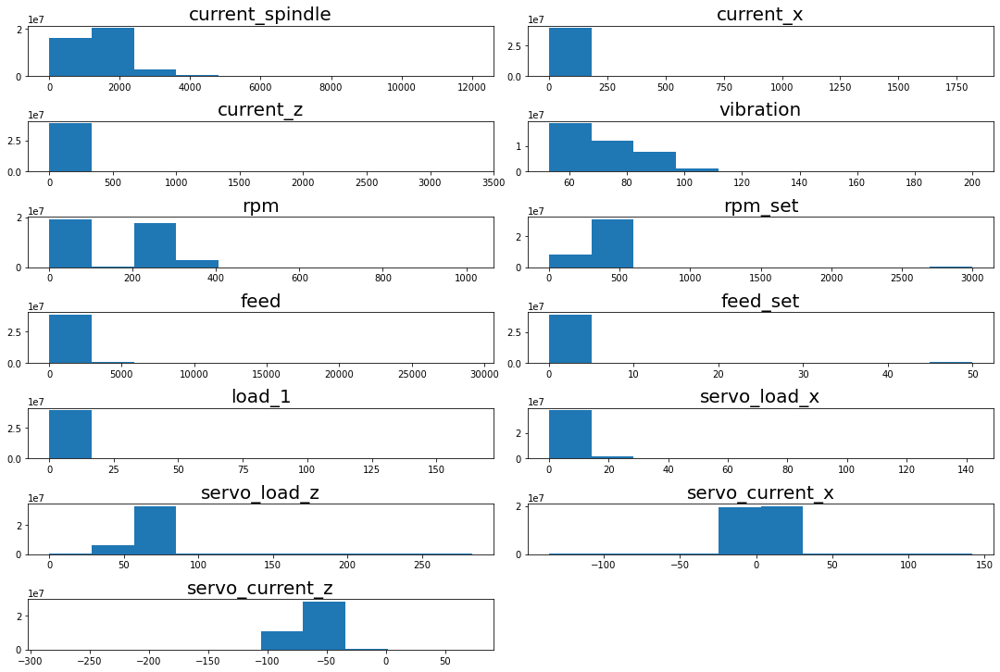

In [25]:
# 원본 데이터의 분포
temp_df = df.drop(['datetime', 'shot_no', 'real_shot', 'tool', 'tool_number', 'tool_state'], axis = 1).dropna(axis = 0)
temp_col = temp_df.columns

fig = plt.figure(figsize = (15,20))

# histogram
for idx_hist in range(0, len(temp_col)):
    globals()['ax_{}'.format(idx_hist)] = fig.add_subplot(round(len(temp_col)+1/2),2,(idx_hist+1))
    globals()['ax_{}'.format(idx_hist)].hist(temp_df[temp_col[idx_hist]])
    globals()['ax_{}'.format(idx_hist)].set_title('{}'.format(temp_col[idx_hist]), fontsize = 20)
fig.tight_layout()

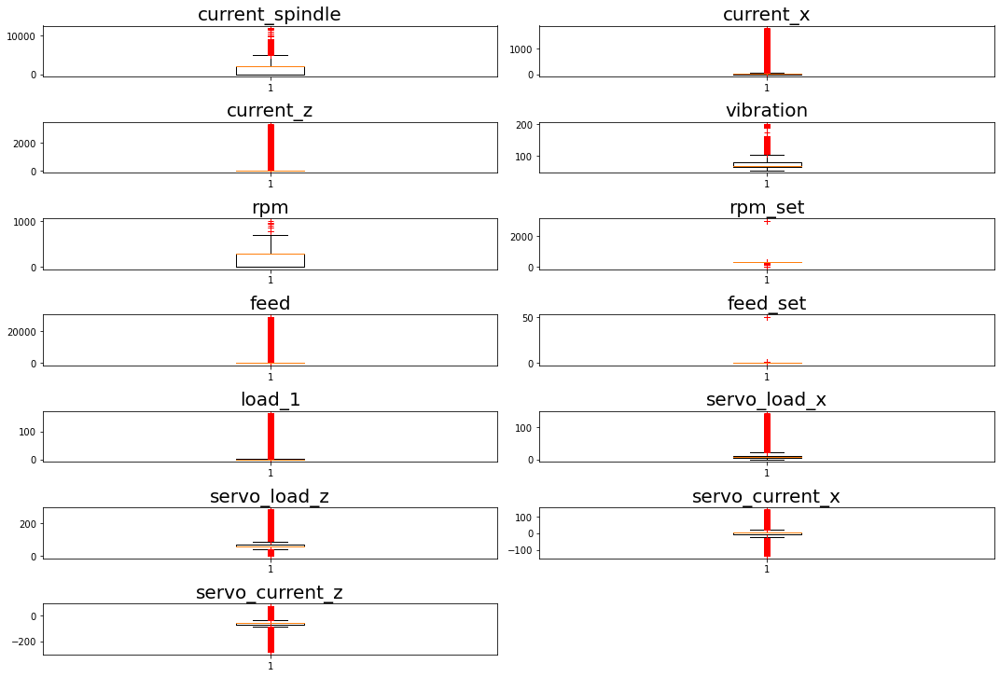

In [26]:
# 원본데이터의 분포 boxplot

fig2 = plt.figure(figsize = (15,20))

for idx_box in range(0, len(temp_col)):
    globals()['ax_box{}'.format(idx_box)] = fig2.add_subplot(round(len(temp_col)+1/2),2,(idx_box+1))
    globals()['ax_box{}'.format(idx_box)].boxplot(temp_df[[temp_col[idx_box]]], sym = 'r+')
    globals()['ax_box{}'.format(idx_box)].set_title('{}'.format(temp_col[idx_box]), fontsize = 20)
fig2.tight_layout()

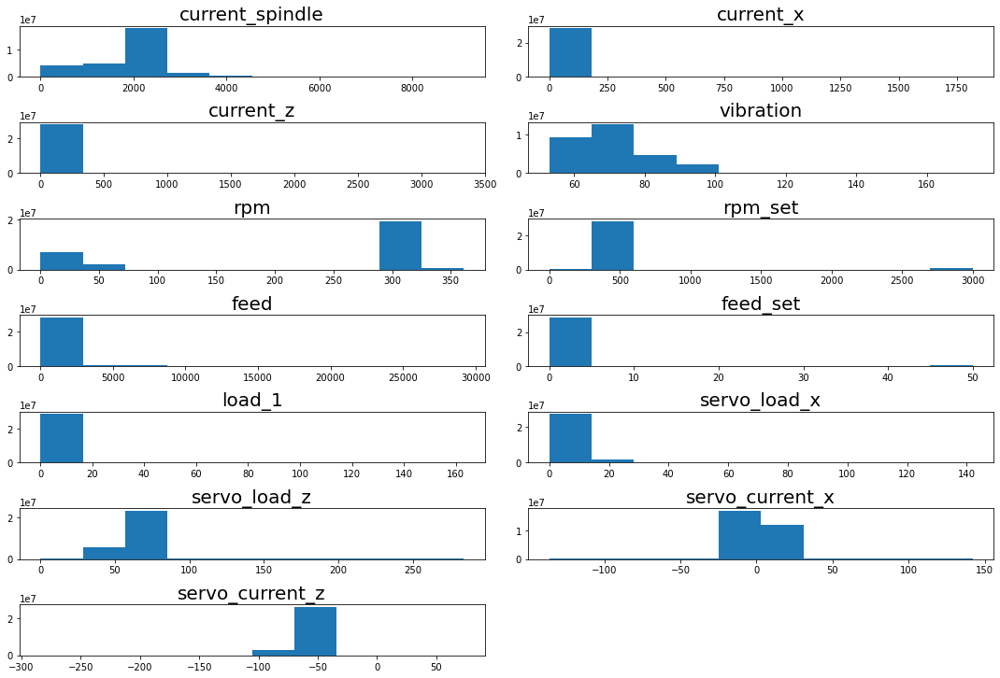

In [24]:
# 유효한 샷의 분포

temp_df_mod1 = df_mod1.drop(['datetime', 'shot_no', 'real_shot', 'tool', 'tool_number', 'tool_state'], axis = 1).dropna(axis = 0)
temp_col_mod1 = temp_df_mod1.columns

fig = plt.figure(figsize = (15,20))

# histogram
for idx_hist in range(0, len(temp_col_mod1)):
    globals()['ax_{}'.format(idx_hist)] = fig.add_subplot(round(len(temp_col_mod1)+1/2),2,(idx_hist+1))
    globals()['ax_{}'.format(idx_hist)].hist(temp_df_mod1[temp_col_mod1[idx_hist]])
    globals()['ax_{}'.format(idx_hist)].set_title('{}'.format(temp_col_mod1[idx_hist]), fontsize = 20)
fig.tight_layout()

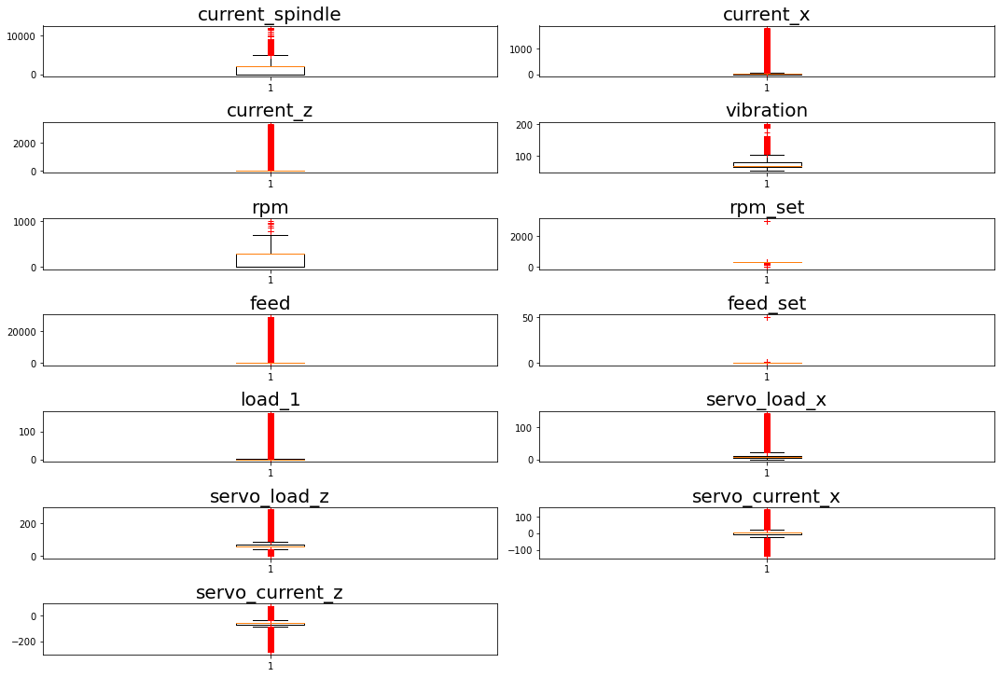

In [13]:
# 유효한 샷의 분포 boxplot

fig2 = plt.figure(figsize = (15,20))

for idx_box in range(0, len(temp_col_mod1)):
    globals()['ax_box{}'.format(idx_box)] = fig2.add_subplot(round(len(temp_col_mod1)+1/2),2,(idx_box+1))
    globals()['ax_box{}'.format(idx_box)].boxplot(temp_df[[temp_col_mod1[idx_box]]], sym = 'r+')
    globals()['ax_box{}'.format(idx_box)].set_title('{}'.format(temp_col_mod1[idx_box]), fontsize = 20)
fig2.tight_layout()

In [14]:
df.columns

Index(['datetime', 'shot_no', 'tool_number', 'current_spindle', 'current_x',
       'current_z', 'vibration', 'rpm', 'rpm_set', 'feed', 'feed_set',
       'load_1', 'servo_load_x', 'servo_load_z', 'servo_current_x',
       'servo_current_z', 'tool_state', 'tool', 'real_shot'],
      dtype='object')

<AxesSubplot:>

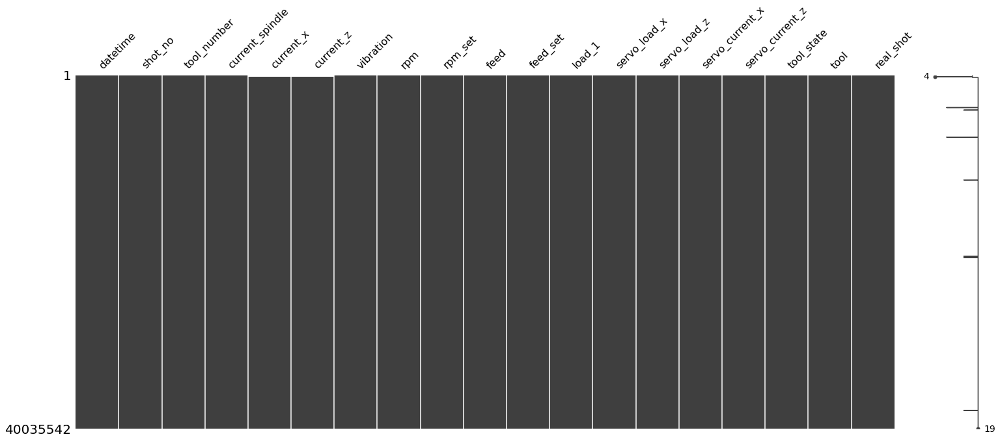

In [15]:
msno.matrix(df)

<AxesSubplot:>

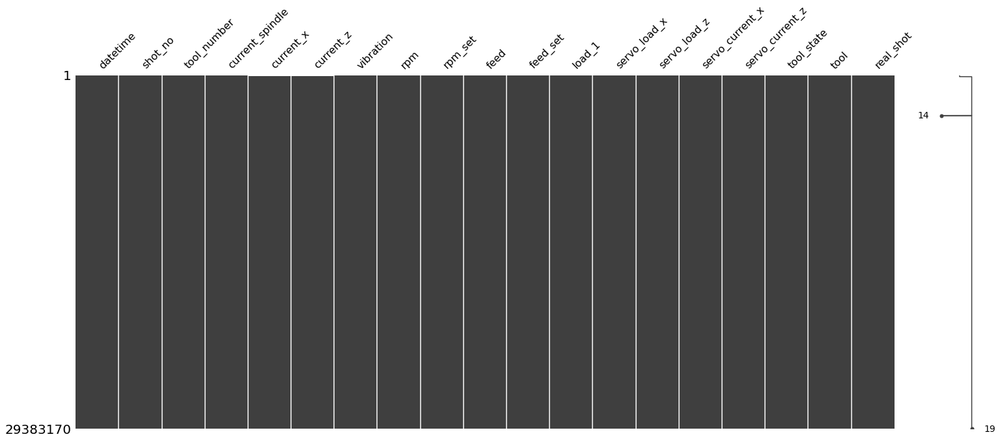

In [27]:
msno.matrix(df_mod1)

In [29]:
df_mod2 = df_mod1.copy()
df_mod2 = df_mod2.dropna(axis = 0)

In [41]:
print("원본 데이터의 Row 길이는 : {:,}개".format(len(df)))
print("유효 샷만 도출한 데이터의 Row 길이는 : {:,}개, 원본데이터 대비 데이터 비율 : {:.2f}%".format(len(df_mod1), len(df_mod1)/len(df) * 100))
print("유효 샷 및 결측치를 제거(전처리 완료)한 데이터의 Row 길이는 : {:,}개, 원본데이터 대비 데이터 비율 : {:.2f}%".format(len(df_mod2), len(df_mod2)/len(df) * 100))
print("유효 샷 데이터의 결측치의 수는 : {:,}개, 유효 샷 데이터에서 결측치 비율 : {:.2f}%".format(len(df_mod1) - len(df_mod2), (len(df_mod1) - len(df_mod2))/len(df_mod1) * 100))
print('원본 데이터에서 유효 샷/결측치 처리로 손실된 데이터 수는 : {:,}개, 손실된 데이터의 비율 : {:.2f}%'.format(len(df)-len(df_mod2), (len(df)-len(df_mod2))/len(df)*100))

원본 데이터의 Row 길이는 : 40,035,542개
유효 샷만 도출한 데이터의 Row 길이는 : 29,383,170개, 원본데이터 대비 데이터 비율 : 73.39%
유효 샷 및 결측치를 제거(전처리 완료)한 데이터의 Row 길이는 : 29,261,717개, 원본데이터 대비 데이터 비율 : 73.09%
유효 샷 데이터의 결측치의 수는 : 121,453개, 유효 샷 데이터에서 결측치 비율 : 0.41%
원본 데이터에서 유효 샷/결측치 처리로 손실된 데이터 수는 : 10,773,825개, 손실된 데이터의 비율 : 26.91%


In [34]:
(len(df)-len(df_mod2))/(len(df))

0.269106510410175

In [42]:
df_mod2.to_csv('data_extract_result_preprocessing_data.csv')

원본 데이터 40,035,542개에서 유효 샷/결측치 처리로 손실된 데이터는 10,773,825개로 약 27%의 데이터가 손실됨
유효 샷 데이터에서 결측치의 수는 121,453개로 0.41%를 포함하고 있음
전처리된 29,383,170개(73.09%)의 데이터를 추출하여 저장